In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-18 22:54:13,973] A new study created in memory with name: no-name-a24882e4-0474-4f54-94cc-fe51c642fec6
[I 2025-05-18 22:59:33,423] Trial 0 finished with value: 0.06479694843292236 and parameters: {'lr': 0.14587984854824837, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.41462290417334646}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.05867081508040428, 0.06165482848882675, 0.0719161257147789, 0.07300491631031036, 0.05873805657029152]
Mean Cross Validation Accuracy:
0.06479694843292236
Standard Deviation of Cross Validation Accuracy:
0.006358710876360202


[I 2025-05-18 23:05:01,259] Trial 1 finished with value: 0.06773838475346565 and parameters: {'lr': 0.8152157868064199, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.47429719617868116}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.063327856361866, 0.06740173697471619, 0.07566743344068527, 0.07472708821296692, 0.05756780877709389]
Mean Cross Validation Accuracy:
0.06773838475346565
Standard Deviation of Cross Validation Accuracy:
0.006851547230229654


[I 2025-05-18 23:13:18,808] Trial 2 finished with value: 0.1182217538356781 and parameters: {'lr': 0.023160753017138935, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.14014074151796746}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.10619547963142395, 0.11988665908575058, 0.1278447061777115, 0.140252023935318, 0.09692990034818649]
Mean Cross Validation Accuracy:
0.1182217538356781
Standard Deviation of Cross Validation Accuracy:
0.01535369804379759


[I 2025-05-18 23:23:00,164] Trial 3 finished with value: 0.07107496708631515 and parameters: {'lr': 0.002716686987721696, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2723322484877609}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.05987795442342758, 0.07072479277849197, 0.08018558472394943, 0.08128812164068222, 0.06329838186502457]
Mean Cross Validation Accuracy:
0.07107496708631515
Standard Deviation of Cross Validation Accuracy:
0.008640403601838062


[I 2025-05-18 23:30:47,435] Trial 4 finished with value: 0.07715396136045456 and parameters: {'lr': 0.026069378539313036, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.27585523701164616}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.06588546931743622, 0.10179715603590012, 0.07422482967376709, 0.08084575086832047, 0.06301660090684891]
Mean Cross Validation Accuracy:
0.07715396136045456
Standard Deviation of Cross Validation Accuracy:
0.013829967747894384


[I 2025-05-18 23:38:28,256] Trial 5 finished with value: 19.976710510253906 and parameters: {'lr': 0.224190585963825, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.414898758528488}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[19.273494720458984, 20.631649017333984, 18.088836669921875, 21.78639793395996, 20.103174209594727]
Mean Cross Validation Accuracy:
19.976710510253906
Standard Deviation of Cross Validation Accuracy:
1.2472759254354278


[I 2025-05-18 23:46:40,040] Trial 6 finished with value: 0.06506354808807373 and parameters: {'lr': 0.017656364127469758, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34094469487643553}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.05835450068116188, 0.06104445457458496, 0.07296697050333023, 0.07338806986808777, 0.05956374481320381]
Mean Cross Validation Accuracy:
0.06506354808807373
Standard Deviation of Cross Validation Accuracy:
0.006680928297482842


[I 2025-05-18 23:57:04,796] Trial 7 finished with value: 0.08431607335805893 and parameters: {'lr': 0.9126920656258997, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.34108468708016515}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.09082338213920593, 0.08346983790397644, 0.09617466479539871, 0.0790664330124855, 0.07204604893922806]
Mean Cross Validation Accuracy:
0.08431607335805893
Standard Deviation of Cross Validation Accuracy:
0.008506463376647967


[I 2025-05-19 00:08:37,430] Trial 8 finished with value: 7.517343902587891 and parameters: {'lr': 0.6761551739892816, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.19973254724984804}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[6.517077922821045, 6.384850025177002, 7.524661540985107, 9.973745346069336, 7.186384677886963]
Mean Cross Validation Accuracy:
7.517343902587891
Standard Deviation of Cross Validation Accuracy:
1.2981964427956314


[I 2025-05-19 00:17:02,397] Trial 9 finished with value: 0.5529421210289002 and parameters: {'lr': 0.1233076965638428, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.386184563835837}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.4864443838596344, 0.48632460832595825, 0.6997889280319214, 0.6121079325675964, 0.48004475235939026]
Mean Cross Validation Accuracy:
0.5529421210289002
Standard Deviation of Cross Validation Accuracy:
0.08858718461302731


[I 2025-05-19 00:27:00,805] Trial 10 finished with value: 0.4808383285999298 and parameters: {'lr': 0.004546012121278172, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.48464999419154453}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.48276475071907043, 0.4787440598011017, 0.4888964593410492, 0.47241780161857605, 0.4813685715198517]
Mean Cross Validation Accuracy:
0.4808383285999298
Standard Deviation of Cross Validation Accuracy:
0.005370604569723346


[I 2025-05-19 00:35:52,790] Trial 11 finished with value: 0.06550818309187889 and parameters: {'lr': 0.08065356806119206, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3526345203660337}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.06035834178328514, 0.06153431162238121, 0.07349247485399246, 0.07331544160842896, 0.058840345591306686]
Mean Cross Validation Accuracy:
0.06550818309187889
Standard Deviation of Cross Validation Accuracy:
0.006503457194148684


[I 2025-05-19 00:44:31,628] Trial 12 finished with value: 0.42976510524749756 and parameters: {'lr': 0.008780495730406254, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.42307926807882124}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.439060777425766, 0.4240189790725708, 0.4196009635925293, 0.4314740002155304, 0.4346708059310913]
Mean Cross Validation Accuracy:
0.42976510524749756
Standard Deviation of Cross Validation Accuracy:
0.007067156203948704


[I 2025-05-19 00:53:48,731] Trial 13 finished with value: 0.06626945957541466 and parameters: {'lr': 0.06181987446427665, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.32018506184805917}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.06227158010005951, 0.061600323766469955, 0.07257770001888275, 0.07407215237617493, 0.060825541615486145]
Mean Cross Validation Accuracy:
0.06626945957541466
Standard Deviation of Cross Validation Accuracy:
0.005798207045146121


[I 2025-05-19 01:01:09,833] Trial 14 finished with value: 0.4209552764892578 and parameters: {'lr': 0.01043971505084705, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.20877146400833196}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.4326495826244354, 0.4207402169704437, 0.415211945772171, 0.41737622022628784, 0.41879841685295105]
Mean Cross Validation Accuracy:
0.4209552764892578
Standard Deviation of Cross Validation Accuracy:
0.006119650014991902


[I 2025-05-19 01:07:52,980] Trial 15 finished with value: 0.06145232543349266 and parameters: {'lr': 0.0011468743035242719, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.42018571552290773}. Best is trial 15 with value: 0.06145232543349266.


Cross Validation Accuracies:
[0.05662298575043678, 0.056163810193538666, 0.06579381972551346, 0.07206078618764877, 0.05662022531032562]
Mean Cross Validation Accuracy:
0.06145232543349266
Standard Deviation of Cross Validation Accuracy:
0.0064191606784375545


[I 2025-05-19 01:15:28,184] Trial 16 finished with value: 0.05846198201179505 and parameters: {'lr': 0.001837714584266461, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4356282464845786}. Best is trial 16 with value: 0.05846198201179505.


Cross Validation Accuracies:
[0.05396454036235809, 0.054757360368967056, 0.06362780928611755, 0.06426756083965302, 0.0556926392018795]
Mean Cross Validation Accuracy:
0.05846198201179505
Standard Deviation of Cross Validation Accuracy:
0.004516878999044311


[I 2025-05-19 01:22:54,083] Trial 17 finished with value: 0.05799294784665108 and parameters: {'lr': 0.0011168395951898238, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4510677135354648}. Best is trial 17 with value: 0.05799294784665108.


Cross Validation Accuracies:
[0.04868391528725624, 0.059093181043863297, 0.0650053545832634, 0.06240963935852051, 0.054772648960351944]
Mean Cross Validation Accuracy:
0.05799294784665108
Standard Deviation of Cross Validation Accuracy:
0.005777887803478461


[I 2025-05-19 01:31:55,355] Trial 18 finished with value: 0.04964808002114296 and parameters: {'lr': 0.001081947323973415, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4921348139247974}. Best is trial 18 with value: 0.04964808002114296.


Cross Validation Accuracies:
[0.04292401671409607, 0.05057723447680473, 0.055914998054504395, 0.05131131038069725, 0.04751284047961235]
Mean Cross Validation Accuracy:
0.04964808002114296
Standard Deviation of Cross Validation Accuracy:
0.004305257254222567


[I 2025-05-19 01:40:09,496] Trial 19 finished with value: 0.05082317516207695 and parameters: {'lr': 0.0010410713807768002, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4917651124105467}. Best is trial 18 with value: 0.04964808002114296.


Cross Validation Accuracies:
[0.046578045934438705, 0.04901975393295288, 0.05840611830353737, 0.049462102353572845, 0.05064985528588295]
Mean Cross Validation Accuracy:
0.05082317516207695
Standard Deviation of Cross Validation Accuracy:
0.004016392310149958


[I 2025-05-19 01:48:32,227] Trial 20 finished with value: 0.06766685917973518 and parameters: {'lr': 0.004882292266937564, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.49697050523124714}. Best is trial 18 with value: 0.04964808002114296.


Cross Validation Accuracies:
[0.0516483336687088, 0.06110120192170143, 0.0831032320857048, 0.07315917313098907, 0.06932235509157181]
Mean Cross Validation Accuracy:
0.06766685917973518
Standard Deviation of Cross Validation Accuracy:
0.010685399407816007


[I 2025-05-19 01:56:50,515] Trial 21 finished with value: 0.04951063320040703 and parameters: {'lr': 0.0010155813143112986, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.46222360935573287}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.04645374044775963, 0.046306587755680084, 0.056892331689596176, 0.048107802867889404, 0.04979270324110985]
Mean Cross Validation Accuracy:
0.04951063320040703
Standard Deviation of Cross Validation Accuracy:
0.0039024984189120343


[I 2025-05-19 02:04:49,396] Trial 22 finished with value: 0.05959412604570389 and parameters: {'lr': 0.0023020929363359653, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4633322628994079}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.05128763988614082, 0.05393996462225914, 0.06721564382314682, 0.06727667897939682, 0.058250702917575836]
Mean Cross Validation Accuracy:
0.05959412604570389
Standard Deviation of Cross Validation Accuracy:
0.006631458244359914


[I 2025-05-19 02:13:07,187] Trial 23 finished with value: 0.0519324466586113 and parameters: {'lr': 0.0010327027694571852, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4961502445878412}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.053794682025909424, 0.04820946604013443, 0.058307990431785583, 0.04752693325281143, 0.05182316154241562]
Mean Cross Validation Accuracy:
0.0519324466586113
Standard Deviation of Cross Validation Accuracy:
0.003934375560561956


[I 2025-05-19 02:21:38,345] Trial 24 finished with value: 0.0655032142996788 and parameters: {'lr': 0.004089331875489008, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3816933580431635}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.05669962987303734, 0.06259100139141083, 0.07228412479162216, 0.07637523859739304, 0.05956607684493065]
Mean Cross Validation Accuracy:
0.0655032142996788
Standard Deviation of Cross Validation Accuracy:
0.007555333789668016


[I 2025-05-19 02:29:25,264] Trial 25 finished with value: 0.05253904312849045 and parameters: {'lr': 0.0018873640720861913, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.45308527737315357}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.05212942510843277, 0.047846827656030655, 0.06350807845592499, 0.05190805345773697, 0.04730283096432686]
Mean Cross Validation Accuracy:
0.05253904312849045
Standard Deviation of Cross Validation Accuracy:
0.005836445404003816


[I 2025-05-19 02:38:24,111] Trial 26 finished with value: 0.08738340884447098 and parameters: {'lr': 0.006424834257938339, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.39181650120279643}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.09043332934379578, 0.0892002210021019, 0.09009918570518494, 0.08109307289123535, 0.08609123528003693]
Mean Cross Validation Accuracy:
0.08738340884447098
Standard Deviation of Cross Validation Accuracy:
0.0034990371347185635


[I 2025-05-19 02:46:28,362] Trial 27 finished with value: 0.0653006300330162 and parameters: {'lr': 0.0030220320470474974, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4686826154884949}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.06328348815441132, 0.06311066448688507, 0.06716510653495789, 0.07384002953767776, 0.05910386145114899]
Mean Cross Validation Accuracy:
0.0653006300330162
Standard Deviation of Cross Validation Accuracy:
0.004973175400795482


[I 2025-05-19 02:54:44,099] Trial 28 finished with value: 0.03924315124750137 and parameters: {'lr': 0.0014755396272186742, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10520688121885485}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03138145059347153, 0.039405159652233124, 0.047708310186862946, 0.0430588535964489, 0.03466198220849037]
Mean Cross Validation Accuracy:
0.03924315124750137
Standard Deviation of Cross Validation Accuracy:
0.00581443366021467


[I 2025-05-19 03:03:18,566] Trial 29 finished with value: 0.07691924273967743 and parameters: {'lr': 0.0017189383582257754, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15603206268462377}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.0687650516629219, 0.08091304451227188, 0.07979699969291687, 0.07957624644041061, 0.07554487138986588]
Mean Cross Validation Accuracy:
0.07691924273967743
Standard Deviation of Cross Validation Accuracy:
0.004464780735261892


[I 2025-05-19 03:12:00,143] Trial 30 finished with value: 0.0915670394897461 and parameters: {'lr': 0.011094661332307526, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.23968360884735393}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.08427600562572479, 0.0870649442076683, 0.09813081473112106, 0.09415807574987411, 0.0942053571343422]
Mean Cross Validation Accuracy:
0.0915670394897461
Standard Deviation of Cross Validation Accuracy:
0.005102653643930476


[I 2025-05-19 03:21:09,865] Trial 31 finished with value: 0.0394885279238224 and parameters: {'lr': 0.0014769982989808418, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12381034077004788}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03156508505344391, 0.03983521834015846, 0.04532083123922348, 0.04221349582076073, 0.038508009165525436]
Mean Cross Validation Accuracy:
0.0394885279238224
Standard Deviation of Cross Validation Accuracy:
0.004589199716780392


[I 2025-05-19 03:31:01,422] Trial 32 finished with value: 0.04077979847788811 and parameters: {'lr': 0.0016046918170719736, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12563130418930785}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03209299221634865, 0.035711757838726044, 0.04798155650496483, 0.05058865621685982, 0.0375240296125412]
Mean Cross Validation Accuracy:
0.04077979847788811
Standard Deviation of Cross Validation Accuracy:
0.007208670871585564


[I 2025-05-19 03:40:55,003] Trial 33 finished with value: 0.06622618064284325 and parameters: {'lr': 0.003371210229942097, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10656236223346291}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.0595402754843235, 0.06312858313322067, 0.07285314798355103, 0.07415374368429184, 0.06145515292882919]
Mean Cross Validation Accuracy:
0.06622618064284325
Standard Deviation of Cross Validation Accuracy:
0.006063366976840182


[I 2025-05-19 03:48:03,903] Trial 34 finished with value: 0.04008557051420212 and parameters: {'lr': 0.0016671897746303064, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10144526364665862}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.032066360116004944, 0.0367061048746109, 0.05053391307592392, 0.04508088156580925, 0.036040592938661575]
Mean Cross Validation Accuracy:
0.04008557051420212
Standard Deviation of Cross Validation Accuracy:
0.006726237607990858


[I 2025-05-19 03:55:36,388] Trial 35 finished with value: 0.07215468883514405 and parameters: {'lr': 0.0018014194744434278, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12540469250410613}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.06467342376708984, 0.07347521185874939, 0.08147243410348892, 0.0751076489686966, 0.06604472547769547]
Mean Cross Validation Accuracy:
0.07215468883514405
Standard Deviation of Cross Validation Accuracy:
0.006173898456240404


[I 2025-05-19 04:04:10,157] Trial 36 finished with value: 0.378215092420578 and parameters: {'lr': 0.006218225001406216, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.15925151870009774}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.3584630489349365, 0.4060845673084259, 0.3793415129184723, 0.3801385164260864, 0.36704781651496887]
Mean Cross Validation Accuracy:
0.378215092420578
Standard Deviation of Cross Validation Accuracy:
0.01610296424002797


[I 2025-05-19 04:11:29,799] Trial 37 finished with value: 0.21291526556015014 and parameters: {'lr': 0.04106576597219743, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10583000515785992}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.1817472279071808, 0.17890217900276184, 0.1702970564365387, 0.26302656531333923, 0.2706032991409302]
Mean Cross Validation Accuracy:
0.21291526556015014
Standard Deviation of Cross Validation Accuracy:
0.04423505387941187


[I 2025-05-19 04:18:55,104] Trial 38 finished with value: 0.04572942107915878 and parameters: {'lr': 0.002796930486276538, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.18576630425924795}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.0418873056769371, 0.0402543731033802, 0.0609099417924881, 0.045749321579933167, 0.039846163243055344]
Mean Cross Validation Accuracy:
0.04572942107915878
Standard Deviation of Cross Validation Accuracy:
0.00787145893751457


[I 2025-05-19 04:25:58,719] Trial 39 finished with value: 0.09615310579538346 and parameters: {'lr': 0.016149208496476827, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.13536892535279807}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.11433877795934677, 0.07769787311553955, 0.10501498728990555, 0.09058580547571182, 0.09312808513641357]
Mean Cross Validation Accuracy:
0.09615310579538346
Standard Deviation of Cross Validation Accuracy:
0.01256974790345369


[I 2025-05-19 04:32:35,678] Trial 40 finished with value: 2.2857869625091554 and parameters: {'lr': 0.36944115874347605, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.16597424336515837}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[2.546619415283203, 2.24892258644104, 2.3185675144195557, 2.1396007537841797, 2.175224542617798]
Mean Cross Validation Accuracy:
2.2857869625091554
Standard Deviation of Cross Validation Accuracy:
0.1442647368833997


[I 2025-05-19 04:39:41,507] Trial 41 finished with value: 0.0430091917514801 and parameters: {'lr': 0.0025845914467498925, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.18607203892642896}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.038763657212257385, 0.036580562591552734, 0.049036286771297455, 0.04081522300839424, 0.0498502291738987]
Mean Cross Validation Accuracy:
0.0430091917514801
Standard Deviation of Cross Validation Accuracy:
0.0054275409282303535


[I 2025-05-19 04:47:54,545] Trial 42 finished with value: 0.041171375662088394 and parameters: {'lr': 0.001535016617592123, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12292904772964522}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.030054140836000443, 0.04281167313456535, 0.05089731141924858, 0.04352853447198868, 0.038565218448638916]
Mean Cross Validation Accuracy:
0.041171375662088394
Standard Deviation of Cross Validation Accuracy:
0.006829722767511277


[I 2025-05-19 04:55:58,317] Trial 43 finished with value: 0.040842436254024506 and parameters: {'lr': 0.0014343080099702063, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12214547784578172}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03277301415801048, 0.03602822870016098, 0.05189007893204689, 0.04103899002075195, 0.04248186945915222]
Mean Cross Validation Accuracy:
0.040842436254024506
Standard Deviation of Cross Validation Accuracy:
0.006527923876606829


[I 2025-05-19 05:03:28,722] Trial 44 finished with value: 0.04316158667206764 and parameters: {'lr': 0.001436902595747378, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.14667469303695457}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03852551802992821, 0.042802587151527405, 0.04924361780285835, 0.04507562145590782, 0.040160588920116425]
Mean Cross Validation Accuracy:
0.04316158667206764
Standard Deviation of Cross Validation Accuracy:
0.003775781573323606


[I 2025-05-19 05:11:30,278] Trial 45 finished with value: 0.4646370232105255 and parameters: {'lr': 0.002251498350085609, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10279493012501659}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.4542695879936218, 0.46946895122528076, 0.4682912528514862, 0.45666563510894775, 0.474489688873291]
Mean Cross Validation Accuracy:
0.4646370232105255
Standard Deviation of Cross Validation Accuracy:
0.007807722901250543


[I 2025-05-19 05:18:27,325] Trial 46 finished with value: 0.06546765565872192 and parameters: {'lr': 0.004056436375498254, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.22961570330759085}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.060323216021060944, 0.061672553420066833, 0.07335731387138367, 0.07337556779384613, 0.058609627187252045]
Mean Cross Validation Accuracy:
0.06546765565872192
Standard Deviation of Cross Validation Accuracy:
0.006521999628217398


[I 2025-05-19 05:25:38,449] Trial 47 finished with value: 0.071358472853899 and parameters: {'lr': 0.006252051775115201, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12417065809100533}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.06243467703461647, 0.06691567599773407, 0.07840424031019211, 0.07801953703165054, 0.07101823389530182]
Mean Cross Validation Accuracy:
0.071358472853899
Standard Deviation of Cross Validation Accuracy:
0.0062209477301553425


[I 2025-05-19 05:34:38,823] Trial 48 finished with value: 0.04065326973795891 and parameters: {'lr': 0.001526928583004307, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1746796410783573}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03257618844509125, 0.03682011365890503, 0.05114186927676201, 0.04472556337714195, 0.0380026139318943]
Mean Cross Validation Accuracy:
0.04065326973795891
Standard Deviation of Cross Validation Accuracy:
0.006535328602439448


[I 2025-05-19 05:43:48,432] Trial 49 finished with value: 0.4302490770816803 and parameters: {'lr': 0.0033912692093313137, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.17697748857924997}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.4298045039176941, 0.41327640414237976, 0.4403642416000366, 0.4463702142238617, 0.4214300215244293]
Mean Cross Validation Accuracy:
0.4302490770816803
Standard Deviation of Cross Validation Accuracy:
0.012068575963343115


[I 2025-05-19 05:53:05,963] Trial 50 finished with value: 0.04649269357323647 and parameters: {'lr': 0.0021742689660047146, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2770624079553952}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03921918570995331, 0.0409591868519783, 0.05153275653719902, 0.05110768973827362, 0.049644649028778076]
Mean Cross Validation Accuracy:
0.04649269357323647
Standard Deviation of Cross Validation Accuracy:
0.00529450395691956


[I 2025-05-19 06:02:00,462] Trial 51 finished with value: 0.040246418118476866 and parameters: {'lr': 0.0013405177398077457, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13942010455008674}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.035701725631952286, 0.03539722040295601, 0.05161496624350548, 0.04579012468457222, 0.032728053629398346]
Mean Cross Validation Accuracy:
0.040246418118476866
Standard Deviation of Cross Validation Accuracy:
0.007220406108162933


[I 2025-05-19 06:11:08,248] Trial 52 finished with value: 0.0394393652677536 and parameters: {'lr': 0.0016133055489694341, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.142652533174687}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03100789338350296, 0.03964786231517792, 0.0476771742105484, 0.03911117836833, 0.039752718061208725]
Mean Cross Validation Accuracy:
0.0394393652677536
Standard Deviation of Cross Validation Accuracy:
0.00527637341259701


[I 2025-05-19 06:21:27,919] Trial 53 finished with value: 0.04013608768582344 and parameters: {'lr': 0.0012533889198712196, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14379485450043408}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03501351177692413, 0.03698103129863739, 0.04915791377425194, 0.0406627282500267, 0.03886525332927704]
Mean Cross Validation Accuracy:
0.04013608768582344
Standard Deviation of Cross Validation Accuracy:
0.00488837152770227


[I 2025-05-19 06:31:42,145] Trial 54 finished with value: 0.039719820767641065 and parameters: {'lr': 0.0013655198285443468, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13973682951793293}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.032216425985097885, 0.041468892246484756, 0.04743308946490288, 0.04337267950177193, 0.03410801663994789]
Mean Cross Validation Accuracy:
0.039719820767641065
Standard Deviation of Cross Validation Accuracy:
0.005721720384570883


[I 2025-05-19 06:41:38,445] Trial 55 finished with value: 0.04624263122677803 and parameters: {'lr': 0.002467469498460172, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.20076852935331058}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03550548851490021, 0.040620509535074234, 0.05666301026940346, 0.044057879596948624, 0.05436626821756363]
Mean Cross Validation Accuracy:
0.04624263122677803
Standard Deviation of Cross Validation Accuracy:
0.008077690300644695


[I 2025-05-19 06:49:03,730] Trial 56 finished with value: 0.038152105361223224 and parameters: {'lr': 0.0020251169132599243, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14042268236135122}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.030682526528835297, 0.03892310708761215, 0.04652285575866699, 0.0381121002137661, 0.036519937217235565]
Mean Cross Validation Accuracy:
0.038152105361223224
Standard Deviation of Cross Validation Accuracy:
0.005081812414360228


[I 2025-05-19 06:55:50,282] Trial 57 finished with value: 0.040282142162322995 and parameters: {'lr': 0.0020661474419722734, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11178226519800832}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.02837253361940384, 0.040360696613788605, 0.047106947749853134, 0.044665101915597916, 0.0409054309129715]
Mean Cross Validation Accuracy:
0.040282142162322995
Standard Deviation of Cross Validation Accuracy:
0.0064501432979510364


[I 2025-05-19 07:03:00,174] Trial 58 finished with value: 0.06552894189953803 and parameters: {'lr': 0.005169220010934349, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.21667966122634136}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.058978281915187836, 0.061908915638923645, 0.07315102219581604, 0.07304776459932327, 0.06055872514843941]
Mean Cross Validation Accuracy:
0.06552894189953803
Standard Deviation of Cross Validation Accuracy:
0.0062505614746952345


[I 2025-05-19 07:09:12,059] Trial 59 finished with value: 0.06741685345768929 and parameters: {'lr': 0.0033850754208392007, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1519352129065942}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.06639928370714188, 0.06302548199892044, 0.0734272226691246, 0.07424049824476242, 0.059991780668497086]
Mean Cross Validation Accuracy:
0.06741685345768929
Standard Deviation of Cross Validation Accuracy:
0.005623841456670719


[I 2025-05-19 07:15:37,360] Trial 60 finished with value: 0.2833900272846222 and parameters: {'lr': 0.007681293543369887, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.10032872945423686}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.344939261674881, 0.25724902749061584, 0.2953181564807892, 0.2541198432445526, 0.26532384753227234]
Mean Cross Validation Accuracy:
0.2833900272846222
Standard Deviation of Cross Validation Accuracy:
0.034050171555989155


[I 2025-05-19 07:24:16,142] Trial 61 finished with value: 0.041178197041153906 and parameters: {'lr': 0.0012337686939089588, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1411711734707015}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.031043557450175285, 0.042794376611709595, 0.04836547002196312, 0.03801547363400459, 0.045672107487916946]
Mean Cross Validation Accuracy:
0.041178197041153906
Standard Deviation of Cross Validation Accuracy:
0.00611846221525702


[I 2025-05-19 07:33:17,785] Trial 62 finished with value: 0.038834105059504506 and parameters: {'lr': 0.001272197524847545, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16784241536633412}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.030028147622942924, 0.036987606436014175, 0.04930349439382553, 0.04007025808095932, 0.037781018763780594]
Mean Cross Validation Accuracy:
0.038834105059504506
Standard Deviation of Cross Validation Accuracy:
0.0062161020199699765


[I 2025-05-19 07:41:57,533] Trial 63 finished with value: 0.04226556196808815 and parameters: {'lr': 0.001949312945395152, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16341470048241402}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03713899478316307, 0.037969920784235, 0.048922475427389145, 0.04054809361696243, 0.0467483252286911]
Mean Cross Validation Accuracy:
0.04226556196808815
Standard Deviation of Cross Validation Accuracy:
0.004734840759187552


[I 2025-05-19 07:49:36,877] Trial 64 finished with value: 0.059573983401060106 and parameters: {'lr': 0.0012559319180046574, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.11385653816345555}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.05233542621135712, 0.052723005414009094, 0.06588423997163773, 0.07134158909320831, 0.05558565631508827]
Mean Cross Validation Accuracy:
0.059573983401060106
Standard Deviation of Cross Validation Accuracy:
0.007662052521677881


[I 2025-05-19 07:58:07,632] Trial 65 finished with value: 0.0427462674677372 and parameters: {'lr': 0.00267125467610693, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1339786097107097}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.0351102314889431, 0.03961540386080742, 0.05449269711971283, 0.0447574183344841, 0.03975558653473854]
Mean Cross Validation Accuracy:
0.0427462674677372
Standard Deviation of Cross Validation Accuracy:
0.0066193483397577165


[I 2025-05-19 08:06:41,340] Trial 66 finished with value: 0.6264686703681945 and parameters: {'lr': 0.11139212573455284, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.25335083945716447}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.6498727202415466, 0.5064535737037659, 0.5299562811851501, 0.7159881591796875, 0.7300726175308228]
Mean Cross Validation Accuracy:
0.6264686703681945
Standard Deviation of Cross Validation Accuracy:
0.0927507746473458


[I 2025-05-19 08:17:54,070] Trial 67 finished with value: 0.2680253505706787 and parameters: {'lr': 0.00395239378910739, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.17047928857381897}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.2470194697380066, 0.24331332743167877, 0.3229411840438843, 0.2462351769208908, 0.2806175947189331]
Mean Cross Validation Accuracy:
0.2680253505706787
Standard Deviation of Cross Validation Accuracy:
0.03066286406587908


[I 2025-05-19 08:26:44,370] Trial 68 finished with value: 0.0389203418046236 and parameters: {'lr': 0.001007668445011933, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.19164663648180652}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.02945020981132984, 0.04288803040981293, 0.045395493507385254, 0.04186146706342697, 0.035006508231163025]
Mean Cross Validation Accuracy:
0.0389203418046236
Standard Deviation of Cross Validation Accuracy:
0.005853577597344222


[I 2025-05-19 08:33:40,916] Trial 69 finished with value: 0.03968529850244522 and parameters: {'lr': 0.0010134511022015045, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.19295583332854013}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03148936107754707, 0.03925178945064545, 0.051323793828487396, 0.041425302624702454, 0.034936245530843735]
Mean Cross Validation Accuracy:
0.03968529850244522
Standard Deviation of Cross Validation Accuracy:
0.006758653894048623


[I 2025-05-19 08:41:46,801] Trial 70 finished with value: 0.046134696900844575 and parameters: {'lr': 0.0011363286408274148, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1917103557676878}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03783071041107178, 0.046325668692588806, 0.056970492005348206, 0.04224998503923416, 0.04729662835597992]
Mean Cross Validation Accuracy:
0.046134696900844575
Standard Deviation of Cross Validation Accuracy:
0.006369429932867235


[I 2025-05-19 08:52:58,612] Trial 71 finished with value: 0.038798500597476956 and parameters: {'lr': 0.0010117503264254217, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15903921308748678}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03357158228754997, 0.03700624778866768, 0.04497082158923149, 0.03981799632310867, 0.03862585499882698]
Mean Cross Validation Accuracy:
0.038798500597476956
Standard Deviation of Cross Validation Accuracy:
0.003733619413167414


[I 2025-05-19 09:04:21,212] Trial 72 finished with value: 0.040386300534009933 and parameters: {'lr': 0.001003370891514885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.22052013075445598}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03907887265086174, 0.04052867367863655, 0.046153340488672256, 0.04060277342796326, 0.03556784242391586]
Mean Cross Validation Accuracy:
0.040386300534009933
Standard Deviation of Cross Validation Accuracy:
0.0034132912765588493


[I 2025-05-19 09:17:24,812] Trial 73 finished with value: 0.03974677473306656 and parameters: {'lr': 0.0018389712403907368, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1951117276095149}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03349785506725311, 0.039764534682035446, 0.04647010564804077, 0.038898222148418427, 0.04010315611958504]
Mean Cross Validation Accuracy:
0.03974677473306656
Standard Deviation of Cross Validation Accuracy:
0.004125519123198806


[I 2025-05-19 09:28:17,104] Trial 74 finished with value: 0.04011092856526375 and parameters: {'lr': 0.0010098613158119624, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15512237991290428}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03671250492334366, 0.04049304127693176, 0.04397403076291084, 0.040420930832624435, 0.03895413503050804]
Mean Cross Validation Accuracy:
0.04011092856526375
Standard Deviation of Cross Validation Accuracy:
0.00236867577568847


[I 2025-05-19 09:39:26,947] Trial 75 finished with value: 0.04144925028085709 and parameters: {'lr': 0.0016560918716222585, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.20621571304549507}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03148285299539566, 0.039192650467157364, 0.04824092239141464, 0.0407043993473053, 0.047625426203012466]
Mean Cross Validation Accuracy:
0.04144925028085709
Standard Deviation of Cross Validation Accuracy:
0.006152204150754307


[I 2025-05-19 09:50:20,079] Trial 76 finished with value: 0.04518241584300995 and parameters: {'lr': 0.002137812680543393, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.18026360542373357}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03579531982541084, 0.04454512894153595, 0.058052387088537216, 0.043639954179525375, 0.04387928918004036]
Mean Cross Validation Accuracy:
0.04518241584300995
Standard Deviation of Cross Validation Accuracy:
0.007186615241992239


[I 2025-05-19 10:00:54,810] Trial 77 finished with value: 0.06549794301390648 and parameters: {'lr': 0.0030055396692551823, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.16387246265583216}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.059851791709661484, 0.060782913118600845, 0.0739428922533989, 0.07394694536924362, 0.05896517261862755]
Mean Cross Validation Accuracy:
0.06549794301390648
Standard Deviation of Cross Validation Accuracy:
0.006920844297621242


[I 2025-05-19 10:11:52,779] Trial 78 finished with value: 0.201331290602684 and parameters: {'lr': 0.02818163478085293, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.11506762025993864}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.1909402459859848, 0.17485685646533966, 0.15685439109802246, 0.25139355659484863, 0.23261140286922455]
Mean Cross Validation Accuracy:
0.201331290602684
Standard Deviation of Cross Validation Accuracy:
0.03541677557413775


[I 2025-05-19 10:18:48,622] Trial 79 finished with value: 0.07247624397277833 and parameters: {'lr': 0.0012583234338207788, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1301934136584676}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.07156208902597427, 0.06462575495243073, 0.08060888946056366, 0.07695231586694717, 0.06863217055797577]
Mean Cross Validation Accuracy:
0.07247624397277833
Standard Deviation of Cross Validation Accuracy:
0.005716955479545381


[I 2025-05-19 10:24:19,712] Trial 80 finished with value: 0.06481968685984611 and parameters: {'lr': 0.03775185809775774, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.30427729123524816}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.05974810943007469, 0.06085657700896263, 0.07175443321466446, 0.07287336140871048, 0.058865953236818314]
Mean Cross Validation Accuracy:
0.06481968685984611
Standard Deviation of Cross Validation Accuracy:
0.006161598203631917


[I 2025-05-19 10:30:29,411] Trial 81 finished with value: 0.03889021947979927 and parameters: {'lr': 0.001458276052404353, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.14873963897809261}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03234251216053963, 0.0377509780228138, 0.046644940972328186, 0.039314303547143936, 0.03839836269617081]
Mean Cross Validation Accuracy:
0.03889021947979927
Standard Deviation of Cross Validation Accuracy:
0.004576632343863062


[I 2025-05-19 10:36:38,214] Trial 82 finished with value: 0.04337354227900505 and parameters: {'lr': 0.001656897780028674, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1491825982390826}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03998503461480141, 0.03729569539427757, 0.055989015847444534, 0.03959756717085838, 0.044000398367643356]
Mean Cross Validation Accuracy:
0.04337354227900505
Standard Deviation of Cross Validation Accuracy:
0.006666683086419508


[I 2025-05-19 10:42:59,119] Trial 83 finished with value: 1.2217167377471925 and parameters: {'lr': 0.2386880678813069, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.17224836355065687}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[1.8180251121520996, 1.1280832290649414, 0.7249767780303955, 1.0645021200180054, 1.37299644947052]
Mean Cross Validation Accuracy:
1.2217167377471925
Standard Deviation of Cross Validation Accuracy:
0.3629610133664068


[I 2025-05-19 10:49:19,388] Trial 84 finished with value: 0.042090903222560885 and parameters: {'lr': 0.001457892789535177, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15296812979800695}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03306364640593529, 0.04121871292591095, 0.04982893541455269, 0.047975730150938034, 0.03836749121546745]
Mean Cross Validation Accuracy:
0.042090903222560885
Standard Deviation of Cross Validation Accuracy:
0.00617453170212455


[I 2025-05-19 10:54:50,514] Trial 85 finished with value: 0.04178525507450104 and parameters: {'lr': 0.0011799271554070365, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1882159428287469}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03552892804145813, 0.0478646494448185, 0.04477839544415474, 0.04185781255364418, 0.03889648988842964]
Mean Cross Validation Accuracy:
0.04178525507450104
Standard Deviation of Cross Validation Accuracy:
0.004322262879897971


[I 2025-05-19 11:00:31,363] Trial 86 finished with value: 0.044990706443786624 and parameters: {'lr': 0.00233190569485387, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.118301157850872}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.047809407114982605, 0.043069787323474884, 0.045662615448236465, 0.04328028857707977, 0.04513143375515938]
Mean Cross Validation Accuracy:
0.044990706443786624
Standard Deviation of Cross Validation Accuracy:
0.0017338857462795465


[I 2025-05-19 11:07:07,857] Trial 87 finished with value: 0.04648208543658257 and parameters: {'lr': 0.001825879751316371, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.13036528839613365}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.040562573820352554, 0.040942661464214325, 0.054998159408569336, 0.050999339669942856, 0.044907692819833755]
Mean Cross Validation Accuracy:
0.04648208543658257
Standard Deviation of Cross Validation Accuracy:
0.00567685915867507


[I 2025-05-19 11:13:37,593] Trial 88 finished with value: 3.680195665359497 and parameters: {'lr': 0.6749283001228741, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.24890322371056986}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[3.713050603866577, 4.27040958404541, 3.8470840454101562, 2.717841863632202, 3.8525922298431396]
Mean Cross Validation Accuracy:
3.680195665359497
Standard Deviation of Cross Validation Accuracy:
0.5163582212641838


[I 2025-05-19 11:18:27,506] Trial 89 finished with value: 0.04081065729260445 and parameters: {'lr': 0.0010205177417587144, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1637414070663786}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03371010348200798, 0.04099688678979874, 0.048895787447690964, 0.0416727140545845, 0.03877779468894005]
Mean Cross Validation Accuracy:
0.04081065729260445
Standard Deviation of Cross Validation Accuracy:
0.004913197486235279


[I 2025-05-19 11:24:39,638] Trial 90 finished with value: 0.1081469088792801 and parameters: {'lr': 0.019396021815826305, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1813237161074971}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.11959130316972733, 0.09554716944694519, 0.10773453116416931, 0.12682200968265533, 0.09103953093290329]
Mean Cross Validation Accuracy:
0.1081469088792801
Standard Deviation of Cross Validation Accuracy:
0.013647852725130662


[I 2025-05-19 11:30:27,012] Trial 91 finished with value: 0.03975451812148094 and parameters: {'lr': 0.0014129703127810911, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14116438876740023}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03513788804411888, 0.03858485445380211, 0.04728930816054344, 0.041913893073797226, 0.03584664687514305]
Mean Cross Validation Accuracy:
0.03975451812148094
Standard Deviation of Cross Validation Accuracy:
0.004458448276297322


[I 2025-05-19 11:36:16,282] Trial 92 finished with value: 0.03901796862483024 and parameters: {'lr': 0.0013021008541220101, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13438394436624682}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.04159330204129219, 0.03441762179136276, 0.04542877525091171, 0.03825785592198372, 0.035392288118600845]
Mean Cross Validation Accuracy:
0.03901796862483024
Standard Deviation of Cross Validation Accuracy:
0.004064906032011821


[I 2025-05-19 11:42:02,197] Trial 93 finished with value: 0.0398416206240654 and parameters: {'lr': 0.001576236146932084, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13020656987131227}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03546011447906494, 0.040799301117658615, 0.04585873708128929, 0.04019257053732872, 0.03689737990498543]
Mean Cross Validation Accuracy:
0.0398416206240654
Standard Deviation of Cross Validation Accuracy:
0.00360866063075453


[I 2025-05-19 11:47:09,134] Trial 94 finished with value: 0.0390915647149086 and parameters: {'lr': 0.0011933004656593837, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1546575670166031}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03016214817762375, 0.04024852067232132, 0.04656144231557846, 0.040631916373968124, 0.037853796035051346]
Mean Cross Validation Accuracy:
0.0390915647149086
Standard Deviation of Cross Validation Accuracy:
0.0053061634481256096


[I 2025-05-19 11:52:48,864] Trial 95 finished with value: 0.04261038787662983 and parameters: {'lr': 0.0019924796481296148, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1483118163522431}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.029667453840374947, 0.04829288646578789, 0.04931536689400673, 0.03862336650490761, 0.047152865678071976]
Mean Cross Validation Accuracy:
0.04261038787662983
Standard Deviation of Cross Validation Accuracy:
0.007500633563923215


[I 2025-05-19 11:58:28,655] Trial 96 finished with value: 0.038531515002250674 and parameters: {'lr': 0.00121860068278923, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11063744036158511}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03622402623295784, 0.03475893661379814, 0.04667187109589577, 0.03911486268043518, 0.03588787838816643]
Mean Cross Validation Accuracy:
0.038531515002250674
Standard Deviation of Cross Validation Accuracy:
0.004316279845184891


[I 2025-05-19 12:04:35,994] Trial 97 finished with value: 0.0662236087024212 and parameters: {'lr': 0.0012367117869774129, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11021686794012464}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.05843646824359894, 0.06340712308883667, 0.07324310392141342, 0.0752728208899498, 0.060758527368307114]
Mean Cross Validation Accuracy:
0.0662236087024212
Standard Deviation of Cross Validation Accuracy:
0.006776441781197684


[I 2025-05-19 12:12:21,833] Trial 98 finished with value: 0.4519012689590454 and parameters: {'lr': 0.002487212582762867, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15979479615239897}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.45738938450813293, 0.4680286645889282, 0.441057950258255, 0.4436499774456024, 0.44938036799430847]
Mean Cross Validation Accuracy:
0.4519012689590454
Standard Deviation of Cross Validation Accuracy:
0.009820678345650452


[I 2025-05-19 12:17:02,016] Trial 99 finished with value: 0.07578010112047195 and parameters: {'lr': 0.0012022062489782563, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11736692197455016}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.06836605817079544, 0.07016948610544205, 0.08474328368902206, 0.08434499055147171, 0.07127668708562851]
Mean Cross Validation Accuracy:
0.07578010112047195
Standard Deviation of Cross Validation Accuracy:
0.007216976436128413
Number of finished trials: 100
Best trial: {'lr': 0.0020251169132599243, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14042268236135122}
Best hyperparameters:  {'lr': 0.0020251169132599243, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14042268236135122}
Fold 1:
Epoch 1/100
84/84 [==============================] - 22s 84ms/step - loss: 0.1243 - val_loss: 0.0750
Epoch 2/100
84/84 [==============================] - 3s 41ms/step - loss: 0.0866 - val_loss: 0.0721
Epoch 3/100
84/84 [==============================] - 3s 40ms/step - loss: 0.0776 - val_loss: 0.0621
Epoch 4/100
84/84 [==============================] - 3s 40ms

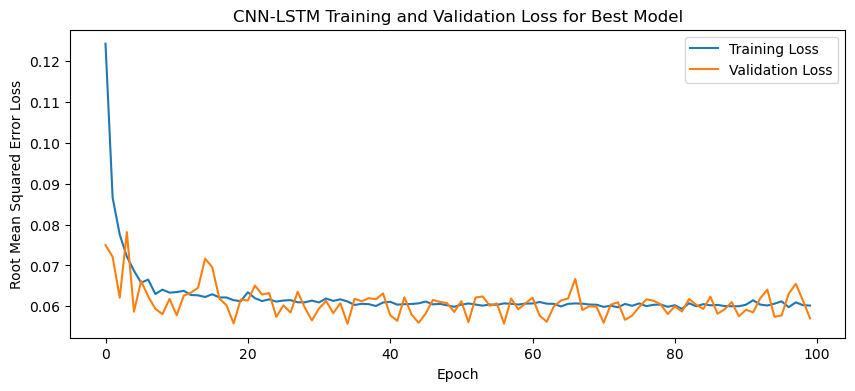

1/1 - 1s - loss: 0.0613 - 1s/epoch - 1s/step
Test Loss: 0.06125115230679512
1/1 [==============================] - 0s 33ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Specific Humidity\tPredicted Specific Humidity\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

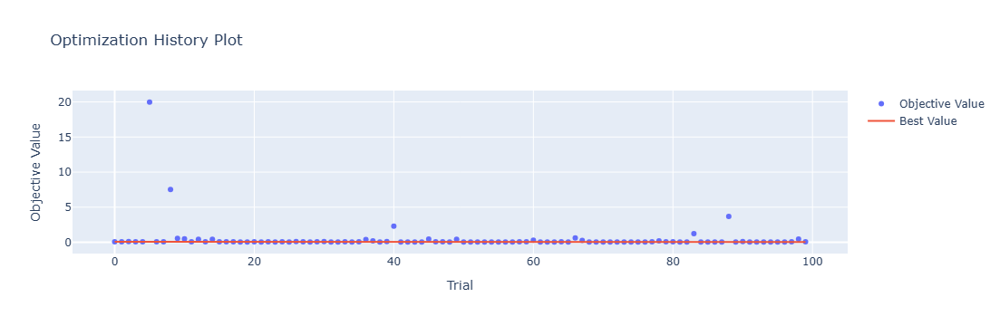

In [4]:
optuna.visualization.plot_optimization_history(study)

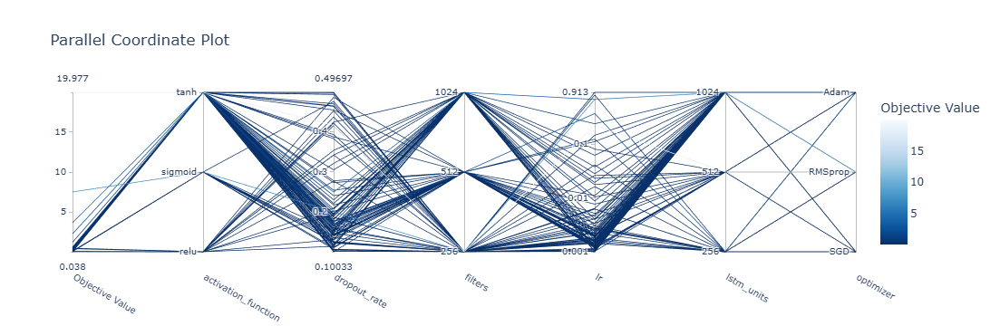

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

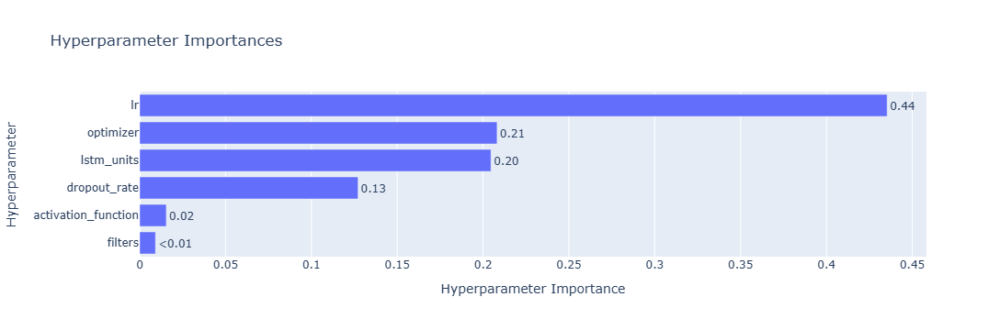

In [6]:
optuna.visualization.plot_param_importances(study)

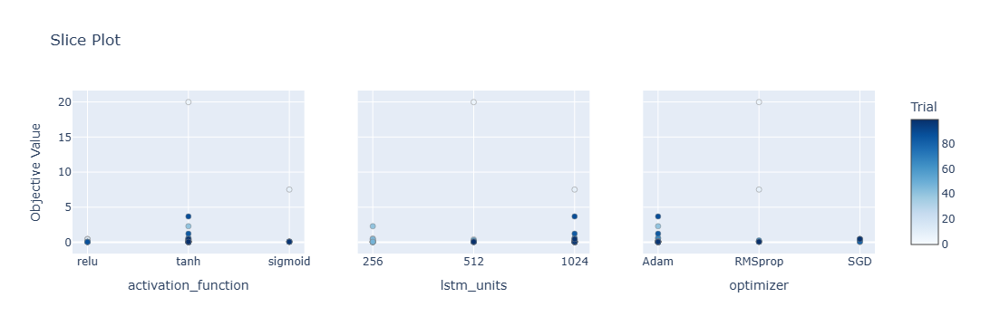

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

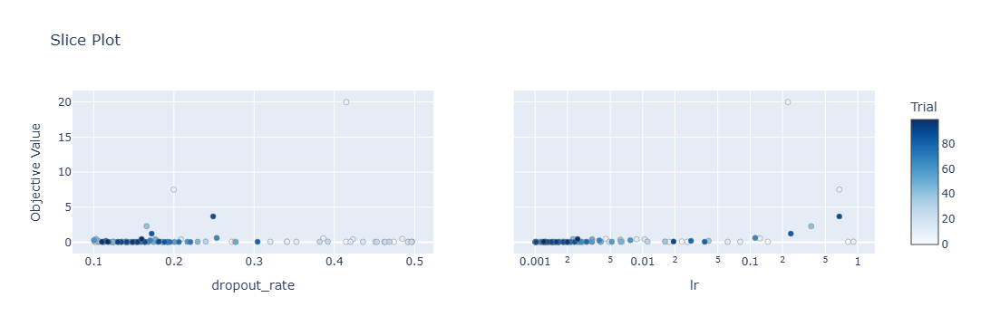

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 8s 42ms/step - loss: 0.1249 - accuracy: 0.2143 - mae: 0.1023 - rmse: 0.1249 - mape: 22.0598 - pearson: 0.5874 - val_loss: 0.0857 - val_accuracy: 0.7000 - val_mae: 0.0694 - val_rmse: 0.0857 - val_mape: 14.8452 - val_pearson: 0.7497
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0849 - accuracy: 0.2143 - mae: 0.0680 - rmse: 0.0849 - mape: 15.0392 - pearson: 0.7173 - val_loss: 0.0717 - val_accuracy: 0.3000 - val_mae: 0.0553 - val_rmse: 0.0717 - val_mape: 11.8258 - val_pearson: 0.7037
Epoch 3/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0767 - accuracy: 0.3690 - mae: 0.0611 - rmse: 0.0767 - mape: 13.4584 - pearson: 0.7490 - val_loss: 0.0687 - val_accuracy: 0.0000e+00 - val_mae: 0.0532 - val_rmse: 0.0687 - val_mape: 11.3373 - val_pearson: 0.7590
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0719 - accuracy: 0.4048 - mae: 0.0576 - rmse: 0.0719 - mape: 12.8390

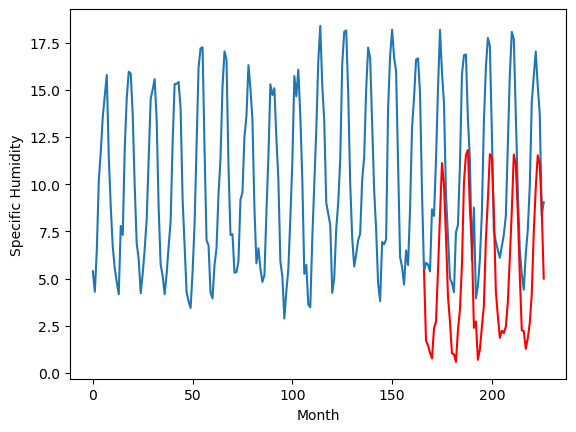

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		1.40		3.10
-1.37		1.16		2.53
-1.81		0.75		2.56
-1.08		0.46		1.54
2.80		2.05		-0.75
1.01		2.40		1.39
3.33		5.11		1.78
7.01		8.01		1.00
8.67		10.81		2.14
8.61		9.67		1.06
6.51		6.94		0.43
3.95		3.78		-0.17
0.62		2.39		1.77
-2.90		0.73		3.63
-2.55		0.68		3.23
-1.84		0.27		2.11
0.37		1.94		1.57
0.59		3.05		2.46
3.08		5.38		2.30
7.83		9.76		1.93
8.63		11.24		2.61
8.79		11.50		2.71
6.63		8.34		1.71
3.55		6.51		2.96
-2.11		2.08		4.19
1.53		2.42		0.89
-3.23		0.38		3.61
-2.01		0.94		2.95
-0.10		2.12		2.22
1.20		3.25		2.05
5.44		6.78		1.34
8.05		8.87		0.82
8.95		11.28		2.33
8.38		11.12		2.74
5.32		8.19		2.87
0.18		4.01		3.83
-0.02		2.70		2.72
-1.22		1.55		2.77
-1.13		1.92		3.05
0.56		1.80		1.24
0.94		2.13		1.19
1.73		3.44		1.71
3.92		5.78		1.86
7.25		8.29		1.04
8.92		11.27		2.35
9.70		10.72		1.02
5.68		8.18		2.50
0.98		4.86		3.88
-1.20		1.95		3.15
-2.64		1.90		4.54
-3.42		0.97		4.39
-2.20		1.52	

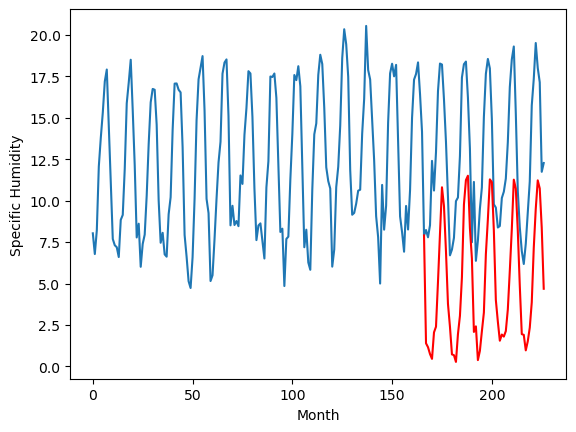

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		1.29		2.65
-1.11		1.05		2.16
-1.28		0.64		1.92
-0.73		0.35		1.08
1.87		1.94		0.07
0.62		2.29		1.67
3.48		5.00		1.52
7.39		7.90		0.51
9.79		10.70		0.91
9.88		9.56		-0.32
6.79		6.83		0.04
4.04		3.67		-0.37
0.71		2.28		1.57
-2.45		0.62		3.07
-2.07		0.57		2.64
-1.92		0.16		2.08
-0.07		1.83		1.90
0.17		2.94		2.77
2.93		5.27		2.34
7.55		9.65		2.10
9.46		11.13		1.67
9.66		11.39		1.73
6.66		8.23		1.57
3.94		6.40		2.46
-1.93		1.97		3.90
0.47		2.31		1.84
-2.94		0.27		3.21
-1.73		0.83		2.56
-1.02		2.01		3.03
0.43		3.14		2.71
4.57		6.67		2.10
7.35		8.76		1.41
9.55		11.17		1.62
8.85		11.01		2.16
5.12		8.08		2.96
0.12		3.90		3.78
-0.20		2.59		2.79
-1.53		1.44		2.97
-1.16		1.81		2.97
-0.05		1.69		1.74
-0.69		2.02		2.71
0.75		3.33		2.58
3.53		5.67		2.14
6.11		8.18		2.07
8.97		11.16		2.19
9.06		10.61		1.55
5.48		8.07		2.59
1.57		4.75		3.18
-0.96		1.84		2.80
-1.77		1.79		3.56
-2.57		0.86		3.43
-1.93		1.

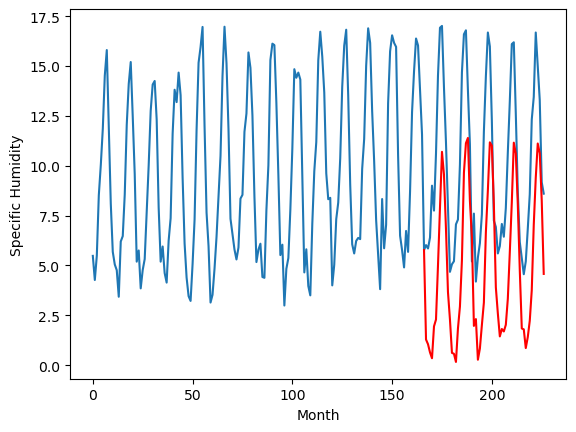

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		0.99		2.81
-1.28		0.75		2.03
-1.04		0.34		1.38
-0.90		0.05		0.95
3.41		1.64		-1.77
2.26		1.99		-0.27
4.41		4.70		0.29
6.90		7.60		0.70
9.65		10.40		0.75
8.40		9.26		0.86
7.05		6.53		-0.52
3.24		3.37		0.13
0.19		1.98		1.79
-2.88		0.32		3.20
-2.81		0.27		3.08
-2.90		-0.14		2.76
0.55		1.53		0.98
1.12		2.64		1.52
4.63		4.97		0.34
8.53		9.35		0.82
9.37		10.83		1.46
8.99		11.09		2.10
6.68		7.93		1.25
4.25		6.10		1.85
-1.96		1.67		3.63
1.09		2.01		0.92
-4.03		-0.03		4.00
-2.82		0.53		3.35
-1.73		1.71		3.44
1.19		2.84		1.65
5.43		6.37		0.94
7.44		8.46		1.02
8.65		10.87		2.22
7.93		10.71		2.78
4.55		7.78		3.23
-0.55		3.60		4.15
-1.07		2.29		3.36
-1.57		1.14		2.71
-1.38		1.51		2.89
-0.71		1.39		2.10
0.37		1.72		1.35
0.77		3.03		2.26
3.62		5.37		1.75
7.77		7.88		0.11
8.80		10.86		2.06
8.55		10.31		1.76
6.37		7.77		1.40
1.80		4.45		2.65
-1.19		1.54		2.73
-2.59		1.49		4.08
-3.51		0.56		4.07
-1.73		

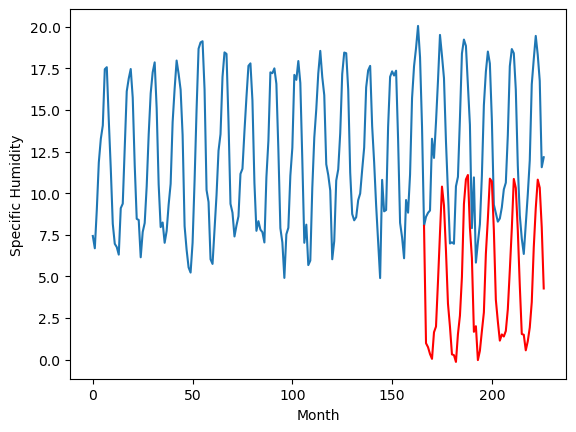

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.24		-0.01
1.00		2.00		1.00
1.79		1.59		-0.20
1.18		1.30		0.12
5.63		2.89		-2.74
5.35		3.24		-2.11
7.93		5.95		-1.98
10.29		8.85		-1.44
13.15		11.65		-1.50
10.88		10.51		-0.37
9.57		7.78		-1.79
5.29		4.62		-0.67
3.44		3.23		-0.21
0.66		1.57		0.91
0.59		1.52		0.93
0.19		1.11		0.92
3.03		2.78		-0.25
4.43		3.89		-0.54
8.44		6.22		-2.22
12.13		10.60		-1.53
12.84		12.08		-0.76
12.76		12.34		-0.42
8.53		9.18		0.65
6.44		7.35		0.91
2.22		2.92		0.70
4.98		3.26		-1.72
-0.52		1.22		1.74
-0.26		1.78		2.04
1.29		2.96		1.67
5.21		4.09		-1.12
8.91		7.62		-1.29
9.88		9.71		-0.17
9.64		12.12		2.48
10.73		11.96		1.23
7.90		9.03		1.13
3.10		4.85		1.75
3.09		3.54		0.45
2.01		2.39		0.38
1.25		2.76		1.51
1.59		2.64		1.05
3.78		2.97		-0.81
4.54		4.28		-0.26
8.48		6.62		-1.86
12.60		9.13		-3.47
11.18		12.11		0.93
9.36		11.56		2.20
9.32		9.02		-0.30
5.57		5.70		0.13
2.77		2.79		0.02
0.91		2.74		1.83
-0.27		1.

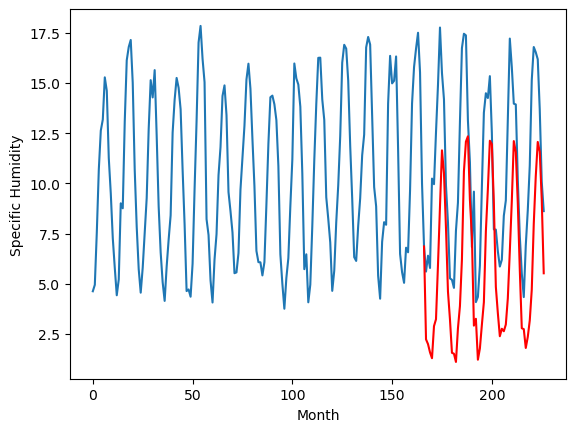

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		4.88		2.29
2.55		4.64		2.09
2.07		4.23		2.16
1.96		3.94		1.98
3.72		5.53		1.81
4.06		5.88		1.82
7.19		8.59		1.40
10.92		11.49		0.57
14.40		14.29		-0.11
14.43		13.15		-1.28
11.53		10.42		-1.11
7.83		7.26		-0.57
4.88		5.87		0.99
1.12		4.21		3.09
0.51		4.16		3.65
1.10		3.75		2.65
2.67		5.42		2.75
3.68		6.53		2.85
6.18		8.86		2.68
11.44		13.24		1.80
12.56		14.72		2.16
13.72		14.98		1.26
9.63		11.82		2.19
7.31		9.99		2.68
2.05		5.56		3.51
3.47		5.90		2.43
0.36		3.86		3.50
1.74		4.42		2.68
3.07		5.60		2.53
4.20		6.73		2.53
8.98		10.26		1.28
10.07		12.35		2.28
14.40		14.76		0.36
12.61		14.60		1.99
9.91		11.67		1.76
5.27		7.49		2.22
4.61		6.18		1.57
1.26		5.03		3.77
2.01		5.40		3.39
2.94		5.28		2.34
2.72		5.61		2.89
5.40		6.92		1.52
6.16		9.26		3.10
10.06		11.77		1.71
14.41		14.75		0.34
13.52		14.20		0.68
10.40		11.66		1.26
6.00		8.34		2.34
2.98		5.43		2.45
2.16		5.38		3.22
1.37		4.45		3.08
1.2

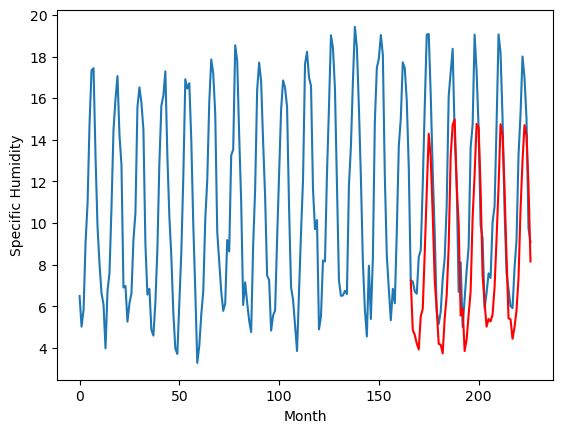

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		2.33		1.97
0.48		2.09		1.61
0.40		1.68		1.28
0.76		1.39		0.63
2.39		2.98		0.59
2.17		3.33		1.16
5.27		6.04		0.77
8.99		8.94		-0.05
11.78		11.74		-0.04
11.72		10.60		-1.12
8.19		7.87		-0.32
5.47		4.71		-0.76
2.62		3.32		0.70
-0.25		1.66		1.91
-0.40		1.61		2.01
-0.35		1.20		1.55
1.24		2.87		1.63
1.84		3.98		2.14
4.84		6.31		1.47
9.22		10.69		1.47
10.66		12.17		1.51
11.19		12.43		1.24
7.87		9.27		1.40
5.76		7.44		1.68
0.01		3.01		3.00
1.85		3.35		1.50
-0.93		1.31		2.24
0.35		1.87		1.52
1.36		3.05		1.69
2.36		4.18		1.82
6.72		7.71		0.99
8.60		9.80		1.20
12.22		12.21		-0.01
10.87		12.05		1.18
7.43		9.12		1.69
2.87		4.94		2.07
2.27		3.63		1.36
0.09		2.48		2.39
0.95		2.85		1.90
1.63		2.73		1.10
1.22		3.06		1.84
3.43		4.37		0.94
5.02		6.71		1.69
7.75		9.22		1.47
11.49		12.20		0.71
11.12		11.65		0.53
8.18		9.11		0.93
3.92		5.79		1.87
0.59		2.88		2.29
0.52		2.83		2.31
-0.15		1.90		2.05
0.01		2.45

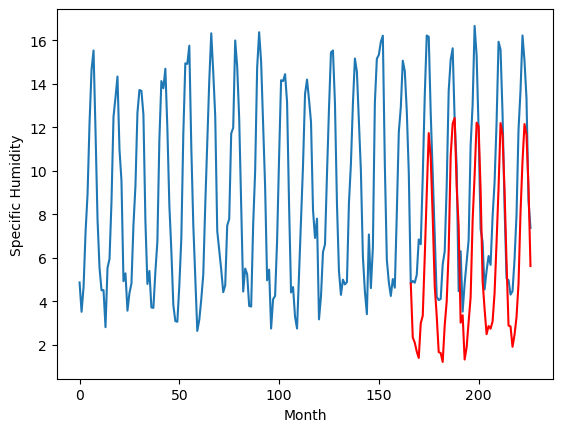

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		4.28		1.76
2.77		4.04		1.27
2.80		3.63		0.83
3.02		3.34		0.32
4.32		4.93		0.61
4.26		5.28		1.02
6.25		7.99		1.74
10.92		10.89		-0.03
13.73		13.69		-0.04
13.97		12.55		-1.42
10.07		9.82		-0.25
7.36		6.66		-0.70
4.82		5.27		0.45
1.95		3.61		1.66
1.64		3.56		1.92
1.67		3.15		1.48
3.29		4.82		1.53
3.99		5.93		1.94
7.01		8.26		1.25
11.28		12.64		1.36
12.78		14.12		1.34
13.06		14.38		1.32
9.57		11.22		1.65
7.69		9.39		1.70
1.90		4.96		3.06
3.67		5.30		1.63
1.16		3.26		2.10
2.39		3.82		1.43
3.38		5.00		1.62
4.28		6.13		1.85
8.57		9.66		1.09
10.02		11.75		1.73
13.39		14.16		0.77
12.32		14.00		1.68
9.53		11.07		1.54
5.11		6.89		1.78
4.41		5.58		1.17
2.07		4.43		2.36
3.00		4.80		1.80
3.36		4.68		1.32
3.28		5.01		1.73
5.56		6.32		0.76
6.88		8.66		1.78
9.50		11.17		1.67
13.85		14.15		0.30
12.79		13.60		0.81
9.99		11.06		1.07
6.24		7.74		1.50
2.72		4.83		2.11
2.92		4.78		1.86
2.23		3.85		1.62
2.26		

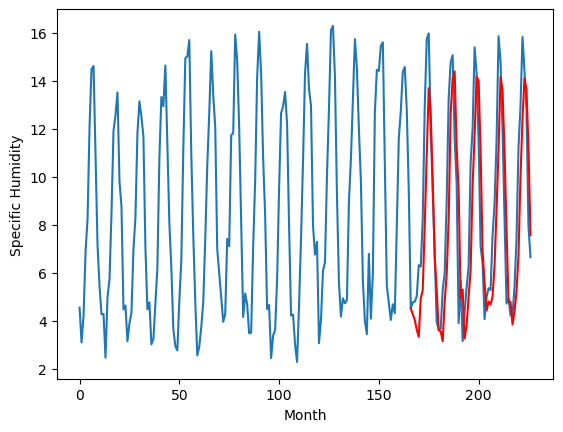

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.48		0.13
1.44		1.24		-0.20
1.04		0.83		-0.21
1.03		0.54		-0.49
3.29		2.13		-1.16
3.53		2.48		-1.05
6.75		5.19		-1.56
10.40		8.09		-2.31
13.49		10.89		-2.60
11.46		9.75		-1.71
8.74		7.02		-1.72
4.29		3.86		-0.43
2.53		2.47		-0.06
0.62		0.81		0.19
0.39		0.76		0.37
-0.29		0.35		0.64
2.77		2.02		-0.75
3.50		3.13		-0.37
6.41		5.46		-0.95
11.39		9.84		-1.55
12.89		11.32		-1.57
13.08		11.58		-1.50
9.27		8.42		-0.85
6.85		6.59		-0.26
1.56		2.16		0.60
3.15		2.50		-0.65
-0.13		0.46		0.59
0.46		1.02		0.56
2.14		2.20		0.06
3.72		3.33		-0.39
7.91		6.86		-1.05
10.09		8.95		-1.14
13.75		11.36		-2.39
12.78		11.20		-1.58
8.33		8.27		-0.06
3.10		4.09		0.99
2.10		2.78		0.68
1.17		1.63		0.46
1.77		2.00		0.23
1.84		1.88		0.04
2.28		2.21		-0.07
3.50		3.52		0.02
6.99		5.86		-1.13
9.27		8.37		-0.90
12.82		11.35		-1.47
12.82		10.80		-2.02
8.75		8.26		-0.49
4.69		4.94		0.25
2.03		2.03		-0.00
1.42		1.98		0.56
0

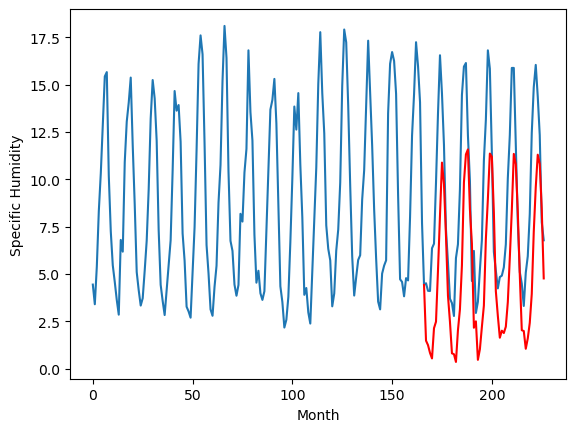

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		3.35		0.51
3.25		3.11		-0.14
2.75		2.70		-0.05
2.43		2.41		-0.02
4.39		4.00		-0.39
4.45		4.35		-0.10
7.59		7.06		-0.53
10.28		9.96		-0.32
13.42		12.76		-0.66
12.20		11.62		-0.58
9.41		8.89		-0.52
6.07		5.73		-0.34
4.02		4.34		0.32
2.36		2.68		0.32
2.03		2.63		0.60
1.58		2.22		0.64
3.38		3.89		0.51
4.70		5.00		0.30
6.79		7.33		0.54
11.56		11.71		0.15
12.49		13.19		0.70
12.91		13.45		0.54
9.74		10.29		0.55
8.43		8.46		0.03
2.91		4.03		1.12
3.75		4.37		0.62
1.46		2.33		0.87
2.20		2.89		0.69
3.48		4.07		0.59
5.10		5.20		0.10
9.71		8.73		-0.98
11.39		10.82		-0.57
14.97		13.23		-1.74
13.43		13.07		-0.36
10.37		10.14		-0.23
4.58		5.96		1.38
3.86		4.65		0.79
2.93		3.50		0.57
3.54		3.87		0.33
3.31		3.75		0.44
3.41		4.08		0.67
5.14		5.39		0.25
7.58		7.73		0.15
10.20		10.24		0.04
14.02		13.22		-0.80
12.72		12.67		-0.05
10.00		10.13		0.13
6.76		6.81		0.05
3.41		3.90		0.49
3.60		3.85		0.25
2.63		2.

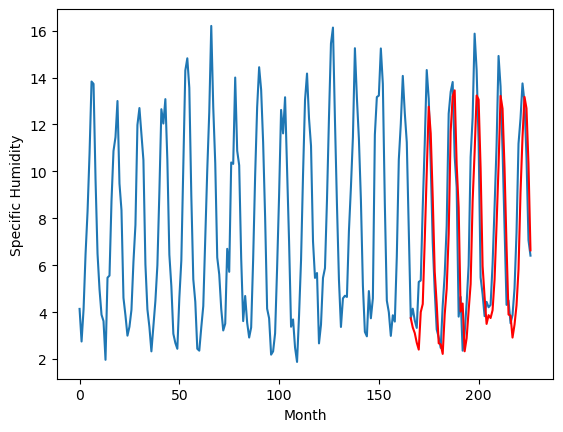

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		1.71		0.50
1.33		1.47		0.14
0.95		1.06		0.11
0.44		0.77		0.33
2.04		2.36		0.32
2.40		2.71		0.31
5.30		5.42		0.12
8.40		8.32		-0.08
11.45		11.12		-0.33
9.88		9.98		0.10
7.22		7.25		0.03
3.77		4.09		0.32
2.36		2.70		0.34
0.83		1.04		0.21
0.45		0.99		0.54
-0.29		0.58		0.87
1.33		2.25		0.92
2.93		3.36		0.43
4.45		5.69		1.24
9.58		10.07		0.49
10.65		11.55		0.90
11.14		11.81		0.67
7.52		8.65		1.13
6.53		6.82		0.29
1.68		2.39		0.71
1.68		2.73		1.05
-0.39		0.69		1.08
0.21		1.25		1.04
1.46		2.43		0.97
2.40		3.56		1.16
6.12		7.09		0.97
7.39		9.18		1.79
9.88		11.59		1.71
10.87		11.43		0.56
8.27		8.50		0.23
3.25		4.32		1.07
2.11		3.01		0.90
0.94		1.86		0.92
1.34		2.23		0.89
0.78		2.11		1.33
1.24		2.44		1.20
2.88		3.75		0.87
4.09		6.09		2.00
7.10		8.60		1.50
10.93		11.58		0.65
10.18		11.03		0.85
8.87		8.49		-0.38
5.11		5.17		0.06
1.70		2.26		0.56
2.23		2.21		-0.02
0.71		1.28		0.57
1.24		1.83		0.59


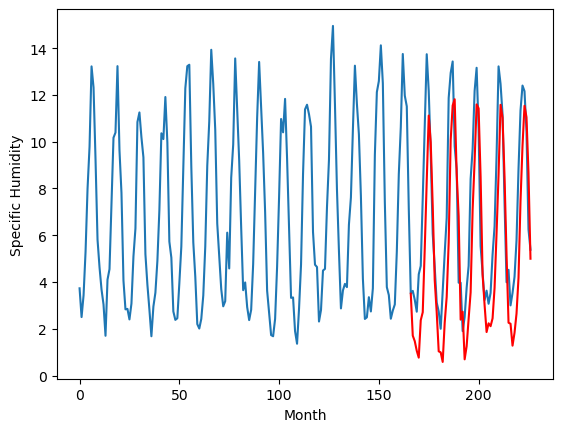

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[1.706065998077393, 1.3960659980773924, 1.2860650444030766, 0.9860669517517087, 2.236067667007446, 4.876065521240234, 2.3260650444030766, 4.276065521240234, 1.476065044403076, 3.346064567565918, 1.7060645675659183]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   1.706066
1                 1   -1.70   1.396066
2                 2   -1.36   1.286065
3                 3   -1.82   0.986067
4                 4    2.25   2.236068
5                 5    2.59   4.876066
6                 6    0.36   2.326065
7                 7    2.52   4.276066
8                 8    1.35   1.476065
9                 9    2.84   3.346065
10               10    1.21   1.706065


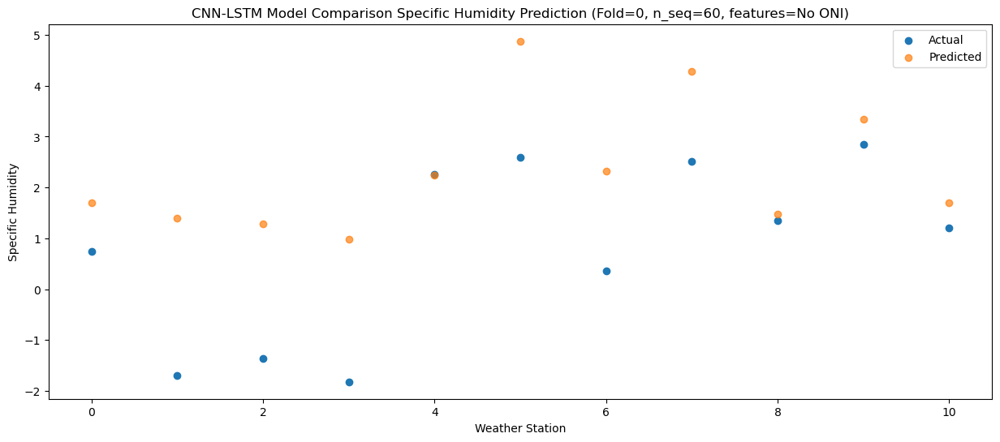

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18   1.469795
1                 1   -1.37   1.159796
2                 2   -1.11   1.049795
3                 3   -1.28   0.749797
4                 4    1.00   1.999797
5                 5    2.55   4.639795
6                 6    0.48   2.089794
7                 7    2.77   4.039796
8                 8    1.44   1.239795
9                 9    3.25   3.109794
10               10    1.33   1.469794


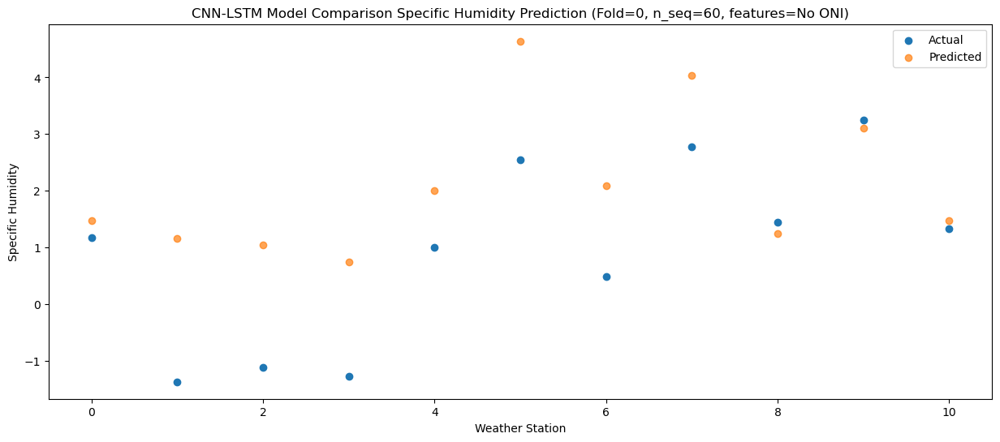

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09   1.059299
1                 1   -1.81   0.749300
2                 2   -1.28   0.639299
3                 3   -1.04   0.339301
4                 4    1.79   1.589299
5                 5    2.07   4.229298
6                 6    0.40   1.679298
7                 7    2.80   3.629298
8                 8    1.04   0.829299
9                 9    2.75   2.699297
10               10    0.95   1.059297


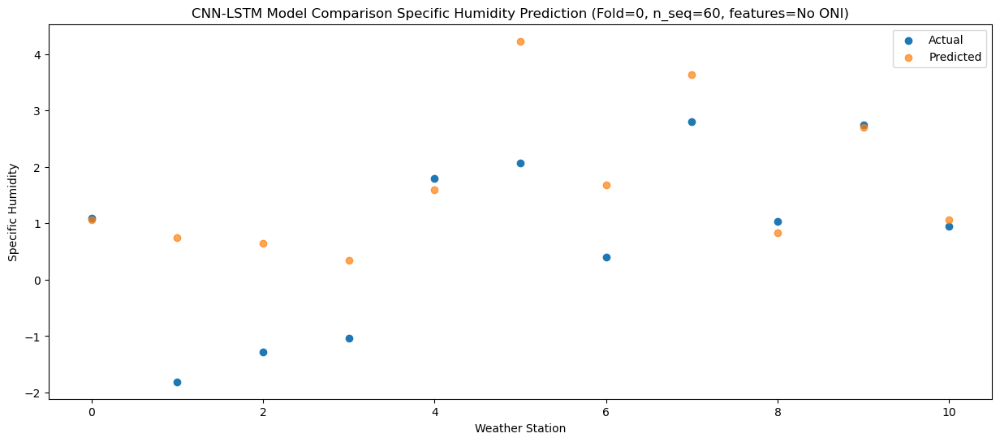

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73   0.766507
1                 1   -1.08   0.456508
2                 2   -0.73   0.346507
3                 3   -0.90   0.046509
4                 4    1.18   1.296509
5                 5    1.96   3.936507
6                 6    0.76   1.386506
7                 7    3.02   3.336506
8                 8    1.03   0.536508
9                 9    2.43   2.406506
10               10    0.44   0.766506


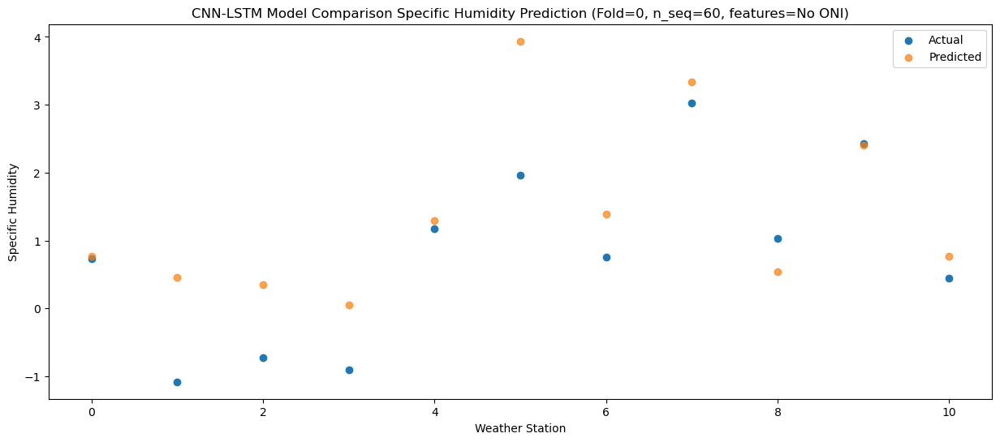

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   2.364871
1                 1    2.80   2.054871
2                 2    1.87   1.944871
3                 3    3.41   1.644872
4                 4    5.63   2.894872
5                 5    3.72   5.534868
6                 6    2.39   2.984869
7                 7    4.32   4.934870
8                 8    3.29   2.134872
9                 9    4.39   4.004869
10               10    2.04   2.364870


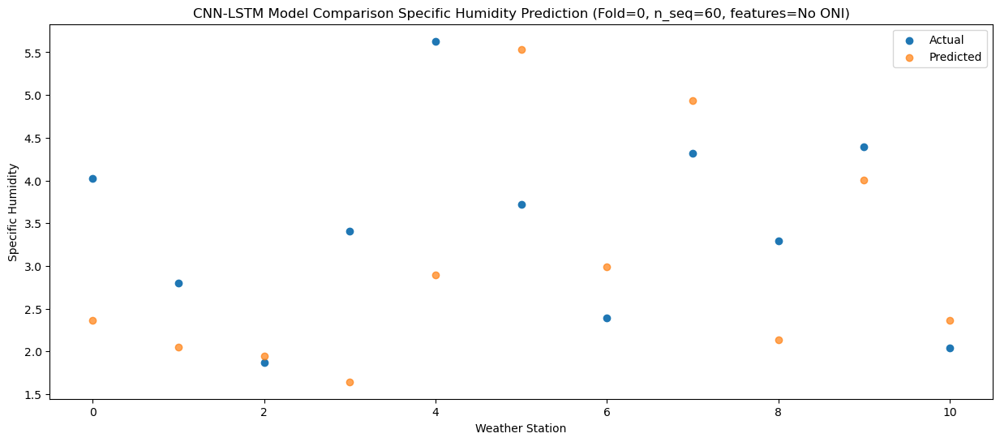

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67   2.707222
1                 1    1.01   2.397222
2                 2    0.62   2.287222
3                 3    2.26   1.987223
4                 4    5.35   3.237224
5                 5    4.06   5.877219
6                 6    2.17   3.327221
7                 7    4.26   5.277223
8                 8    3.53   2.477223
9                 9    4.45   4.347222
10               10    2.40   2.707222


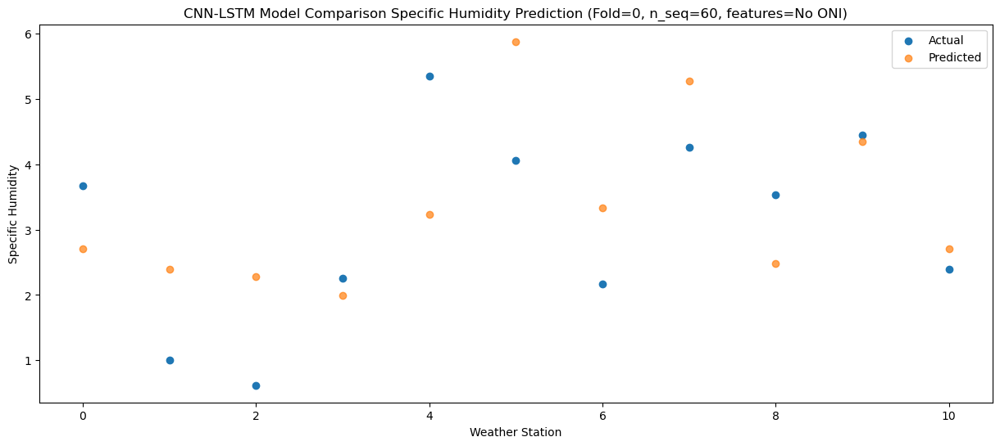

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   5.419339
1                 1    3.33   5.109339
2                 2    3.48   4.999339
3                 3    4.41   4.699340
4                 4    7.93   5.949339
5                 5    7.19   8.589336
6                 6    5.27   6.039339
7                 7    6.25   7.989341
8                 8    6.75   5.189341
9                 9    7.59   7.059340
10               10    5.30   5.419339


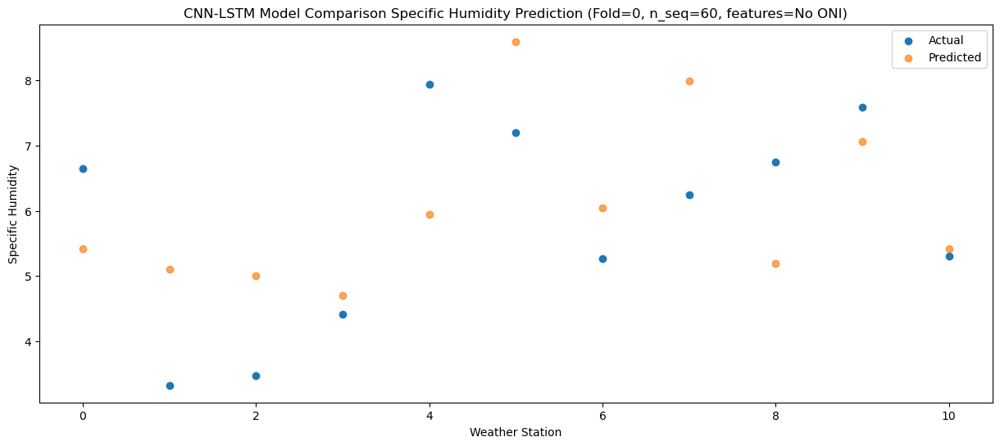

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40   8.320495
1                 1    7.01   8.010495
2                 2    7.39   7.900493
3                 3    6.90   7.600494
4                 4   10.29   8.850494
5                 5   10.92  11.490491
6                 6    8.99   8.940494
7                 7   10.92  10.890497
8                 8   10.40   8.090497
9                 9   10.28   9.960496
10               10    8.40   8.320495


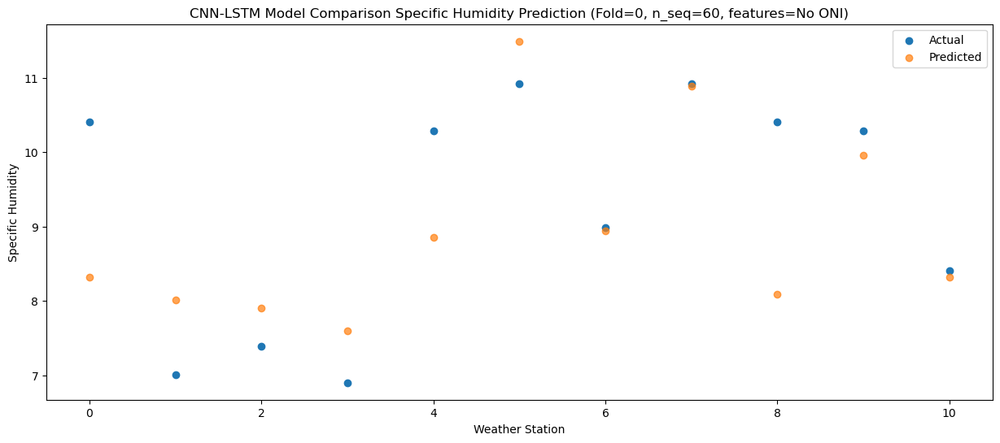

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  11.116504
1                 1    8.67  10.806504
2                 2    9.79  10.696500
3                 3    9.65  10.396502
4                 4   13.15  11.646502
5                 5   14.40  14.286499
6                 6   11.78  11.736502
7                 7   13.73  13.686506
8                 8   13.49  10.886504
9                 9   13.42  12.756504
10               10   11.45  11.116504


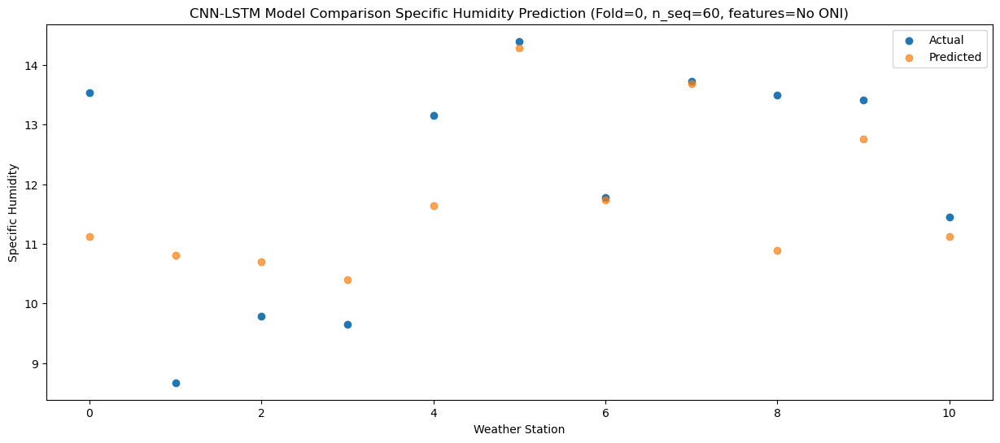

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28   9.977172
1                 1    8.61   9.667173
2                 2    9.88   9.557168
3                 3    8.40   9.257170
4                 4   10.88  10.507169
5                 5   14.43  13.147166
6                 6   11.72  10.597170
7                 7   13.97  12.547173
8                 8   11.46   9.747172
9                 9   12.20  11.617172
10               10    9.88   9.977171


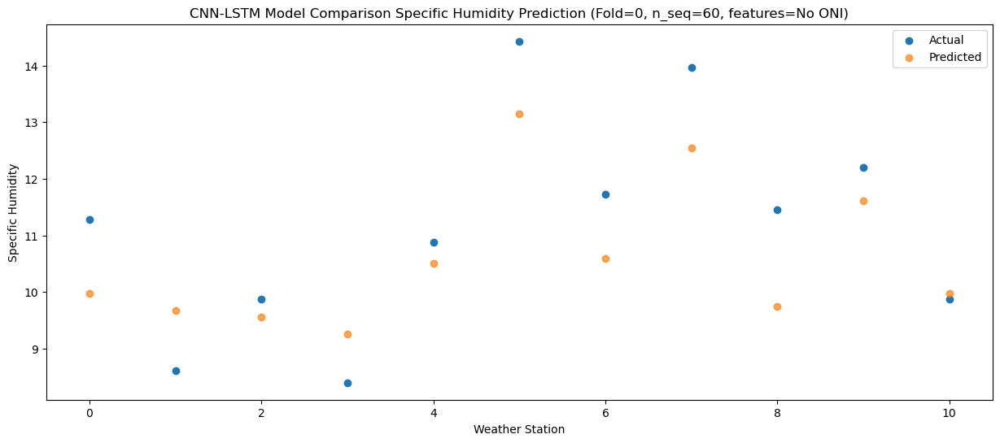

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   7.254605
1                 1    6.51   6.944606
2                 2    6.79   6.834602
3                 3    7.05   6.534603
4                 4    9.57   7.784603
5                 5   11.53  10.424602
6                 6    8.19   7.874605
7                 7   10.07   9.824610
8                 8    8.74   7.024607
9                 9    9.41   8.894608
10               10    7.22   7.254607


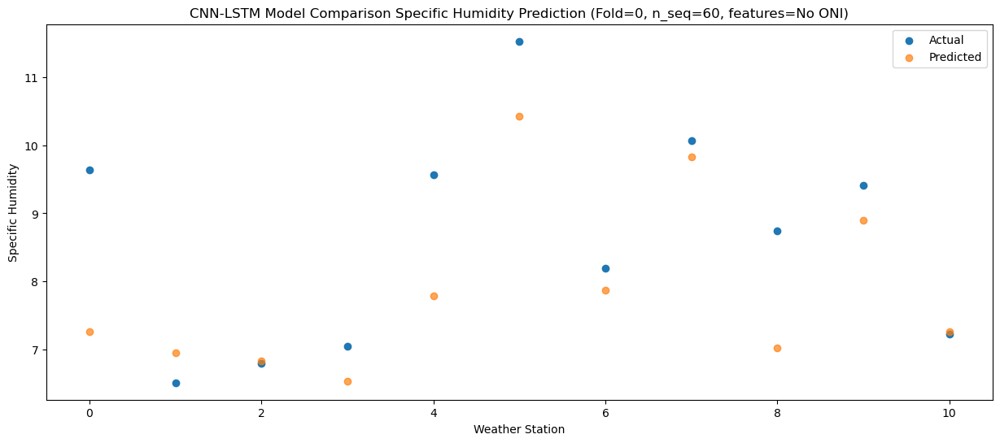

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   4.085215
1                 1    3.95   3.775217
2                 2    4.04   3.665213
3                 3    3.24   3.365214
4                 4    5.29   4.615214
5                 5    7.83   7.255212
6                 6    5.47   4.705215
7                 7    7.36   6.655220
8                 8    4.29   3.855217
9                 9    6.07   5.725218
10               10    3.77   4.085216


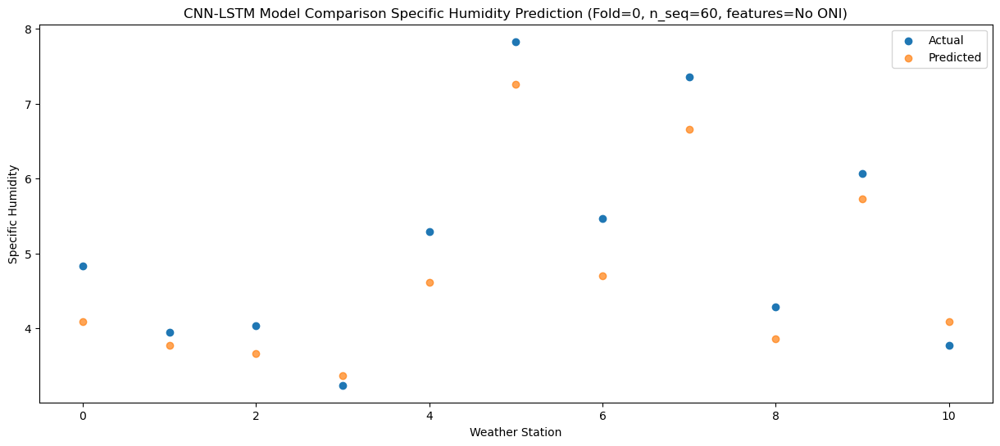

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   2.701863
1                 1    0.62   2.391864
2                 2    0.71   2.281861
3                 3    0.19   1.981862
4                 4    3.44   3.231862
5                 5    4.88   5.871859
6                 6    2.62   3.321862
7                 7    4.82   5.271868
8                 8    2.53   2.471865
9                 9    4.02   4.341867
10               10    2.36   2.701864


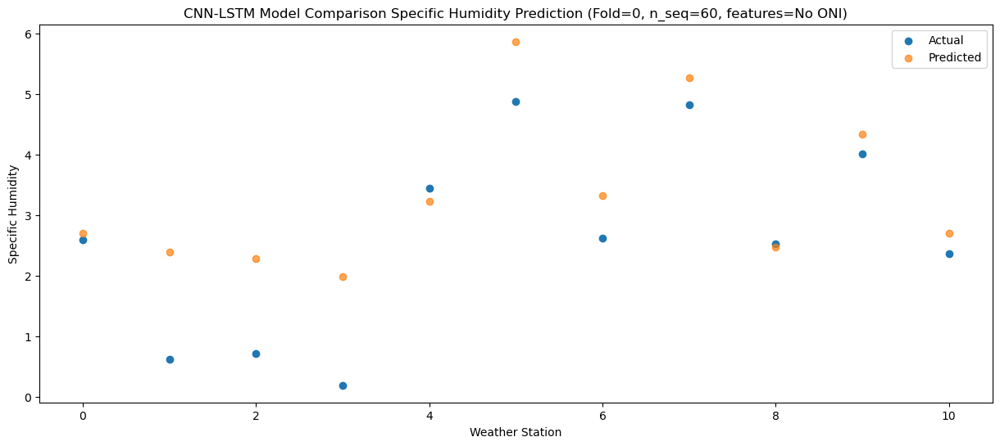

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36   1.035885
1                 1   -2.90   0.725886
2                 2   -2.45   0.615884
3                 3   -2.88   0.315883
4                 4    0.66   1.565883
5                 5    1.12   4.205881
6                 6   -0.25   1.655885
7                 7    1.95   3.605890
8                 8    0.62   0.805888
9                 9    2.36   2.675891
10               10    0.83   1.035888


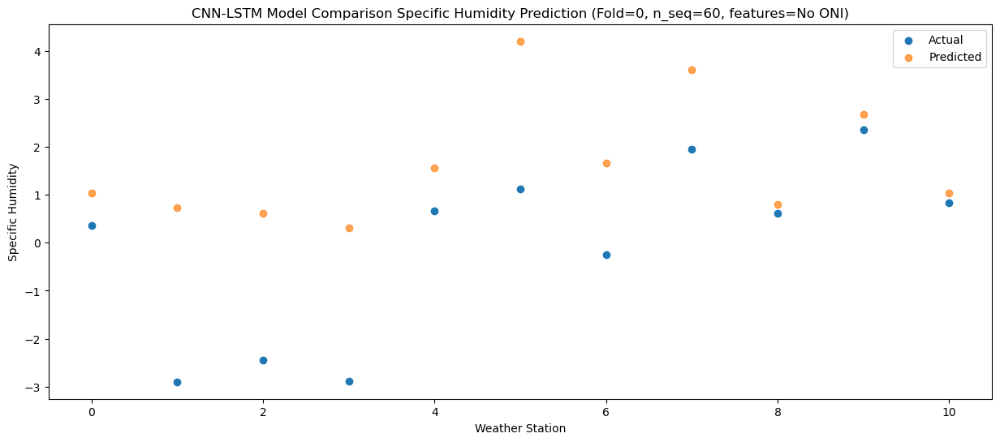

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12   0.990539
1                 1   -2.55   0.680541
2                 2   -2.07   0.570538
3                 3   -2.81   0.270537
4                 4    0.59   1.520536
5                 5    0.51   4.160536
6                 6   -0.40   1.610539
7                 7    1.64   3.560546
8                 8    0.39   0.760543
9                 9    2.03   2.630546
10               10    0.45   0.990543


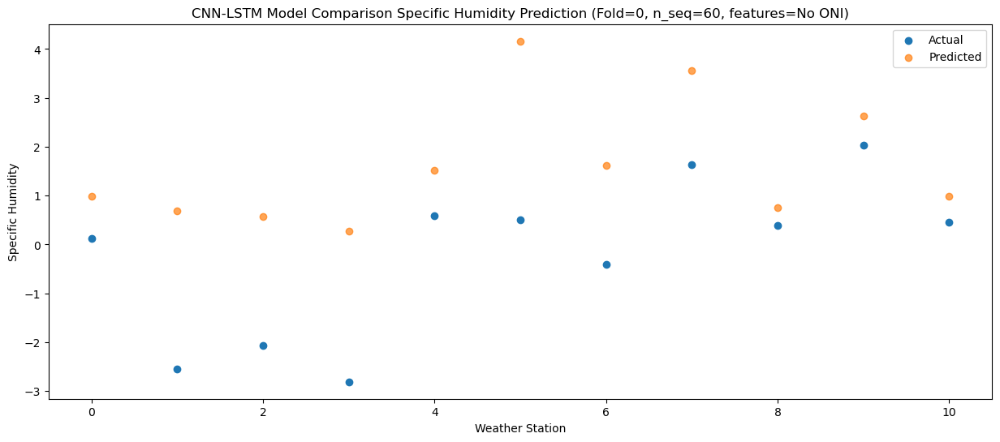

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37   0.582252
1                 1   -1.84   0.272253
2                 2   -1.92   0.162251
3                 3   -2.90  -0.137750
4                 4    0.19   1.112250
5                 5    1.10   3.752248
6                 6   -0.35   1.202252
7                 7    1.67   3.152258
8                 8   -0.29   0.352256
9                 9    1.58   2.222258
10               10   -0.29   0.582256


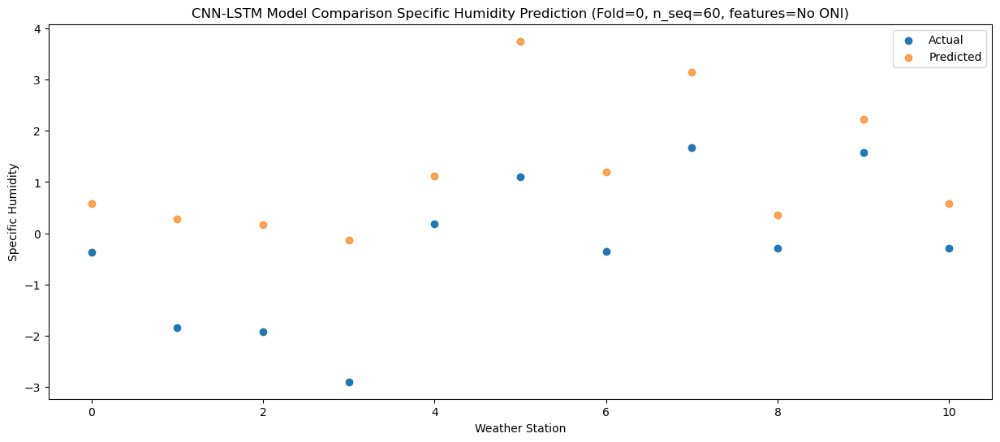

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   2.253830
1                 1    0.37   1.943833
2                 2   -0.07   1.833829
3                 3    0.55   1.533829
4                 4    3.03   2.783828
5                 5    2.67   5.423825
6                 6    1.24   2.873830
7                 7    3.29   4.823836
8                 8    2.77   2.023835
9                 9    3.38   3.893836
10               10    1.33   2.253832


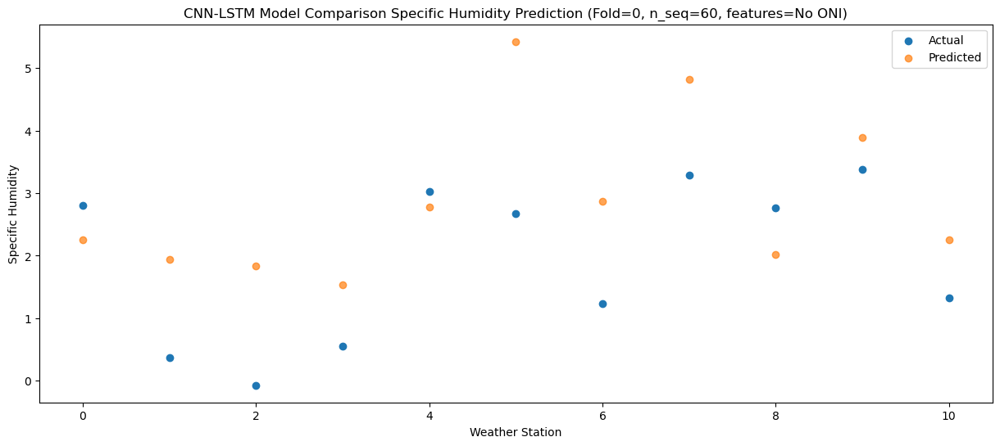

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19   3.361467
1                 1    0.59   3.051470
2                 2    0.17   2.941467
3                 3    1.12   2.641466
4                 4    4.43   3.891465
5                 5    3.68   6.531463
6                 6    1.84   3.981468
7                 7    3.99   5.931475
8                 8    3.50   3.131473
9                 9    4.70   5.001476
10               10    2.93   3.361471


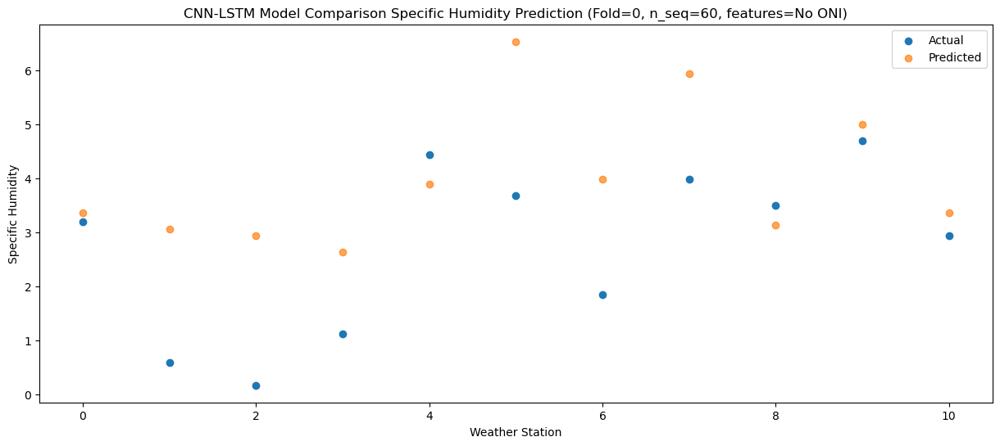

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   5.690075
1                 1    3.08   5.380077
2                 2    2.93   5.270075
3                 3    4.63   4.970074
4                 4    8.44   6.220074
5                 5    6.18   8.860072
6                 6    4.84   6.310077
7                 7    7.01   8.260084
8                 8    6.41   5.460080
9                 9    6.79   7.330084
10               10    4.45   5.690080


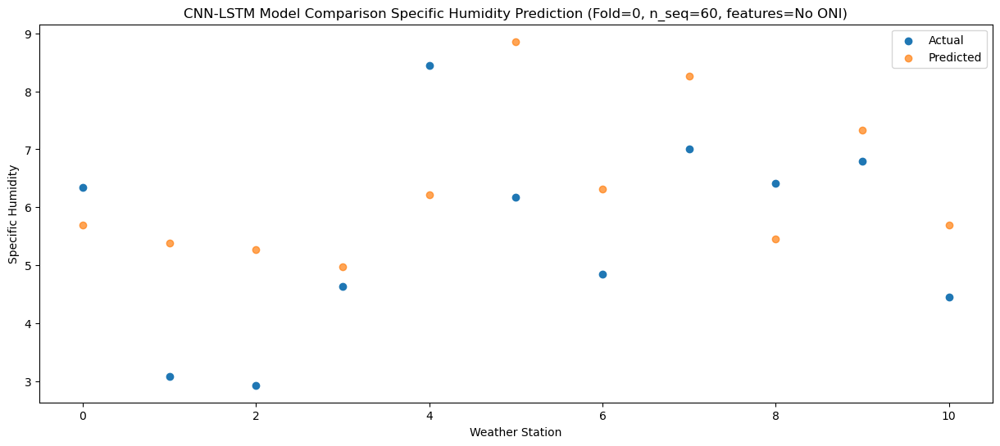

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15  10.067796
1                 1    7.83   9.757796
2                 2    7.55   9.647794
3                 3    8.53   9.347794
4                 4   12.13  10.597793
5                 5   11.44  13.237789
6                 6    9.22  10.687795
7                 7   11.28  12.637802
8                 8   11.39   9.837798
9                 9   11.56  11.707802
10               10    9.58  10.067799


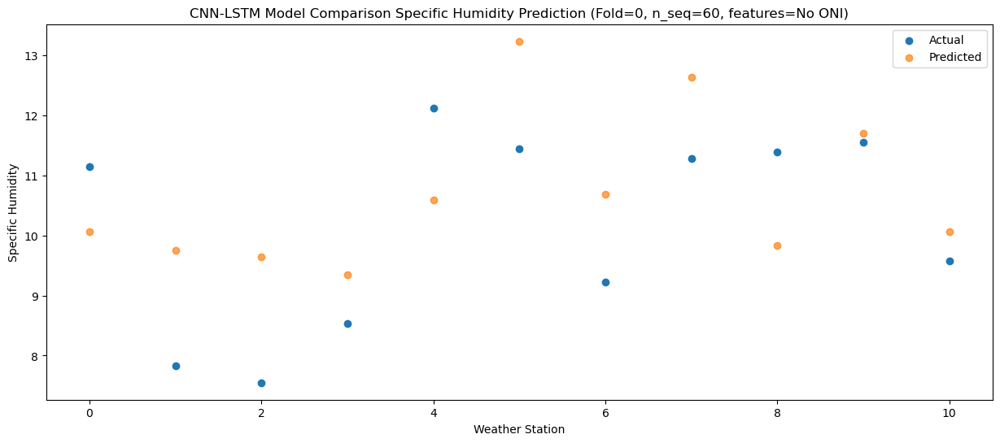

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18  11.548822
1                 1    8.63  11.238821
2                 2    9.46  11.128818
3                 3    9.37  10.828820
4                 4   12.84  12.078816
5                 5   12.56  14.718811
6                 6   10.66  12.168817
7                 7   12.78  14.118824
8                 8   12.89  11.318821
9                 9   12.49  13.188824
10               10   10.65  11.548820


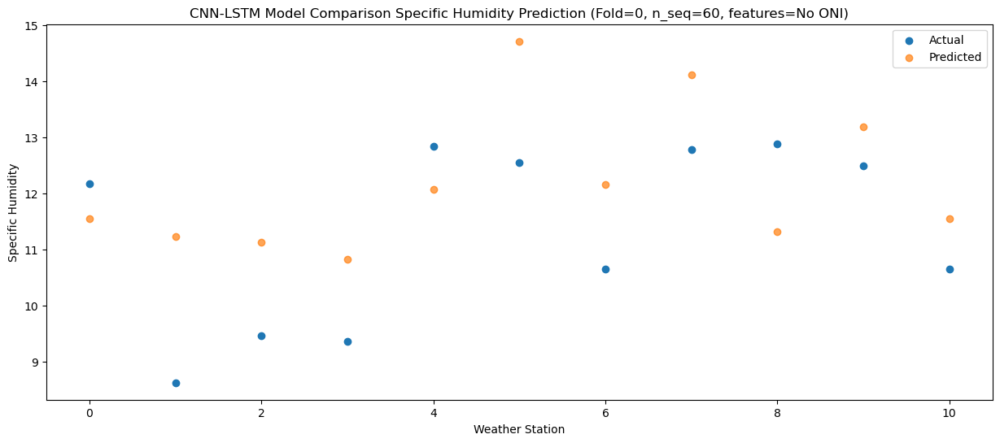

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23  11.814034
1                 1    8.79  11.504032
2                 2    9.66  11.394030
3                 3    8.99  11.094031
4                 4   12.76  12.344029
5                 5   13.72  14.984022
6                 6   11.19  12.434029
7                 7   13.06  14.384035
8                 8   13.08  11.584032
9                 9   12.91  13.454035
10               10   11.14  11.814031


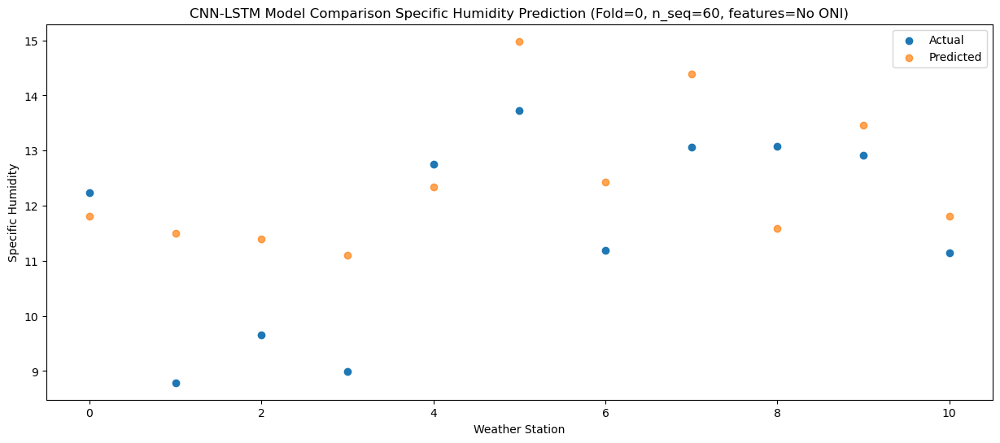

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81   8.651688
1                 1    6.63   8.341687
2                 2    6.66   8.231683
3                 3    6.68   7.931686
4                 4    8.53   9.181684
5                 5    9.63  11.821675
6                 6    7.87   9.271682
7                 7    9.57  11.221688
8                 8    9.27   8.421686
9                 9    9.74  10.291688
10               10    7.52   8.651684


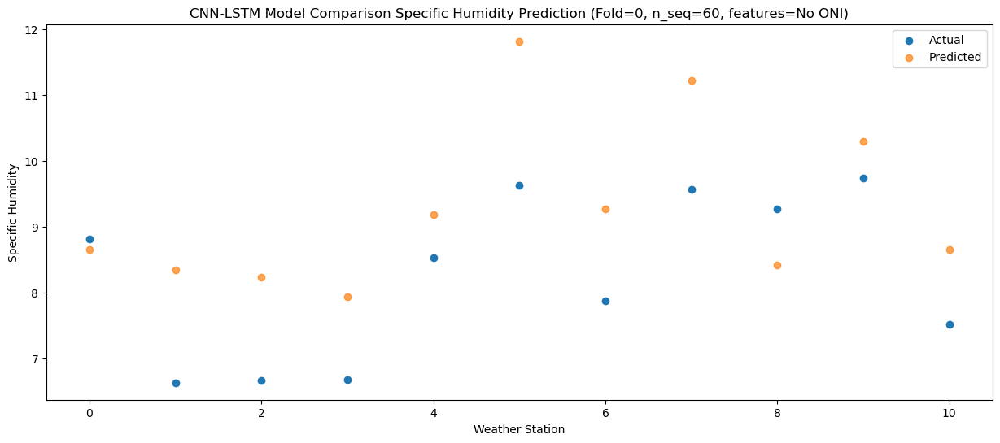

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   6.819900
1                 1    3.55   6.509898
2                 2    3.94   6.399894
3                 3    4.25   6.099898
4                 4    6.44   7.349897
5                 5    7.31   9.989886
6                 6    5.76   7.439892
7                 7    7.69   9.389899
8                 8    6.85   6.589897
9                 9    8.43   8.459899
10               10    6.53   6.819895


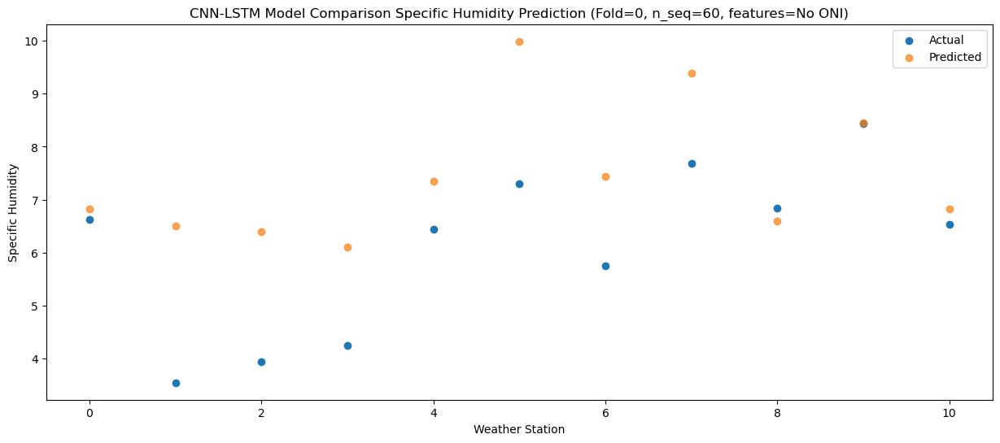

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33   2.389665
1                 1   -2.11   2.079664
2                 2   -1.93   1.969658
3                 3   -1.96   1.669664
4                 4    2.22   2.919662
5                 5    2.05   5.559652
6                 6    0.01   3.009657
7                 7    1.90   4.959664
8                 8    1.56   2.159663
9                 9    2.91   4.029664
10               10    1.68   2.389660


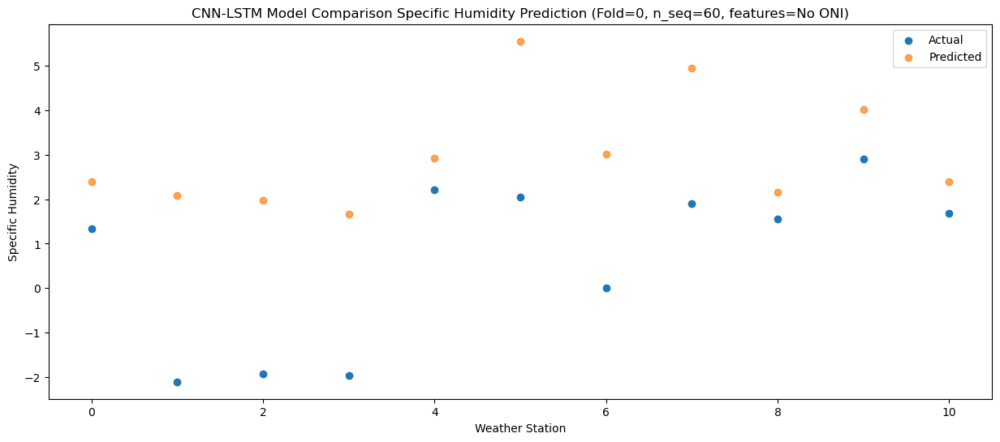

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   2.729157
1                 1    1.53   2.419156
2                 2    0.47   2.309150
3                 3    1.09   2.009155
4                 4    4.98   3.259152
5                 5    3.47   5.899143
6                 6    1.85   3.349149
7                 7    3.67   5.299155
8                 8    3.15   2.499154
9                 9    3.75   4.369155
10               10    1.68   2.729150


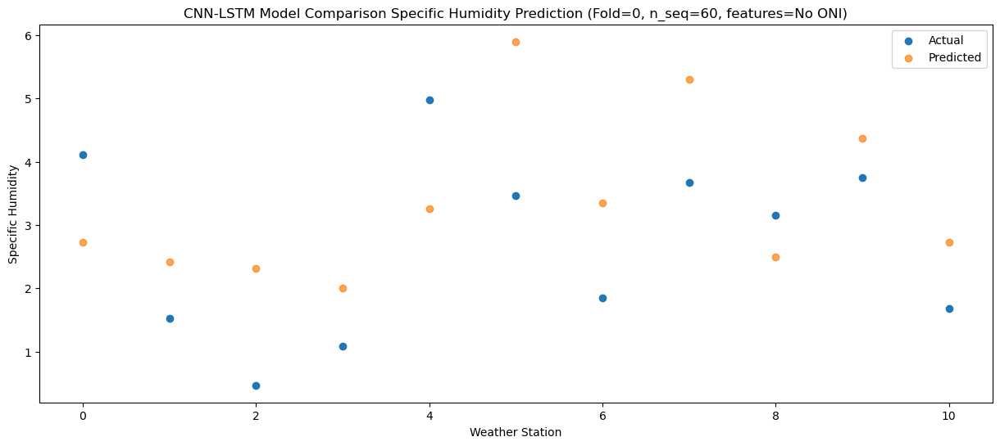

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70   0.692829
1                 1   -3.23   0.382827
2                 2   -2.94   0.272823
3                 3   -4.03  -0.027173
4                 4   -0.52   1.222825
5                 5    0.36   3.862815
6                 6   -0.93   1.312822
7                 7    1.16   3.262827
8                 8   -0.13   0.462827
9                 9    1.46   2.332828
10               10   -0.39   0.692822


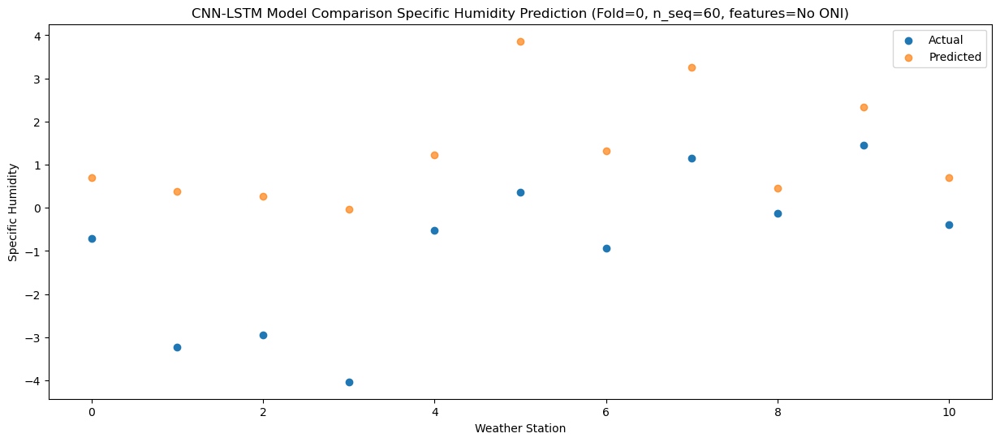

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04   1.252793
1                 1   -2.01   0.942791
2                 2   -1.73   0.832788
3                 3   -2.82   0.532790
4                 4   -0.26   1.782789
5                 5    1.74   4.422779
6                 6    0.35   1.872788
7                 7    2.39   3.822792
8                 8    0.46   1.022791
9                 9    2.20   2.892793
10               10    0.21   1.252788


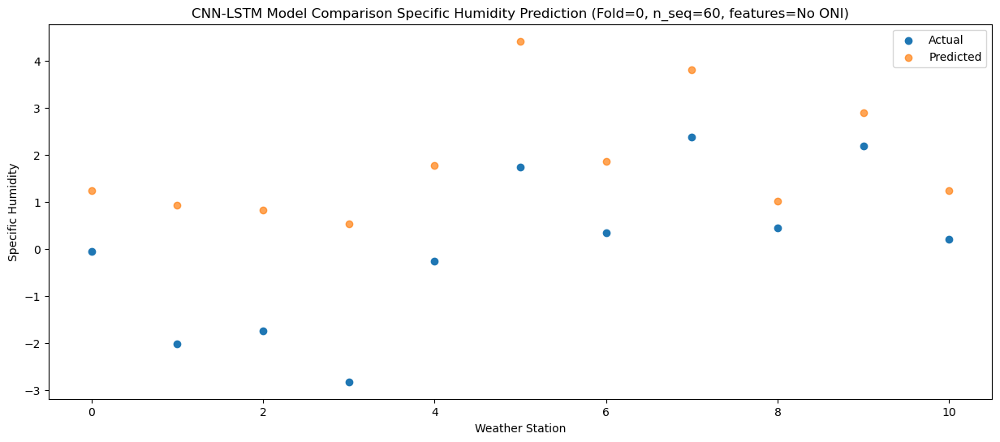

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36   2.431069
1                 1   -0.10   2.121067
2                 2   -1.02   2.011063
3                 3   -1.73   1.711064
4                 4    1.29   2.961064
5                 5    3.07   5.601055
6                 6    1.36   3.051063
7                 7    3.38   5.001067
8                 8    2.14   2.201067
9                 9    3.48   4.071070
10               10    1.46   2.431064


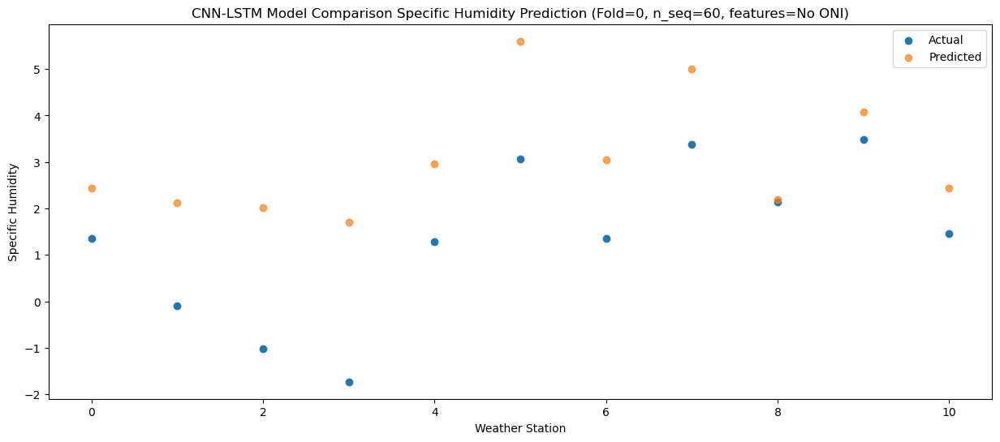

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   3.557752
1                 1    1.20   3.247751
2                 2    0.43   3.137747
3                 3    1.19   2.837746
4                 4    5.21   4.087743
5                 5    4.20   6.727738
6                 6    2.36   4.177747
7                 7    4.28   6.127751
8                 8    3.72   3.327750
9                 9    5.10   5.197753
10               10    2.40   3.557748


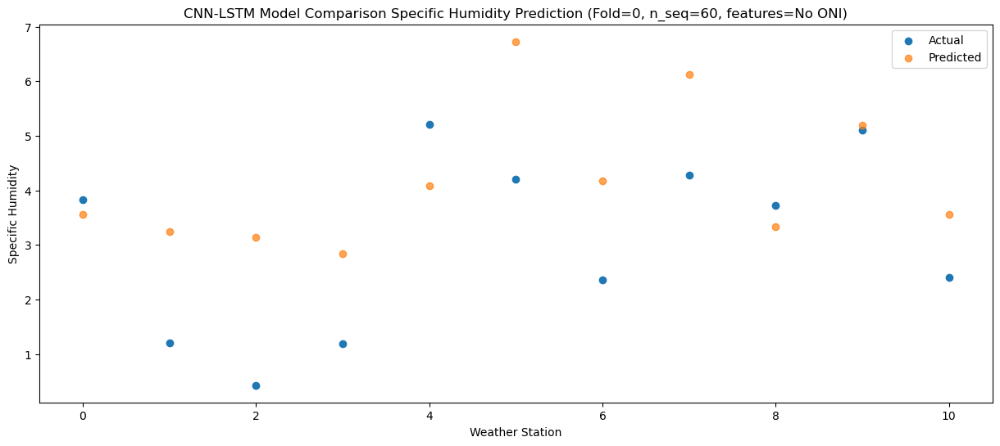

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   7.086043
1                 1    5.44   6.776042
2                 2    4.57   6.666037
3                 3    5.43   6.366038
4                 4    8.91   7.616035
5                 5    8.98  10.256029
6                 6    6.72   7.706036
7                 7    8.57   9.656040
8                 8    7.91   6.856039
9                 9    9.71   8.726042
10               10    6.12   7.086036


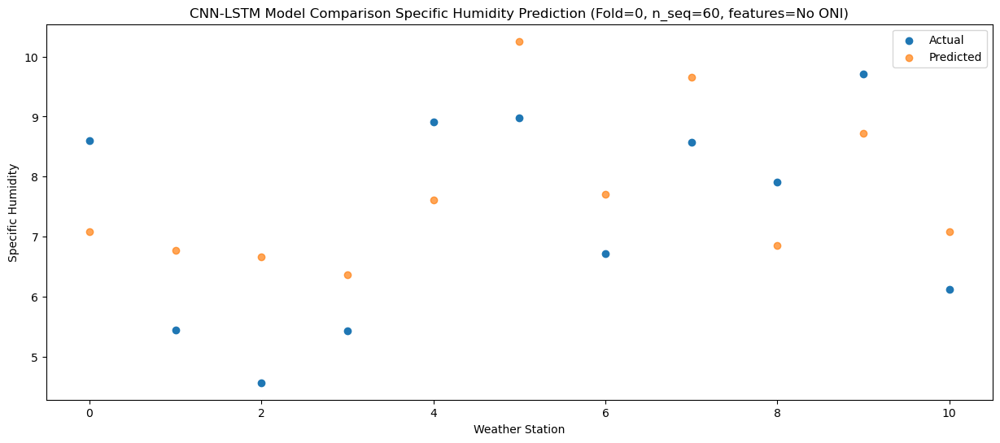

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52   9.182497
1                 1    8.05   8.872497
2                 2    7.35   8.762491
3                 3    7.44   8.462492
4                 4    9.88   9.712489
5                 5   10.07  12.352483
6                 6    8.60   9.802489
7                 7   10.02  11.752493
8                 8   10.09   8.952494
9                 9   11.39  10.822496
10               10    7.39   9.182490


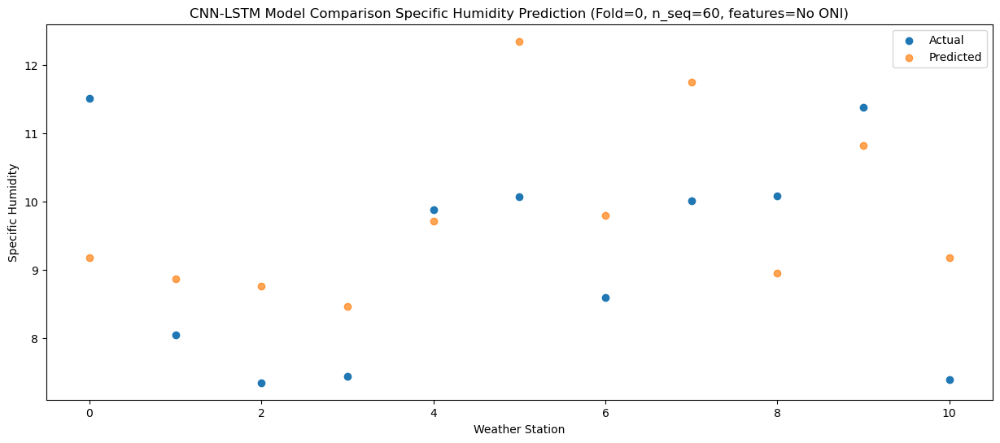

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10  11.593999
1                 1    8.95  11.283998
2                 2    9.55  11.173992
3                 3    8.65  10.873993
4                 4    9.64  12.123991
5                 5   14.40  14.763982
6                 6   12.22  12.213988
7                 7   13.39  14.163992
8                 8   13.75  11.363995
9                 9   14.97  13.233996
10               10    9.88  11.593990


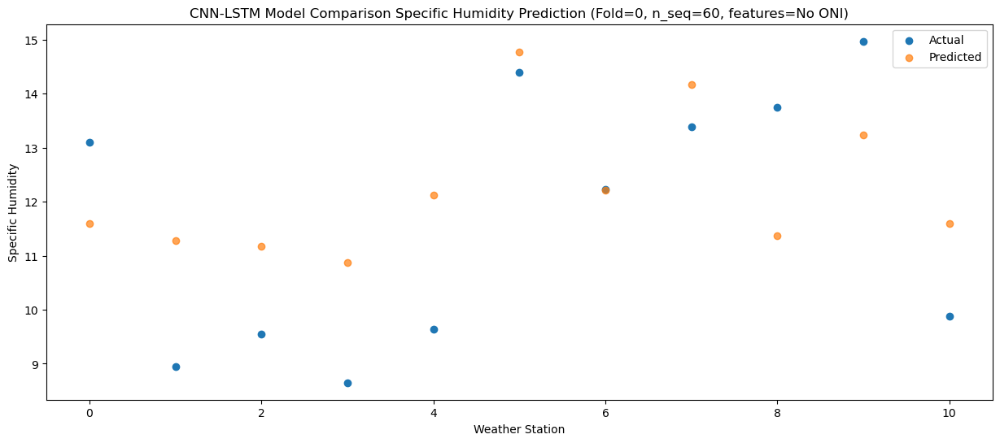

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68  11.425569
1                 1    8.38  11.115569
2                 2    8.85  11.005563
3                 3    7.93  10.705563
4                 4   10.73  11.955561
5                 5   12.61  14.595552
6                 6   10.87  12.045558
7                 7   12.32  13.995563
8                 8   12.78  11.195565
9                 9   13.43  13.065565
10               10   10.87  11.425560


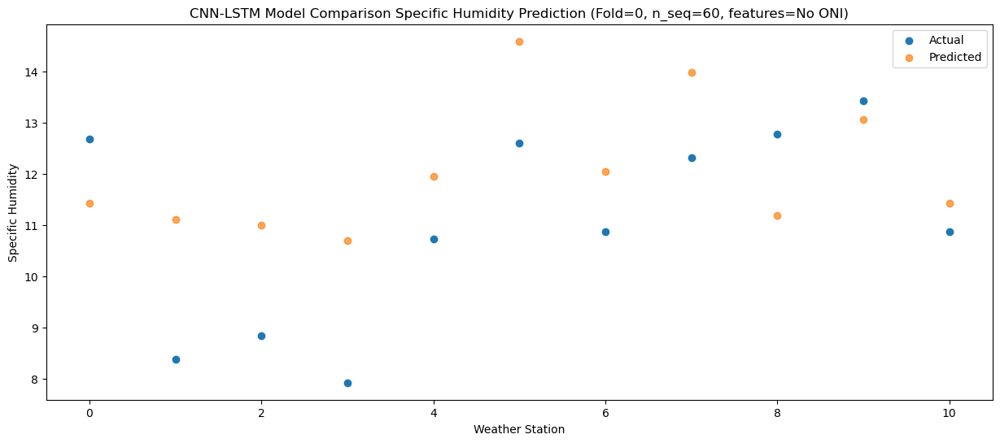

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   8.499357
1                 1    5.32   8.189356
2                 2    5.12   8.079350
3                 3    4.55   7.779349
4                 4    7.90   9.029348
5                 5    9.91  11.669340
6                 6    7.43   9.119345
7                 7    9.53  11.069350
8                 8    8.33   8.269353
9                 9   10.37  10.139353
10               10    8.27   8.499348


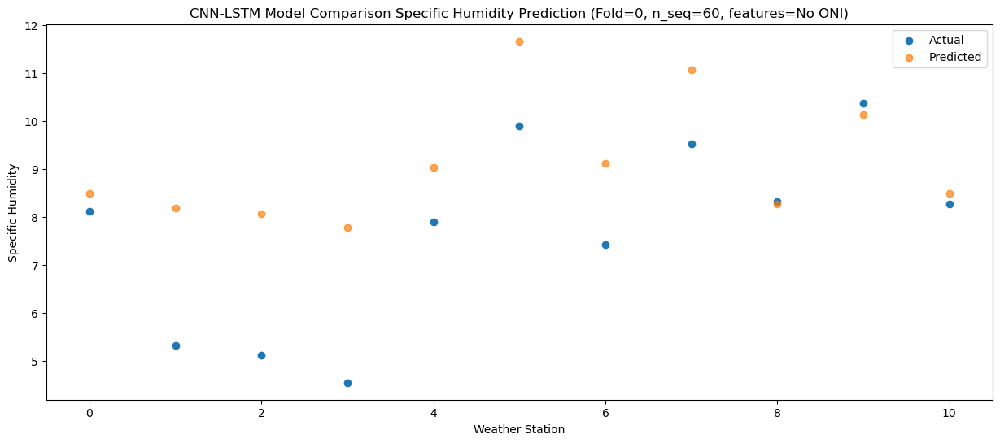

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   4.318719
1                 1    0.18   4.008718
2                 2    0.12   3.898712
3                 3   -0.55   3.598712
4                 4    3.10   4.848709
5                 5    5.27   7.488702
6                 6    2.87   4.938707
7                 7    5.11   6.888712
8                 8    3.10   4.088715
9                 9    4.58   5.958715
10               10    3.25   4.318710


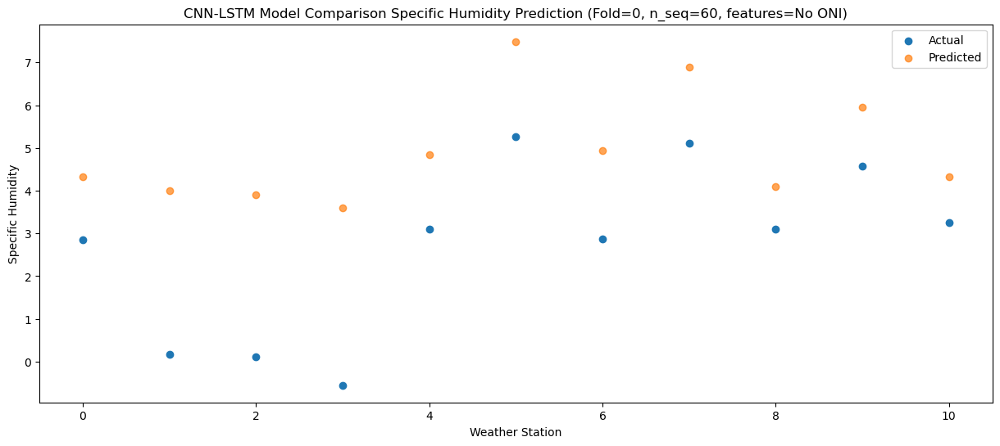

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   3.012463
1                 1   -0.02   2.702463
2                 2   -0.20   2.592456
3                 3   -1.07   2.292456
4                 4    3.09   3.542455
5                 5    4.61   6.182446
6                 6    2.27   3.632451
7                 7    4.41   5.582456
8                 8    2.10   2.782459
9                 9    3.86   4.652459
10               10    2.11   3.012455


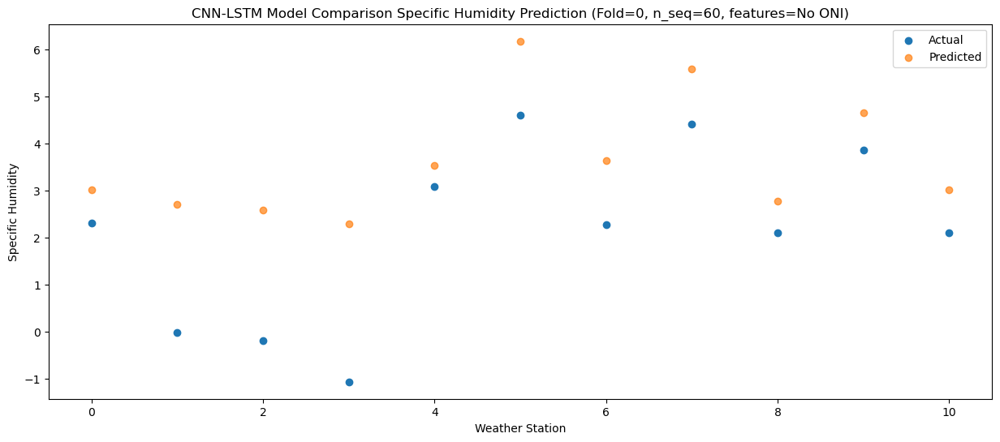

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85   1.860717
1                 1   -1.22   1.550717
2                 2   -1.53   1.440712
3                 3   -1.57   1.140709
4                 4    2.01   2.390708
5                 5    1.26   5.030700
6                 6    0.09   2.480705
7                 7    2.07   4.430709
8                 8    1.17   1.630713
9                 9    2.93   3.500712
10               10    0.94   1.860708


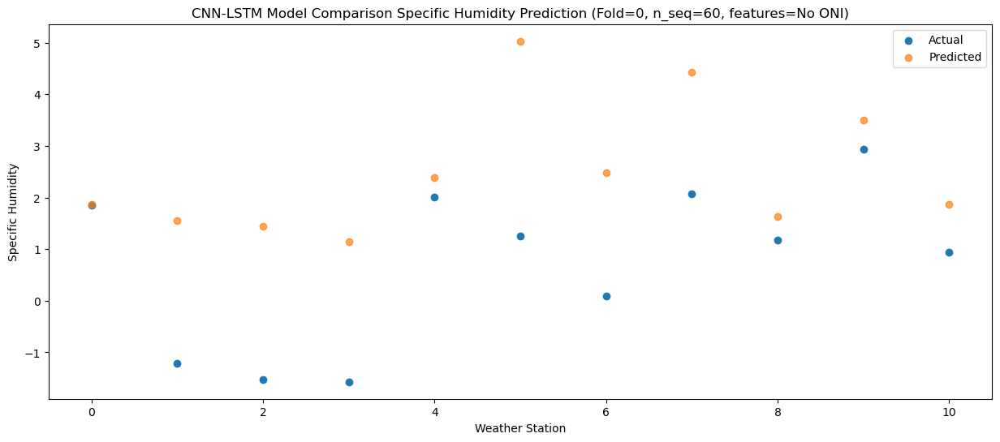

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45   2.233004
1                 1   -1.13   1.923004
2                 2   -1.16   1.812999
3                 3   -1.38   1.512997
4                 4    1.25   2.762998
5                 5    2.01   5.402986
6                 6    0.95   2.852991
7                 7    3.00   4.802994
8                 8    1.77   2.002999
9                 9    3.54   3.872996
10               10    1.34   2.232992


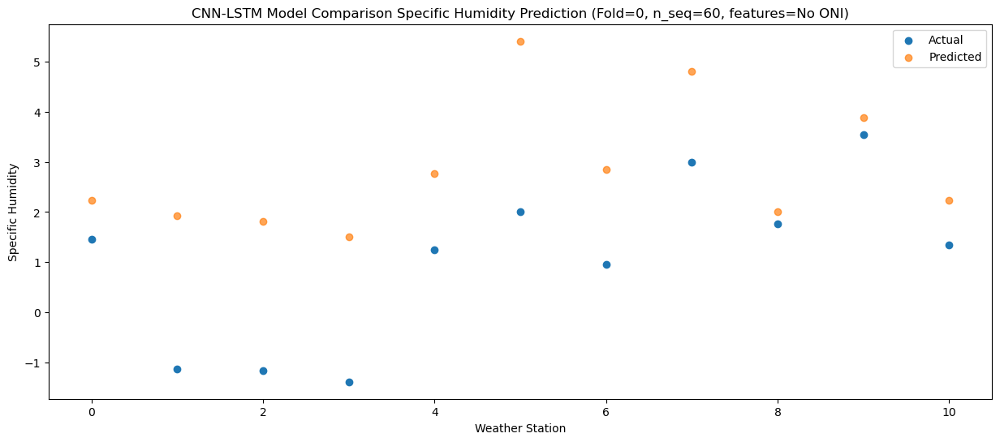

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07   2.109997
1                 1    0.56   1.799996
2                 2   -0.05   1.689991
3                 3   -0.71   1.389990
4                 4    1.59   2.639990
5                 5    2.94   5.279977
6                 6    1.63   2.729982
7                 7    3.36   4.679986
8                 8    1.84   1.879991
9                 9    3.31   3.749989
10               10    0.78   2.109985


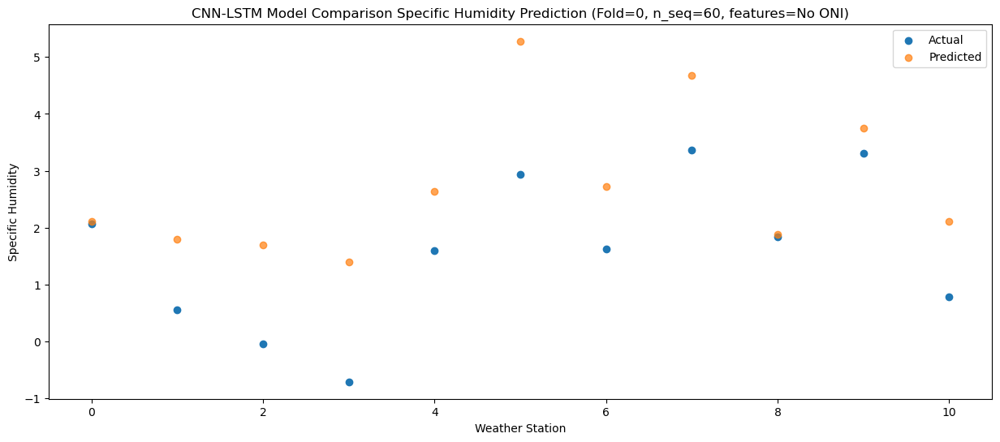

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67   2.444513
1                 1    0.94   2.134510
2                 2   -0.69   2.024505
3                 3    0.37   1.724504
4                 4    3.78   2.974504
5                 5    2.72   5.614493
6                 6    1.22   3.064497
7                 7    3.28   5.014502
8                 8    2.28   2.214505
9                 9    3.41   4.084505
10               10    1.24   2.444500


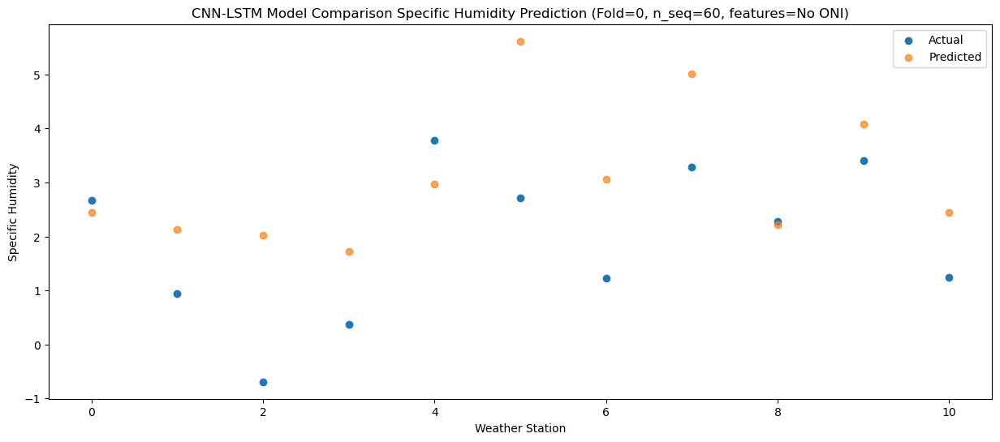

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   3.747296
1                 1    1.73   3.437293
2                 2    0.75   3.327287
3                 3    0.77   3.027288
4                 4    4.54   4.277287
5                 5    5.40   6.917276
6                 6    3.43   4.367278
7                 7    5.56   6.317284
8                 8    3.50   3.517287
9                 9    5.14   5.387288
10               10    2.88   3.747283


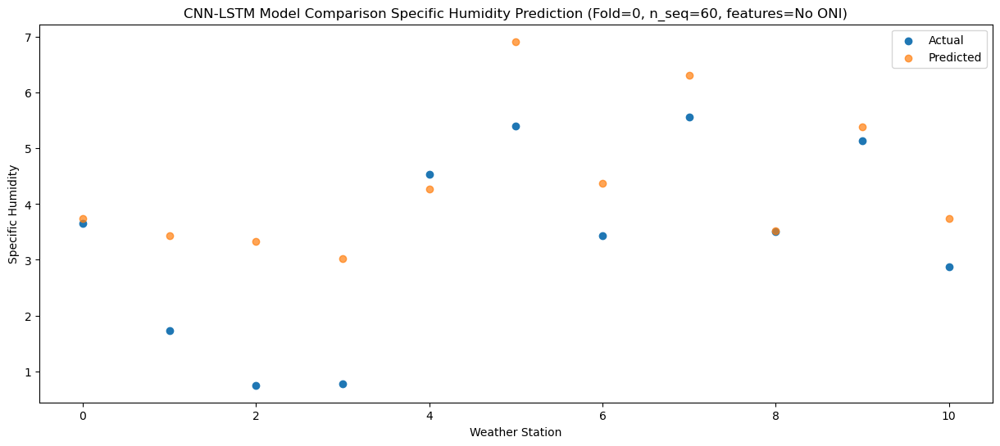

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   6.092372
1                 1    3.92   5.782369
2                 2    3.53   5.672364
3                 3    3.62   5.372364
4                 4    8.48   6.622363
5                 5    6.16   9.262351
6                 6    5.02   6.712352
7                 7    6.88   8.662360
8                 8    6.99   5.862363
9                 9    7.58   7.732363
10               10    4.09   6.092358


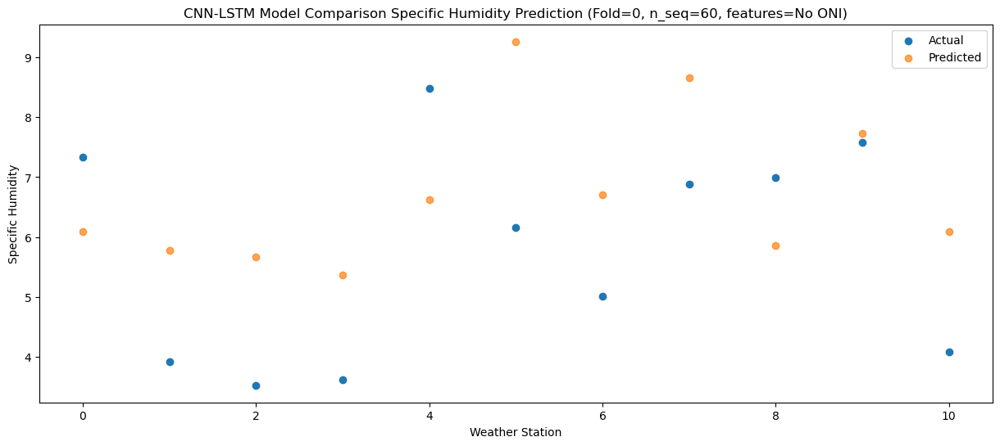

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   8.596379
1                 1    7.25   8.286376
2                 2    6.11   8.176370
3                 3    7.77   7.876372
4                 4   12.60   9.126371
5                 5   10.06  11.766358
6                 6    7.75   9.216359
7                 7    9.50  11.166368
8                 8    9.27   8.366370
9                 9   10.20  10.236370
10               10    7.10   8.596365


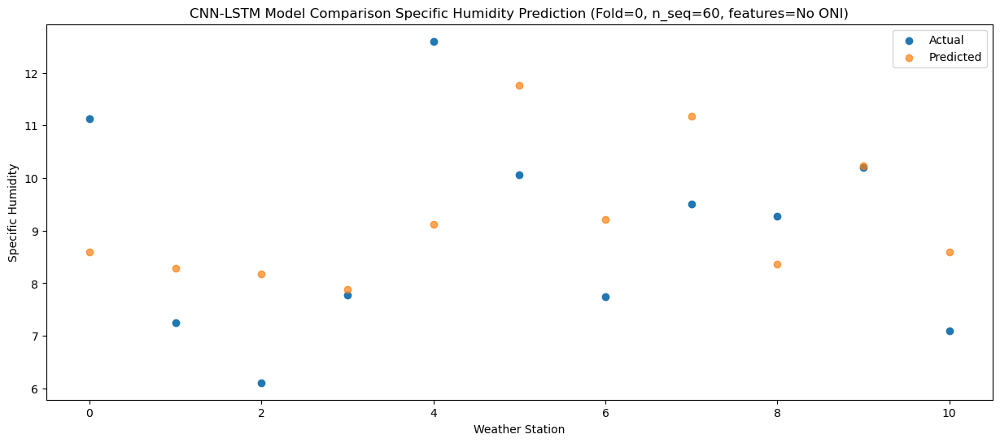

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42  11.576433
1                 1    8.92  11.266431
2                 2    8.97  11.156426
3                 3    8.80  10.856428
4                 4   11.18  12.106427
5                 5   14.41  14.746413
6                 6   11.49  12.196415
7                 7   13.85  14.146424
8                 8   12.82  11.346426
9                 9   14.02  13.216427
10               10   10.93  11.576421


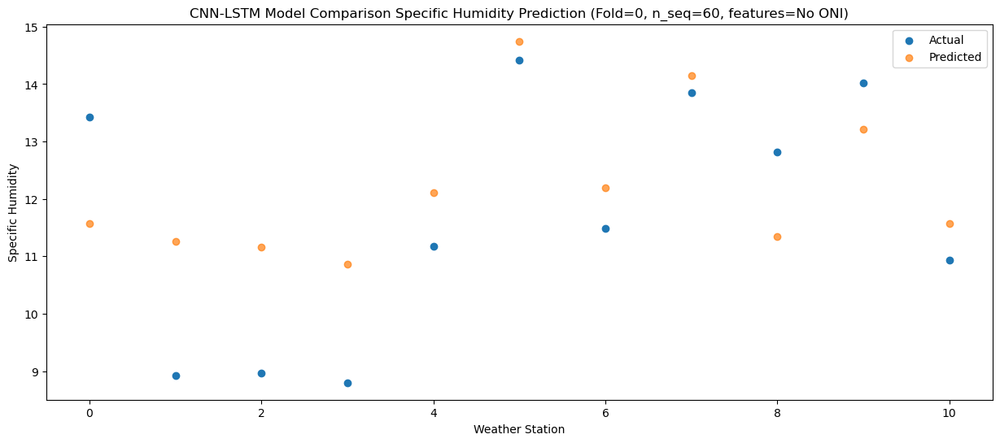

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04  11.034167
1                 1    9.70  10.724165
2                 2    9.06  10.614159
3                 3    8.55  10.314161
4                 4    9.36  11.564160
5                 5   13.52  14.204148
6                 6   11.12  11.654149
7                 7   12.79  13.604158
8                 8   12.82  10.804159
9                 9   12.72  12.674160
10               10   10.18  11.034154


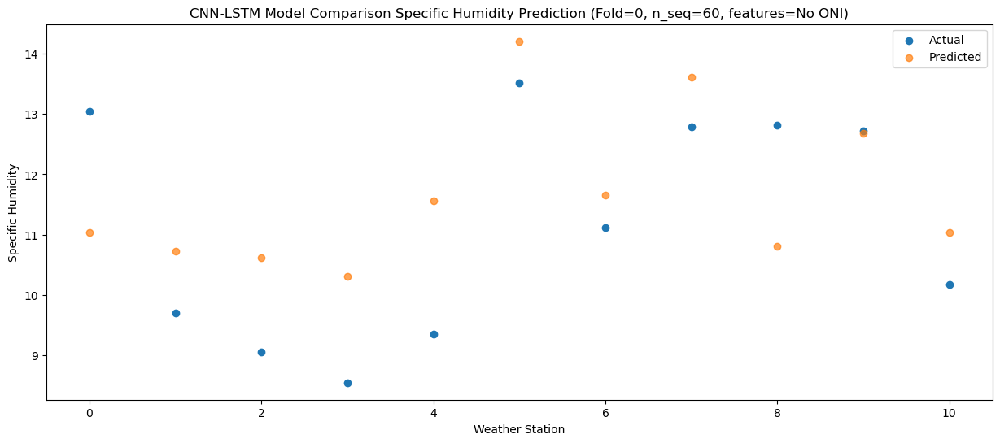

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.491155
1                 1    5.68   8.181152
2                 2    5.48   8.071146
3                 3    6.37   7.771149
4                 4    9.32   9.021149
5                 5   10.40  11.661134
6                 6    8.18   9.111136
7                 7    9.99  11.061145
8                 8    8.75   8.261146
9                 9   10.00  10.131147
10               10    8.87   8.491141


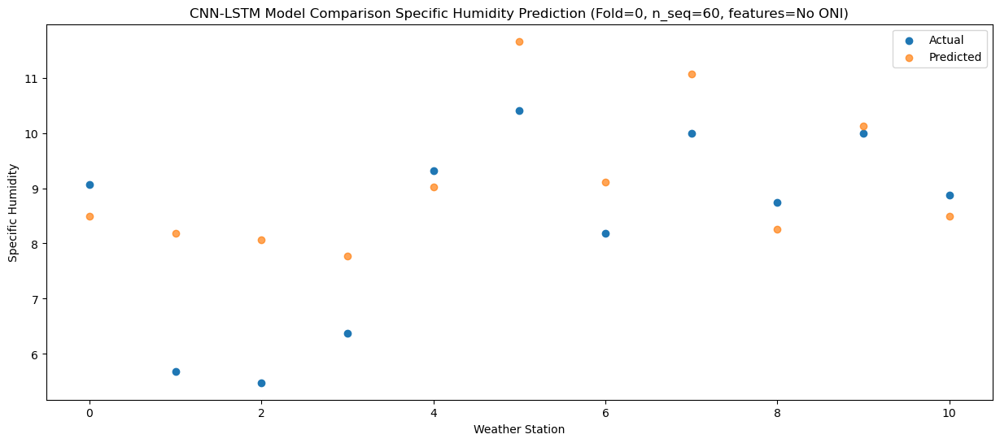

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   5.171289
1                 1    0.98   4.861286
2                 2    1.57   4.751279
3                 3    1.80   4.451283
4                 4    5.57   5.701283
5                 5    6.00   8.341267
6                 6    3.92   5.791269
7                 7    6.24   7.741278
8                 8    4.69   4.941280
9                 9    6.76   6.811280
10               10    5.11   5.171274


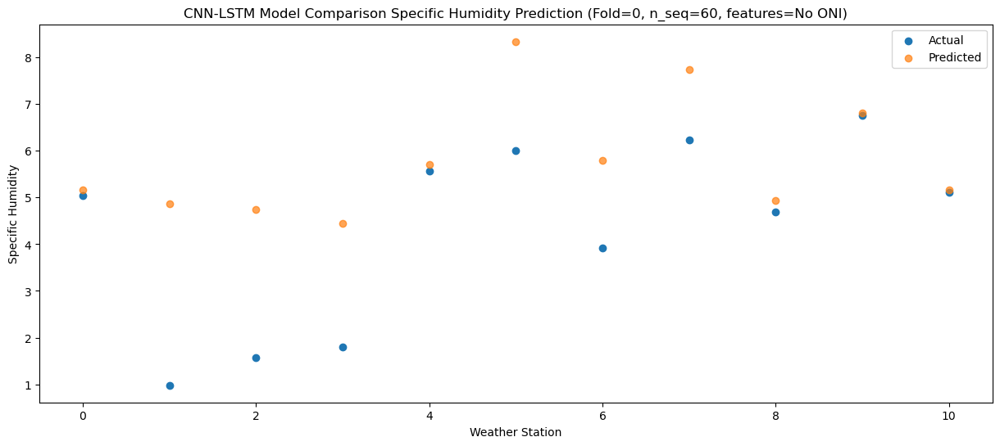

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86   2.259558
1                 1   -1.20   1.949555
2                 2   -0.96   1.839548
3                 3   -1.19   1.539552
4                 4    2.77   2.789552
5                 5    2.98   5.429536
6                 6    0.59   2.879538
7                 7    2.72   4.829547
8                 8    2.03   2.029549
9                 9    3.41   3.899550
10               10    1.70   2.259543


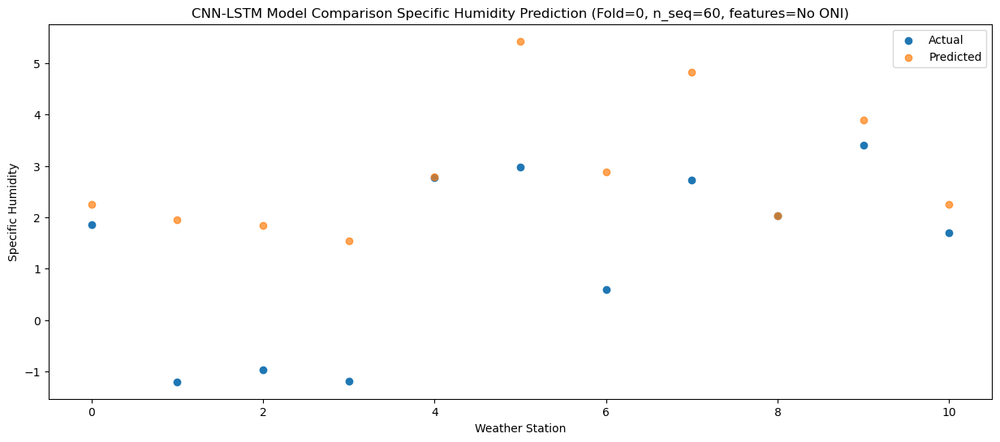

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58   2.214352
1                 1   -2.64   1.904348
2                 2   -1.77   1.794342
3                 3   -2.59   1.494344
4                 4    0.91   2.744345
5                 5    2.16   5.384330
6                 6    0.52   2.834333
7                 7    2.92   4.784342
8                 8    1.42   1.984342
9                 9    3.60   3.854345
10               10    2.23   2.214339


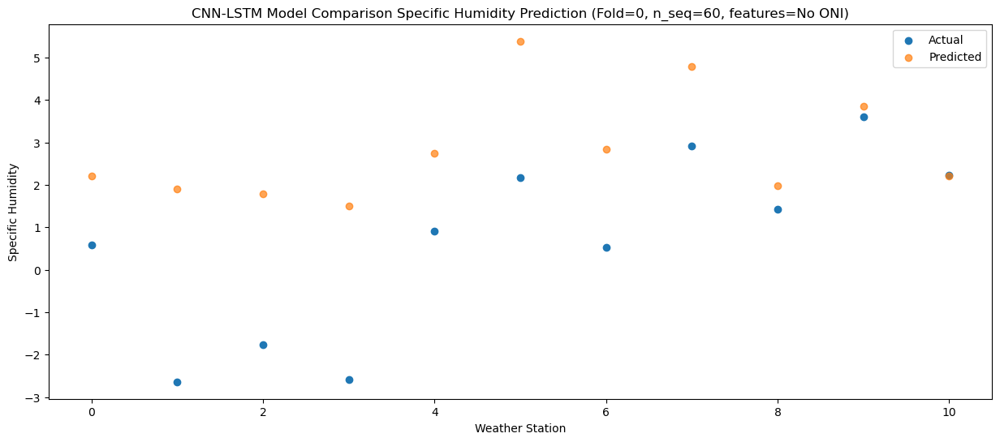

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24   1.278051
1                 1   -3.42   0.968048
2                 2   -2.57   0.858042
3                 3   -3.51   0.558044
4                 4   -0.27   1.808044
5                 5    1.37   4.448029
6                 6   -0.15   1.898033
7                 7    2.23   3.848042
8                 8    0.24   1.048042
9                 9    2.63   2.918046
10               10    0.71   1.278038


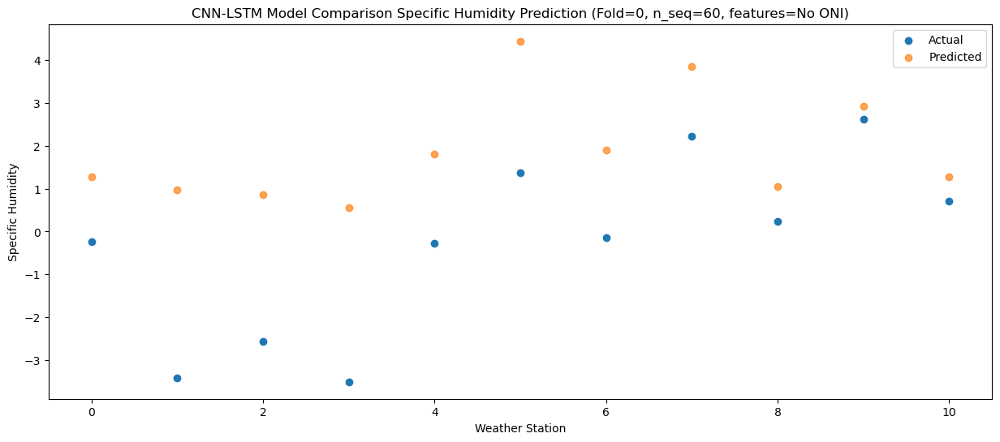

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66   1.826470
1                 1   -2.20   1.516467
2                 2   -1.93   1.406460
3                 3   -1.73   1.106463
4                 4    2.30   2.356462
5                 5    1.27   4.996448
6                 6    0.01   2.446451
7                 7    2.26   4.396459
8                 8    2.00   1.596461
9                 9    2.98   3.466464
10               10    1.24   1.826457


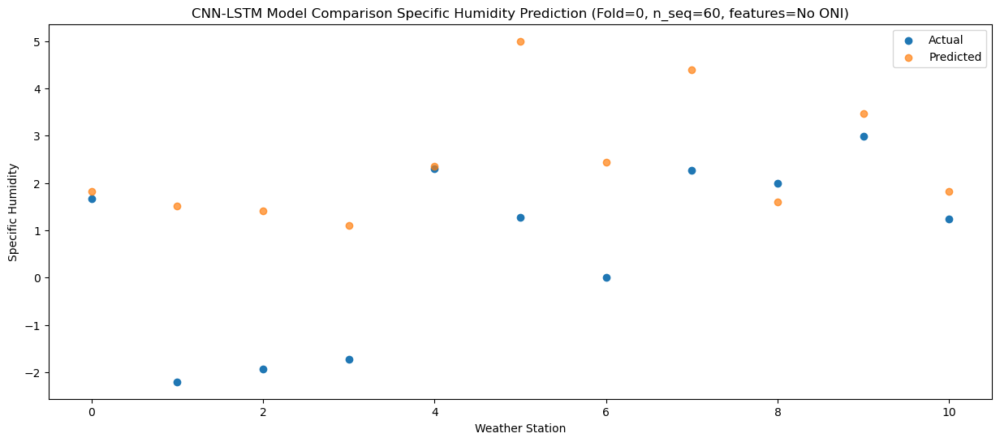

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92   2.647771
1                 1   -0.35   2.337770
2                 2   -0.30   2.227764
3                 3    0.06   1.927766
4                 4    4.04   3.177765
5                 5    3.19   5.817752
6                 6    1.46   3.267754
7                 7    3.40   5.217762
8                 8    2.87   2.417764
9                 9    4.11   4.287766
10               10    1.93   2.647760


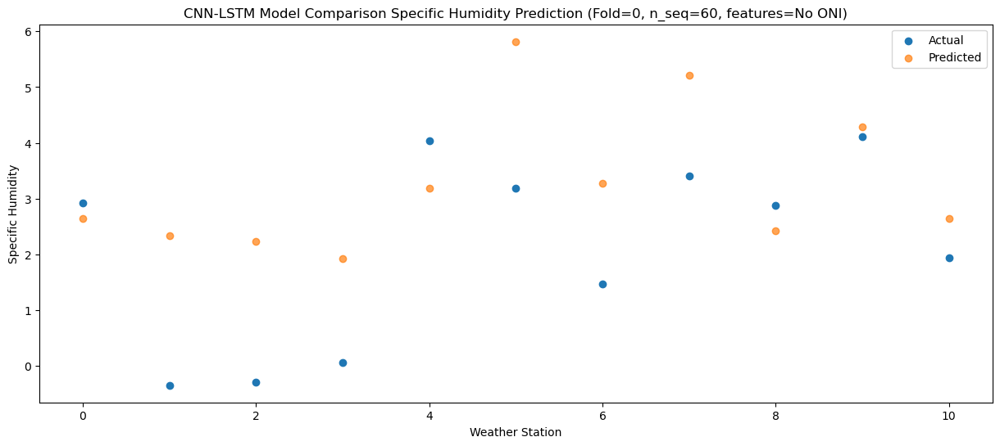

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23   4.177992
1                 1    1.56   3.867991
2                 2    1.44   3.757983
3                 3    2.11   3.457988
4                 4    6.28   4.707987
5                 5    4.53   7.347972
6                 6    3.52   4.797973
7                 7    5.42   6.747983
8                 8    5.10   3.947985
9                 9    6.48   5.817986
10               10    3.49   4.177981


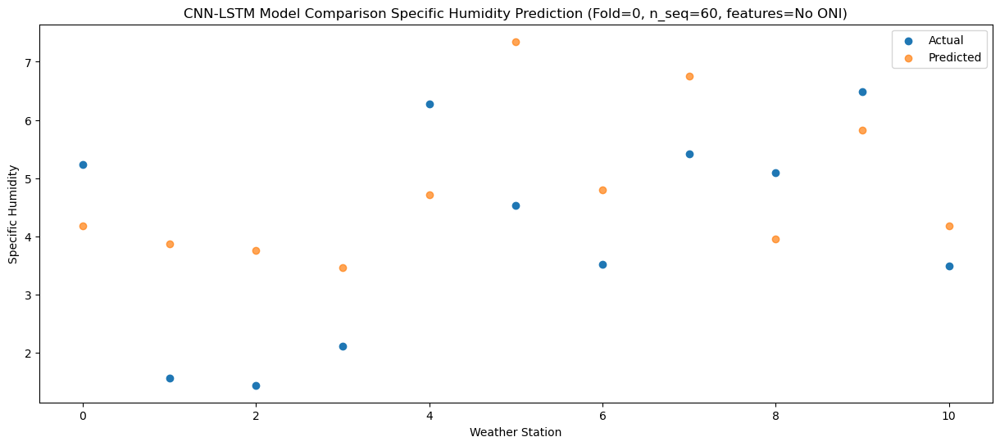

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70   7.451339
1                 1    6.14   7.141338
2                 2    5.19   7.031331
3                 3    6.68   6.731334
4                 4   10.53   7.981334
5                 5    8.59  10.621320
6                 6    7.43   8.071322
7                 7    9.24  10.021332
8                 8    9.38   7.221333
9                 9   10.28   9.091337
10               10    6.54   7.451331


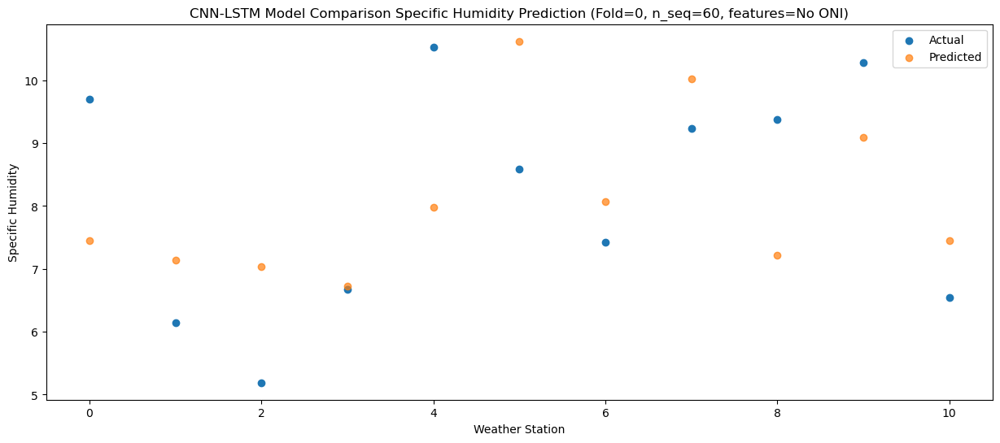

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09   9.812380
1                 1    7.74   9.502380
2                 2    6.32   9.392373
3                 3    8.19   9.092377
4                 4   12.18  10.342377
5                 5   10.56  12.982363
6                 6    9.25  10.432364
7                 7   10.93  12.382374
8                 8   11.80   9.582374
9                 9   11.35  11.452378
10               10    9.04   9.812372


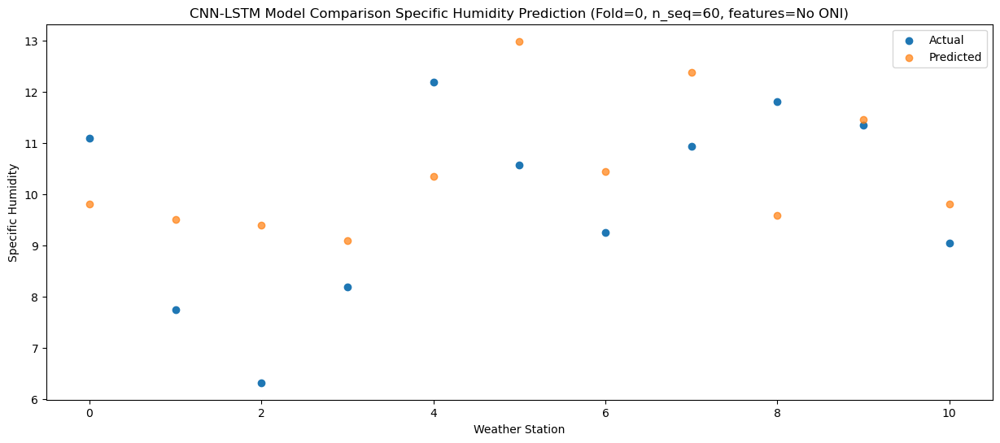

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38  11.533768
1                 1    9.91  11.223767
2                 2    9.55  11.113760
3                 3    9.59  10.813766
4                 4   11.92  12.063766
5                 5   13.35  14.703750
6                 6   11.78  12.153753
7                 7   13.82  14.103761
8                 8   12.98  11.303763
9                 9   12.85  13.173768
10               10   10.11  11.533760


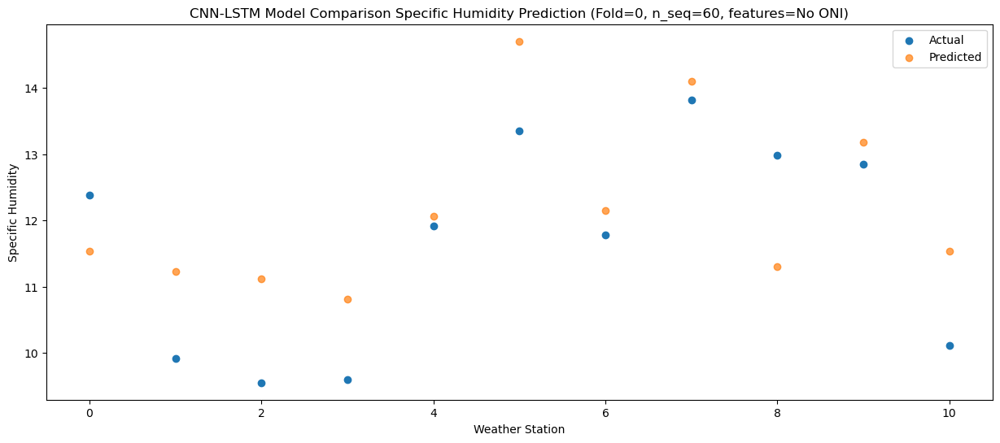

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55  11.046473
1                 1    8.41  10.736472
2                 2    7.86  10.626464
3                 3    8.45  10.326471
4                 4   11.57  11.576470
5                 5   12.34  14.216455
6                 6   10.62  11.666458
7                 7   12.39  13.616466
8                 8   11.31  10.816467
9                 9   12.05  12.686473
10               10    9.87  11.046466


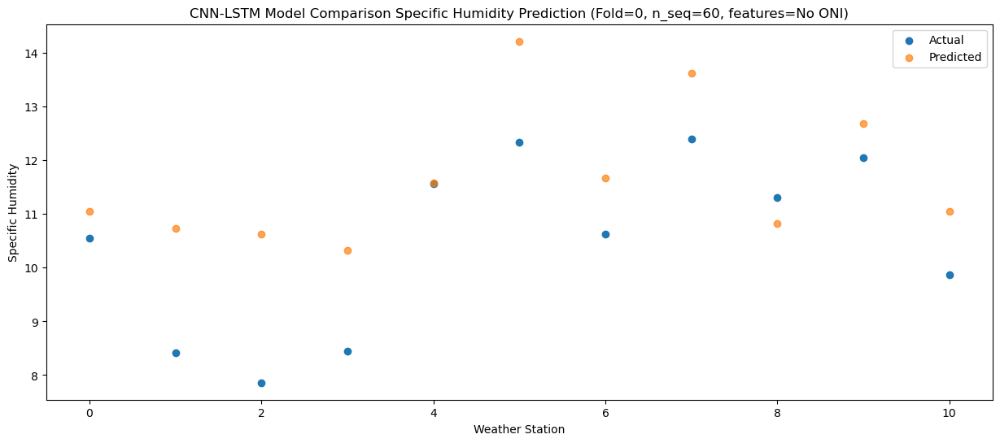

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08   8.676592
1                 1    7.54   8.366593
2                 2    6.17   8.256583
3                 3    6.89   7.956591
4                 4    9.08   9.206590
5                 5   10.39  11.846574
6                 6    8.89   9.296577
7                 7   10.80  11.246585
8                 8    9.27   8.446587
9                 9    9.70  10.316592
10               10    8.16   8.676586


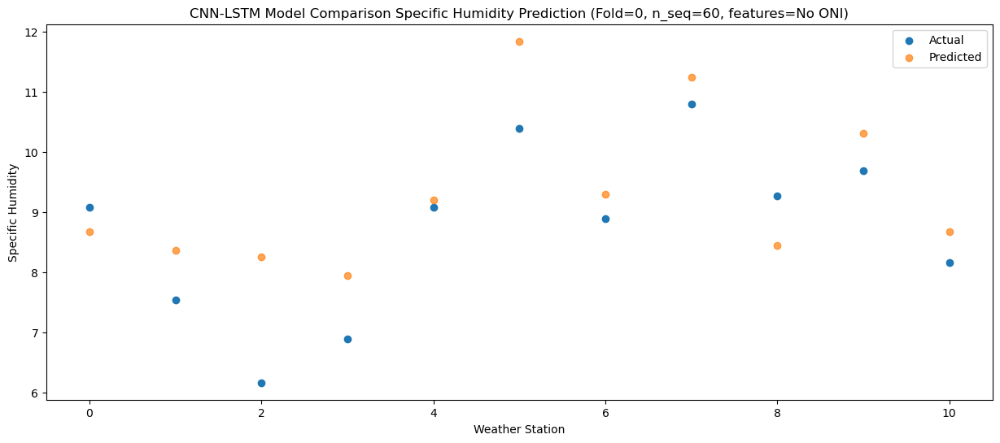

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.995176
1                 1    2.14   4.685176
2                 2    2.04   4.575167
3                 3    1.70   4.275174
4                 4    5.47   5.525173
5                 5    5.10   8.165157
6                 6    4.19   5.615161
7                 7    5.91   7.565169
8                 8    4.67   4.765171
9                 9    6.17   6.635176
10               10    3.96   4.995170


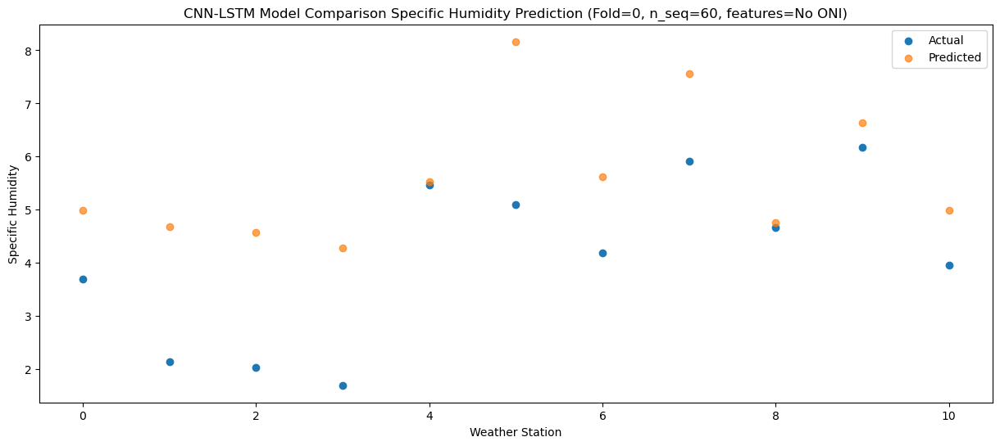

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 1, 512)            929792    
                                                                 
 max_pooling1d (MaxPooling1D  (None, 1, 512)           0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 1, 512)            0         
                                                                 
 lstm (LSTM)                 (None, 1, 512)            2099200   
                                                                 
 dropout_1 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_1 (LSTM)               (None, 512)               2099200   
                                                        

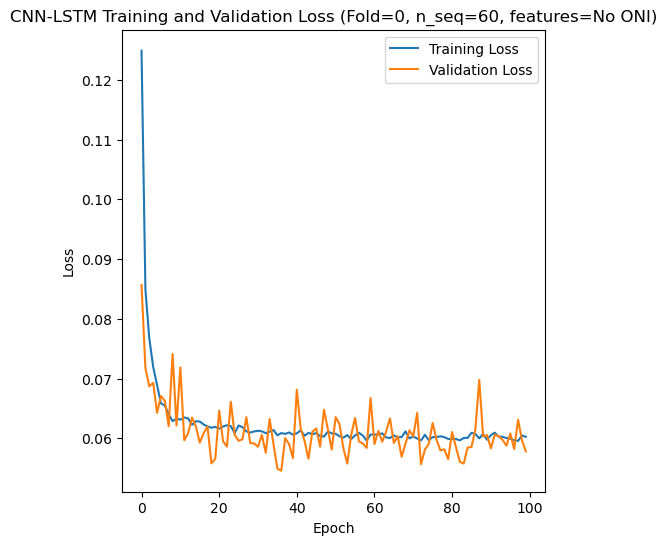

Epoch 1/100
84/84 [==============================] - 17s 64ms/step - loss: 0.1283 - accuracy: 0.2143 - mae: 0.1058 - rmse: 0.1283 - mape: 22.7376 - pearson: 0.5536 - val_loss: 0.0842 - val_accuracy: 0.0000e+00 - val_mae: 0.0667 - val_rmse: 0.0842 - val_mape: 14.7784 - val_pearson: 0.6858
Epoch 2/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0856 - accuracy: 0.3690 - mae: 0.0692 - rmse: 0.0856 - mape: 15.2716 - pearson: 0.7248 - val_loss: 0.0664 - val_accuracy: 0.5000 - val_mae: 0.0530 - val_rmse: 0.0664 - val_mape: 12.2495 - val_pearson: 0.7624
Epoch 3/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0781 - accuracy: 0.4881 - mae: 0.0625 - rmse: 0.0781 - mape: 13.9149 - pearson: 0.7590 - val_loss: 0.0642 - val_accuracy: 0.5000 - val_mae: 0.0490 - val_rmse: 0.0642 - val_mape: 10.8991 - val_pearson: 0.7706
Epoch 4/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0699 - accuracy: 0.5000 - mae: 0.0554 - rmse: 0.0699 - mape: 12.652

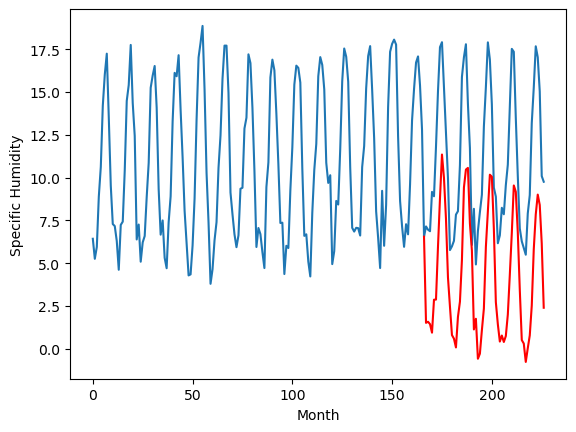

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		1.03		2.03
-0.95		1.09		2.04
-1.20		0.95		2.15
-0.68		0.46		1.14
1.55		2.38		0.83
-0.04		2.39		2.43
2.97		5.48		2.51
6.77		8.30		1.53
8.81		10.86		2.05
8.86		9.49		0.63
5.96		7.11		1.15
3.29		3.69		0.40
0.23		1.97		1.74
-2.36		0.32		2.68
-2.34		0.11		2.45
-2.15		-0.41		1.74
-0.62		1.37		1.99
-0.26		2.26		2.52
2.66		4.70		2.04
6.64		8.93		2.29
8.51		9.98		1.47
8.72		10.08		1.36
5.77		6.83		1.06
3.73		5.25		1.52
-1.86		0.64		2.50
0.31		1.27		0.96
-2.69		-1.07		1.62
-1.74		-0.77		0.97
-1.06		0.60		1.66
0.00		1.86		1.86
4.17		5.46		1.29
6.57		7.54		0.97
9.24		9.68		0.44
8.83		9.56		0.73
5.47		6.53		1.06
0.58		2.24		1.66
0.10		0.95		0.85
-1.49		-0.06		1.43
-1.08		0.29		1.37
0.04		-0.09		-0.13
-0.83		0.26		1.09
0.77		1.52		0.75
3.51		3.83		0.32
5.86		6.28		0.42
8.82		9.05		0.23
8.95		8.68		-0.27
5.84		6.30		0.46
1.99		2.95		0.96
-1.02		0.02		1.04
-1.60		-0.18		1.42
-2.37		-1.25		1.12
-2.03		

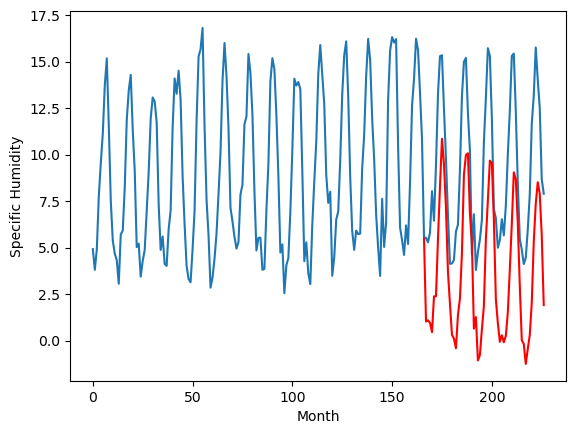

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		-0.22		1.68
-0.99		-0.16		0.83
-1.50		-0.30		1.20
-1.11		-0.79		0.32
2.05		1.13		-0.92
0.43		1.14		0.71
3.20		4.23		1.03
7.05		7.05		0.00
9.60		9.61		0.01
9.12		8.24		-0.88
6.17		5.86		-0.31
3.41		2.44		-0.97
0.23		0.72		0.49
-2.54		-0.93		1.61
-2.39		-1.14		1.25
-2.39		-1.66		0.73
0.23		0.12		-0.11
-0.06		1.01		1.07
2.78		3.45		0.67
7.30		7.68		0.38
8.89		8.73		-0.16
9.11		8.83		-0.28
6.35		5.58		-0.77
3.60		4.00		0.40
-1.90		-0.61		1.29
0.74		0.02		-0.72
-3.14		-2.32		0.82
-2.11		-2.02		0.09
-1.32		-0.65		0.67
0.44		0.61		0.17
4.80		4.21		-0.59
7.89		6.29		-1.60
9.52		8.43		-1.09
8.65		8.31		-0.34
5.14		5.28		0.14
0.03		0.99		0.96
-0.34		-0.30		0.04
-1.03		-1.31		-0.28
-1.06		-0.96		0.10
-0.01		-1.34		-1.33
-0.48		-0.99		-0.51
0.88		0.27		-0.61
4.18		2.58		-1.60
6.83		5.03		-1.80
9.97		7.80		-2.17
9.90		7.43		-2.47
6.09		5.05		-1.04
1.58		1.70		0.12
-0.97		-1.23		-0.26
-1.99		-1.43		

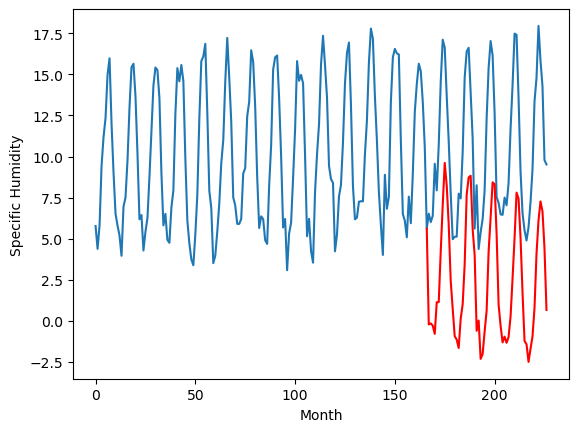

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-0.92		0.59
-2.71		-0.86		1.85
-1.81		-1.00		0.81
-2.51		-1.49		1.02
1.85		0.43		-1.42
1.51		0.44		-1.07
3.49		3.53		0.04
5.61		6.35		0.74
8.12		8.91		0.79
7.01		7.54		0.53
5.43		5.16		-0.27
2.03		1.74		-0.29
-0.07		0.02		0.09
-2.62		-1.63		0.99
-2.96		-1.84		1.12
-2.89		-2.36		0.53
-0.25		-0.58		-0.33
1.09		0.31		-0.78
4.98		2.75		-2.23
8.17		6.98		-1.19
8.65		8.03		-0.62
8.99		8.13		-0.86
5.90		4.88		-1.02
3.65		3.30		-0.35
-0.80		-1.31		-0.51
2.12		-0.68		-2.80
-3.53		-3.02		0.51
-3.36		-2.72		0.64
-1.68		-1.35		0.33
2.48		-0.09		-2.57
6.29		3.51		-2.78
7.34		5.59		-1.75
8.26		7.73		-0.53
8.51		7.61		-0.90
5.22		4.58		-0.64
0.26		0.29		0.03
-0.24		-1.00		-0.76
-1.05		-2.01		-0.96
-1.47		-1.66		-0.19
-0.69		-2.04		-1.35
0.86		-1.69		-2.55
1.23		-0.43		-1.66
5.01		1.88		-3.13
8.41		4.33		-4.08
8.97		7.10		-1.87
7.30		6.73		-0.57
6.10		4.35		-1.75
2.68		1.00		-1.68
-0.65		-1.93		-1.28


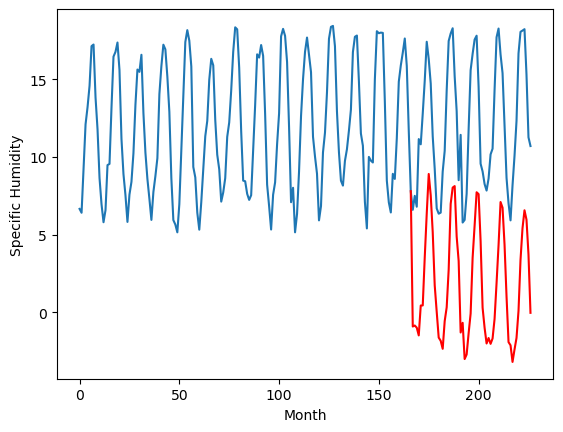

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		3.14		0.93
0.97		3.20		2.23
1.88		3.06		1.18
1.20		2.57		1.37
5.93		4.49		-1.44
5.62		4.50		-1.12
7.74		7.59		-0.15
10.03		10.41		0.38
12.63		12.97		0.34
11.18		11.60		0.42
9.69		9.22		-0.47
5.84		5.80		-0.04
3.36		4.08		0.72
0.54		2.43		1.89
0.29		2.22		1.93
0.33		1.70		1.37
3.05		3.48		0.43
4.31		4.37		0.06
8.34		6.81		-1.53
11.75		11.04		-0.71
11.93		12.09		0.16
11.97		12.19		0.22
8.87		8.94		0.07
6.92		7.36		0.44
2.33		2.75		0.42
5.26		3.38		-1.88
-0.28		1.04		1.32
-0.08		1.34		1.42
1.62		2.71		1.09
5.72		3.97		-1.75
9.60		7.57		-2.03
10.72		9.65		-1.07
11.47		11.79		0.32
11.85		11.67		-0.18
8.50		8.64		0.14
3.60		4.35		0.75
3.22		3.06		-0.16
2.40		2.05		-0.35
1.92		2.40		0.48
2.52		2.02		-0.50
4.22		2.37		-1.85
4.67		3.63		-1.04
8.34		5.94		-2.40
11.60		8.39		-3.21
11.68		11.16		-0.52
10.28		10.79		0.51
9.53		8.41		-1.12
6.14		5.06		-1.08
2.80		2.13		-0.67
1.08		1.93		0.85
-0.09		0

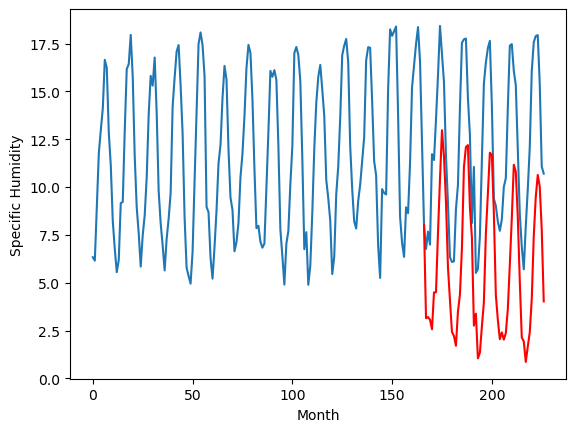

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		1.63		-1.72
1.87		1.69		-0.18
1.59		1.55		-0.04
1.77		1.06		-0.71
4.44		2.98		-1.46
3.43		2.99		-0.44
6.11		6.08		-0.03
7.93		8.90		0.97
8.92		11.46		2.54
7.69		10.09		2.40
7.26		7.71		0.45
3.75		4.29		0.54
3.19		2.57		-0.62
0.75		0.92		0.17
1.58		0.71		-0.87
0.95		0.19		-0.76
1.74		1.97		0.23
3.04		2.86		-0.18
7.35		5.30		-2.05
9.52		9.53		0.01
10.85		10.58		-0.27
11.07		10.68		-0.39
7.53		7.43		-0.10
4.42		5.85		1.43
2.58		1.24		-1.34
1.53		1.87		0.34
0.26		-0.47		-0.73
0.14		-0.17		-0.31
0.69		1.20		0.51
2.96		2.46		-0.50
4.73		6.06		1.33
7.33		8.14		0.81
8.28		10.28		2.00
10.39		10.16		-0.23
9.12		7.13		-1.99
5.93		2.84		-3.09
3.06		1.55		-1.51
2.39		0.54		-1.85
0.84		0.89		0.05
0.87		0.51		-0.36
1.92		0.86		-1.06
2.18		2.12		-0.06
6.55		4.43		-2.12
6.50		6.88		0.38
8.67		9.65		0.98
8.82		9.28		0.46
8.46		6.90		-1.56
6.48		3.55		-2.93
3.85		0.62		-3.23
1.98		0.42		-1.56
0.83		-0.65	

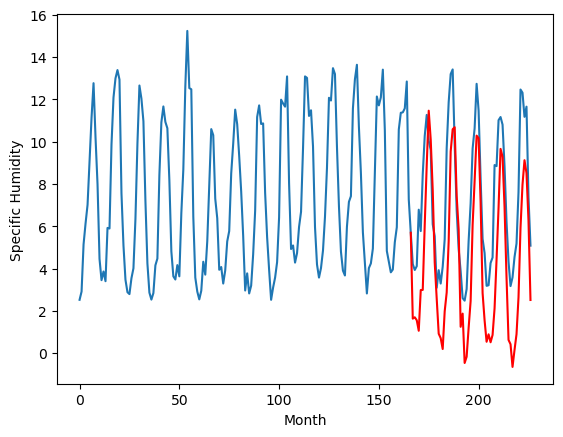

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		2.48		1.78
0.73		2.54		1.81
0.31		2.40		2.09
0.79		1.91		1.12
2.76		3.83		1.07
2.11		3.84		1.73
5.31		6.93		1.62
8.95		9.75		0.80
11.39		12.31		0.92
11.41		10.94		-0.47
8.10		8.56		0.46
5.61		5.14		-0.47
2.50		3.42		0.92
-0.22		1.77		1.99
-0.33		1.56		1.89
-0.21		1.04		1.25
1.35		2.82		1.47
1.97		3.71		1.74
4.90		6.15		1.25
9.25		10.38		1.13
11.75		11.43		-0.32
12.04		11.53		-0.51
8.69		8.28		-0.41
6.56		6.70		0.14
0.63		2.09		1.46
2.50		2.72		0.22
-0.50		0.38		0.88
0.63		0.68		0.05
1.38		2.05		0.67
2.57		3.31		0.74
6.83		6.91		0.08
9.55		8.99		-0.56
12.54		11.13		-1.41
11.45		11.01		-0.44
7.97		7.98		0.01
2.91		3.69		0.78
2.42		2.40		-0.02
0.52		1.39		0.87
0.88		1.74		0.86
2.08		1.36		-0.72
1.32		1.71		0.39
3.13		2.97		-0.16
5.69		5.28		-0.41
8.27		7.73		-0.54
11.89		10.50		-1.39
11.78		10.13		-1.65
8.81		7.75		-1.06
4.56		4.40		-0.16
1.21		1.47		0.26
0.71		1.27		0.56
-0.11		0.20		0.31

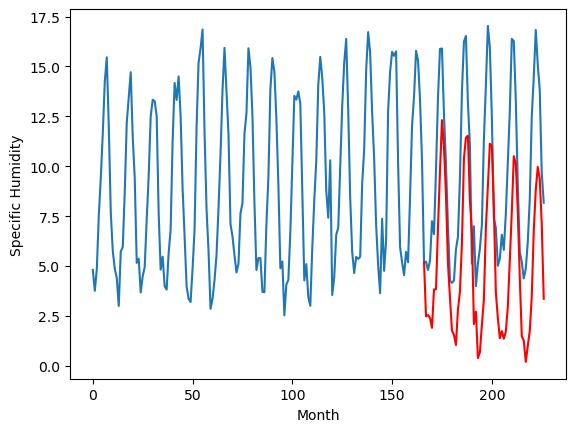

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		3.37		0.26
2.78		3.43		0.65
2.70		3.29		0.59
2.58		2.80		0.22
5.24		4.72		-0.52
5.50		4.73		-0.77
8.40		7.82		-0.58
12.23		10.64		-1.59
15.31		13.20		-2.11
13.14		11.83		-1.31
11.34		9.45		-1.89
6.52		6.03		-0.49
4.50		4.31		-0.19
2.18		2.66		0.48
2.05		2.45		0.40
1.53		1.93		0.40
4.26		3.71		-0.55
5.49		4.60		-0.89
8.70		7.04		-1.66
13.46		11.27		-2.19
14.09		12.32		-1.77
13.94		12.42		-1.52
10.69		9.17		-1.52
7.96		7.59		-0.37
3.40		2.98		-0.42
5.04		3.61		-1.43
1.29		1.27		-0.02
1.97		1.57		-0.40
3.50		2.94		-0.56
5.69		4.20		-1.49
10.14		7.80		-2.34
12.90		9.88		-3.02
13.87		12.02		-1.85
13.78		11.90		-1.88
9.82		8.87		-0.95
5.28		4.58		-0.70
4.03		3.29		-0.74
3.12		2.28		-0.84
3.24		2.63		-0.61
3.34		2.25		-1.09
4.10		2.60		-1.50
5.30		3.86		-1.44
9.34		6.17		-3.17
12.26		8.62		-3.64
14.83		11.39		-3.44
14.41		11.02		-3.39
9.92		8.64		-1.28
6.67		5.29		-1.38
3.96		2.36		-1.60
2.57	

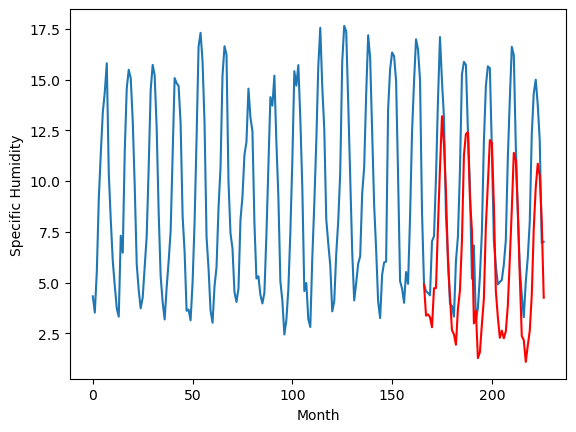

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		3.04		-0.99
3.19		3.10		-0.09
3.64		2.96		-0.68
3.02		2.47		-0.55
6.04		4.39		-1.65
6.23		4.40		-1.83
9.56		7.49		-2.07
11.70		10.31		-1.39
15.06		12.87		-2.19
12.16		11.50		-0.66
10.68		9.12		-1.56
6.01		5.70		-0.31
4.90		3.98		-0.92
2.62		2.33		-0.29
2.78		2.12		-0.66
1.97		1.60		-0.37
4.58		3.38		-1.20
5.74		4.27		-1.47
9.96		6.71		-3.25
13.10		10.94		-2.16
14.15		11.99		-2.16
13.73		12.09		-1.64
10.16		8.84		-1.32
7.72		7.26		-0.46
4.19		2.65		-1.54
3.58		3.28		-0.30
1.60		0.94		-0.66
2.13		1.24		-0.89
3.22		2.61		-0.61
6.34		3.87		-2.47
10.58		7.47		-3.11
12.48		9.55		-2.93
11.84		11.69		-0.15
12.58		11.57		-1.01
9.84		8.54		-1.30
5.89		4.25		-1.64
4.91		2.96		-1.95
3.17		1.95		-1.22
2.69		2.30		-0.39
3.02		1.92		-1.10
4.44		2.27		-2.17
5.66		3.53		-2.13
10.71		5.84		-4.87
13.29		8.29		-5.00
13.52		11.06		-2.46
11.69		10.69		-1.00
10.74		8.31		-2.43
7.31		4.96		-2.35
4.64		2.03		-2

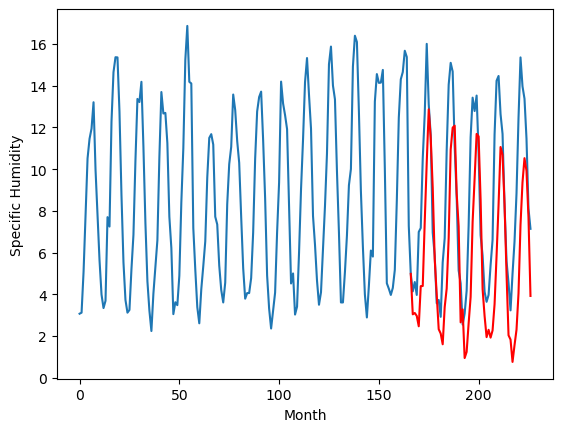

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		-0.77		-1.57
0.15		-0.71		-0.86
-0.00		-0.85		-0.85
0.01		-1.34		-1.35
1.90		0.58		-1.32
2.06		0.59		-1.47
4.88		3.68		-1.20
6.59		6.50		-0.09
9.48		9.06		-0.42
8.16		7.69		-0.47
5.37		5.31		-0.06
1.85		1.89		0.04
1.53		0.17		-1.36
-0.33		-1.48		-1.15
-0.14		-1.69		-1.55
-0.88		-2.21		-1.33
0.94		-0.43		-1.37
1.11		0.46		-0.65
6.26		2.90		-3.36
9.25		7.13		-2.12
10.49		8.18		-2.31
9.46		8.28		-1.18
6.50		5.03		-1.47
3.06		3.45		0.39
0.70		-1.16		-1.86
-0.28		-0.53		-0.25
-0.92		-2.87		-1.95
-1.00		-2.57		-1.57
-0.04		-1.20		-1.16
0.93		0.06		-0.87
3.49		3.66		0.17
7.67		5.74		-1.93
8.32		7.88		-0.44
8.73		7.76		-0.97
6.73		4.73		-2.00
3.34		0.44		-2.90
1.36		-0.85		-2.21
0.15		-1.86		-2.01
-0.16		-1.51		-1.35
-0.30		-1.89		-1.59
0.49		-1.54		-2.03
1.01		-0.28		-1.29
6.74		2.03		-4.71
8.35		4.48		-3.87
10.28		7.25		-3.03
8.37		6.88		-1.49
6.72		4.50		-2.22
3.61		1.15		-2.46
1.29		-1.78	

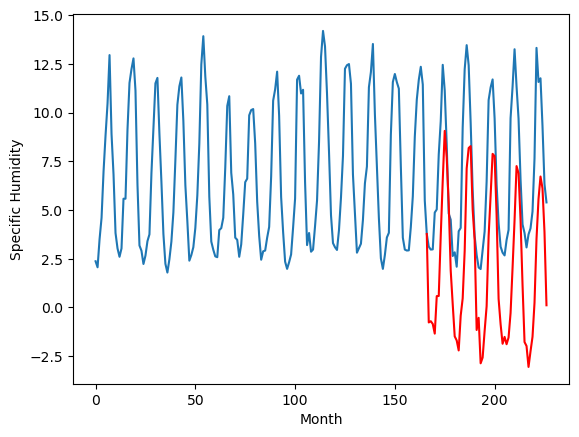

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		1.52		0.90
0.61		1.58		0.97
0.46		1.44		0.98
0.53		0.95		0.42
1.48		2.87		1.39
1.77		2.88		1.11
4.34		5.97		1.63
7.98		8.79		0.81
11.62		11.35		-0.27
11.53		9.98		-1.55
8.05		7.60		-0.45
5.13		4.18		-0.95
2.75		2.46		-0.29
0.59		0.81		0.22
-0.14		0.60		0.74
-0.10		0.08		0.18
1.14		1.86		0.72
2.51		2.75		0.24
4.04		5.19		1.15
9.36		9.42		0.06
11.22		10.47		-0.75
11.56		10.57		-0.99
8.37		7.32		-1.05
6.51		5.74		-0.77
1.32		1.13		-0.19
1.20		1.76		0.56
-0.41		-0.58		-0.17
0.33		-0.28		-0.61
1.35		1.09		-0.26
2.01		2.35		0.34
6.14		5.95		-0.19
7.73		8.03		0.30
11.36		10.17		-1.19
10.93		10.05		-0.88
7.68		7.02		-0.66
4.24		2.73		-1.51
2.74		1.44		-1.30
0.61		0.43		-0.18
1.47		0.78		-0.69
0.67		0.40		-0.27
0.70		0.75		0.05
3.31		2.01		-1.30
3.61		4.32		0.71
6.90		6.77		-0.13
11.61		9.54		-2.07
9.32		9.17		-0.15
8.06		6.79		-1.27
5.01		3.44		-1.57
1.35		0.51		-0.84
1.59		0.31		-1.28
0.54		-

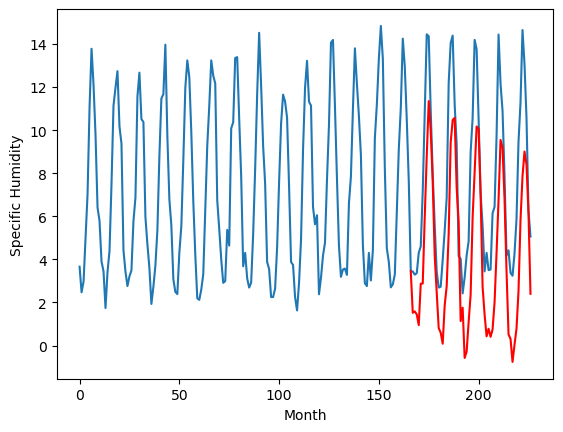

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[1.5204046344757076, 1.0304046344757083, -0.21959393501281754, -0.9195944118499755, 3.140405588150024, 1.6304065418243407, 2.480405588150024, 3.3704060649871828, 3.0404060649871827, -0.7695934581756592, 1.5204065418243404]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44   1.520405
1                 1   -1.00   1.030405
2                 2   -1.90  -0.219594
3                 3   -1.51  -0.919594
4                 4    2.21   3.140406
5                 5    3.35   1.630407
6                 6    0.70   2.480406
7                 7    3.11   3.370406
8                 8    4.03   3.040406
9                 9    0.80  -0.769593
10               10    0.62   1.520407


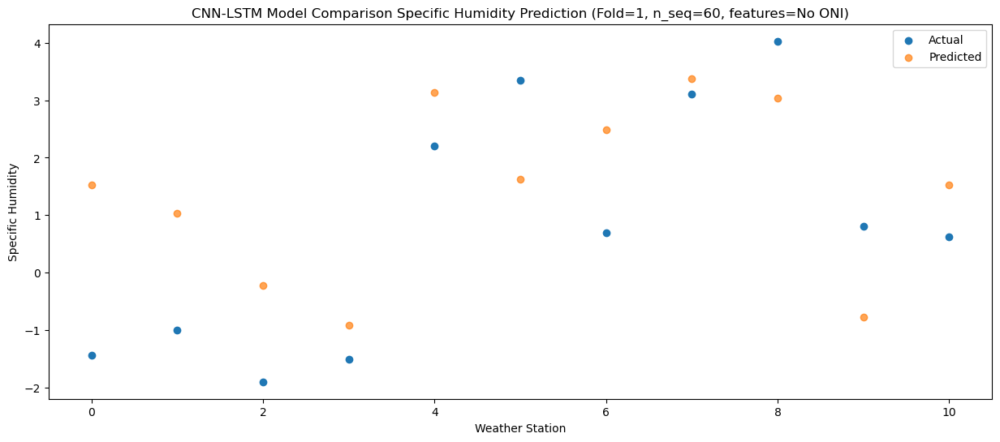

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84   1.584264
1                 1   -0.95   1.094264
2                 2   -0.99  -0.155734
3                 3   -2.71  -0.855727
4                 4    0.97   3.204275
5                 5    1.87   1.694281
6                 6    0.73   2.544267
7                 7    2.78   3.434270
8                 8    3.19   3.104275
9                 9    0.15  -0.705720
10               10    0.61   1.584264


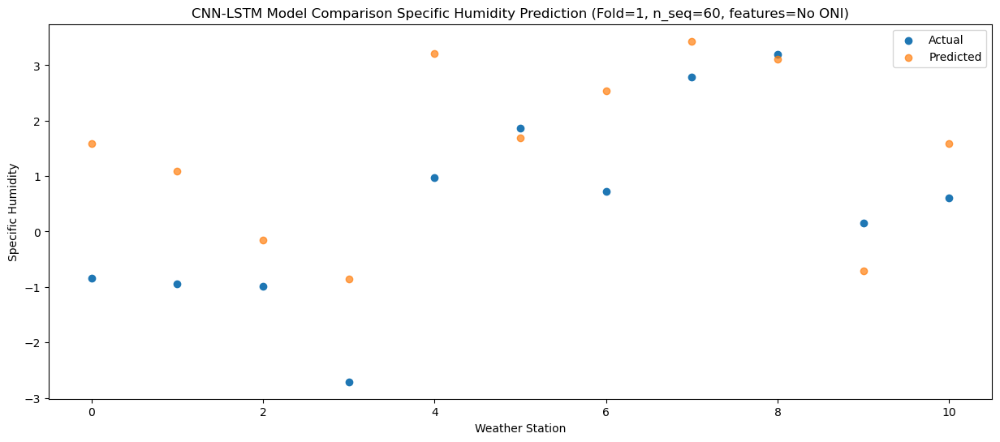

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00   1.444659
1                 1 -1.200000e+00   0.954659
2                 2 -1.500000e+00  -0.295340
3                 3 -1.810000e+00  -0.995325
4                 4  1.880000e+00   3.064675
5                 5  1.590000e+00   1.554690
6                 6  3.100000e-01   2.404661
7                 7  2.700000e+00   3.294664
8                 8  3.640000e+00   2.964678
9                 9 -2.775558e-16  -0.845312
10               10  4.600000e-01   1.444656


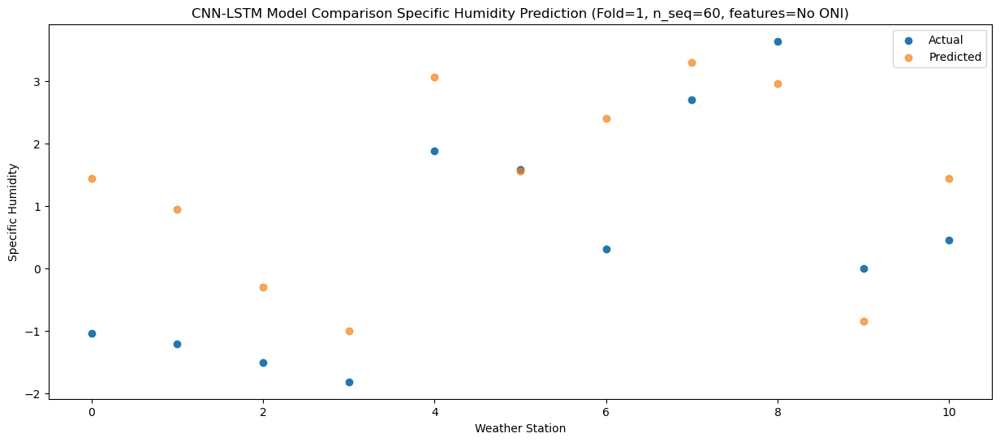

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12   0.947533
1                 1   -0.68   0.457533
2                 2   -1.11  -0.792466
3                 3   -2.51  -1.492458
4                 4    1.20   2.567545
5                 5    1.77   1.057553
6                 6    0.79   1.907536
7                 7    2.58   2.797538
8                 8    3.02   2.467547
9                 9    0.01  -1.342449
10               10    0.53   0.947533


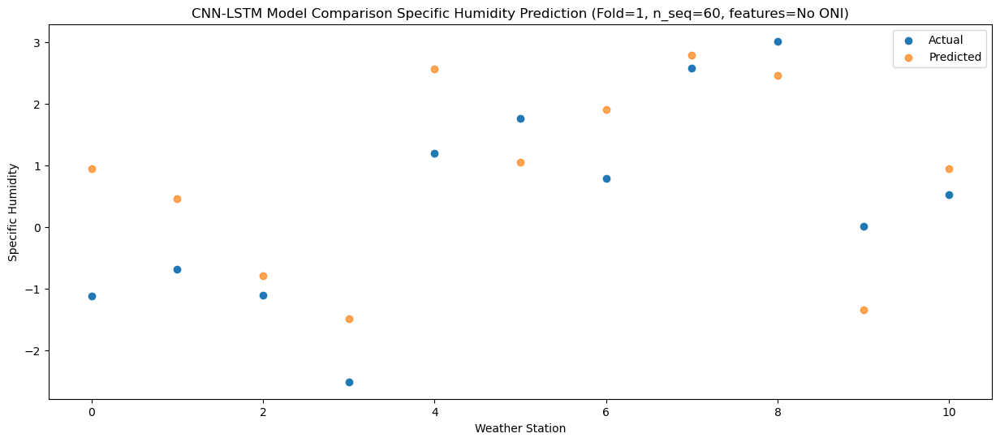

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.18   2.872168
1                 1    1.55   2.382165
2                 2    2.05   1.132166
3                 3    1.85   0.432196
4                 4    5.93   4.492197
5                 5    4.44   2.982229
6                 6    2.76   3.832168
7                 7    5.24   4.722176
8                 8    6.04   4.392205
9                 9    1.90   0.582225
10               10    1.48   2.872166


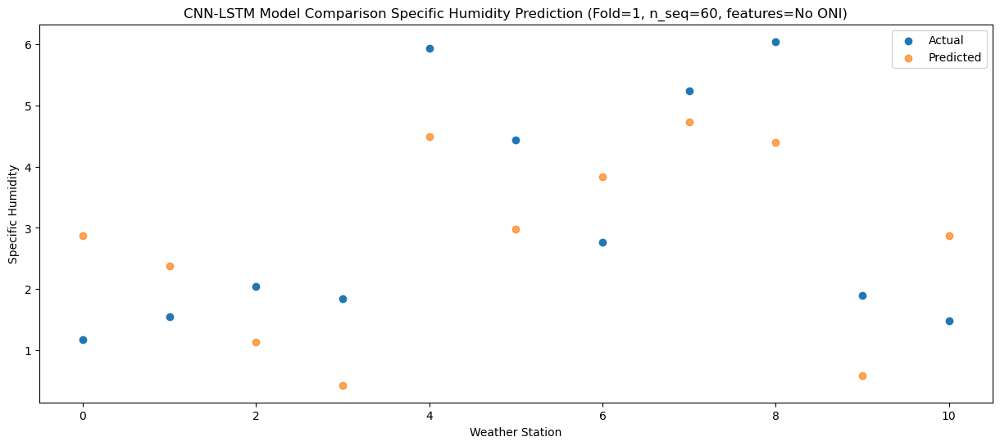

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.92   2.878002
1                 1   -0.04   2.387999
2                 2    0.43   1.138000
3                 3    1.51   0.438023
4                 4    5.62   4.498022
5                 5    3.43   2.988043
6                 6    2.11   3.838003
7                 7    5.50   4.728010
8                 8    6.23   4.398030
9                 9    2.06   0.588042
10               10    1.77   2.877998


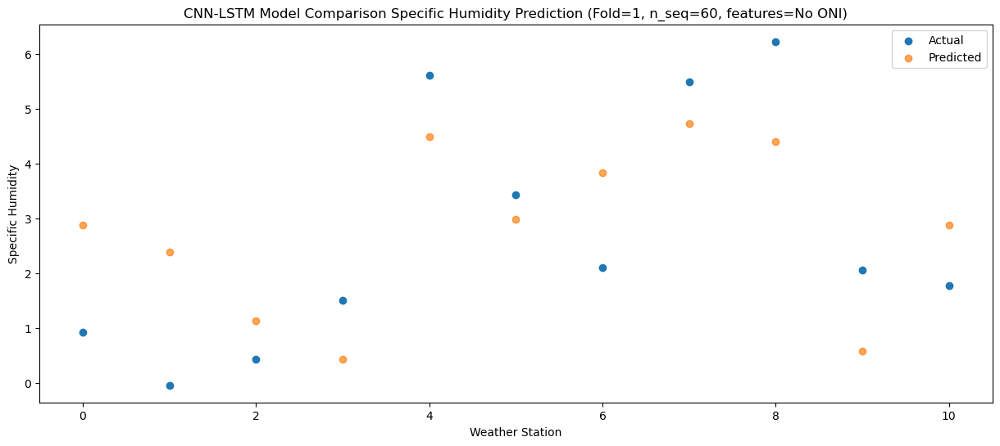

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    3.82   5.969559
1                 1    2.97   5.479560
2                 2    3.20   4.229559
3                 3    3.49   3.529569
4                 4    7.74   7.589568
5                 5    6.11   6.079576
6                 6    5.31   6.929562
7                 7    8.40   7.819566
8                 8    9.56   7.489573
9                 9    4.88   3.679578
10               10    4.34   5.969561


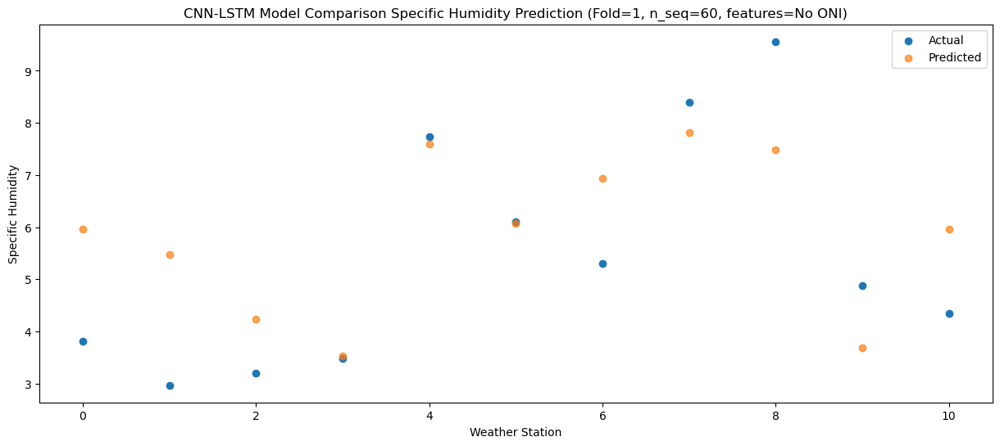

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.06   8.793751
1                 1    6.77   8.303752
2                 2    7.05   7.053751
3                 3    5.61   6.353759
4                 4   10.03  10.413758
5                 5    7.93   8.903766
6                 6    8.95   9.753753
7                 7   12.23  10.643758
8                 8   11.70  10.313766
9                 9    6.59   6.503767
10               10    7.98   8.793752


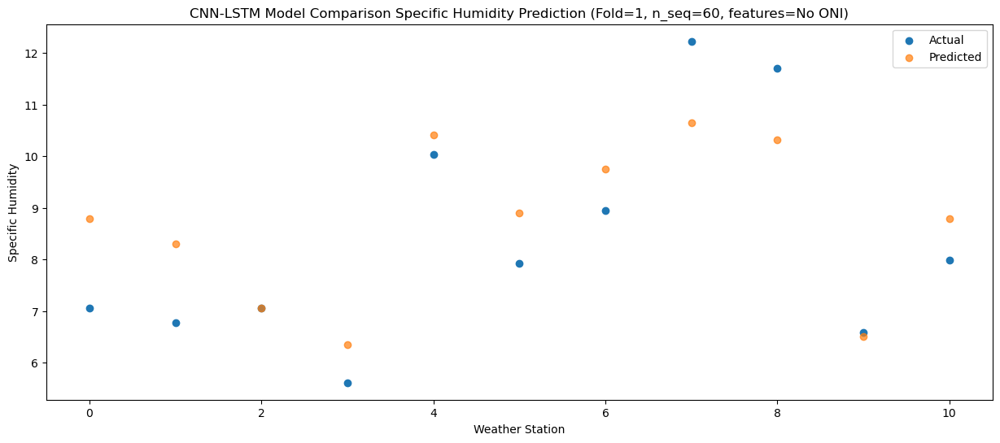

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    9.63  11.349733
1                 1    8.81  10.859733
2                 2    9.60   9.609734
3                 3    8.12   8.909745
4                 4   12.63  12.969744
5                 5    8.92  11.459752
6                 6   11.39  12.309735
7                 7   15.31  13.199742
8                 8   15.06  12.869751
9                 9    9.48   9.059753
10               10   11.62  11.349736


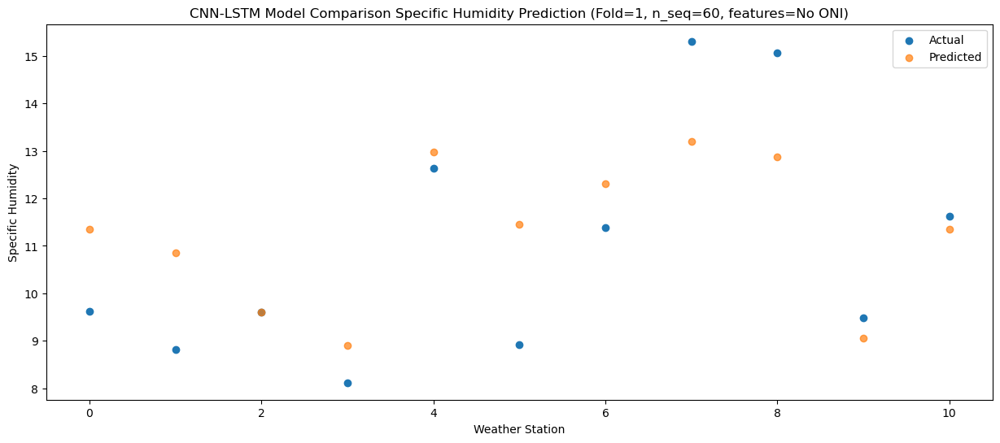

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.92   9.977347
1                 1    8.86   9.487348
2                 2    9.12   8.237350
3                 3    7.01   7.537360
4                 4   11.18  11.597359
5                 5    7.69  10.087367
6                 6   11.41  10.937351
7                 7   13.14  11.827358
8                 8   12.16  11.497366
9                 9    8.16   7.687367
10               10   11.53   9.977353


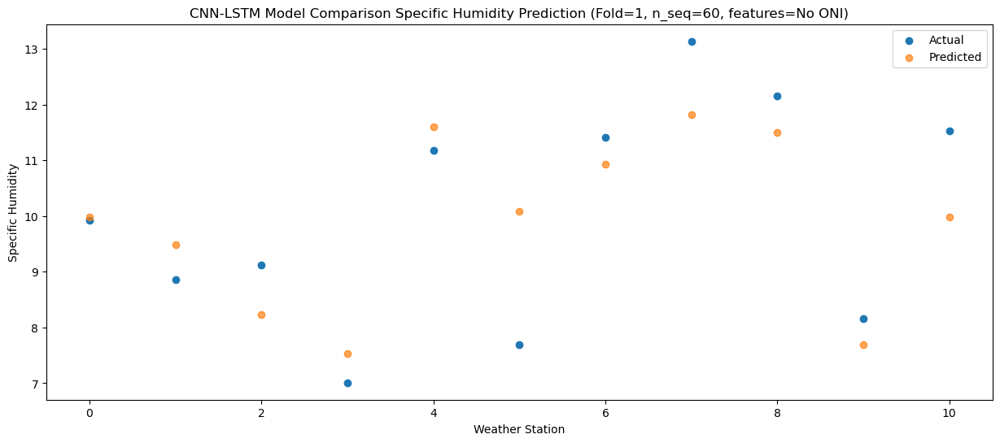

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.30   7.603978
1                 1    5.96   7.113979
2                 2    6.17   5.863981
3                 3    5.43   5.163989
4                 4    9.69   9.223988
5                 5    7.26   7.713995
6                 6    8.10   8.563983
7                 7   11.34   9.453989
8                 8   10.68   9.123995
9                 9    5.37   5.313995
10               10    8.05   7.603983


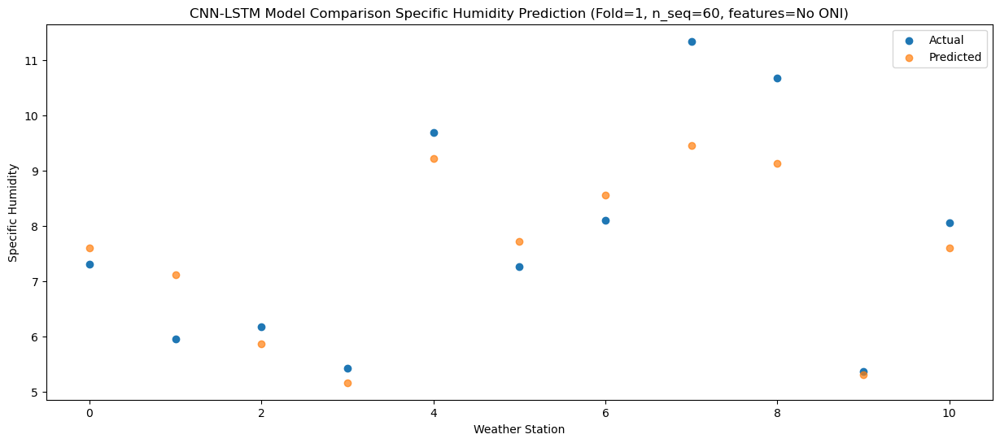

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.62   4.176448
1                 1    3.29   3.686448
2                 2    3.41   2.436451
3                 3    2.03   1.736468
4                 4    5.84   5.796465
5                 5    3.75   4.286483
6                 6    5.61   5.136452
7                 7    6.52   6.026460
8                 8    6.01   5.696476
9                 9    1.85   1.886482
10               10    5.13   4.176452


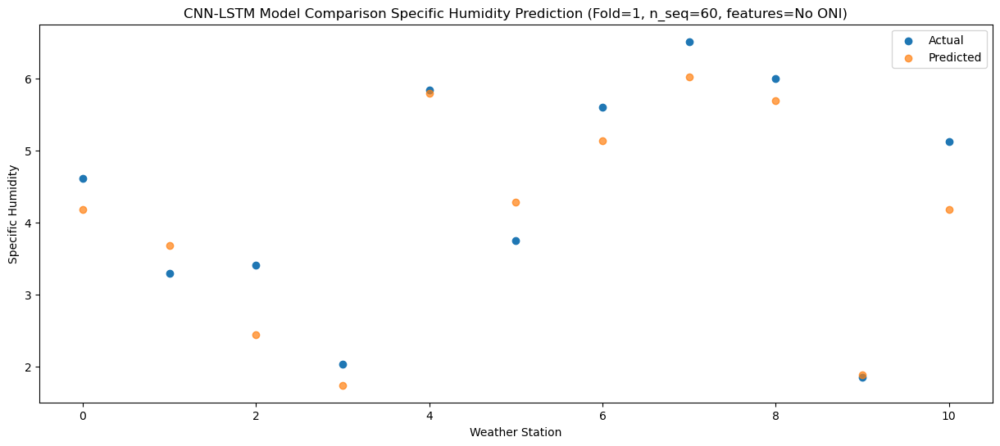

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.99   2.463552
1                 1    0.23   1.973551
2                 2    0.23   0.723555
3                 3   -0.07   0.023581
4                 4    3.36   4.083578
5                 5    3.19   2.573607
6                 6    2.50   3.423556
7                 7    4.50   4.313566
8                 8    4.90   3.983592
9                 9    1.53   0.173604
10               10    2.75   2.463555


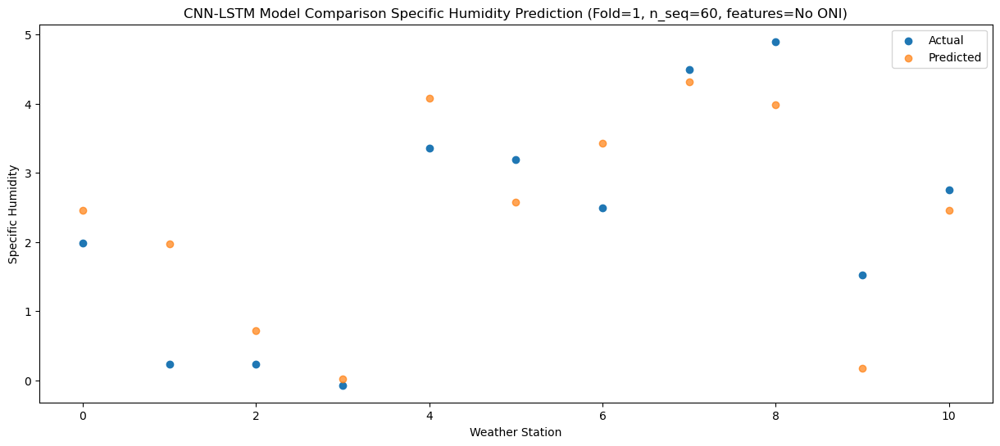

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.22   0.806498
1                 1   -2.36   0.316498
2                 2   -2.54  -0.933498
3                 3   -2.62  -1.633469
4                 4    0.54   2.426527
5                 5    0.75   0.916562
6                 6   -0.22   1.766503
7                 7    2.18   2.656513
8                 8    2.62   2.326542
9                 9   -0.33  -1.483443
10               10    0.59   0.806502


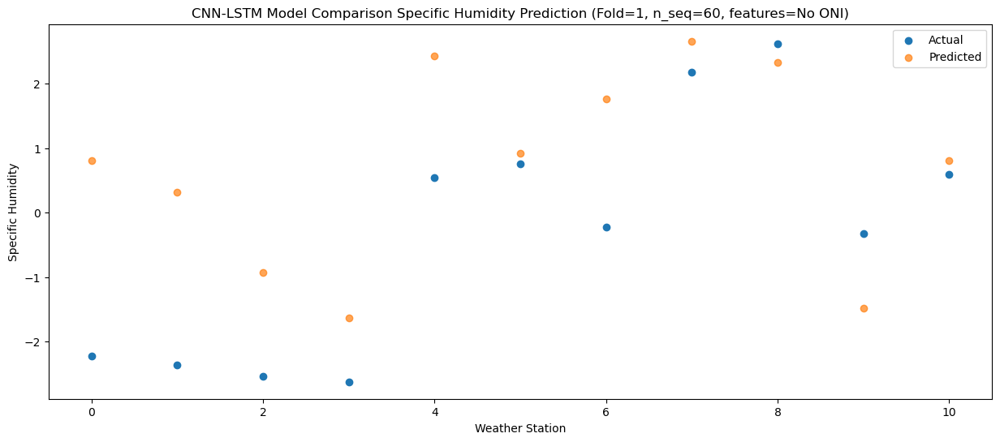

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.00   0.596956
1                 1   -2.34   0.106955
2                 2   -2.39  -1.143039
3                 3   -2.96  -1.843011
4                 4    0.29   2.216985
5                 5    1.58   0.707020
6                 6   -0.33   1.556960
7                 7    2.05   2.446970
8                 8    2.78   2.116998
9                 9   -0.14  -1.692984
10               10   -0.14   0.596961


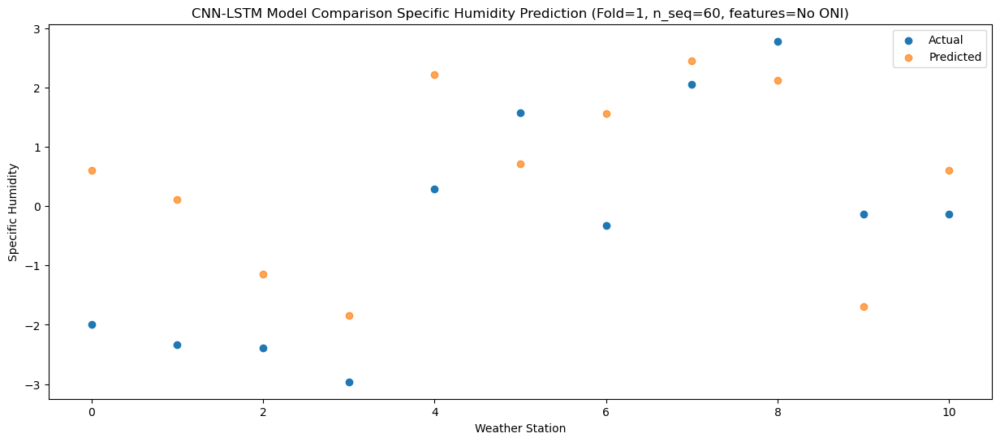

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.68   0.084462
1                 1   -2.15  -0.405538
2                 2   -2.39  -1.655533
3                 3   -2.89  -2.355513
4                 4    0.33   1.704484
5                 5    0.95   0.194510
6                 6   -0.21   1.044467
7                 7    1.53   1.934474
8                 8    1.97   1.604494
9                 9   -0.88  -2.205492
10               10   -0.10   0.084467


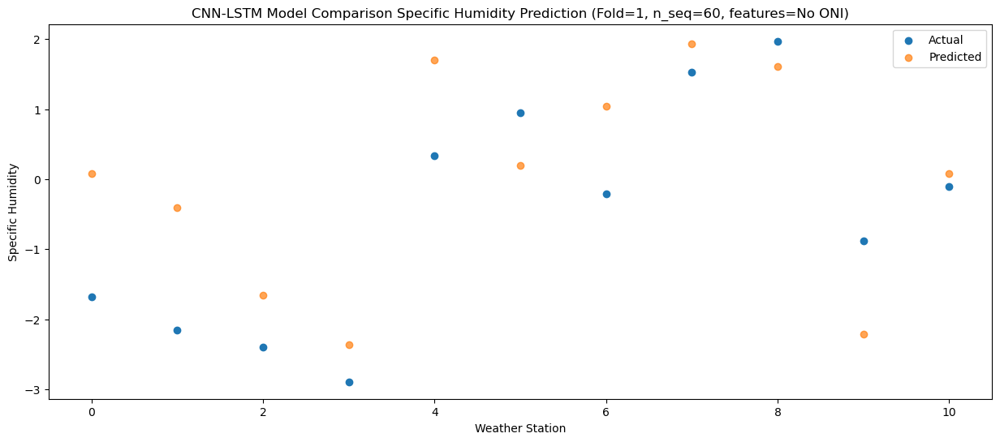

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.15   1.864839
1                 1   -0.62   1.374839
2                 2    0.23   0.124844
3                 3   -0.25  -0.575129
4                 4    3.05   3.484868
5                 5    1.74   1.974900
6                 6    1.35   2.824842
7                 7    4.26   3.714850
8                 8    4.58   3.384875
9                 9    0.94  -0.425103
10               10    1.14   1.864841


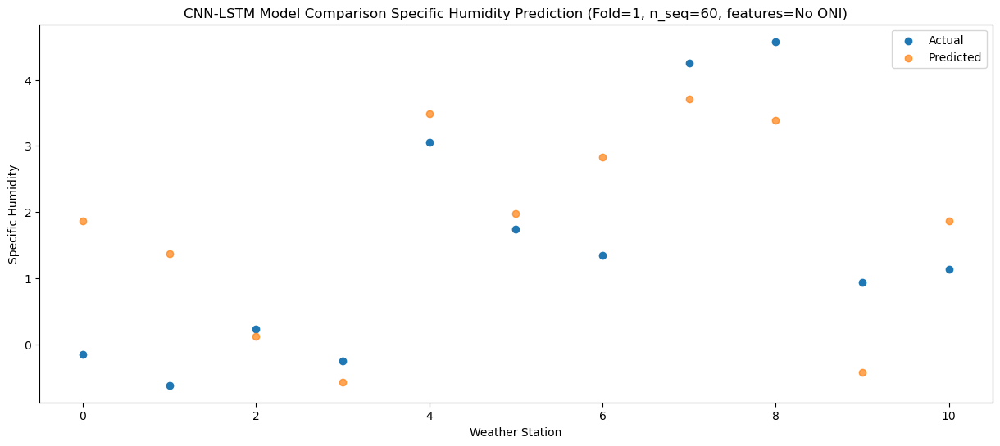

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.05   2.754765
1                 1   -0.26   2.264765
2                 2   -0.06   1.014771
3                 3    1.09   0.314806
4                 4    4.31   4.374803
5                 5    3.04   2.864843
6                 6    1.97   3.714769
7                 7    5.49   4.604777
8                 8    5.74   4.274813
9                 9    1.11   0.464836
10               10    2.51   2.754768


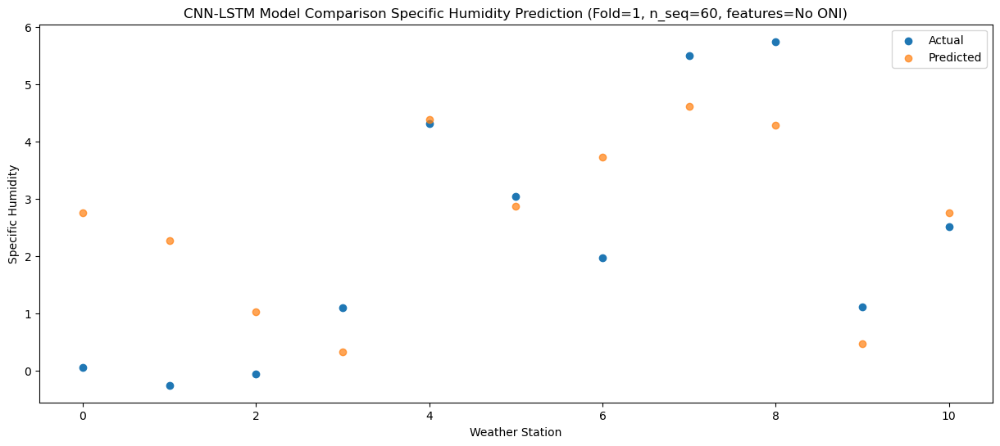

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    2.73   5.191873
1                 1    2.66   4.701872
2                 2    2.78   3.451879
3                 3    4.98   2.751918
4                 4    8.34   6.811913
5                 5    7.35   5.301954
6                 6    4.90   6.151877
7                 7    8.70   7.041884
8                 8    9.96   6.711924
9                 9    6.26   2.901946
10               10    4.04   5.191876


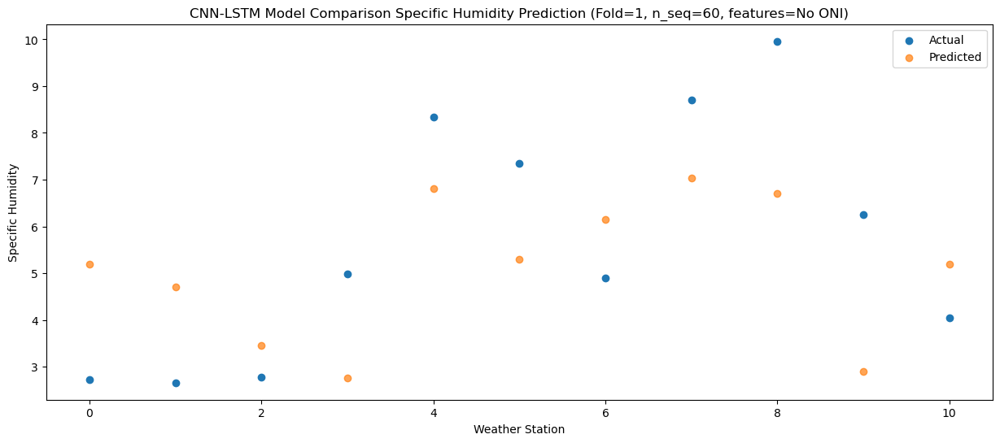

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.89   9.422738
1                 1    6.64   8.932738
2                 2    7.30   7.682745
3                 3    8.17   6.982782
4                 4   11.75  11.042777
5                 5    9.52   9.532810
6                 6    9.25  10.382743
7                 7   13.46  11.272750
8                 8   13.10  10.942788
9                 9    9.25   7.132803
10               10    9.36   9.422742


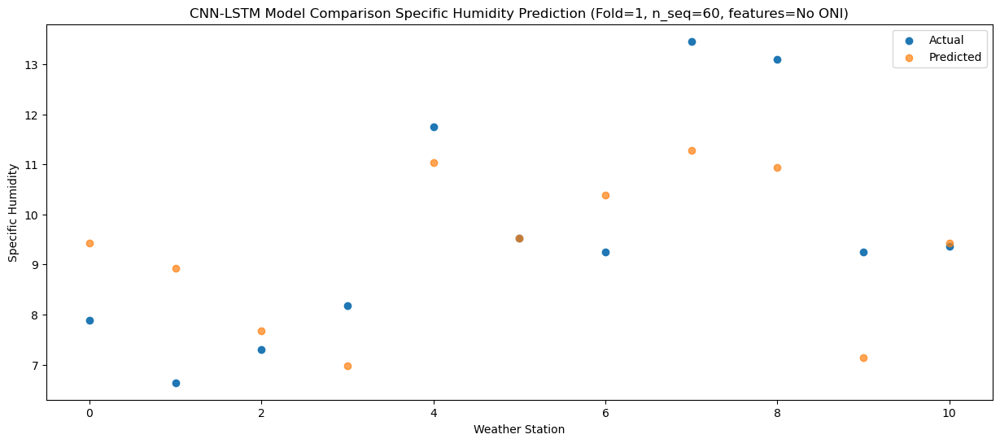

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.04  10.471683
1                 1    8.51   9.981683
2                 2    8.89   8.731689
3                 3    8.65   8.031721
4                 4   11.93  12.091717
5                 5   10.85  10.581747
6                 6   11.75  11.431688
7                 7   14.09  12.321693
8                 8   14.15  11.991728
9                 9   10.49   8.181742
10               10   11.22  10.471686


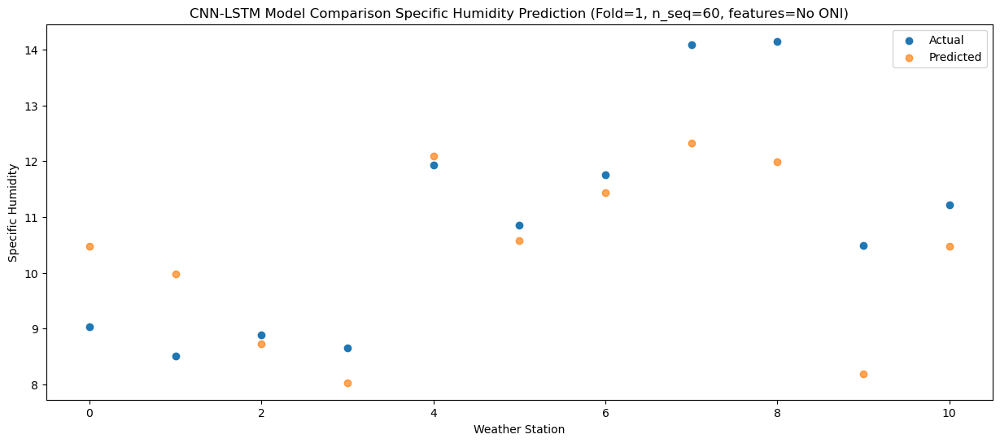

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.80  10.568664
1                 1    8.72  10.078666
2                 2    9.11   8.828671
3                 3    8.99   8.128703
4                 4   11.97  12.188699
5                 5   11.07  10.678725
6                 6   12.04  11.528670
7                 7   13.94  12.418674
8                 8   13.73  12.088707
9                 9    9.46   8.278719
10               10   11.56  10.568666


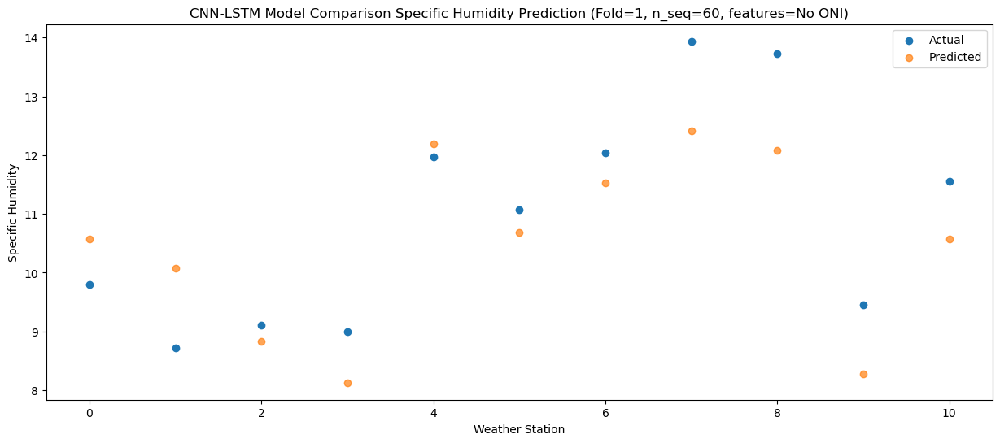

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    6.32   7.321786
1                 1    5.77   6.831788
2                 2    6.35   5.581794
3                 3    5.90   4.881816
4                 4    8.87   8.941813
5                 5    7.53   7.431831
6                 6    8.69   8.281793
7                 7   10.69   9.171794
8                 8   10.16   8.841820
9                 9    6.50   5.031826
10               10    8.37   7.321789


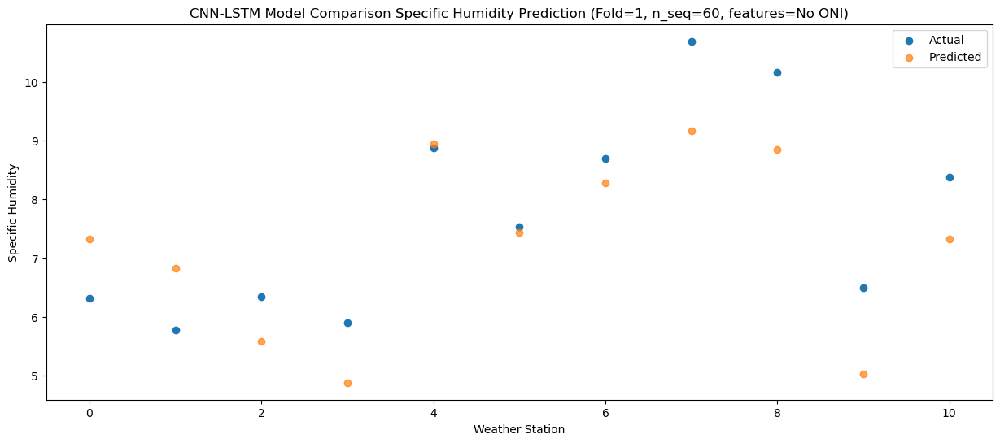

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.74   5.741807
1                 1    3.73   5.251808
2                 2    3.60   4.001814
3                 3    3.65   3.301845
4                 4    6.92   7.361842
5                 5    4.42   5.851873
6                 6    6.56   6.701813
7                 7    7.96   7.591815
8                 8    7.72   7.261850
9                 9    3.06   3.451864
10               10    6.51   5.741808


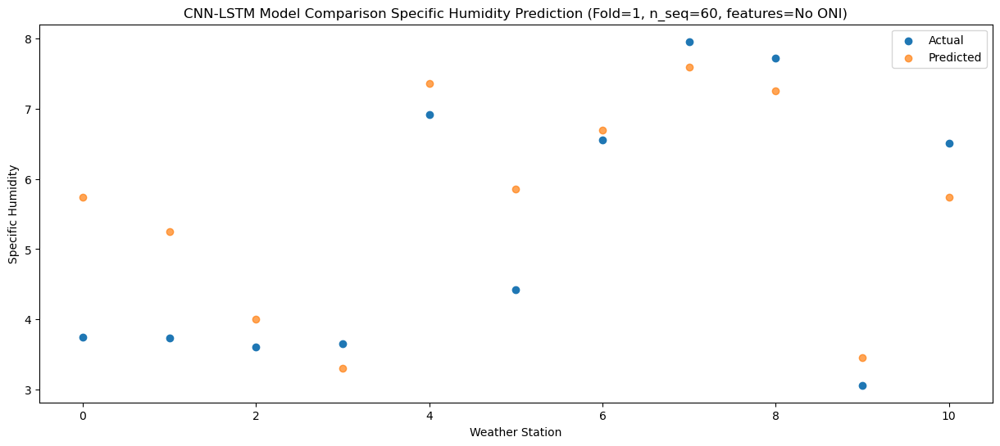

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.92   1.134617
1                 1   -1.86   0.644618
2                 2   -1.90  -0.605375
3                 3   -0.80  -1.305339
4                 4    2.33   2.754658
5                 5    2.58   1.244692
6                 6    0.63   2.094625
7                 7    3.40   2.984627
8                 8    4.19   2.654665
9                 9    0.70  -1.155316
10               10    1.32   1.134619


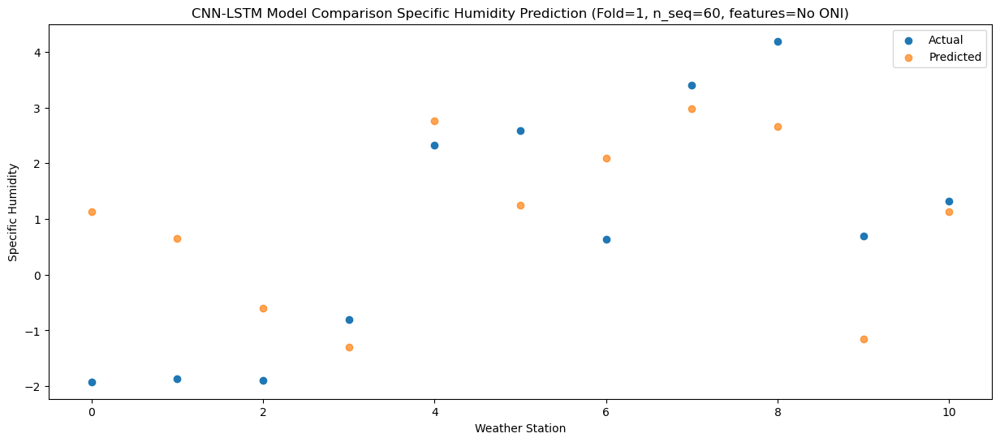

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.19   1.757498
1                 1    0.31   1.267499
2                 2    0.74   0.017506
3                 3    2.12  -0.682470
4                 4    5.26   3.377527
5                 5    1.53   1.867546
6                 6    2.50   2.717504
7                 7    5.04   3.607504
8                 8    3.58   3.277533
9                 9   -0.28  -0.532460
10               10    1.20   1.757497


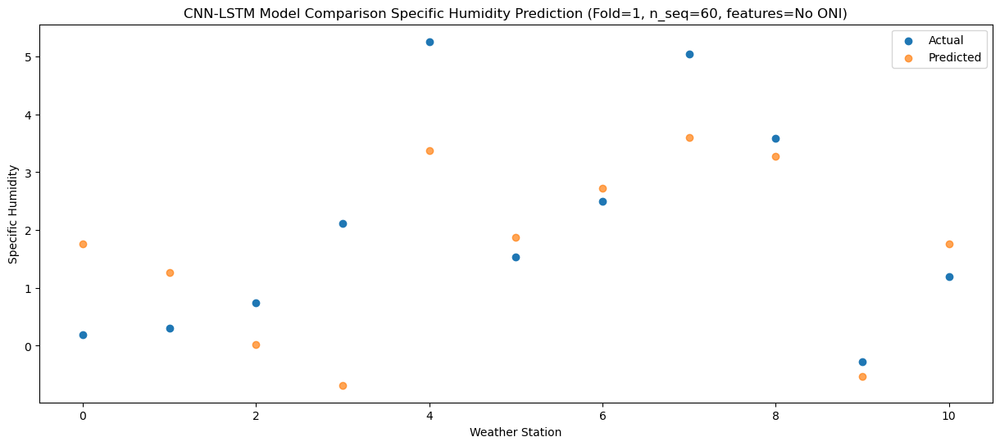

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.06  -0.576936
1                 1   -2.69  -1.066937
2                 2   -3.14  -2.316930
3                 3   -3.53  -3.016898
4                 4   -0.28   1.043097
5                 5    0.26  -0.466877
6                 6   -0.50   0.383069
7                 7    1.29   1.273070
8                 8    1.60   0.943106
9                 9   -0.92  -2.866883
10               10   -0.41  -0.576938


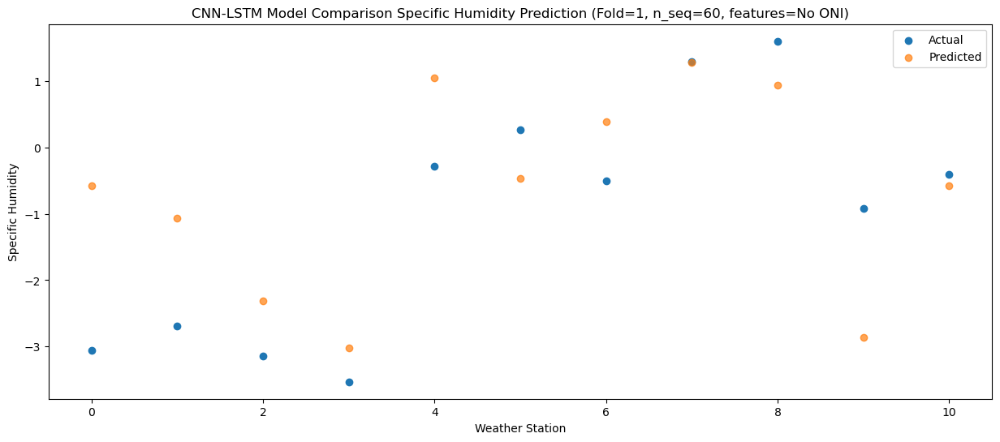

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.12  -0.280900
1                 1   -1.74  -0.770901
2                 2   -2.11  -2.020894
3                 3   -3.36  -2.720864
4                 4   -0.08   1.339130
5                 5    0.14  -0.170846
6                 6    0.63   0.679106
7                 7    1.97   1.569106
8                 8    2.13   1.239138
9                 9   -1.00  -2.570853
10               10    0.33  -0.280902


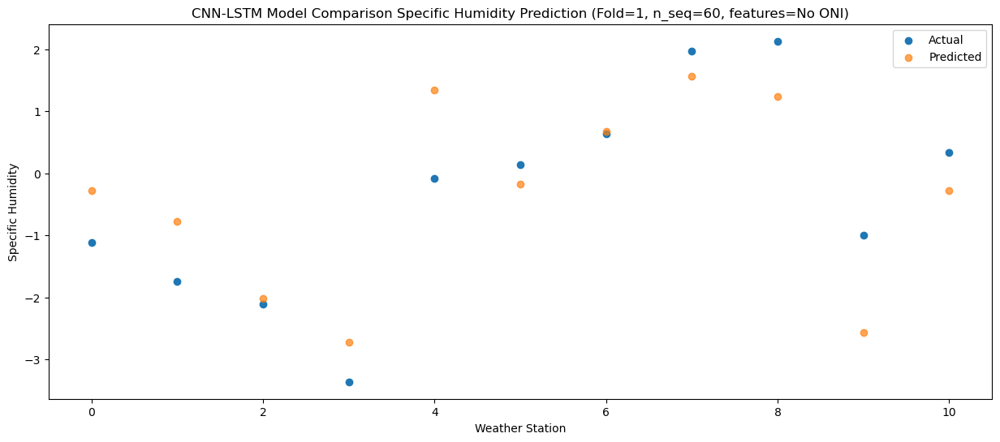

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.01   1.088595
1                 1   -1.06   0.598594
2                 2   -1.32  -0.651398
3                 3   -1.68  -1.351365
4                 4    1.62   2.708628
5                 5    0.69   1.198657
6                 6    1.38   2.048601
7                 7    3.50   2.938601
8                 8    3.22   2.608635
9                 9   -0.04  -1.201354
10               10    1.35   1.088594


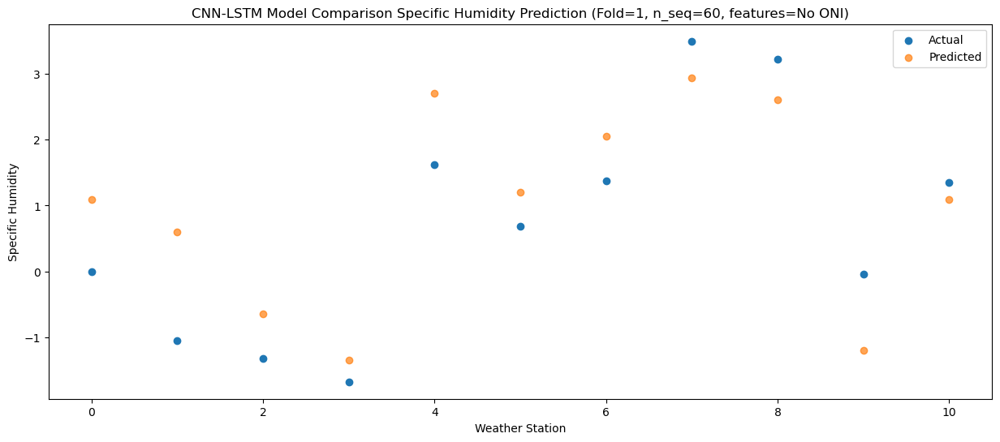

Predictions for (t+29):
    Weather_Station        Actual  Predicted
0                 0  1.010000e+00   2.352579
1                 1  1.332268e-15   1.862580
2                 2  4.400000e-01   0.612587
3                 3  2.480000e+00  -0.087386
4                 4  5.720000e+00   3.972609
5                 5  2.960000e+00   2.462627
6                 6  2.570000e+00   3.312587
7                 7  5.690000e+00   4.202584
8                 8  6.340000e+00   3.872613
9                 9  9.300000e-01   0.062617
10               10  2.010000e+00   2.352579


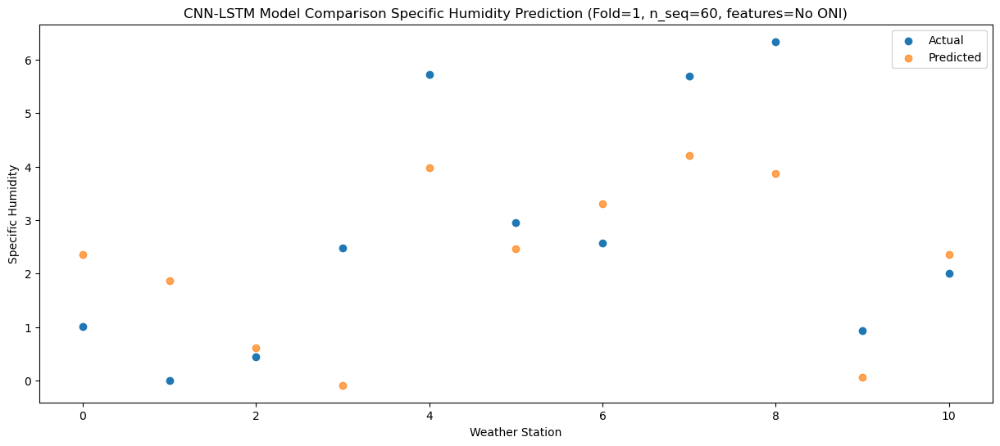

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.953000
1                 1    4.17   5.463001
2                 2    4.80   4.213009
3                 3    6.29   3.513031
4                 4    9.60   7.573026
5                 5    4.73   6.063041
6                 6    6.83   6.913010
7                 7   10.14   7.803008
8                 8   10.58   7.473029
9                 9    3.49   3.663032
10               10    6.14   5.953000


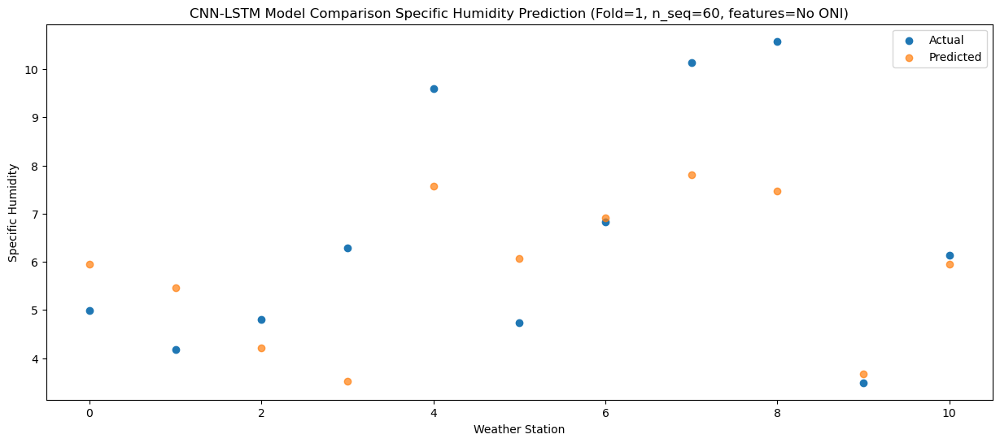

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    7.29   8.030491
1                 1    6.57   7.540489
2                 2    7.89   6.290495
3                 3    7.34   5.590522
4                 4   10.72   9.650517
5                 5    7.33   8.140533
6                 6    9.55   8.990497
7                 7   12.90   9.880498
8                 8   12.48   9.550521
9                 9    7.67   5.740525
10               10    7.73   8.030491


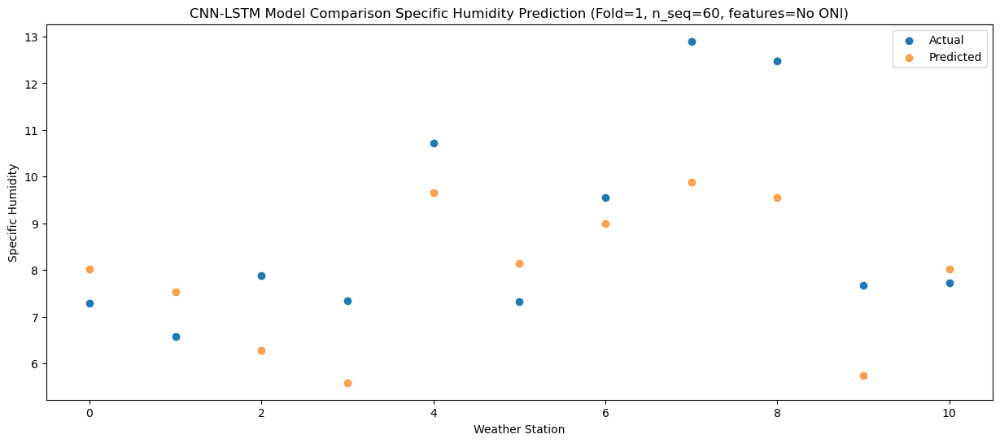

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    9.91  10.171183
1                 1    9.24   9.681181
2                 2    9.52   8.431187
3                 3    8.26   7.731210
4                 4   11.47  11.791205
5                 5    8.28  10.281216
6                 6   12.54  11.131189
7                 7   13.87  12.021189
8                 8   11.84  11.691210
9                 9    8.32   7.881209
10               10   11.36  10.171182


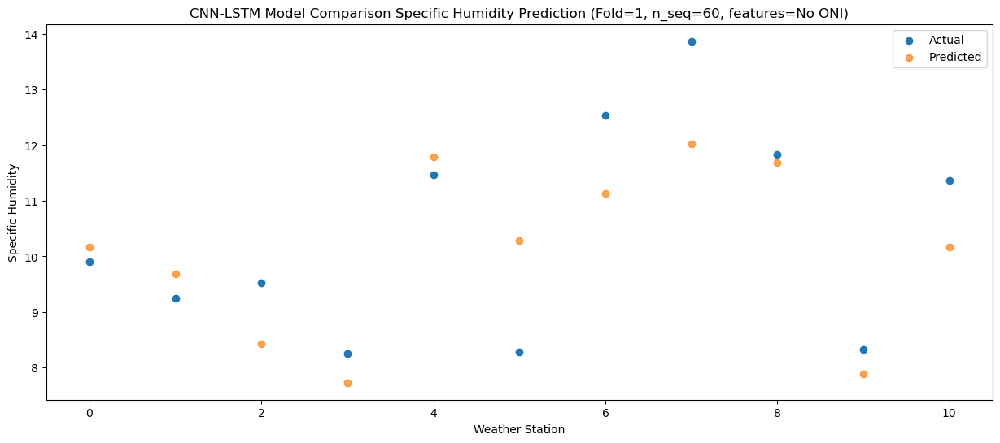

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.91  10.051859
1                 1    8.83   9.561857
2                 2    8.65   8.311864
3                 3    8.51   7.611893
4                 4   11.85  11.671888
5                 5   10.39  10.161902
6                 6   11.45  11.011865
7                 7   13.78  11.901867
8                 8   12.58  11.571893
9                 9    8.73   7.761895
10               10   10.93  10.051858


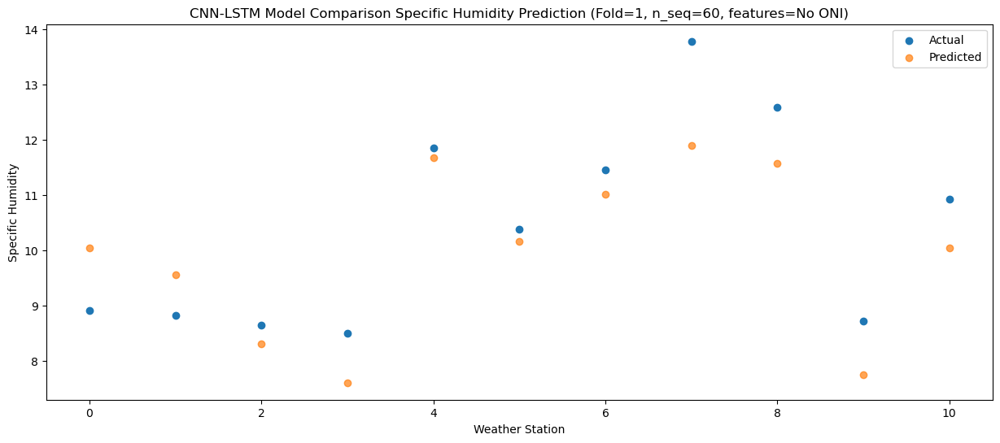

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.29   7.024853
1                 1    5.47   6.534853
2                 2    5.14   5.284859
3                 3    5.22   4.584875
4                 4    8.50   8.644870
5                 5    9.12   7.134871
6                 6    7.97   7.984860
7                 7    9.82   8.874860
8                 8    9.84   8.544873
9                 9    6.73   4.734867
10               10    7.68   7.024855


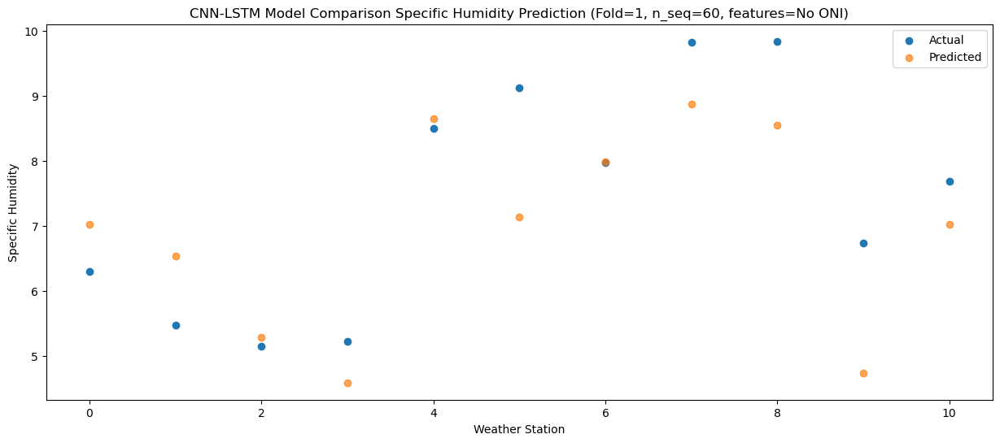

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    1.43   2.729439
1                 1    0.58   2.239441
2                 2    0.03   0.989445
3                 3    0.26   0.289460
4                 4    3.60   4.349455
5                 5    5.93   2.839451
6                 6    2.91   3.689447
7                 7    5.28   4.579446
8                 8    5.89   4.249457
9                 9    3.34   0.439447
10               10    4.24   2.729440


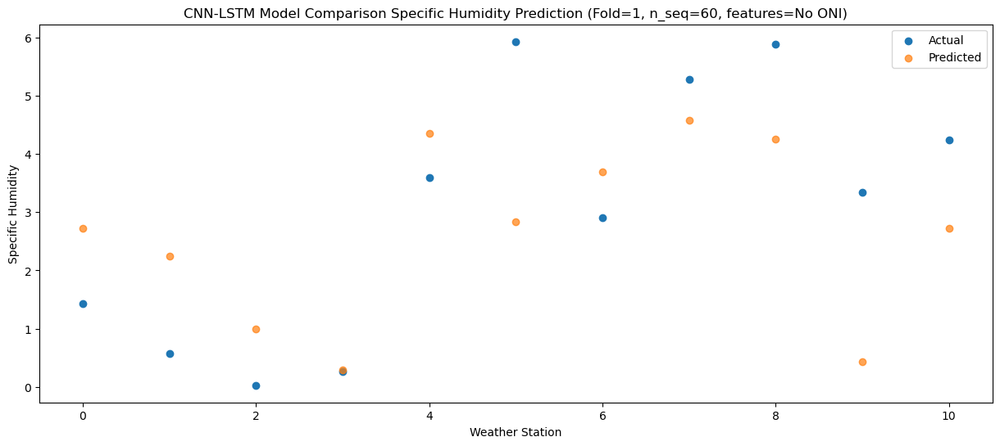

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.90   1.436891
1                 1    0.10   0.946895
2                 2   -0.34  -0.303100
3                 3   -0.24  -1.003093
4                 4    3.22   3.056904
5                 5    3.06   1.546894
6                 6    2.42   2.396901
7                 7    4.03   3.286897
8                 8    4.91   2.956905
9                 9    1.36  -0.853107
10               10    2.74   1.436895


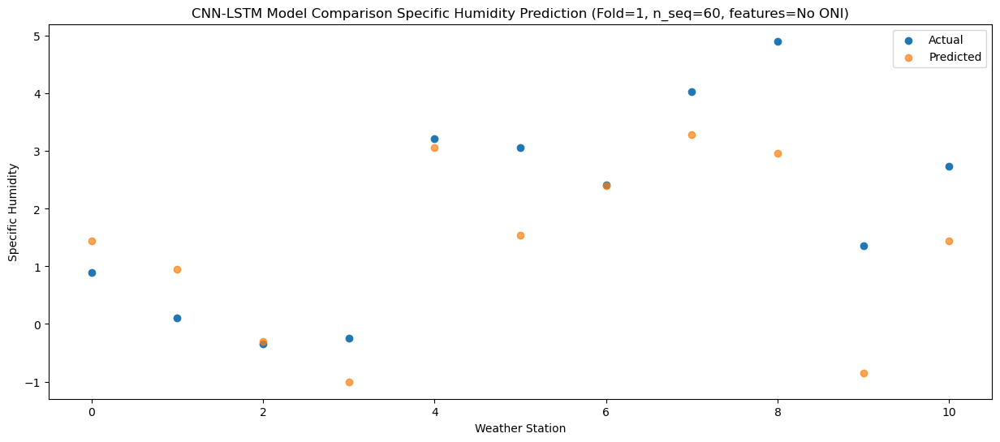

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.82   0.426198
1                 1   -1.49  -0.063798
2                 2   -1.03  -1.313793
3                 3   -1.05  -2.013789
4                 4    2.40   2.046208
5                 5    2.39   0.536197
6                 6    0.52   1.386208
7                 7    3.12   2.276202
8                 8    3.17   1.946209
9                 9    0.15  -1.863804
10               10    0.61   0.426204


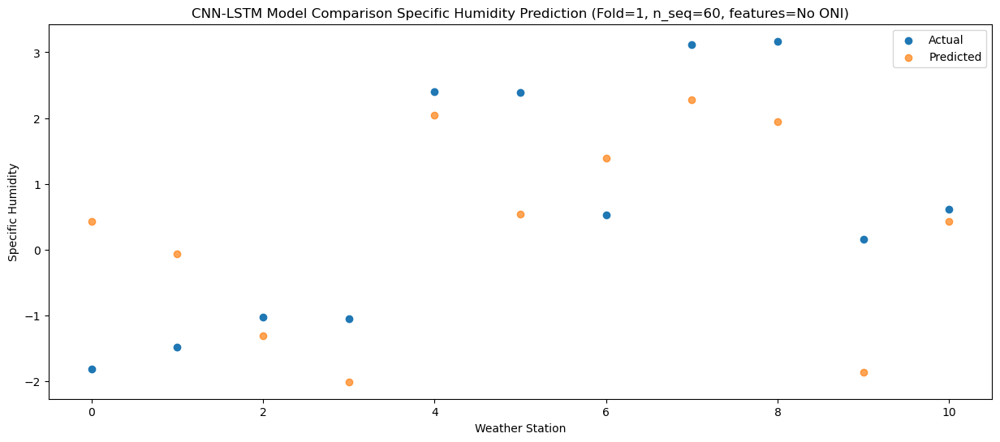

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -1.36   0.779256
1                 1   -1.08   0.289262
2                 2   -1.06  -0.960733
3                 3   -1.47  -1.660732
4                 4    1.92   2.399266
5                 5    0.84   0.889251
6                 6    0.88   1.739269
7                 7    3.24   2.629263
8                 8    2.69   2.299268
9                 9   -0.16  -1.510749
10               10    1.47   0.779270


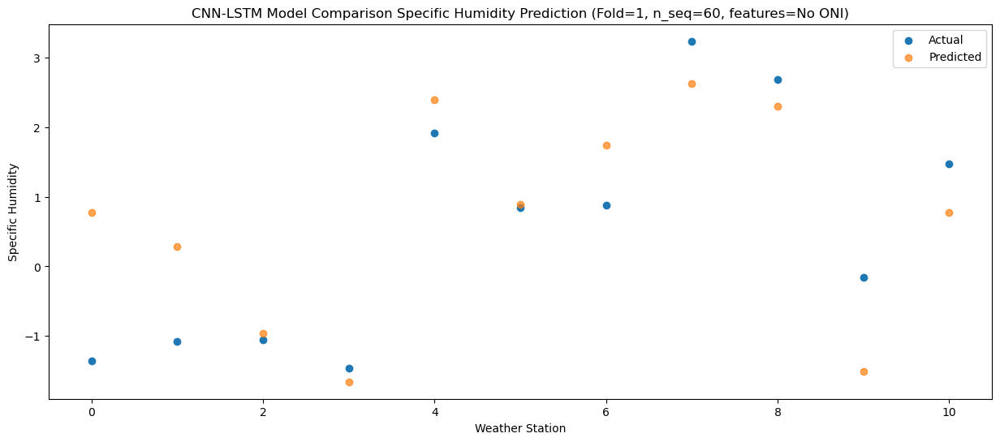

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.25   0.403096
1                 1    0.04  -0.086902
2                 2   -0.01  -1.336895
3                 3   -0.69  -2.036886
4                 4    2.52   2.023110
5                 5    0.87   0.513103
6                 6    2.08   1.363107
7                 7    3.34   2.253101
8                 8    3.02   1.923114
9                 9   -0.30  -1.886899
10               10    0.67   0.403105


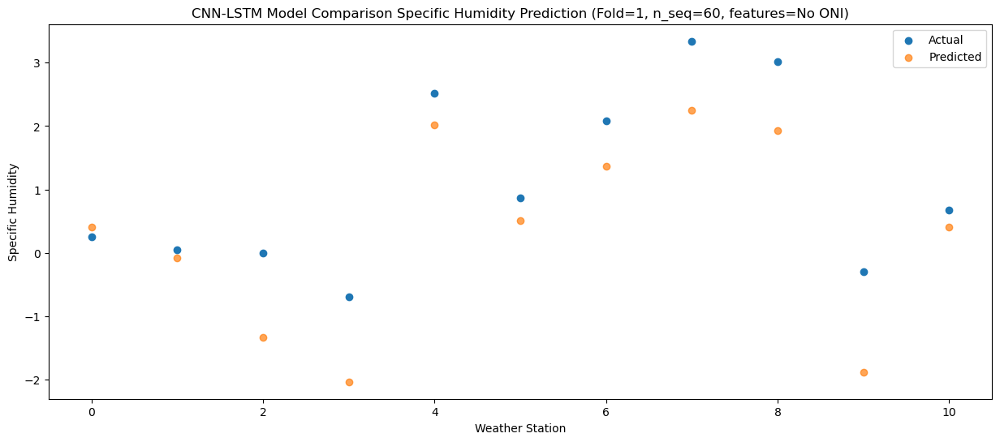

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.13   0.749286
1                 1   -0.83   0.259289
2                 2   -0.48  -0.990705
3                 3    0.86  -1.690696
4                 4    4.22   2.369302
5                 5    1.92   0.859292
6                 6    1.32   1.709299
7                 7    4.10   2.599290
8                 8    4.44   2.269302
9                 9    0.49  -1.540712
10               10    0.70   0.749297


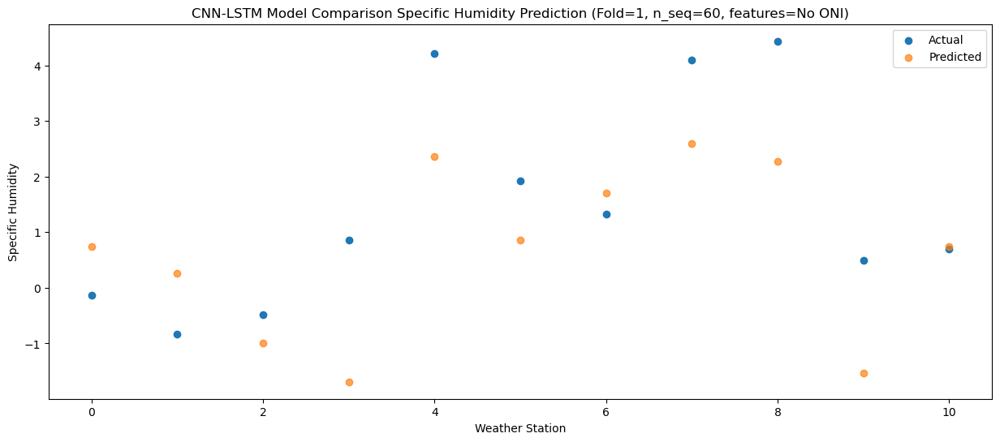

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.57   2.005692
1                 1    0.77   1.515694
2                 2    0.88   0.265701
3                 3    1.23  -0.434295
4                 4    4.67   3.625703
5                 5    2.18   2.115690
6                 6    3.13   2.965706
7                 7    5.30   3.855693
8                 8    5.66   3.525703
9                 9    1.01  -0.284314
10               10    3.31   2.005700


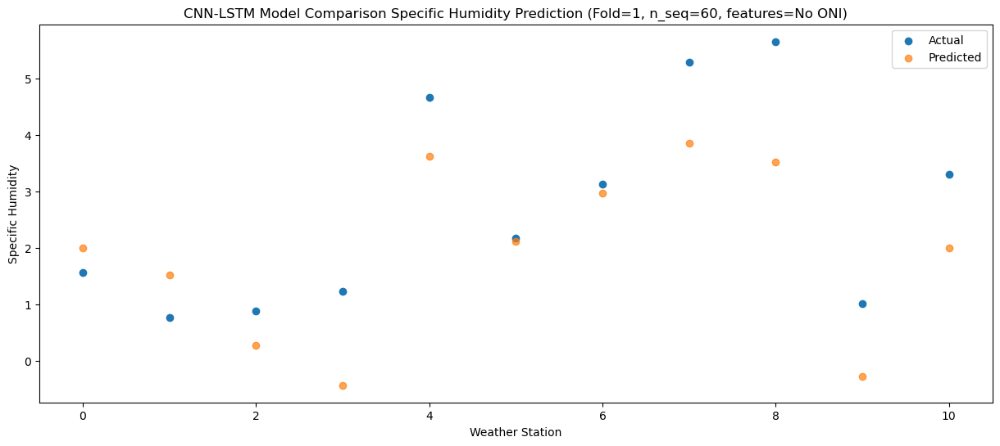

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.77   4.324753
1                 1    3.51   3.834757
2                 2    4.18   2.584762
3                 3    5.01   1.884772
4                 4    8.34   5.944768
5                 5    6.55   4.434759
6                 6    5.69   5.284767
7                 7    9.34   6.174754
8                 8   10.71   5.844767
9                 9    6.74   2.034756
10               10    3.61   4.324760


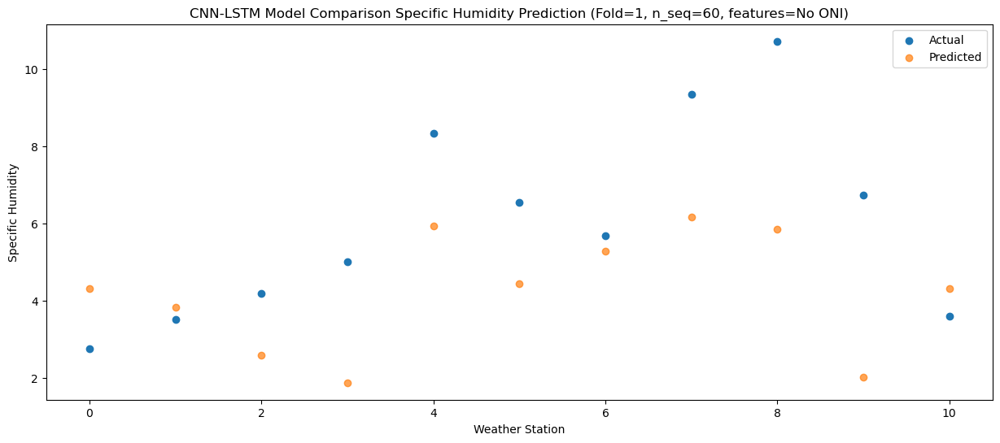

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.12   6.772629
1                 1    5.86   6.282635
2                 2    6.83   5.032639
3                 3    8.41   4.332640
4                 4   11.60   8.392637
5                 5    6.50   6.882618
6                 6    8.27   7.732645
7                 7   12.26   8.622629
8                 8   13.29   8.292632
9                 9    8.35   4.482618
10               10    6.90   6.772634


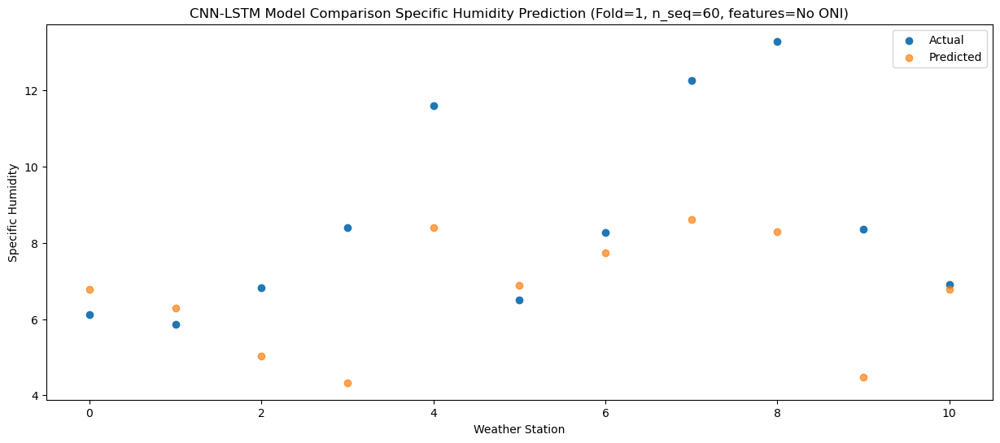

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    9.53   9.543452
1                 1    8.82   9.053458
2                 2    9.97   7.803463
3                 3    8.97   7.103464
4                 4   11.68  11.163461
5                 5    8.67   9.653447
6                 6   11.89  10.503469
7                 7   14.83  11.393451
8                 8   13.52  11.063457
9                 9   10.28   7.253446
10               10   11.61   9.543452


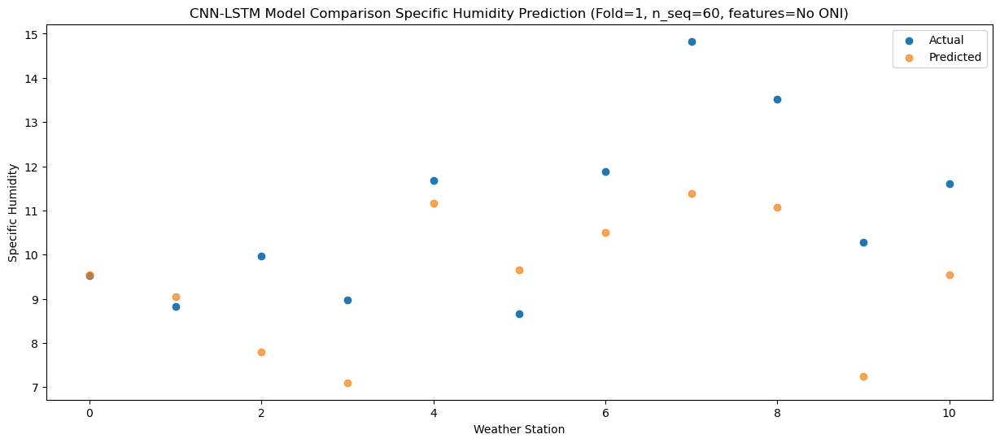

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.36   9.174696
1                 1    8.95   8.684703
2                 2    9.90   7.434708
3                 3    7.30   6.734701
4                 4   10.28  10.794699
5                 5    8.82   9.284675
6                 6   11.78  10.134714
7                 7   14.41  11.024694
8                 8   11.69  10.694695
9                 9    8.37   6.884676
10               10    9.32   9.174695


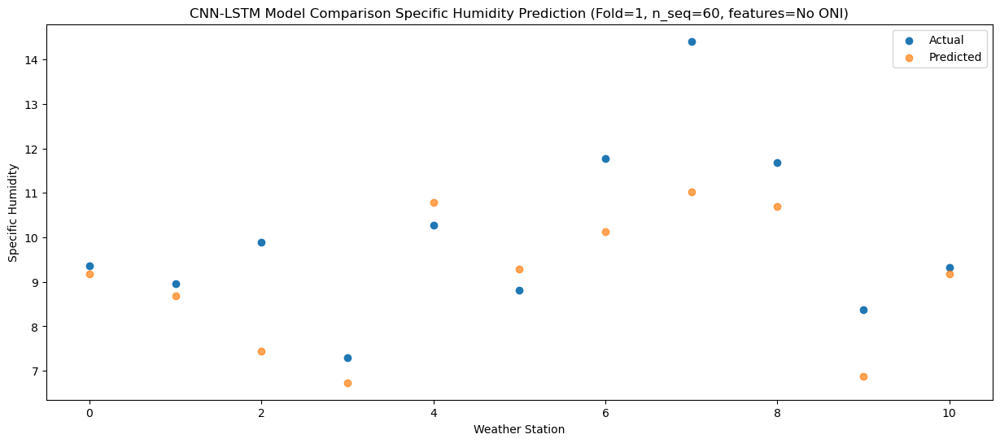

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.50   6.791537
1                 1    5.84   6.301542
2                 2    6.09   5.051548
3                 3    6.10   4.351535
4                 4    9.53   8.411534
5                 5    8.46   6.901508
6                 6    8.81   7.751554
7                 7    9.92   8.641531
8                 8   10.74   8.311529
9                 9    6.72   4.501508
10               10    8.06   6.791535


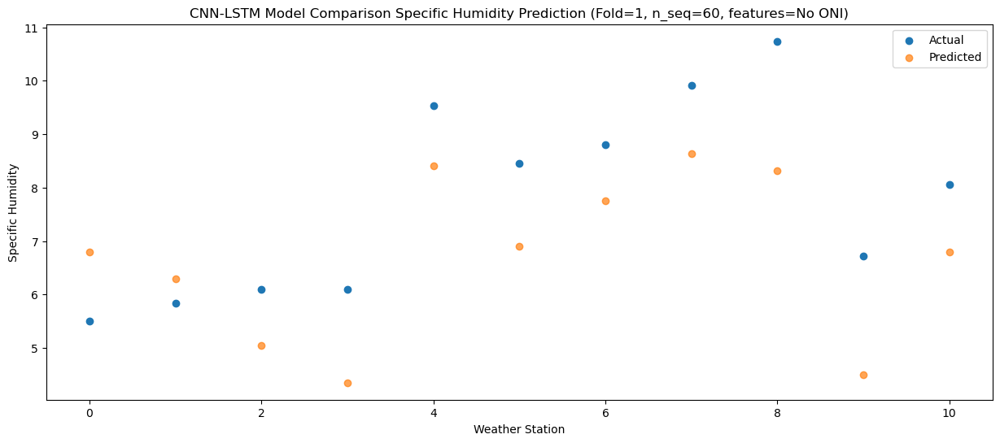

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.10   3.444682
1                 1    1.99   2.954690
2                 2    1.58   1.704696
3                 3    2.68   1.004669
4                 4    6.14   5.064669
5                 5    6.48   3.554627
6                 6    4.56   4.404703
7                 7    6.67   5.294676
8                 8    7.31   4.964660
9                 9    3.61   1.154631
10               10    5.01   3.444681


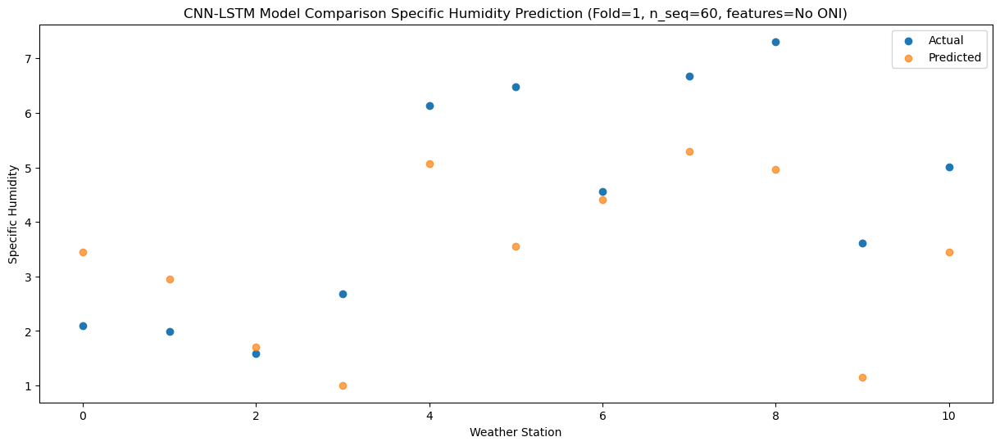

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.96   0.514386
1                 1   -1.02   0.024395
2                 2   -0.97  -1.225600
3                 3   -0.65  -1.925634
4                 4    2.80   2.134367
5                 5    3.85   0.624317
6                 6    1.21   1.474408
7                 7    3.96   2.364378
8                 8    4.64   2.034356
9                 9    1.29  -1.775678
10               10    1.35   0.514387


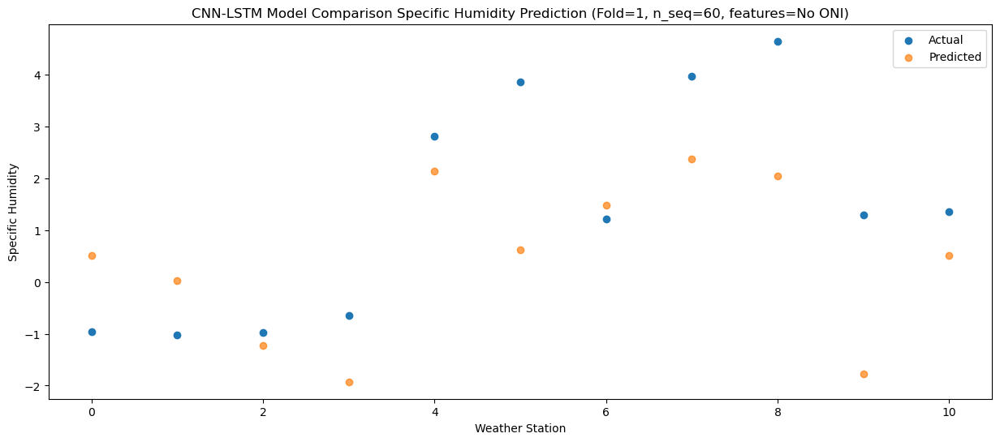

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.71   0.310280
1                 1   -1.60  -0.179713
2                 2   -1.99  -1.429706
3                 3   -2.29  -2.129744
4                 4    1.08   1.930257
5                 5    1.98   0.420201
6                 6    0.71   1.270300
7                 7    2.57   2.160273
8                 8    3.59   1.830241
9                 9    0.85  -1.979795
10               10    1.59   0.310279


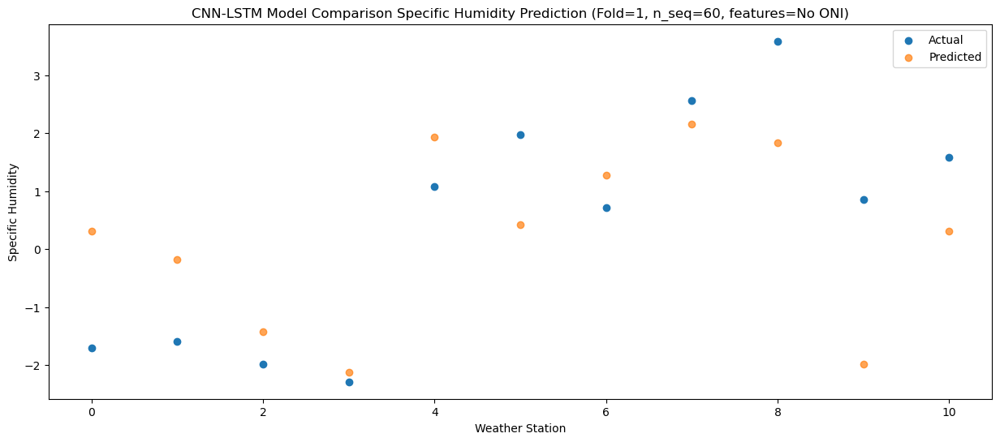

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.10  -0.761945
1                 1   -2.37  -1.251936
2                 2   -2.62  -2.501930
3                 3   -3.39  -3.201967
4                 4   -0.09   0.858035
5                 5    0.83  -0.652017
6                 6   -0.11   0.198075
7                 7    1.50   1.088048
8                 8    2.28   0.758021
9                 9    0.11  -3.052014
10               10    0.54  -0.761947


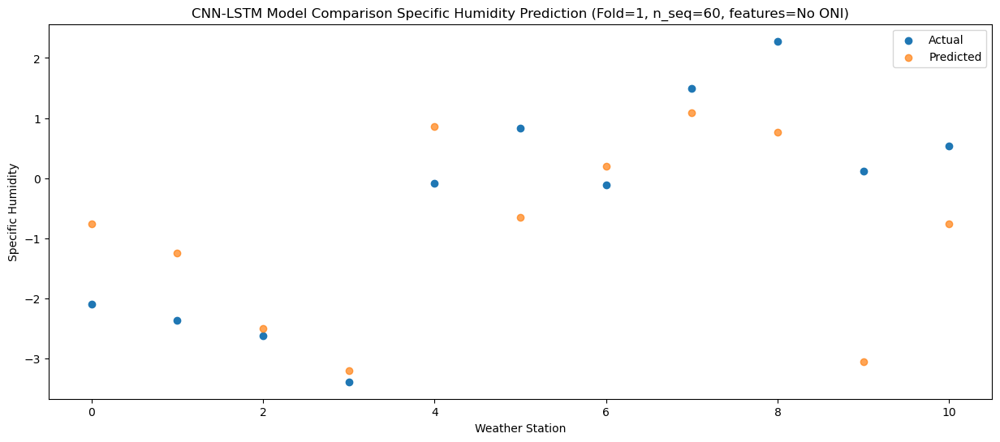

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -2.49   0.039595
1                 1   -2.03  -0.450397
2                 2   -1.82  -1.700392
3                 3   -1.14  -2.400431
4                 4    2.16   1.659570
5                 5    1.24   0.149518
6                 6    0.37   0.999615
7                 7    3.25   1.889588
8                 8    4.03   1.559555
9                 9    0.78  -2.250479
10               10    0.41   0.039596


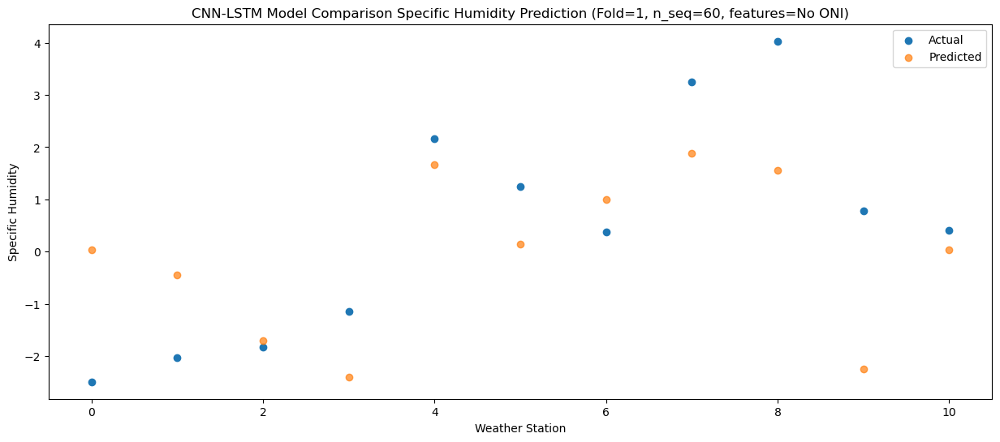

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.08   0.785618
1                 1   -0.52   0.295624
2                 2   -0.28  -0.954370
3                 3    0.77  -1.654409
4                 4    4.09   2.405591
5                 5    2.20   0.895535
6                 6    1.71   1.745638
7                 7    4.44   2.635610
8                 8    5.58   2.305574
9                 9    1.09  -1.504458
10               10    1.44   0.785618


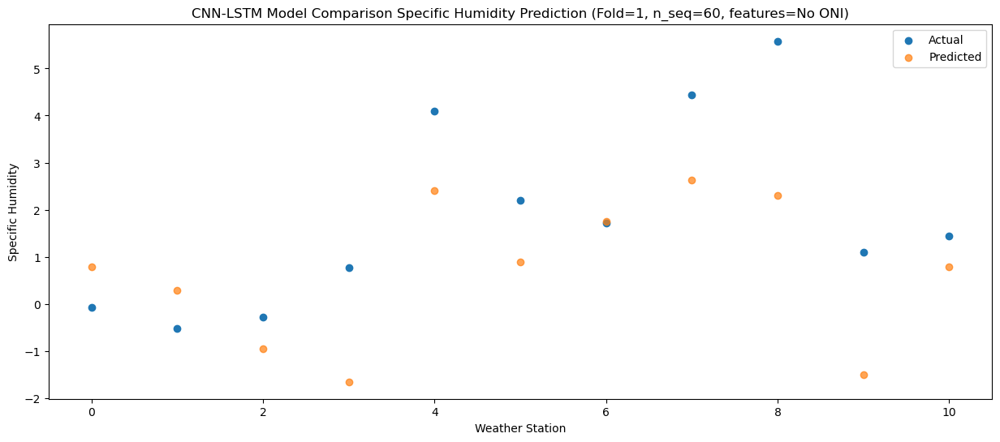

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    0.99   2.528023
1                 1    1.37   2.038030
2                 2    1.71   0.788038
3                 3    3.02   0.087990
4                 4    6.29   4.147991
5                 5    2.84   2.637927
6                 6    3.86   3.488045
7                 7    6.21   4.378015
8                 8    7.90   4.047971
9                 9    1.95   0.237933
10               10    3.05   2.528024


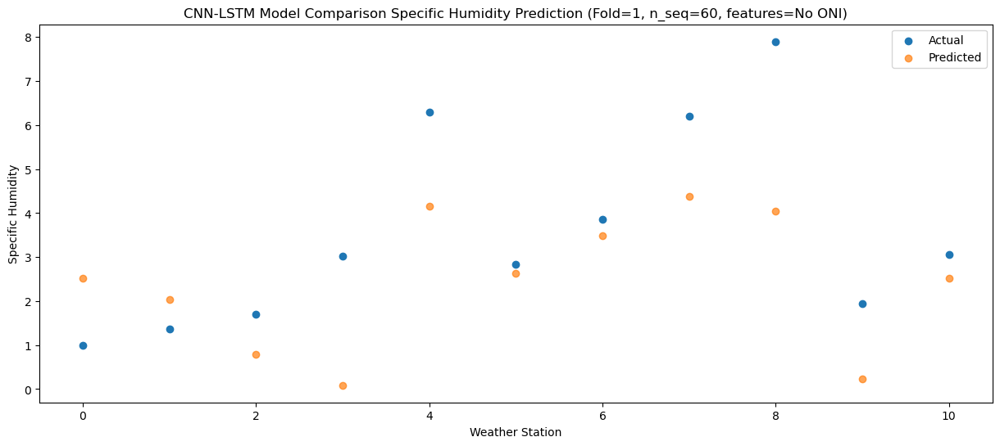

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.19   5.805437
1                 1    5.17   5.315444
2                 2    5.84   4.065453
3                 3    7.37   3.365410
4                 4   10.27   7.425409
5                 5    5.27   5.915347
6                 6    8.00   6.765459
7                 7   10.52   7.655429
8                 8   11.50   7.325389
9                 9    4.68   3.515356
10               10    6.63   5.805434


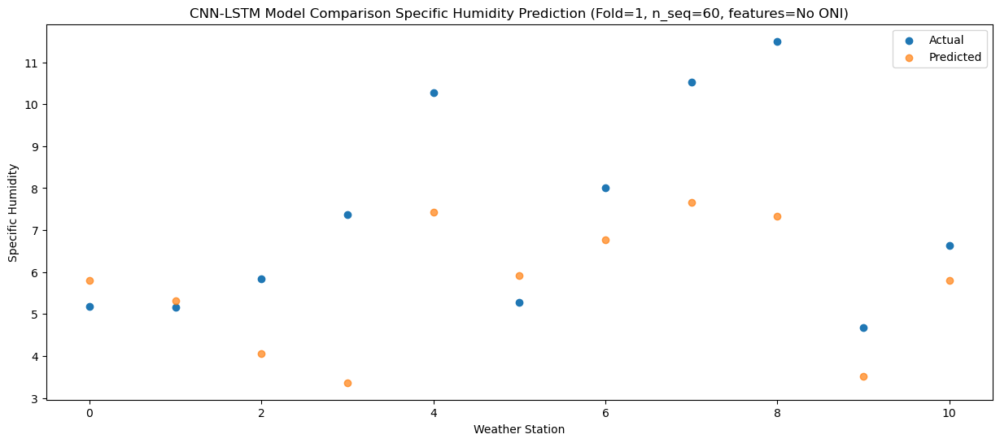

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.26   7.850074
1                 1    6.68   7.360082
2                 2    7.27   6.110090
3                 3    8.76   5.410043
4                 4   11.78   9.470042
5                 5   10.12   7.959976
6                 6    9.96   8.810096
7                 7   12.54   9.700064
8                 8   14.41   9.370024
9                 9   10.35   5.559987
10               10    8.45   7.850071


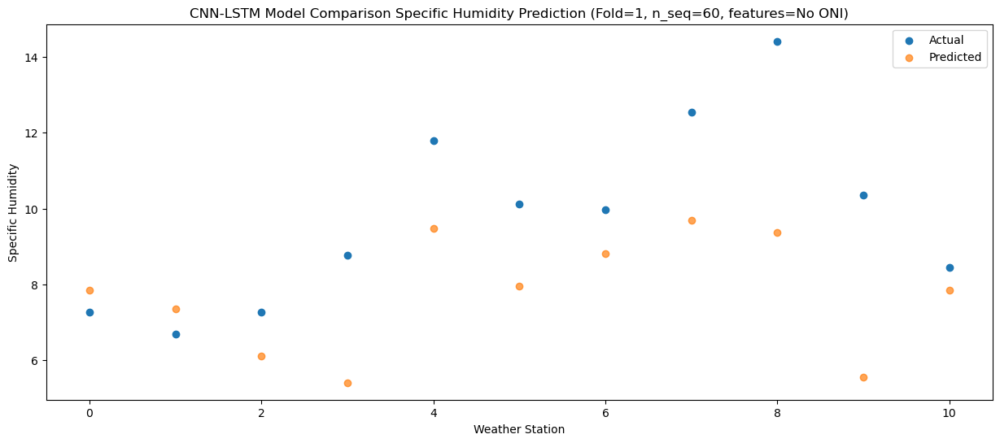

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    9.68   9.008692
1                 1    9.28   8.518699
2                 2   10.44   7.268706
3                 3    8.84   6.568654
4                 4   12.10  10.628653
5                 5    9.97   9.118582
6                 6   12.34   9.968713
7                 7   13.21  10.858682
8                 8   13.02  10.528636
9                 9    8.60   6.718595
10               10   11.82   9.008696


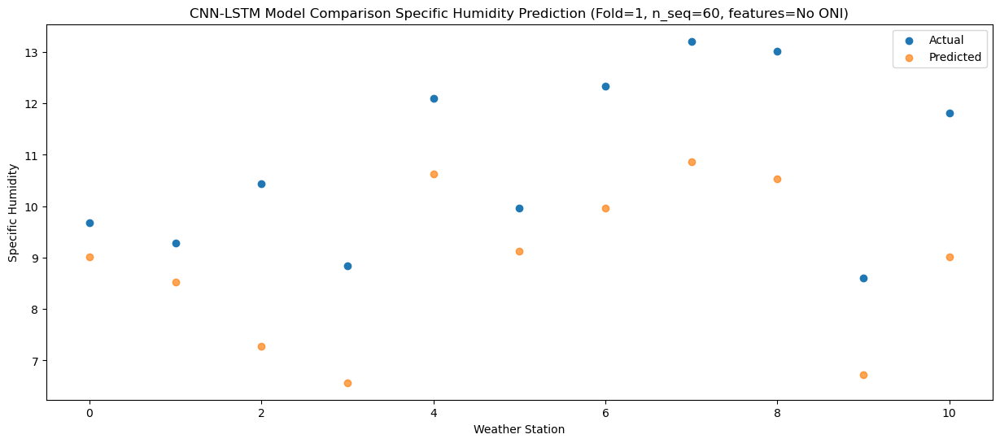

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.04   8.403807
1                 1    7.55   7.913816
2                 2    8.32   6.663823
3                 3    8.93   5.963760
4                 4   12.15  10.023759
5                 5    8.83   8.513673
6                 6   10.62   9.363830
7                 7   11.97  10.253795
8                 8   12.43   9.923737
9                 9    8.79   6.113690
10               10   10.24   8.403811


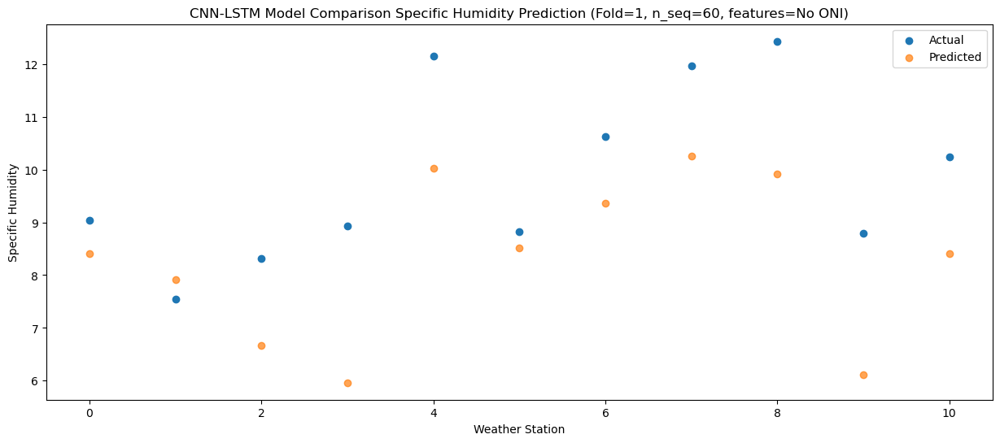

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.05   6.162452
1                 1    6.03   5.672463
2                 2    6.77   4.422469
3                 3    6.01   3.722397
4                 4    9.61   7.782395
5                 5    9.31   6.272300
6                 6    9.33   7.122476
7                 7   10.21   8.012438
8                 8   10.52   7.682371
9                 9    6.35   3.872317
10               10    7.75   6.162458


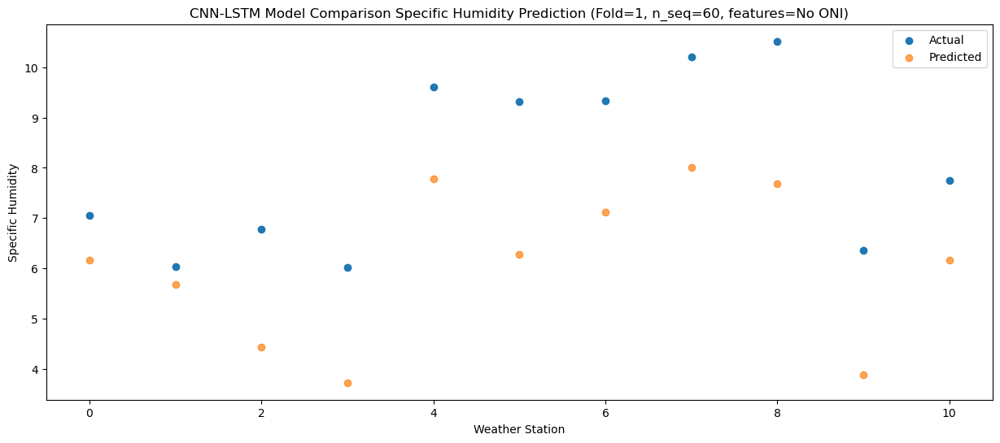

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.10   2.402087
1                 1    2.20   1.912095
2                 2    2.27   0.662102
3                 3    1.96  -0.037963
4                 4    5.28   4.022032
5                 5    5.04   2.511943
6                 6    5.19   3.362108
7                 7    5.17   4.252074
8                 8    7.16   3.922012
9                 9    3.36   0.111959
10               10    3.44   2.402094


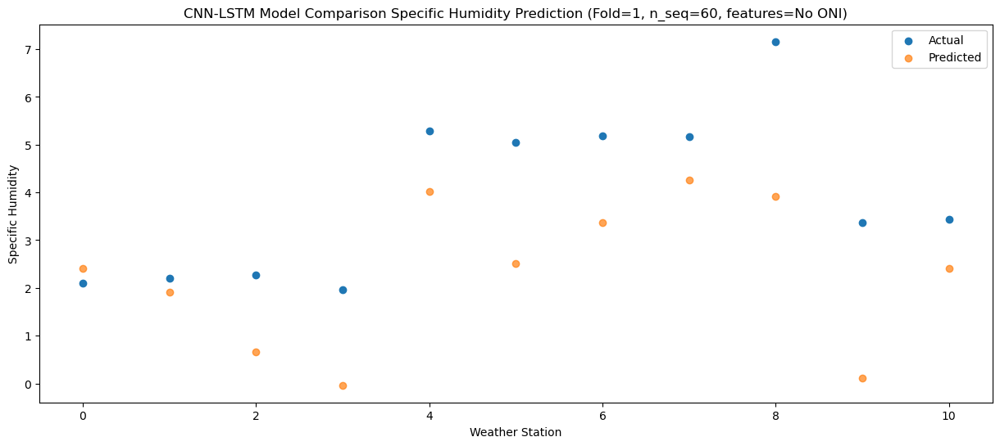

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_1 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_3 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 512)            2099200   
                                                                 
 dropout_4 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_3 (LSTM)               (None, 512)               2099200   
                                                      

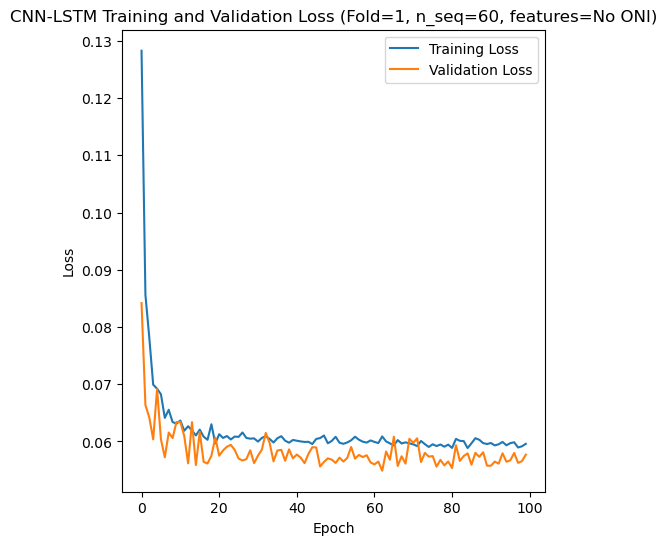

Epoch 1/100
84/84 [==============================] - 19s 76ms/step - loss: 0.1254 - accuracy: 0.2024 - mae: 0.1028 - rmse: 0.1254 - mape: 22.0720 - pearson: 0.5870 - val_loss: 0.0688 - val_accuracy: 0.0000e+00 - val_mae: 0.0549 - val_rmse: 0.0688 - val_mape: 12.6838 - val_pearson: 0.8452
Epoch 2/100
84/84 [==============================] - 3s 36ms/step - loss: 0.0907 - accuracy: 0.3095 - mae: 0.0733 - rmse: 0.0907 - mape: 15.9454 - pearson: 0.7225 - val_loss: 0.0503 - val_accuracy: 0.8000 - val_mae: 0.0395 - val_rmse: 0.0503 - val_mape: 8.9802 - val_pearson: 0.8840
Epoch 3/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0743 - accuracy: 0.4643 - mae: 0.0585 - rmse: 0.0743 - mape: 13.1363 - pearson: 0.7486 - val_loss: 0.0552 - val_accuracy: 0.8000 - val_mae: 0.0430 - val_rmse: 0.0552 - val_mape: 9.6072 - val_pearson: 0.8983
Epoch 4/100
84/84 [==============================] - 3s 33ms/step - loss: 0.0710 - accuracy: 0.4643 - mae: 0.0564 - rmse: 0.0710 - mape: 12.6011 

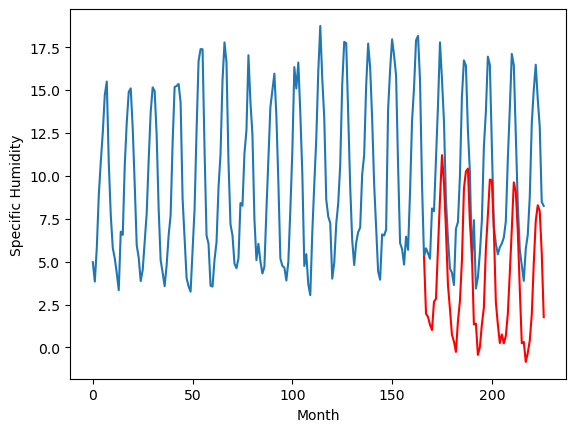

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		-0.76		-1.02
-0.25		-0.95		-0.70
-0.27		-1.41		-1.14
-0.21		-1.71		-1.50
1.58		-0.06		-1.64
1.87		0.11		-1.76
4.77		3.07		-1.70
6.19		5.93		-0.26
11.00		8.48		-2.52
9.57		6.86		-2.71
5.51		4.11		-1.40
1.78		0.91		-0.87
1.56		-0.49		-2.05
-0.17		-1.99		-1.82
-0.22		-2.39		-2.17
-0.90		-2.99		-2.09
0.95		-1.20		-2.15
1.07		-0.02		-1.09
6.19		2.32		-3.87
9.10		6.52		-2.58
10.71		7.53		-3.18
9.09		7.69		-1.40
6.27		4.52		-1.75
2.88		2.74		-0.14
0.45		-1.39		-1.84
-0.61		-1.34		-0.73
-0.94		-3.16		-2.22
-1.03		-2.71		-1.68
-0.15		-1.39		-1.24
1.00		-0.41		-1.41
3.39		3.02		-0.37
7.75		4.98		-2.77
9.09		7.06		-2.03
8.59		7.00		-1.59
6.02		4.14		-1.88
2.34		-0.07		-2.41
0.84		-1.39		-2.23
-0.35		-2.47		-2.12
-0.36		-1.97		-1.61
-0.44		-2.49		-2.05
0.25		-2.06		-2.31
0.87		-0.77		-1.64
6.65		1.61		-5.04
9.30		4.18		-5.12
11.36		6.89		-4.47
9.47		6.35		-3.12
6.88		4.03		-2.85
3.42		0.66		-2.76
0

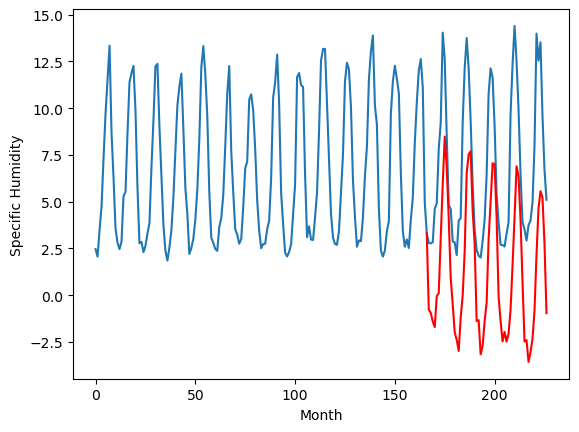

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		2.39		2.27
0.43		2.20		1.77
-1.13		1.74		2.87
-0.25		1.44		1.69
0.92		3.09		2.17
2.40		3.26		0.86
3.51		6.22		2.71
6.85		9.08		2.23
7.87		11.63		3.76
8.57		10.01		1.44
7.87		7.26		-0.61
5.28		4.06		-1.22
2.33		2.66		0.33
-2.34		1.16		3.50
-1.85		0.76		2.61
0.28		0.16		-0.12
0.50		1.95		1.45
1.47		3.13		1.66
2.78		5.47		2.69
6.56		9.67		3.11
6.96		10.68		3.72
7.58		10.84		3.26
6.30		7.67		1.37
3.64		5.89		2.25
-0.31		1.76		2.07
1.09		1.81		0.72
-2.56		-0.01		2.55
-1.37		0.44		1.81
0.44		1.76		1.32
1.80		2.74		0.94
4.90		6.17		1.27
6.83		8.13		1.30
7.66		10.21		2.55
7.55		10.15		2.60
7.40		7.29		-0.11
3.01		3.08		0.07
2.90		1.76		-1.14
-0.76		0.68		1.44
-1.14		1.18		2.32
0.71		0.66		-0.05
1.10		1.09		-0.01
2.61		2.38		-0.23
3.42		4.76		1.34
6.58		7.33		0.75
7.55		10.04		2.49
8.27		9.50		1.23
5.88		7.18		1.30
2.96		3.81		0.85
0.46		0.67		0.21
-0.11		0.75		0.86
-1.18		-0.42		0.76
-1.60		0.1

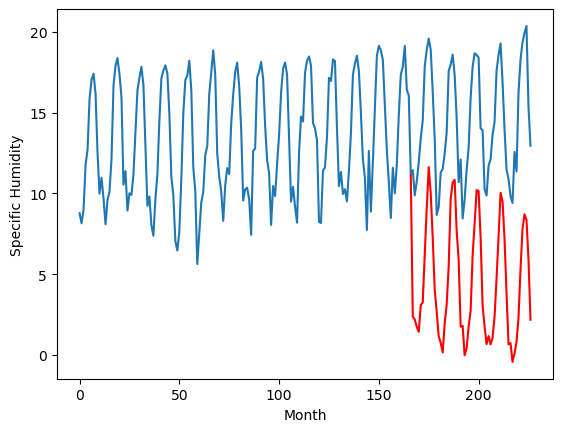

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		2.41		1.64
0.21		2.22		2.01
0.03		1.76		1.73
0.05		1.46		1.41
0.57		3.11		2.54
0.95		3.28		2.33
3.20		6.24		3.04
7.21		9.10		1.89
10.59		11.65		1.06
9.76		10.03		0.27
6.67		7.28		0.61
4.16		4.08		-0.08
2.29		2.68		0.39
0.37		1.18		0.81
-0.71		0.78		1.49
-0.54		0.18		0.72
0.10		1.97		1.87
1.45		3.15		1.70
3.13		5.50		2.37
7.73		9.69		1.96
10.33		10.70		0.37
11.07		10.86		-0.21
8.41		7.69		-0.72
5.45		5.91		0.46
1.00		1.78		0.78
0.64		1.83		1.19
-0.69		0.01		0.70
-0.12		0.46		0.58
0.64		1.78		1.14
1.34		2.76		1.42
4.64		6.19		1.55
6.90		8.15		1.25
10.26		10.23		-0.03
10.94		10.17		-0.77
7.14		7.31		0.17
4.27		3.10		-1.17
2.45		1.78		-0.67
0.36		0.70		0.34
0.87		1.20		0.33
0.11		0.68		0.57
0.36		1.11		0.75
2.44		2.40		-0.04
3.25		4.79		1.54
7.15		7.35		0.20
11.41		10.06		-1.35
9.07		9.52		0.45
8.06		7.20		-0.86
4.70		3.83		-0.87
0.87		0.69		-0.18
1.16		0.77		-0.39
-0.17		-0.40		-0.23
-0.22

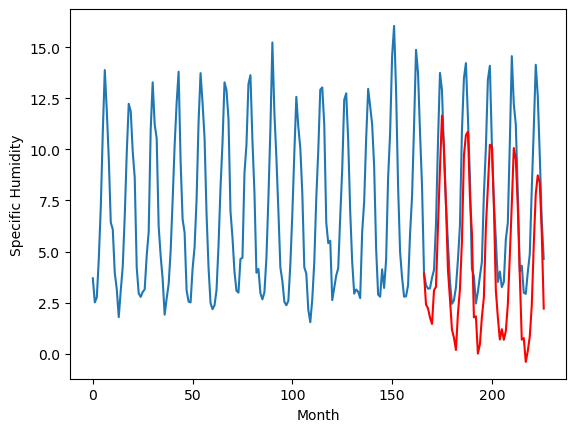

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		2.32		3.11
0.01		2.13		2.12
0.04		1.67		1.63
0.36		1.37		1.01
3.85		3.02		-0.83
2.89		3.19		0.30
5.01		6.15		1.14
8.35		9.01		0.66
10.48		11.56		1.08
9.75		9.94		0.19
7.95		7.19		-0.76
4.74		3.99		-0.75
2.01		2.59		0.58
-1.27		1.09		2.36
-1.14		0.69		1.83
-1.16		0.09		1.25
2.13		1.88		-0.25
2.15		3.06		0.91
5.35		5.40		0.05
9.24		9.60		0.36
10.27		10.61		0.34
9.87		10.77		0.90
7.73		7.60		-0.13
5.20		5.82		0.62
-0.46		1.69		2.15
2.82		1.74		-1.08
-2.09		-0.08		2.01
-0.63		0.37		1.00
0.22		1.69		1.47
2.65		2.67		0.02
6.68		6.10		-0.58
8.98		8.06		-0.92
10.27		10.14		-0.13
10.67		10.08		-0.59
7.16		7.22		0.06
1.98		3.01		1.03
1.54		1.69		0.15
0.99		0.61		-0.38
0.90		1.11		0.21
2.20		0.59		-1.61
3.08		1.02		-2.06
3.63		2.31		-1.32
6.69		4.70		-1.99
10.00		7.26		-2.74
11.34		9.97		-1.37
11.37		9.43		-1.94
9.02		7.11		-1.91
3.79		3.74		-0.05
1.27		0.60		-0.67
-0.32		0.68		1.00
-1.19		-0.49	

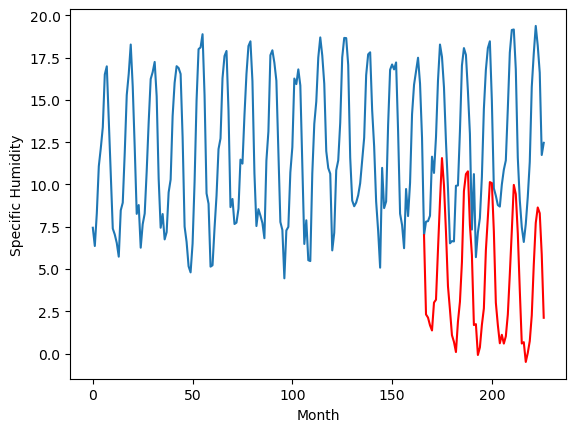

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		-0.19		1.02
-2.40		-0.38		2.02
-1.57		-0.84		0.73
-2.24		-1.14		1.10
2.37		0.51		-1.86
1.85		0.68		-1.17
3.93		3.64		-0.29
6.05		6.50		0.45
8.63		9.05		0.42
7.19		7.43		0.24
5.74		4.68		-1.06
1.87		1.48		-0.39
-0.19		0.08		0.27
-2.51		-1.42		1.09
-2.64		-1.82		0.82
-2.69		-2.42		0.27
0.30		-0.63		-0.93
1.87		0.55		-1.32
6.70		2.89		-3.81
9.34		7.09		-2.25
8.30		8.10		-0.20
8.43		8.26		-0.17
4.87		5.09		0.22
3.28		3.31		0.03
-0.91		-0.82		0.09
1.96		-0.77		-2.73
-3.67		-2.59		1.08
-3.45		-2.14		1.31
-1.83		-0.82		1.01
2.13		0.16		-1.97
5.78		3.59		-2.19
6.81		5.55		-1.26
7.91		7.63		-0.28
8.37		7.57		-0.80
5.01		4.71		-0.30
0.19		0.50		0.31
0.05		-0.82		-0.87
-0.86		-1.90		-1.04
-1.24		-1.40		-0.16
-0.79		-1.92		-1.13
0.99		-1.49		-2.48
1.54		-0.20		-1.74
5.24		2.18		-3.06
8.70		4.75		-3.95
8.41		7.46		-0.95
6.98		6.92		-0.06
6.43		4.60		-1.83
2.90		1.23		-1.67
-0.27		-1.91		-1.64
-2.20

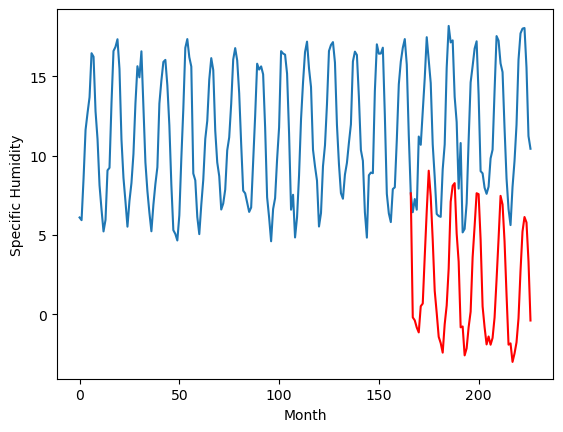

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		6.13		0.56
4.47		5.94		1.47
5.15		5.48		0.33
4.59		5.18		0.59
8.81		6.83		-1.98
8.39		7.00		-1.39
11.33		9.96		-1.37
13.61		12.82		-0.79
16.52		15.37		-1.15
13.82		13.75		-0.07
12.88		11.00		-1.88
8.39		7.80		-0.59
6.80		6.40		-0.40
4.09		4.90		0.81
3.99		4.50		0.51
3.66		3.90		0.24
6.52		5.69		-0.83
7.84		6.87		-0.97
12.04		9.21		-2.83
15.79		13.41		-2.38
16.61		14.42		-2.19
16.99		14.58		-2.41
12.54		11.41		-1.13
9.93		9.63		-0.30
5.94		5.50		-0.44
8.44		5.55		-2.89
3.15		3.73		0.58
3.62		4.18		0.56
5.25		5.50		0.25
9.15		6.48		-2.67
13.24		9.91		-3.33
14.04		11.87		-2.17
13.36		13.95		0.59
14.42		13.89		-0.53
11.75		11.03		-0.72
6.97		6.82		-0.15
6.52		5.50		-1.02
5.35		4.42		-0.93
4.57		4.92		0.35
4.97		4.40		-0.57
6.88		4.83		-2.05
7.55		6.12		-1.43
11.44		8.50		-2.94
15.34		11.07		-4.27
14.63		13.78		-0.85
12.58		13.24		0.66
11.95		10.92		-1.03
8.80		7.55		-1.25
6.18		4.41		-1.77


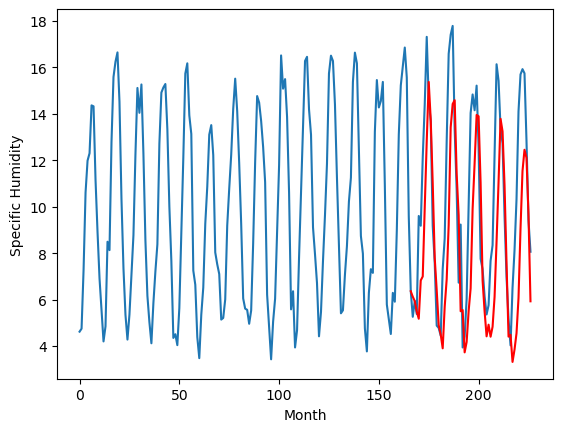

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		1.04		-1.58
2.17		0.85		-1.32
1.22		0.39		-0.83
1.75		0.09		-1.66
3.21		1.74		-1.47
1.81		1.91		0.10
2.05		4.87		2.82
3.73		7.73		4.00
7.17		10.28		3.11
5.44		8.66		3.22
4.79		5.91		1.12
1.72		2.71		0.99
1.77		1.31		-0.46
0.51		-0.19		-0.70
0.79		-0.59		-1.38
0.66		-1.19		-1.85
0.75		0.60		-0.15
1.05		1.78		0.73
1.17		4.12		2.95
3.83		8.32		4.49
9.07		9.33		0.26
9.36		9.49		0.13
6.60		6.32		-0.28
2.89		4.54		1.65
1.24		0.41		-0.83
1.37		0.46		-0.91
1.09		-1.36		-2.45
0.10		-0.91		-1.01
0.50		0.41		-0.09
0.51		1.39		0.88
0.44		4.82		4.38
5.94		6.78		0.84
8.50		8.86		0.36
10.47		8.80		-1.67
7.43		5.94		-1.49
5.35		1.73		-3.62
1.38		0.41		-0.97
2.20		-0.67		-2.87
1.31		-0.17		-1.48
1.19		-0.69		-1.88
1.53		-0.26		-1.79
0.69		1.02		0.33
2.69		3.41		0.72
2.49		5.98		3.49
5.84		8.69		2.85
8.03		8.15		0.12
6.22		5.83		-0.39
3.77		2.46		-1.31
2.85		-0.68		-3.53
1.33		-0.61		-1.94
1.75		-1.77		-

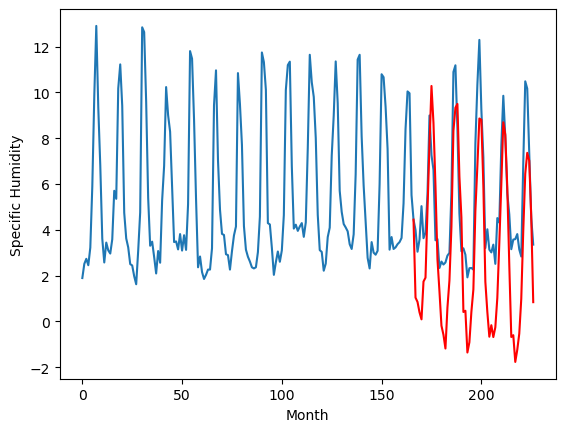

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		4.79		-2.99
7.60		4.60		-3.00
7.39		4.14		-3.25
6.67		3.84		-2.83
8.31		5.49		-2.82
9.72		5.66		-4.06
10.48		8.62		-1.86
10.46		11.48		1.02
11.23		14.03		2.80
12.31		12.41		0.10
10.53		9.66		-0.87
9.40		6.46		-2.94
7.16		5.06		-2.10
5.59		3.56		-2.03
6.44		3.16		-3.28
6.97		2.56		-4.41
7.08		4.35		-2.73
8.40		5.53		-2.87
9.88		7.87		-2.01
11.13		12.07		0.94
12.28		13.08		0.80
11.68		13.24		1.56
11.22		10.07		-1.15
8.42		8.29		-0.13
7.88		4.16		-3.72
7.70		4.21		-3.49
6.34		2.39		-3.95
5.60		2.84		-2.76
7.34		4.16		-3.18
8.18		5.14		-3.04
9.44		8.57		-0.87
11.21		10.53		-0.68
12.10		12.61		0.51
12.20		12.55		0.35
13.05		9.69		-3.36
11.28		5.48		-5.80
6.64		4.16		-2.48
7.49		3.08		-4.41
7.58		3.58		-4.00
6.17		3.06		-3.11
8.09		3.49		-4.60
8.79		4.77		-4.02
10.19		7.16		-3.03
10.57		9.73		-0.84
11.91		12.44		0.53
12.52		11.90		-0.62
12.27		9.58		-2.69
9.97		6.21		-3.76
6.94		3.07		-3.87
7

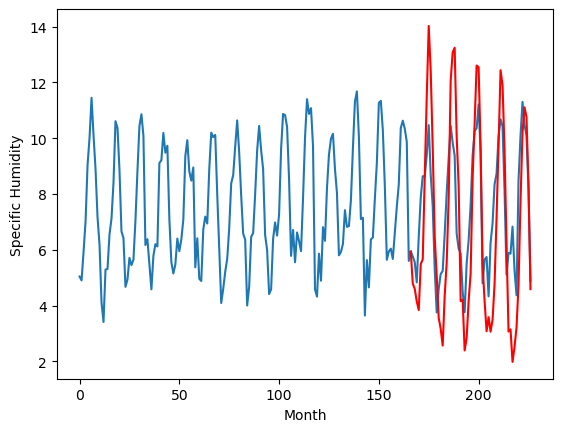

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		3.45		2.56
1.00		3.26		2.26
0.98		2.80		1.82
1.37		2.50		1.13
3.00		4.15		1.15
2.91		4.32		1.41
6.24		7.28		1.04
9.75		10.14		0.39
12.60		12.69		0.09
12.59		11.07		-1.52
8.87		8.32		-0.55
6.25		5.12		-1.13
3.60		3.72		0.12
0.38		2.22		1.84
0.26		1.82		1.56
0.33		1.22		0.89
2.06		3.01		0.95
2.59		4.19		1.60
5.30		6.54		1.24
9.80		10.73		0.93
11.32		11.74		0.42
11.90		11.90		0.00
8.30		8.73		0.43
6.14		6.95		0.81
0.58		2.82		2.24
2.43		2.87		0.44
-0.35		1.05		1.40
0.96		1.50		0.54
1.92		2.82		0.90
2.96		3.80		0.84
7.28		7.23		-0.05
9.08		9.19		0.11
12.66		11.27		-1.39
11.09		11.21		0.12
7.66		8.35		0.69
3.30		4.14		0.84
2.83		2.82		-0.01
0.59		1.74		1.15
1.45		2.24		0.79
2.21		1.72		-0.49
1.90		2.15		0.25
4.03		3.44		-0.59
5.56		5.83		0.27
8.42		8.39		-0.03
12.26		11.10		-1.16
11.77		10.56		-1.21
8.63		8.24		-0.39
4.44		4.87		0.43
1.33		1.73		0.40
1.24		1.81		0.57
0.55		0.64		0.09
0.69		

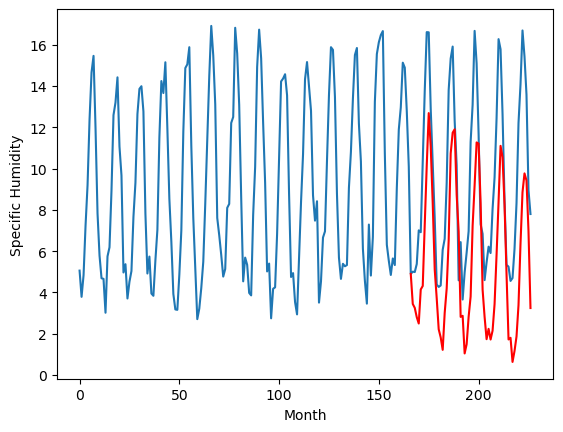

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		1.97		1.89
0.53		1.78		1.25
0.33		1.32		0.99
0.44		1.02		0.58
2.29		2.67		0.38
1.72		2.84		1.12
4.51		5.80		1.29
7.95		8.66		0.71
10.65		11.21		0.56
10.41		9.59		-0.82
7.80		6.84		-0.96
4.61		3.64		-0.97
1.49		2.24		0.75
-0.30		0.74		1.04
-0.29		0.34		0.63
-0.05		-0.26		-0.21
0.98		1.53		0.55
1.59		2.71		1.12
4.26		5.06		0.80
8.36		9.25		0.89
9.77		10.26		0.49
10.16		10.42		0.26
6.95		7.25		0.30
5.22		5.47		0.25
-0.14		1.34		1.48
1.42		1.39		-0.03
-1.00		-0.43		0.57
-0.10		0.02		0.12
0.52		1.34		0.82
1.79		2.32		0.53
5.95		5.75		-0.20
7.91		7.71		-0.20
11.12		9.79		-1.33
10.13		9.73		-0.40
6.65		6.87		0.22
1.99		2.66		0.67
1.37		1.34		-0.03
0.28		0.26		-0.02
0.55		0.76		0.21
0.95		0.24		-0.71
0.55		0.67		0.12
2.19		1.96		-0.23
4.78		4.35		-0.43
6.62		6.91		0.29
9.93		9.62		-0.31
10.04		9.08		-0.96
7.62		6.76		-0.86
3.51		3.39		-0.12
0.56		0.25		-0.31
0.35		0.33		-0.02
-0.27		-0.84		-0.

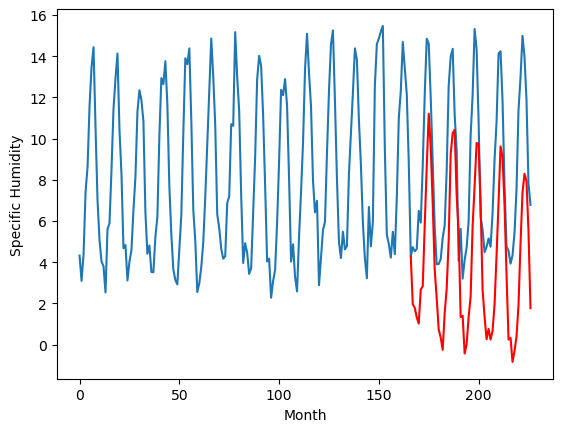

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[1.9652782630920411, -0.7647303199768067, 2.385275402069092, 2.405277309417724, 2.3152777862548826, -0.19472698211669925, 6.1252739715576165, 1.035266819000244, 4.785260620117188, 3.4452796936035153, 1.9652796936035157]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   1.965278
1                 1    0.26  -0.764730
2                 2    0.12   2.385275
3                 3    0.77   2.405277
4                 4   -0.79   2.315278
5                 5   -1.21  -0.194727
6                 6    5.57   6.125274
7                 7    2.62   1.035267
8                 8    7.78   4.785261
9                 9    0.89   3.445280
10               10    0.08   1.965280


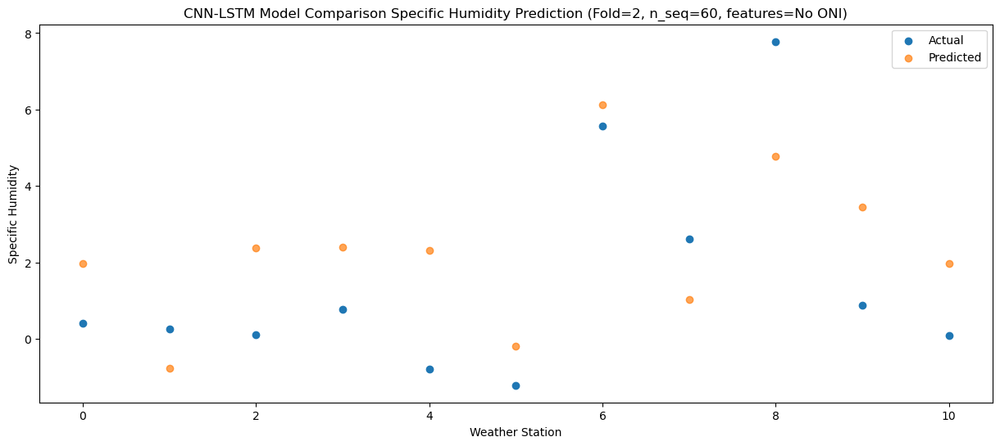

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91   1.777109
1                 1   -0.25  -0.952907
2                 2    0.43   2.197104
3                 3    0.21   2.217108
4                 4    0.01   2.127107
5                 5   -2.40  -0.382900
6                 6    4.47   5.937102
7                 7    2.17   0.847088
8                 8    7.60   4.597074
9                 9    1.00   3.257114
10               10    0.53   1.777113


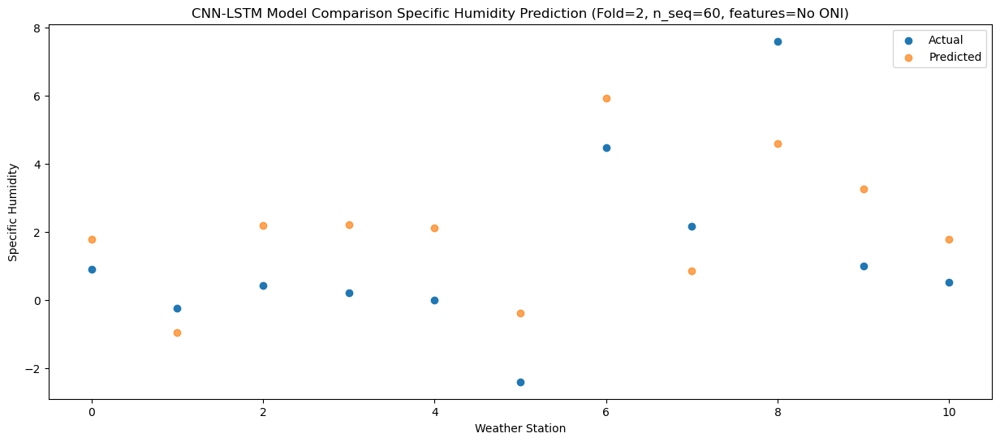

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   1.324475
1                 1   -0.27  -1.405550
2                 2   -1.13   1.744465
3                 3    0.03   1.764473
4                 4    0.04   1.674472
5                 5   -1.57  -0.835539
6                 6    5.15   5.484462
7                 7    1.22   0.394441
8                 8    7.39   4.144418
9                 9    0.98   2.804481
10               10    0.33   1.324480


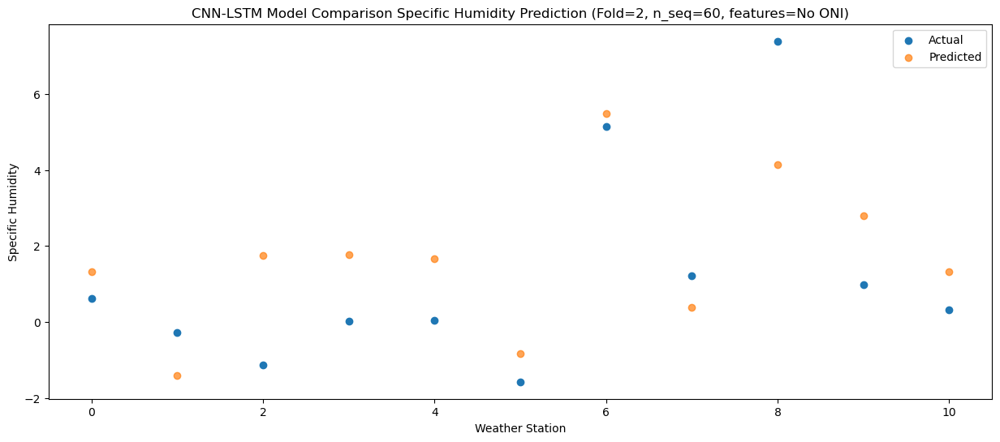

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   1.017417
1                 1   -0.21  -1.712628
2                 2   -0.25   1.437399
3                 3    0.05   1.457414
4                 4    0.36   1.367411
5                 5   -2.24  -1.142610
6                 6    4.59   5.177393
7                 7    1.75   0.087356
8                 8    6.67   3.837320
9                 9    1.37   2.497424
10               10    0.44   1.017422


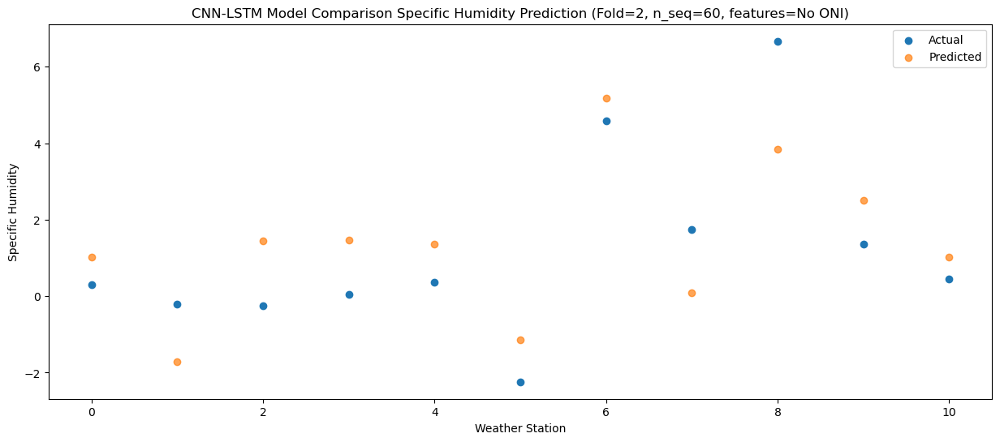

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   2.666536
1                 1    1.58  -0.063515
2                 2    0.92   3.086517
3                 3    0.57   3.106532
4                 4    3.85   3.016531
5                 5    2.37   0.506507
6                 6    8.81   6.826510
7                 7    3.21   1.736466
8                 8    8.31   5.486425
9                 9    3.00   4.146546
10               10    2.29   2.666544


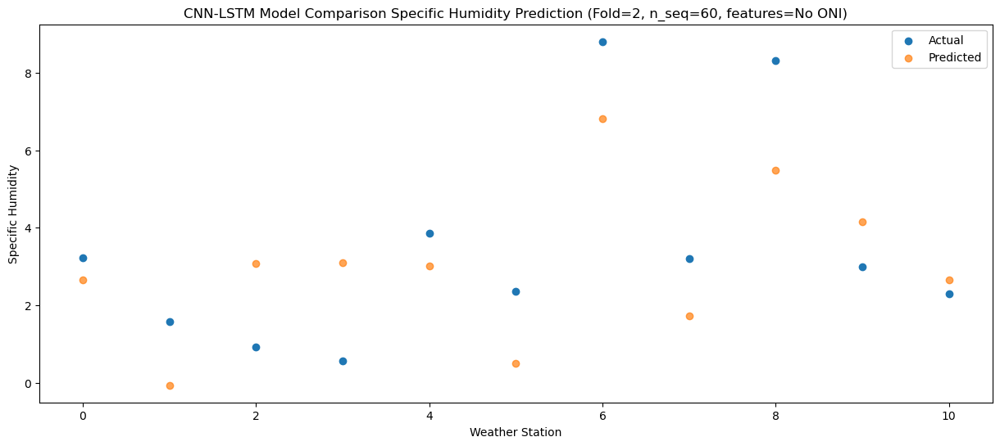

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.836014
1                 1    1.87   0.105954
2                 2    2.40   3.255990
3                 3    0.95   3.276009
4                 4    2.89   3.186006
5                 5    1.85   0.675979
6                 6    8.39   6.995984
7                 7    1.81   1.905933
8                 8    9.72   5.655887
9                 9    2.91   4.316023
10               10    1.72   2.836021


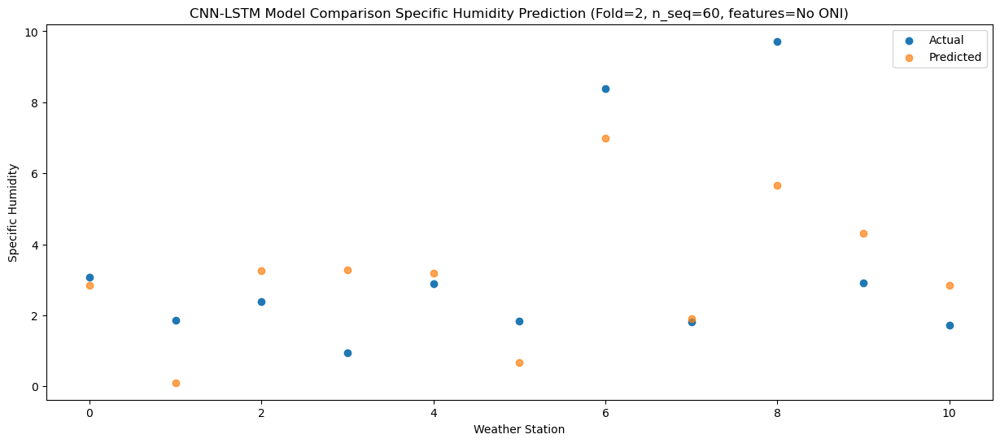

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   5.802984
1                 1    4.77   3.072938
2                 2    3.51   6.222968
3                 3    3.20   6.242981
4                 4    5.01   6.152978
5                 5    3.93   3.642958
6                 6   11.33   9.962961
7                 7    2.05   4.872922
8                 8   10.48   8.622884
9                 9    6.24   7.282991
10               10    4.51   5.802989


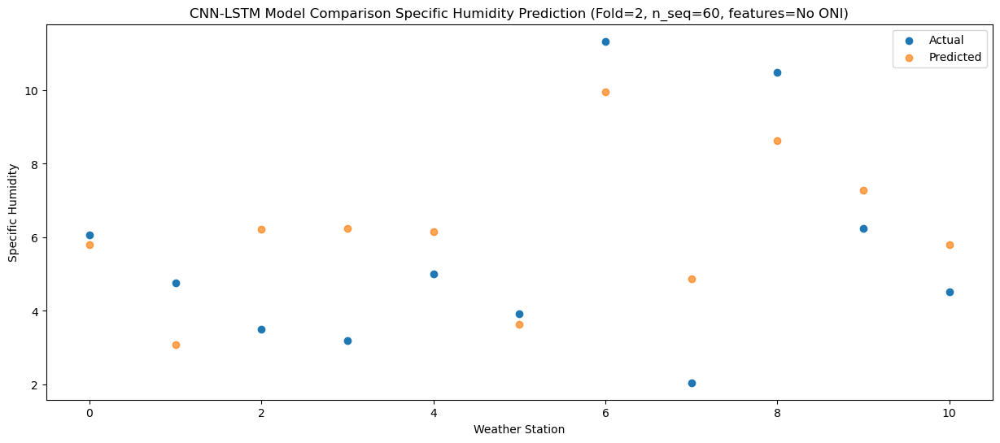

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21   8.656687
1                 1    6.19   5.926625
2                 2    6.85   9.076662
3                 3    7.21   9.096681
4                 4    8.35   9.006678
5                 5    6.05   6.496653
6                 6   13.61  12.816656
7                 7    3.73   7.726608
8                 8   10.46  11.476557
9                 9    9.75  10.136694
10               10    7.95   8.656692


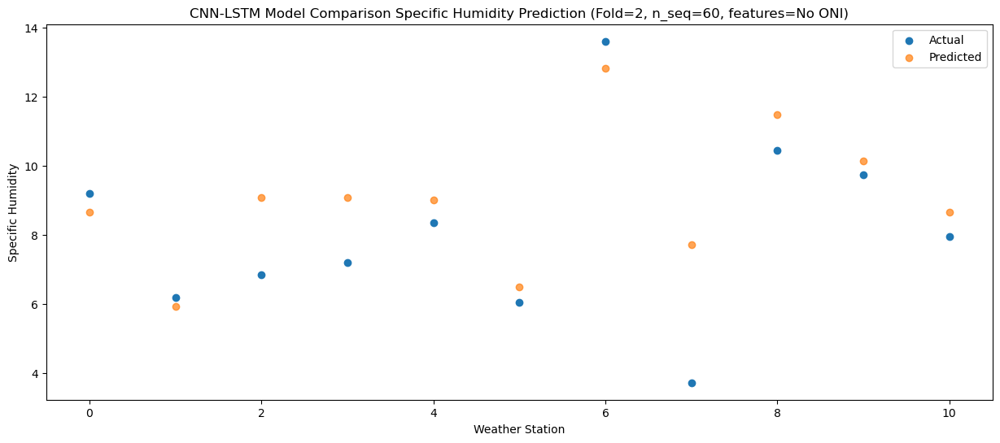

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  11.207769
1                 1   11.00   8.477694
2                 2    7.87  11.627738
3                 3   10.59  11.647763
4                 4   10.48  11.557759
5                 5    8.63   9.047728
6                 6   16.52  15.367730
7                 7    7.17  10.277675
8                 8   11.23  14.027616
9                 9   12.60  12.687778
10               10   10.65  11.207774


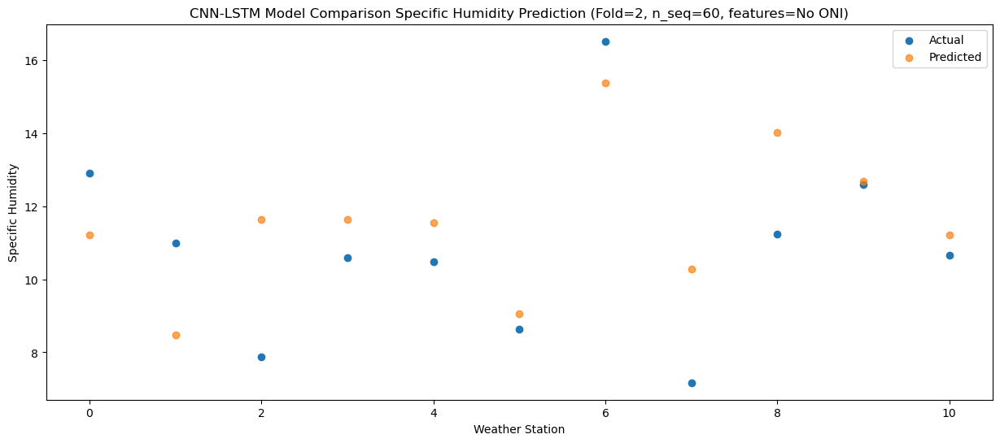

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75   9.592720
1                 1    9.57   6.862644
2                 2    8.57  10.012689
3                 3    9.76  10.032713
4                 4    9.75   9.942711
5                 5    7.19   7.432679
6                 6   13.82  13.752682
7                 7    5.44   8.662623
8                 8   12.31  12.412564
9                 9   12.59  11.072729
10               10   10.41   9.592726


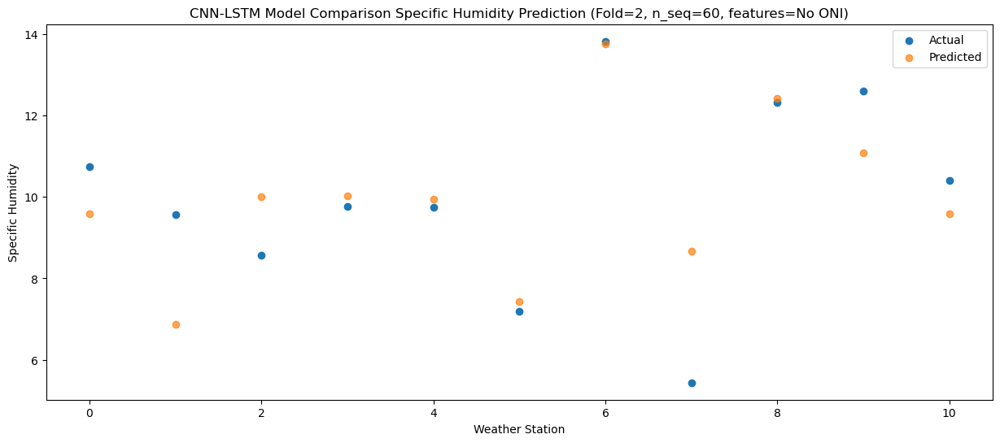

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   6.843075
1                 1    5.51   4.113017
2                 2    7.87   7.263052
3                 3    6.67   7.283070
4                 4    7.95   7.193069
5                 5    5.74   4.683045
6                 6   12.88  11.003047
7                 7    4.79   5.913004
8                 8   10.53   9.662958
9                 9    8.87   8.323080
10               10    7.80   6.843077


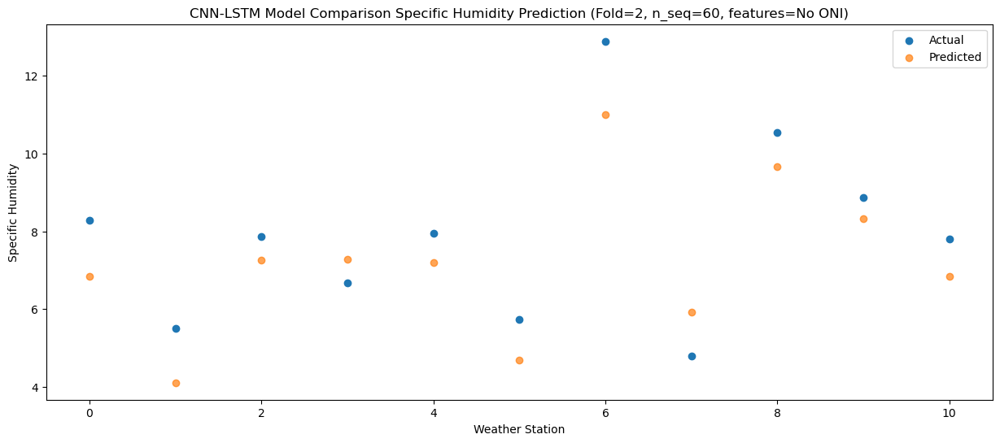

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   3.637558
1                 1    1.78   0.907505
2                 2    5.28   4.057537
3                 3    4.16   4.077553
4                 4    4.74   3.987554
5                 5    1.87   1.477530
6                 6    8.39   7.797533
7                 7    1.72   2.707492
8                 8    9.40   6.457449
9                 9    6.25   5.117562
10               10    4.61   3.637559


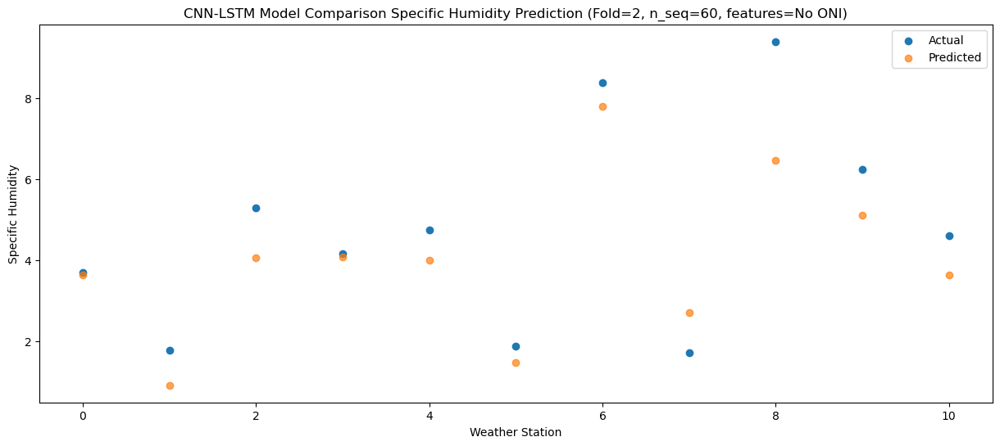

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45   2.240119
1                 1    1.56  -0.489947
2                 2    2.33   2.660093
3                 3    2.29   2.680114
4                 4    2.01   2.590113
5                 5   -0.19   0.080085
6                 6    6.80   6.400087
7                 7    1.77   1.310037
8                 8    7.16   5.059985
9                 9    3.60   3.720125
10               10    1.49   2.240123


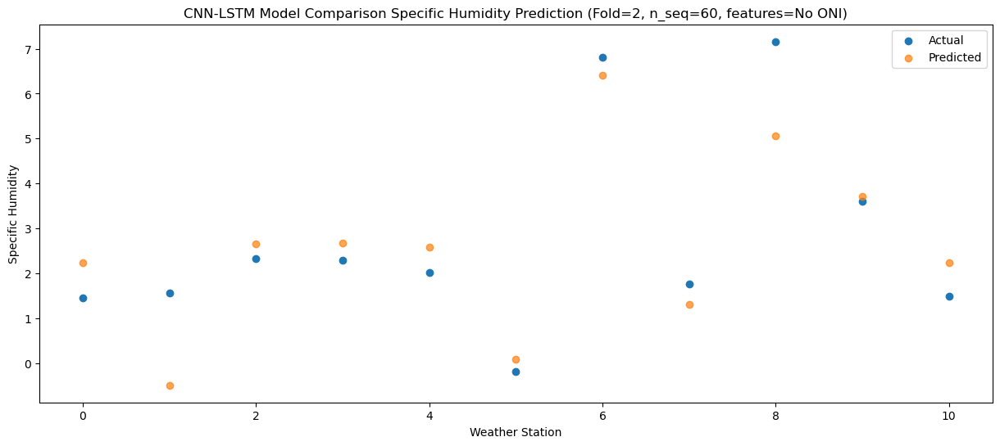

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28   0.738878
1                 1   -0.17  -1.991194
2                 2   -2.34   1.158848
3                 3    0.37   1.178872
4                 4   -1.27   1.088870
5                 5   -2.51  -1.421161
6                 6    4.09   4.898841
7                 7    0.51  -0.191215
8                 8    5.59   3.558728
9                 9    0.38   2.218885
10               10   -0.30   0.738883


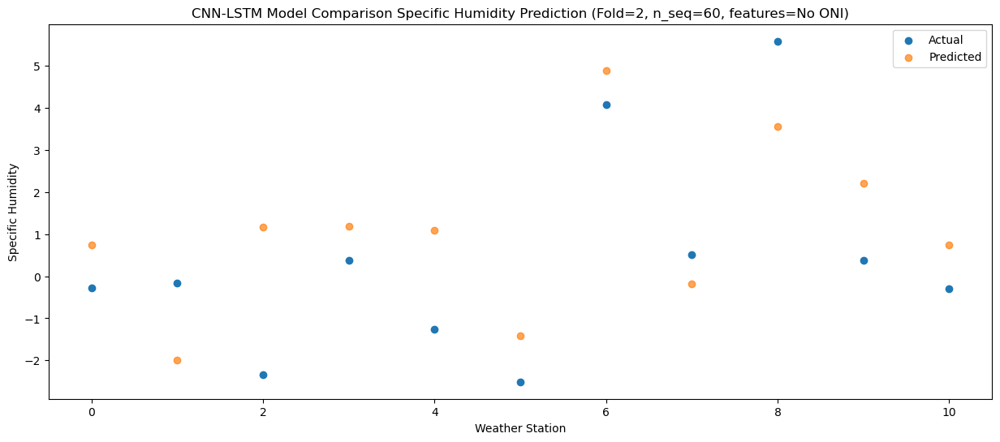

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51   0.344058
1                 1   -0.22  -2.386030
2                 2   -1.85   0.764019
3                 3   -0.71   0.784049
4                 4   -1.14   0.694045
5                 5   -2.64  -1.815994
6                 6    3.99   4.504010
7                 7    0.79  -0.586057
8                 8    6.44   3.163877
9                 9    0.26   1.824065
10               10   -0.29   0.344063


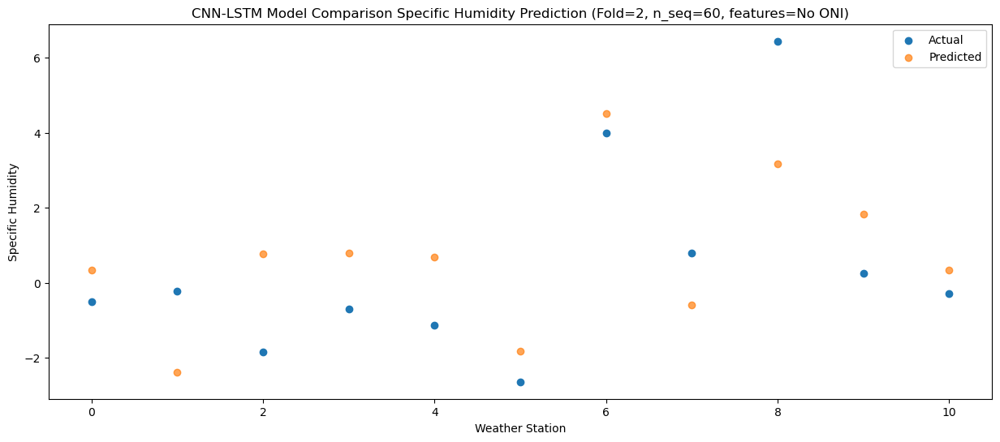

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -0.256938
1                 1   -0.90  -2.987023
2                 2    0.28   0.163027
3                 3   -0.54   0.183055
4                 4   -1.16   0.093051
5                 5   -2.69  -2.416986
6                 6    3.66   3.903018
7                 7    0.66  -1.187049
8                 8    6.97   2.562887
9                 9    0.33   1.223070
10               10   -0.05  -0.256932


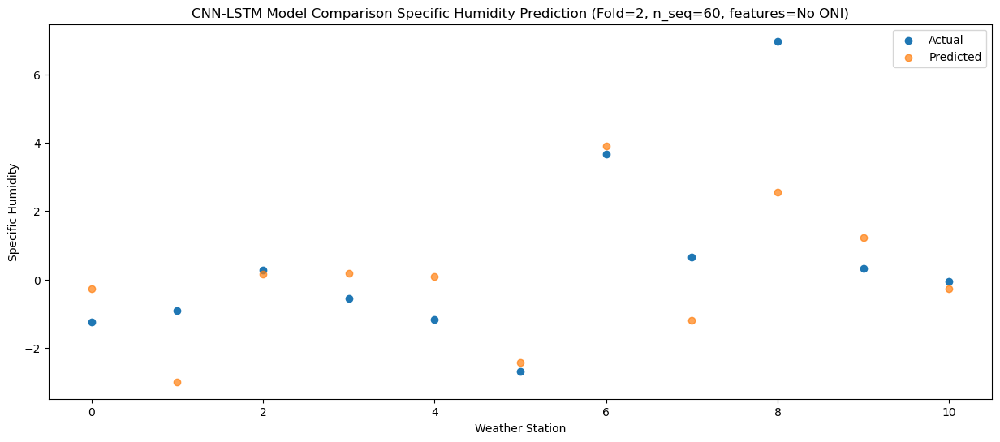

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   1.531309
1                 1    0.95  -1.198789
2                 2    0.50   1.951269
3                 3    0.10   1.971301
4                 4    2.13   1.881295
5                 5    0.30  -0.628748
6                 6    6.52   5.691259
7                 7    0.75   0.601181
8                 8    7.08   4.351112
9                 9    2.06   3.011317
10               10    0.98   1.531316


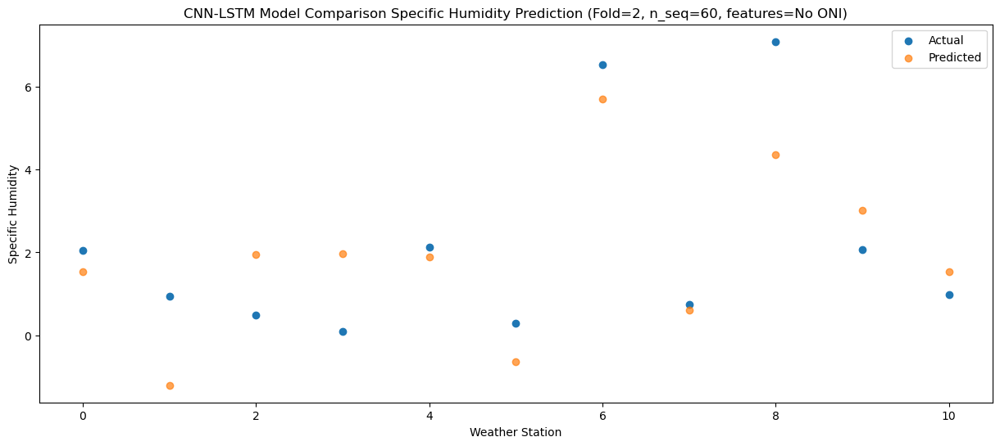

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   2.712218
1                 1    1.07  -0.017896
2                 2    1.47   3.132171
3                 3    1.45   3.152210
4                 4    2.15   3.062203
5                 5    1.87   0.552152
6                 6    7.84   6.872160
7                 7    1.05   1.782069
8                 8    8.40   5.531988
9                 9    2.59   4.192230
10               10    1.59   2.712230


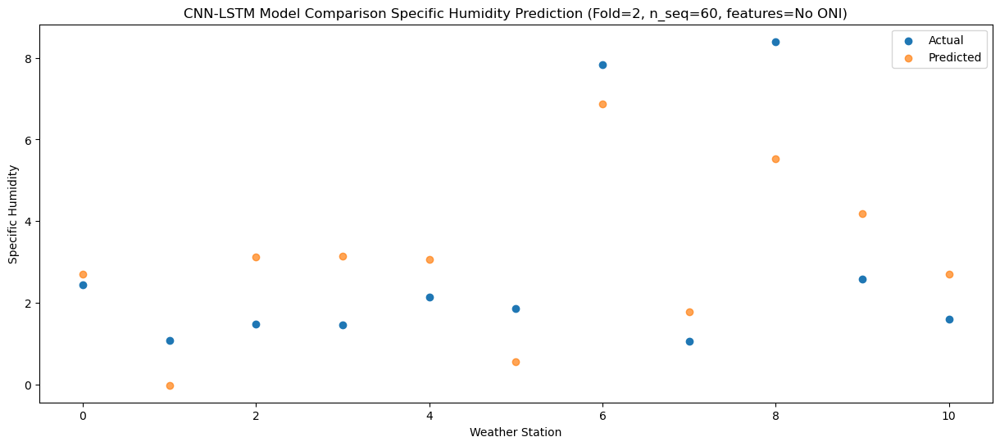

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   5.055018
1                 1    6.19   2.324897
2                 2    2.78   5.474964
3                 3    3.13   5.495009
4                 4    5.35   5.404998
5                 5    6.70   2.894945
6                 6   12.04   9.214954
7                 7    1.17   4.124862
8                 8    9.88   7.874781
9                 9    5.30   6.535025
10               10    4.26   5.055025


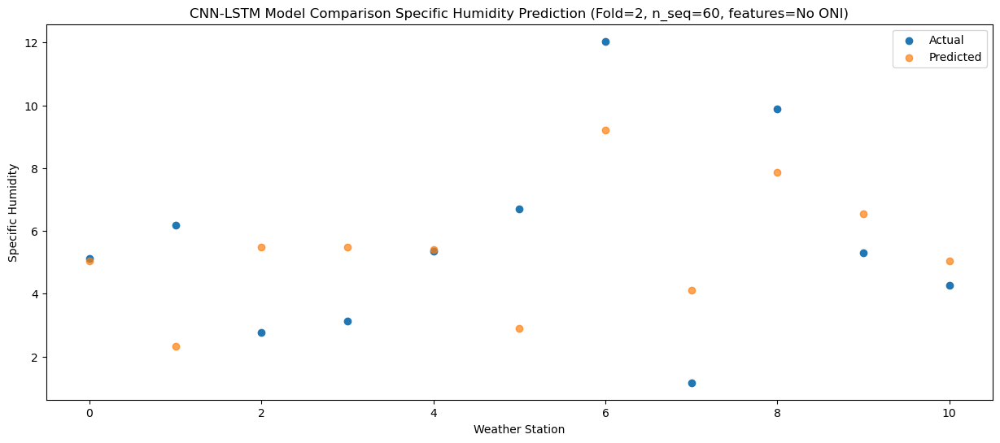

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76   9.252581
1                 1    9.10   6.522454
2                 2    6.56   9.672525
3                 3    7.73   9.692572
4                 4    9.24   9.602562
5                 5    9.34   7.092506
6                 6   15.79  13.412517
7                 7    3.83   8.322418
8                 8   11.13  12.072338
9                 9    9.80  10.732592
10               10    8.36   9.252591


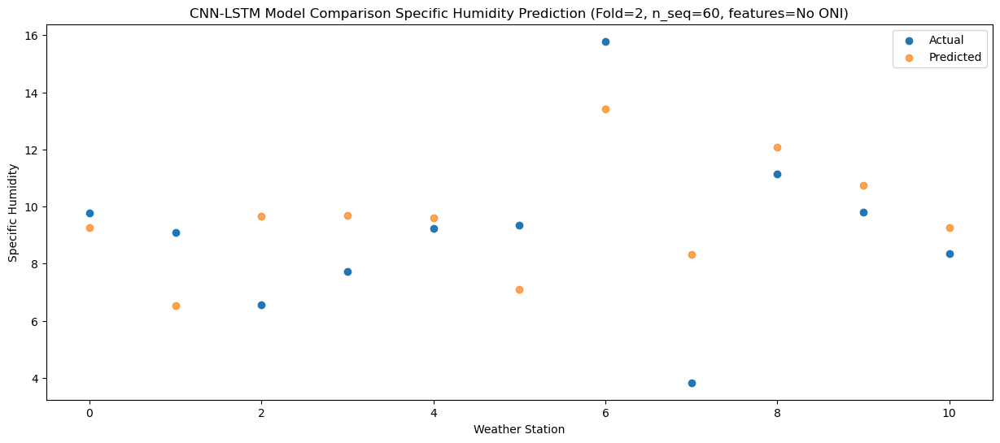

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86  10.259220
1                 1   10.71   7.529074
2                 2    6.96  10.679156
3                 3   10.33  10.699211
4                 4   10.27  10.609199
5                 5    8.30   8.099134
6                 6   16.61  14.419144
7                 7    9.07   9.329030
8                 8   12.28  13.078938
9                 9   11.32  11.739233
10               10    9.77  10.259233


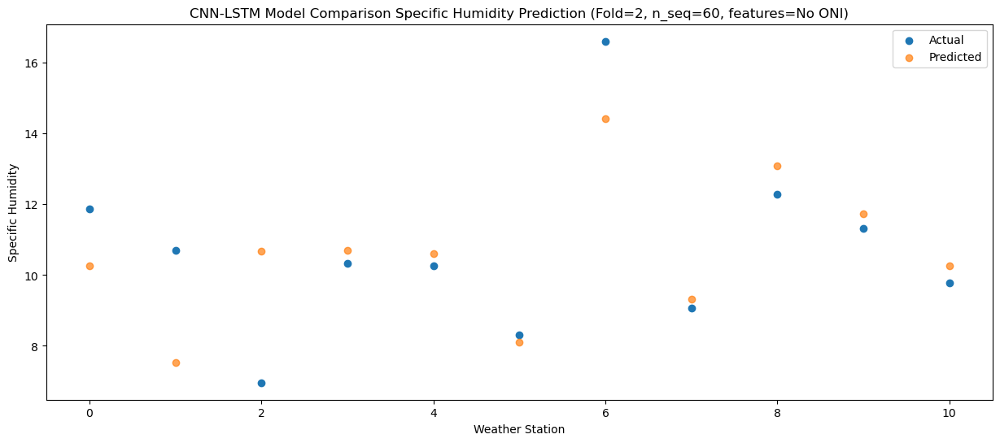

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56  10.424428
1                 1    9.09   7.694252
2                 2    7.58  10.844352
3                 3   11.07  10.864416
4                 4    9.87  10.774402
5                 5    8.43   8.264325
6                 6   16.99  14.584335
7                 7    9.36   9.494198
8                 8   11.68  13.244087
9                 9   11.90  11.904446
10               10   10.16  10.424446


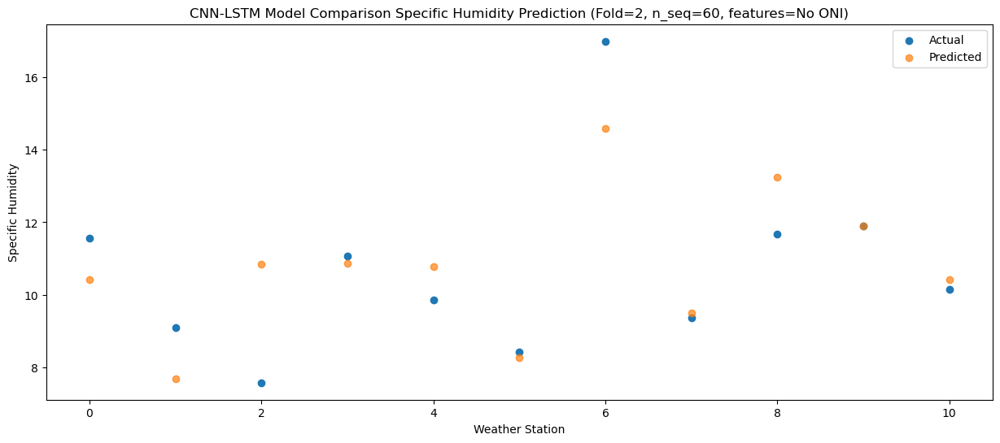

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   7.247937
1                 1    6.27   4.517747
2                 2    6.30   7.667854
3                 3    8.41   7.687924
4                 4    7.73   7.597909
5                 5    4.87   5.087827
6                 6   12.54  11.407837
7                 7    6.60   6.317688
8                 8   11.22  10.067568
9                 9    8.30   8.727957
10               10    6.95   7.247957


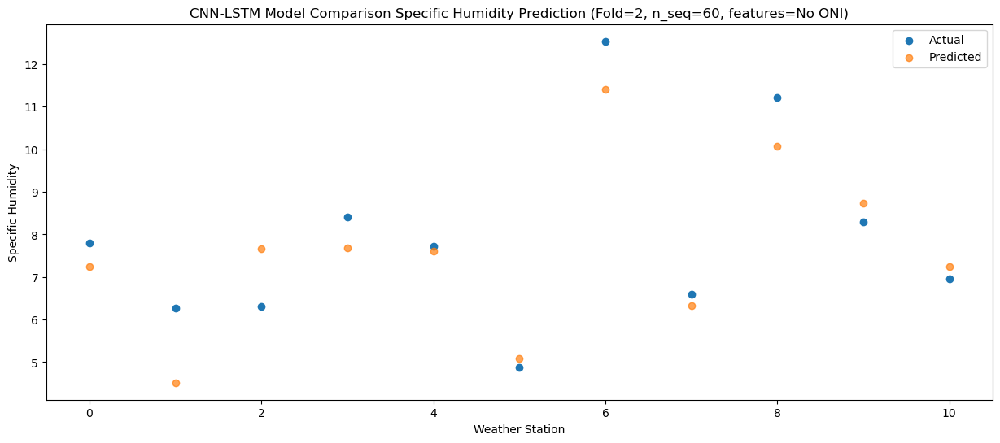

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   5.474007
1                 1    2.88   2.743802
2                 2    3.64   5.893916
3                 3    5.45   5.913993
4                 4    5.20   5.823976
5                 5    3.28   3.313887
6                 6    9.93   9.633898
7                 7    2.89   4.543736
8                 8    8.42   8.293606
9                 9    6.14   6.954028
10               10    5.22   5.474028


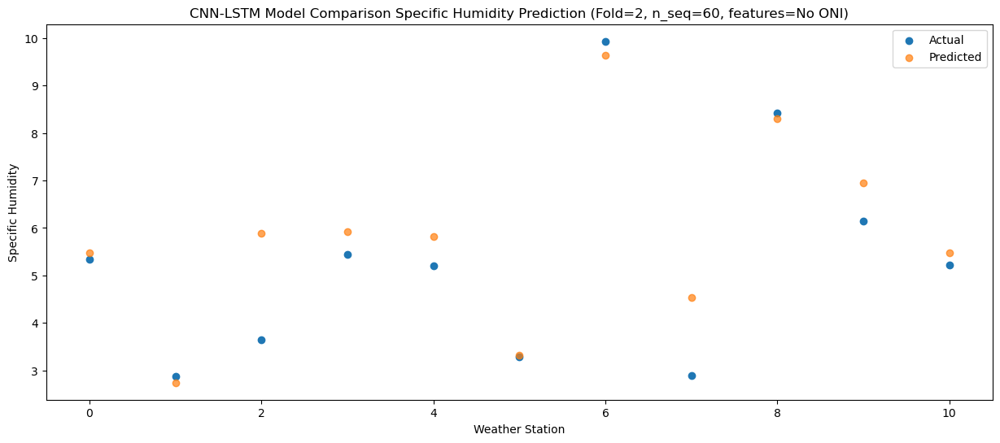

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15   1.338767
1                 1    0.45  -1.391437
2                 2   -0.31   1.758678
3                 3    1.00   1.778754
4                 4   -0.46   1.688736
5                 5   -0.91  -0.821352
6                 6    5.94   5.498659
7                 7    1.24   0.408498
8                 8    7.88   4.158366
9                 9    0.58   2.818790
10               10   -0.14   1.338790


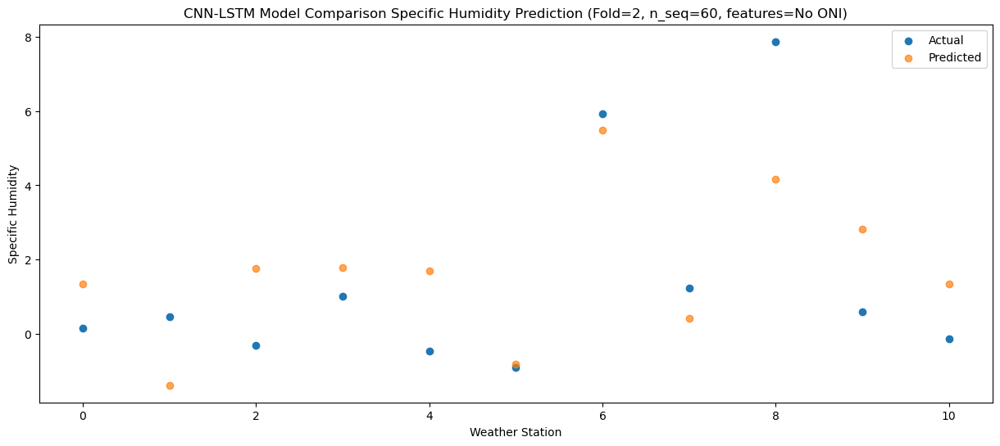

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.391016
1                 1   -0.61  -1.339197
2                 2    1.09   1.810924
3                 3    0.64   1.831004
4                 4    2.82   1.740986
5                 5    1.96  -0.769107
6                 6    8.44   5.550903
7                 7    1.37   0.460736
8                 8    7.70   4.210601
9                 9    2.43   2.871040
10               10    1.42   1.391039


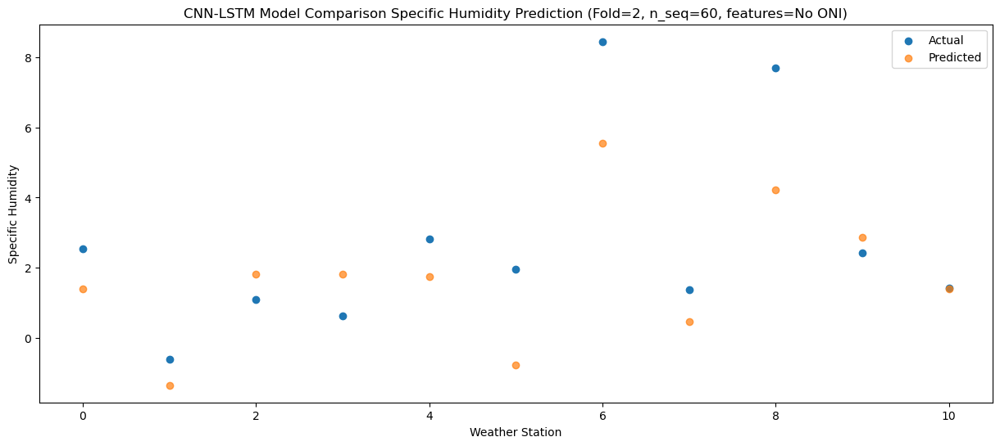

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -0.430994
1                 1   -0.94  -3.161220
2                 2   -2.56  -0.011092
3                 3   -0.69   0.008991
4                 4   -2.09  -0.081027
5                 5   -3.67  -2.591125
6                 6    3.15   3.728885
7                 7    1.09  -1.361290
8                 8    6.34   2.388568
9                 9   -0.35   1.049029
10               10   -1.00  -0.430972


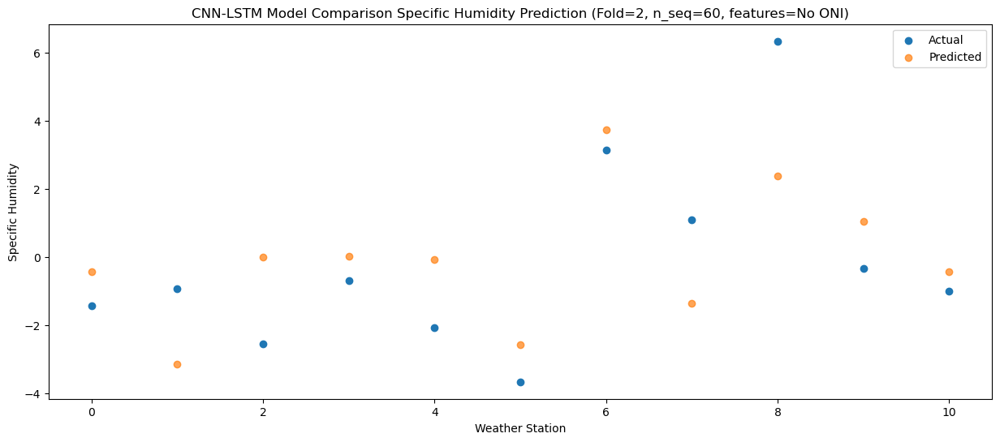

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78   0.016352
1                 1   -1.03  -2.713889
2                 2   -1.37   0.436247
3                 3   -0.12   0.456335
4                 4   -0.63   0.366316
5                 5   -3.45  -2.143788
6                 6    3.62   4.176223
7                 7    0.10  -0.913964
8                 8    5.60   2.835882
9                 9    0.96   1.496376
10               10   -0.10   0.016376


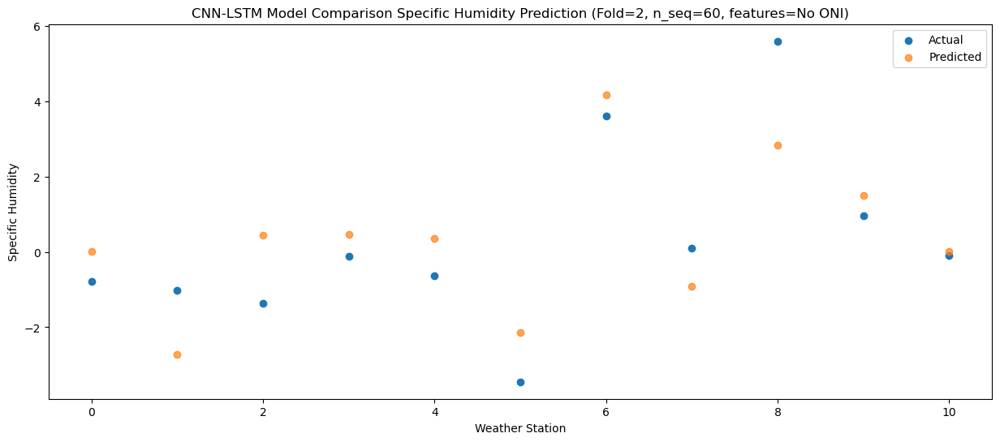

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65   1.343065
1                 1   -0.15  -1.387188
2                 2    0.44   1.762956
3                 3    0.64   1.783051
4                 4    0.22   1.693029
5                 5   -1.83  -0.817079
6                 6    5.25   5.502932
7                 7    0.50   0.412733
8                 8    7.34   4.162570
9                 9    1.92   2.823093
10               10    0.52   1.343092


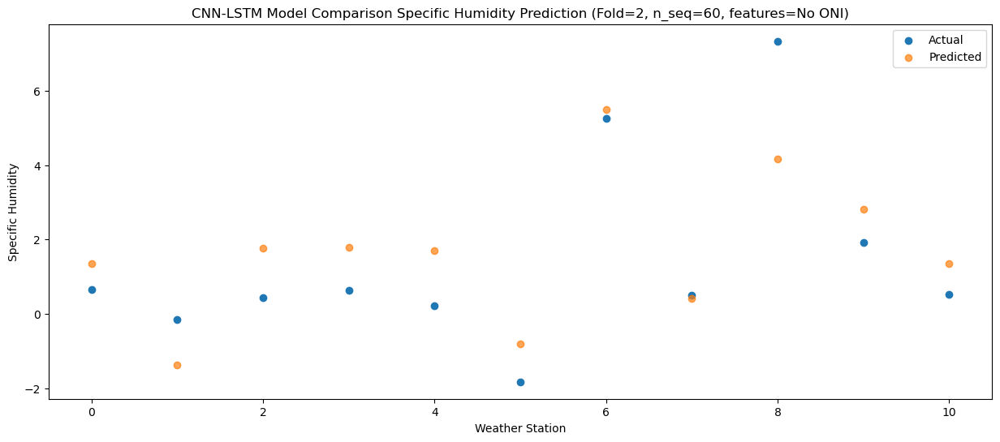

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55   2.323250
1                 1    1.00  -0.407004
2                 2    1.80   2.743139
3                 3    1.34   2.763236
4                 4    2.65   2.673212
5                 5    2.13   0.163104
6                 6    9.15   6.483115
7                 7    0.51   1.392914
8                 8    8.18   5.142748
9                 9    2.96   3.803278
10               10    1.79   2.323277


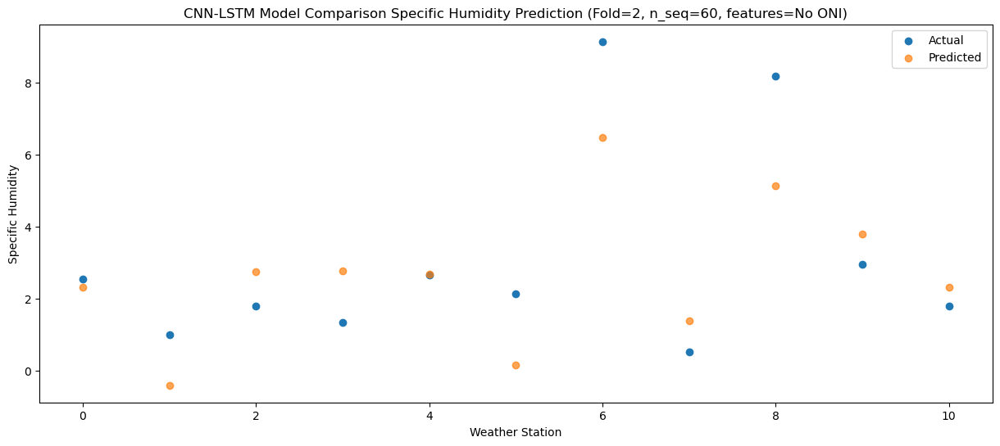

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81   5.750779
1                 1    3.39   3.020525
2                 2    4.90   6.170669
3                 3    4.64   6.190763
4                 4    6.68   6.100740
5                 5    5.78   3.590635
6                 6   13.24   9.910645
7                 7    0.44   4.820444
8                 8    9.44   8.570276
9                 9    7.28   7.230807
10               10    5.95   5.750806


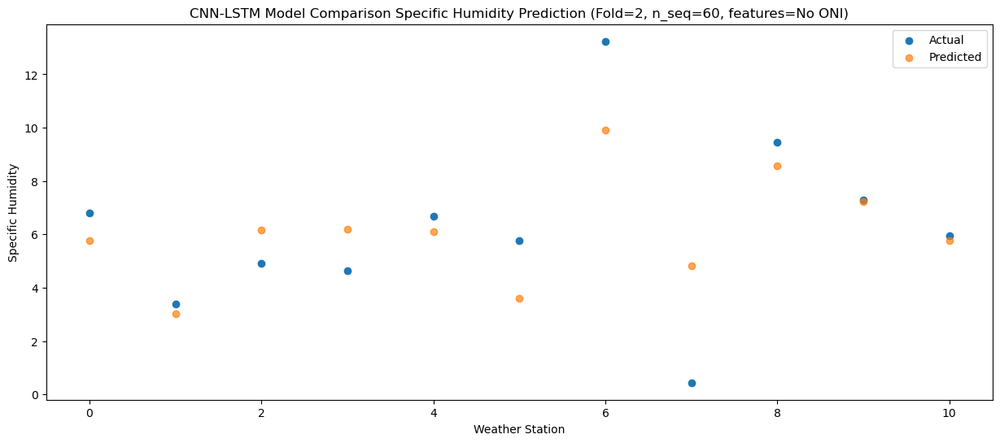

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86   7.713412
1                 1    7.75   4.983152
2                 2    6.83   8.133300
3                 3    6.90   8.153397
4                 4    8.98   8.063373
5                 5    6.81   5.553265
6                 6   14.04  11.873274
7                 7    5.94   6.783067
8                 8   11.21  10.532899
9                 9    9.08   9.193440
10               10    7.91   7.713438


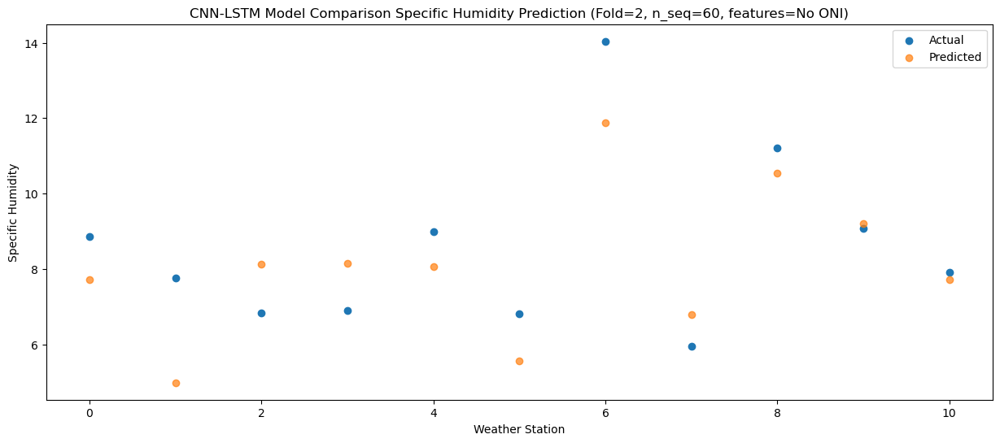

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08   9.787288
1                 1    9.09   7.057010
2                 2    7.66  10.207167
3                 3   10.26  10.227272
4                 4   10.27  10.137247
5                 5    7.91   7.627129
6                 6   13.36  13.947138
7                 7    8.50   8.856918
8                 8   12.10  12.606737
9                 9   12.66  11.267318
10               10   11.12   9.787318


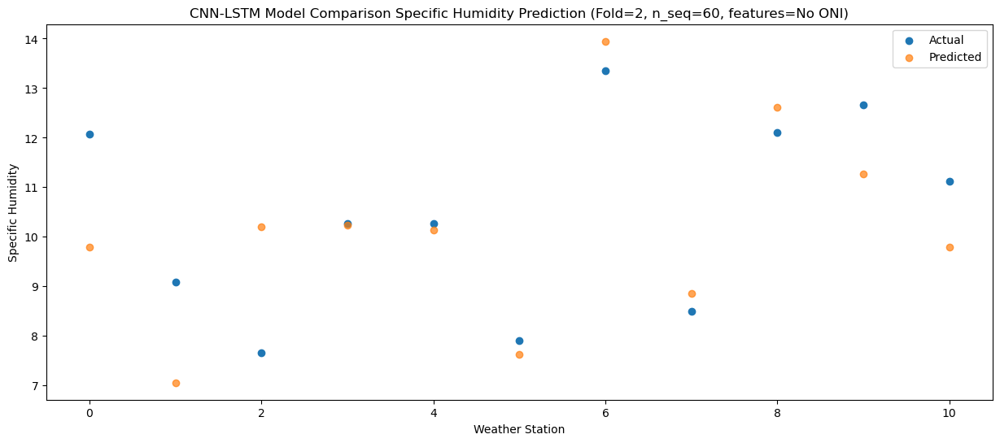

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60   9.730121
1                 1    8.59   6.999853
2                 2    7.55  10.150004
3                 3   10.94  10.170107
4                 4   10.67  10.080082
5                 5    8.37   7.569967
6                 6   14.42  13.889975
7                 7   10.47   8.799766
8                 8   12.20  12.549591
9                 9   11.09  11.210150
10               10   10.13   9.730149


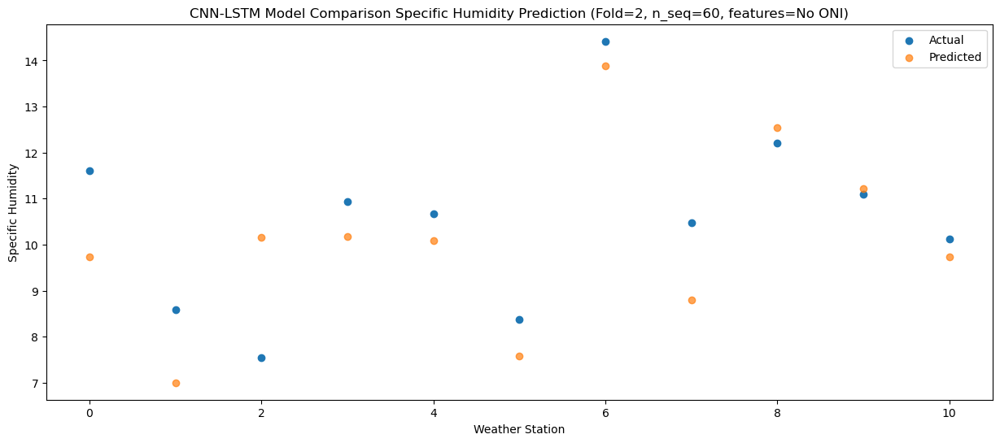

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   6.871396
1                 1    6.02   4.141116
2                 2    7.40   7.291275
3                 3    7.14   7.311381
4                 4    7.16   7.221355
5                 5    5.01   4.711236
6                 6   11.75  11.031245
7                 7    7.43   5.941024
8                 8   13.05   9.690839
9                 9    7.66   8.351427
10               10    6.65   6.871427


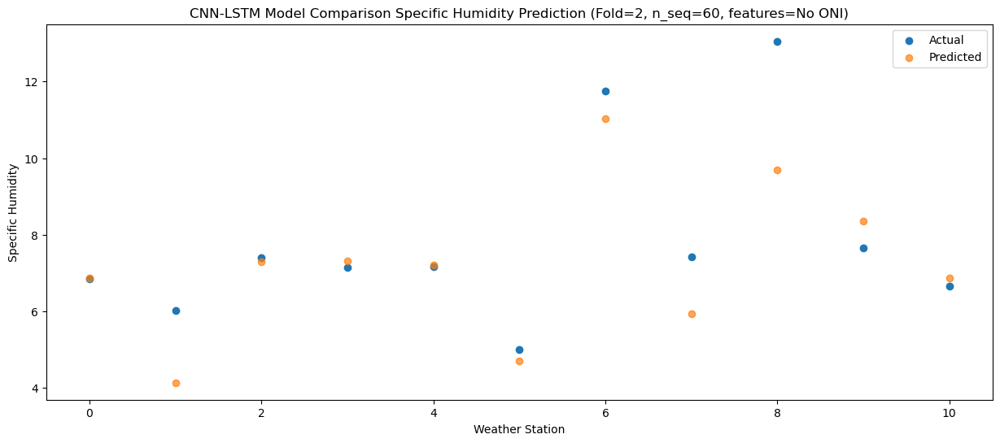

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   2.656282
1                 1    2.34  -0.073982
2                 2    3.01   3.076168
3                 3    4.27   3.096268
4                 4    1.98   3.006245
5                 5    0.19   0.496132
6                 6    6.97   6.816139
7                 7    5.35   1.725932
8                 8   11.28   5.475756
9                 9    3.30   4.136311
10               10    1.99   2.656311


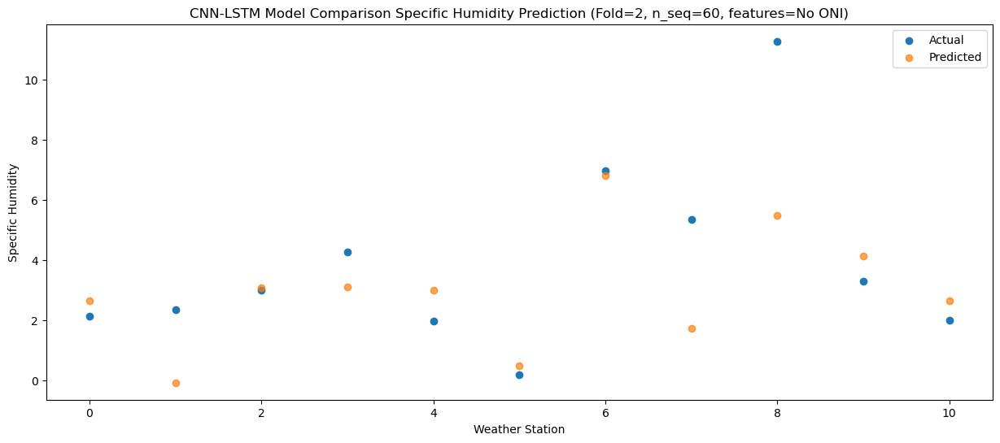

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   1.339069
1                 1    0.84  -1.391178
2                 2    2.90   1.758961
3                 3    2.45   1.779056
4                 4    1.54   1.689035
5                 5    0.05  -0.821072
6                 6    6.52   5.498936
7                 7    1.38   0.408743
8                 8    6.64   4.158580
9                 9    2.83   2.819097
10               10    1.37   1.339096


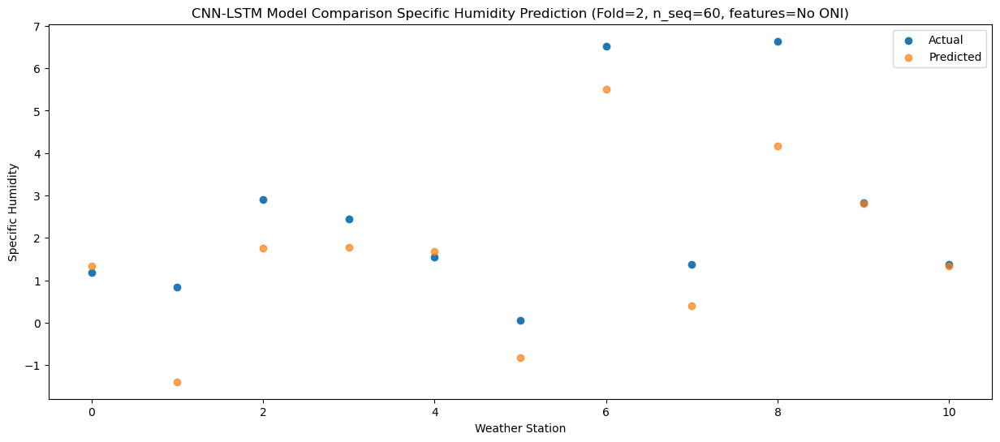

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56   0.259281
1                 1   -0.35  -2.470961
2                 2   -0.76   0.679176
3                 3    0.36   0.699267
4                 4    0.99   0.609249
5                 5   -0.86  -1.900858
6                 6    5.35   4.419150
7                 7    2.20  -0.671038
8                 8    7.49   3.078801
9                 9    0.59   1.739308
10               10    0.28   0.259307


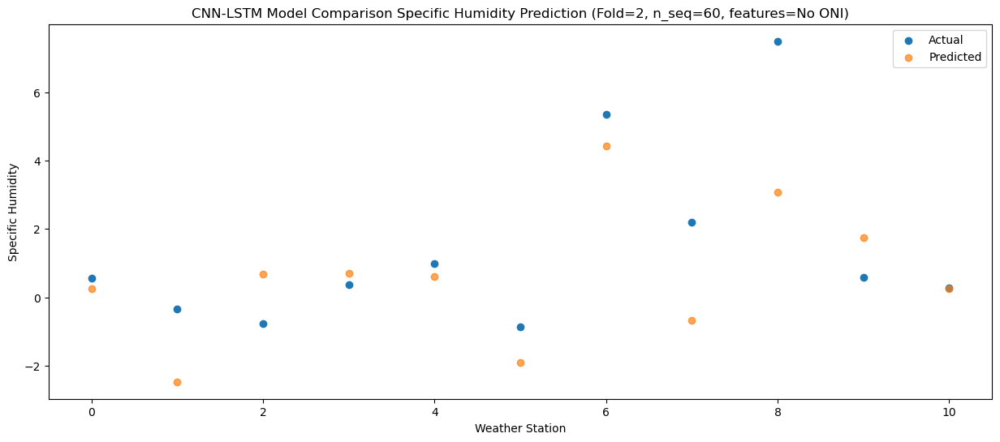

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   0.760952
1                 1   -0.36  -1.969285
2                 2   -1.14   1.180848
3                 3    0.87   1.200939
4                 4    0.90   1.110920
5                 5   -1.24  -1.399185
6                 6    4.57   4.920823
7                 7    1.31  -0.169360
8                 8    7.58   3.580479
9                 9    1.45   2.240977
10               10    0.55   0.760976


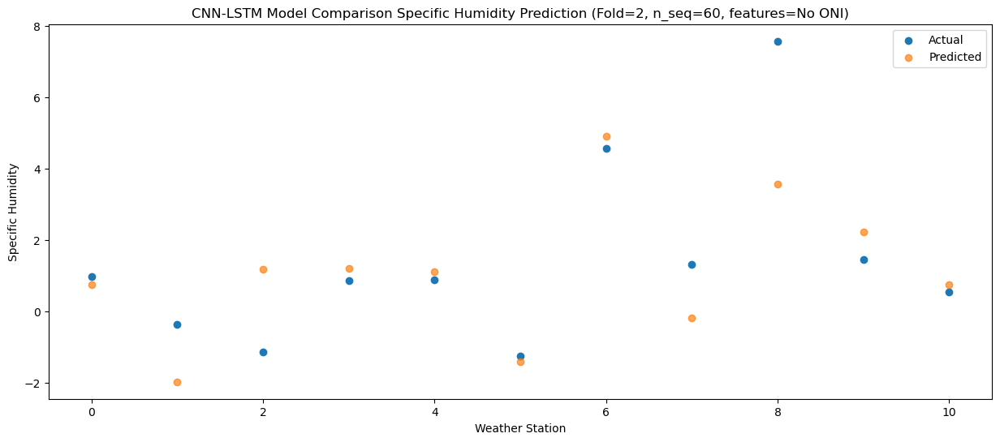

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   0.242088
1                 1   -0.44  -2.488160
2                 2    0.71   0.661979
3                 3    0.11   0.682074
4                 4    2.20   0.592055
5                 5   -0.79  -1.918056
6                 6    4.97   4.401953
7                 7    1.19  -0.688240
8                 8    6.17   3.061592
9                 9    2.21   1.722115
10               10    0.95   0.242114


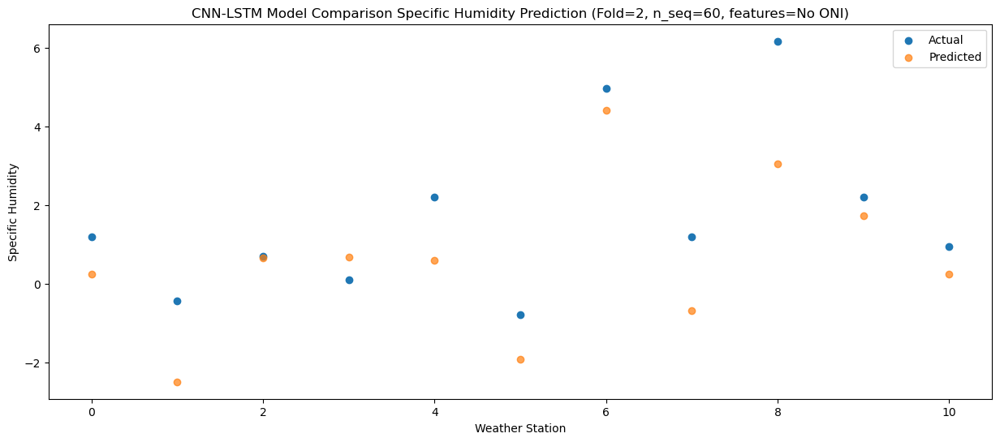

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54   0.670463
1                 1    0.25  -2.059775
2                 2    1.10   1.090359
3                 3    0.36   1.110449
4                 4    3.08   1.020434
5                 5    0.99  -1.489676
6                 6    6.88   4.830331
7                 7    1.53  -0.259856
8                 8    8.09   3.489985
9                 9    1.90   2.150489
10               10    0.55   0.670489


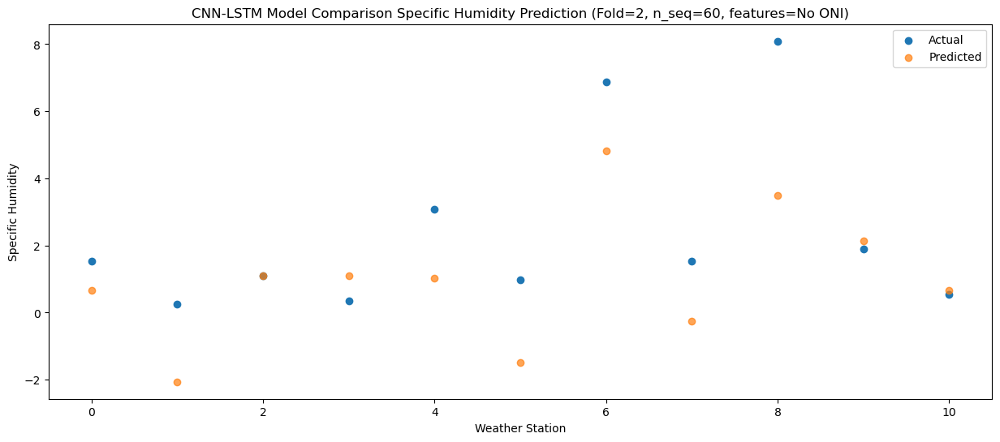

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   1.955336
1                 1    0.87  -0.774925
2                 2    2.61   2.375219
3                 3    2.44   2.395320
4                 4    3.63   2.305302
5                 5    1.54  -0.204818
6                 6    7.55   6.115190
7                 7    0.69   1.024989
8                 8    8.79   4.774816
9                 9    4.03   3.435361
10               10    2.19   1.955360


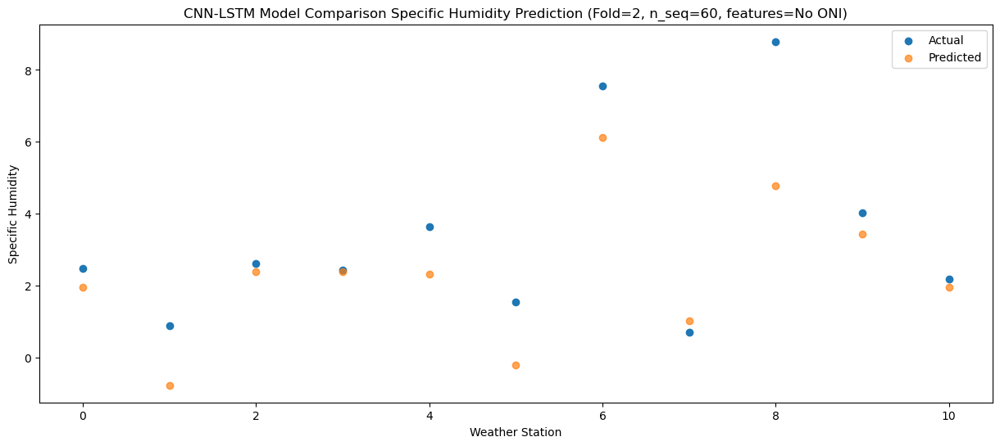

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09   4.345097
1                 1    6.65   1.614832
2                 2    3.42   4.764980
3                 3    3.25   4.785079
4                 4    6.69   4.695062
5                 5    5.24   2.184942
6                 6   11.44   8.504949
7                 7    2.69   3.414746
8                 8   10.19   7.164571
9                 9    5.56   5.825120
10               10    4.78   4.345119


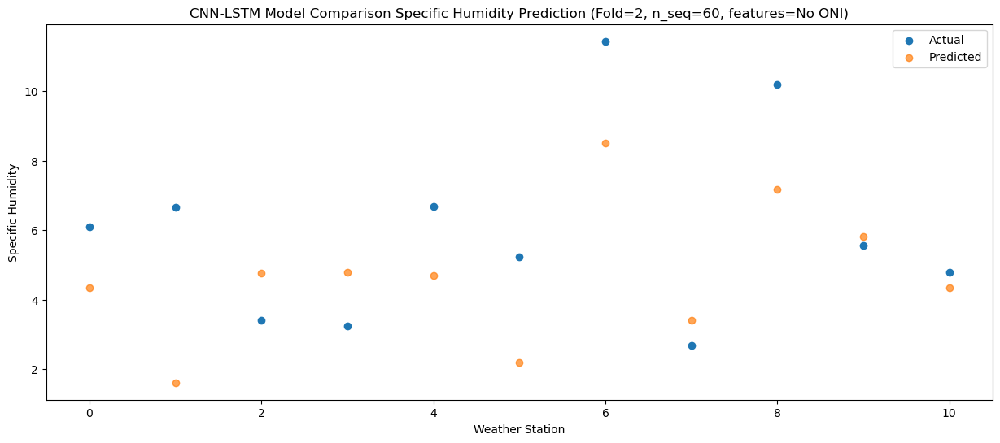

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06   6.908976
1                 1    9.30   4.178709
2                 2    6.58   7.328859
3                 3    7.15   7.348957
4                 4   10.00   7.258939
5                 5    8.70   4.748819
6                 6   15.34  11.068825
7                 7    2.49   5.978623
8                 8   10.57   9.728446
9                 9    8.42   8.389001
10               10    6.62   6.909000


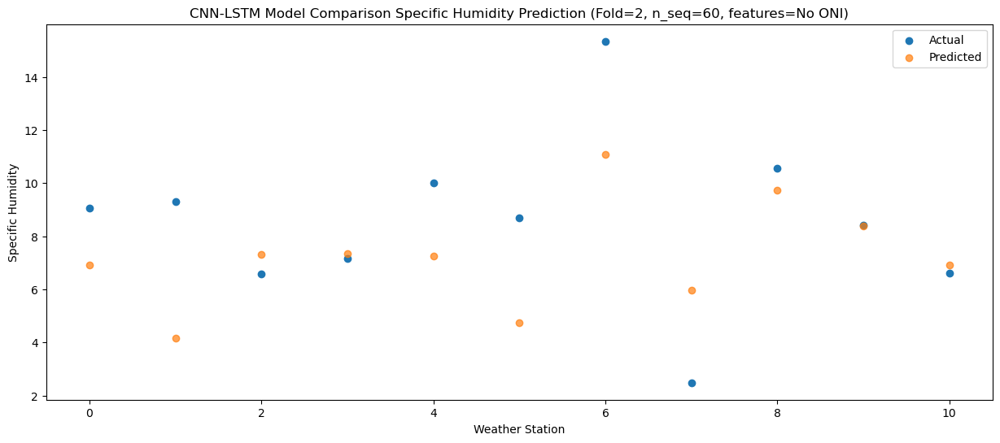

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24   9.622063
1                 1   11.36   6.891787
2                 2    7.55  10.041946
3                 3   11.41  10.062045
4                 4   11.34   9.972026
5                 5    8.41   7.461901
6                 6   14.63  13.781910
7                 7    5.84   8.691696
8                 8   11.91  12.441513
9                 9   12.26  11.102091
10               10    9.93   9.622089


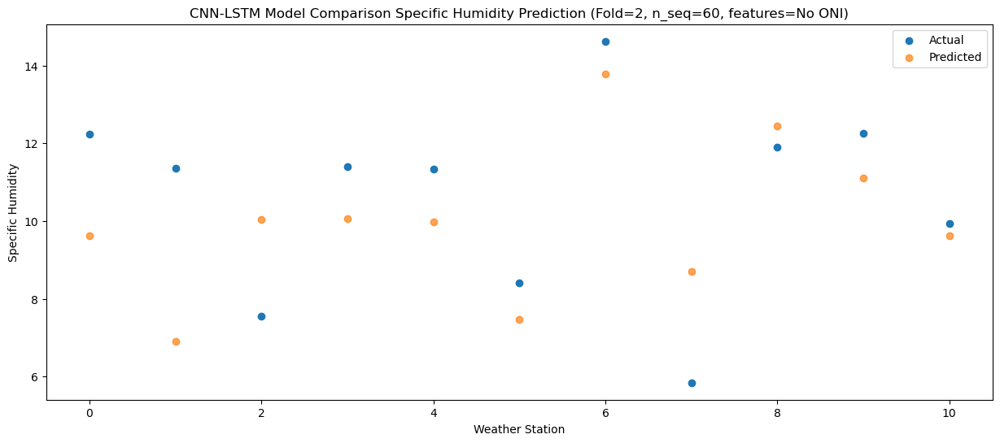

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59   9.080284
1                 1    9.47   6.350004
2                 2    8.27   9.500165
3                 3    9.07   9.520266
4                 4   11.37   9.430243
5                 5    6.98   6.920118
6                 6   12.58  13.240128
7                 7    8.03   8.149913
8                 8   12.52  11.899729
9                 9   11.77  10.560309
10               10   10.04   9.080308


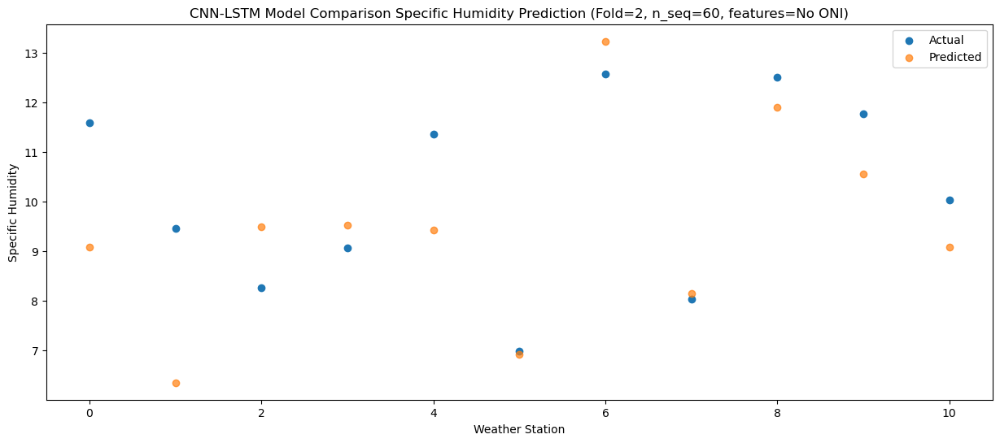

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56   6.757738
1                 1    6.88   4.027456
2                 2    5.88   7.177619
3                 3    8.06   7.197721
4                 4    9.02   7.107698
5                 5    6.43   4.597572
6                 6   11.95  10.917582
7                 7    6.22   5.827365
8                 8   12.27   9.577180
9                 9    8.63   8.237765
10               10    7.62   6.757764


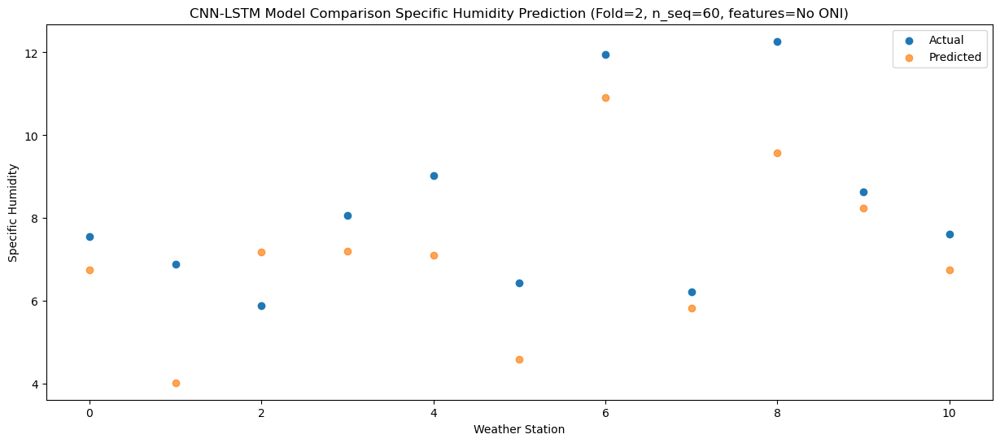

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   3.394047
1                 1    3.42   0.663760
2                 2    2.96   3.813926
3                 3    4.70   3.834029
4                 4    3.79   3.744005
5                 5    2.90   1.233879
6                 6    8.80   7.553889
7                 7    3.77   2.463667
8                 8    9.97   6.213479
9                 9    4.44   4.874074
10               10    3.51   3.394073


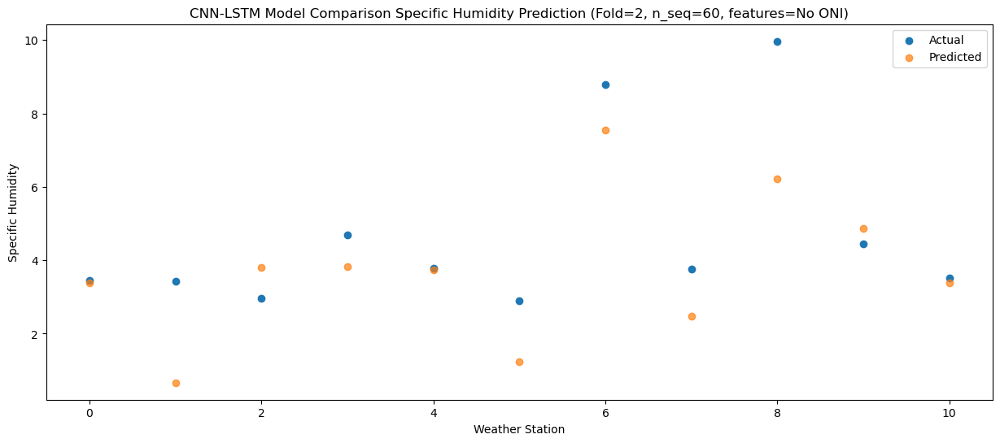

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   0.246340
1                 1    0.86  -2.483941
2                 2    0.46   0.666220
3                 3    0.87   0.686321
4                 4    1.27   0.596299
5                 5   -0.27  -1.913824
6                 6    6.18   4.406185
7                 7    2.85  -0.684032
8                 8    6.94   3.065784
9                 9    1.33   1.726367
10               10    0.56   0.246366


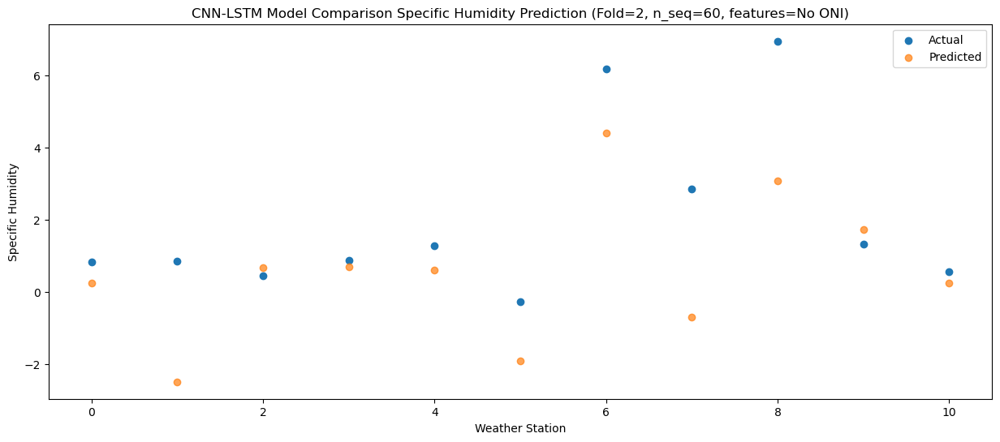

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10   0.325192
1                 1    0.47  -2.405108
2                 2   -0.11   0.745065
3                 3    1.16   0.765170
4                 4   -0.32   0.675147
5                 5   -2.20  -1.834983
6                 6    4.36   4.485027
7                 7    1.33  -0.605206
8                 8    7.73   3.144599
9                 9    1.24   1.805222
10               10    0.35   0.325219


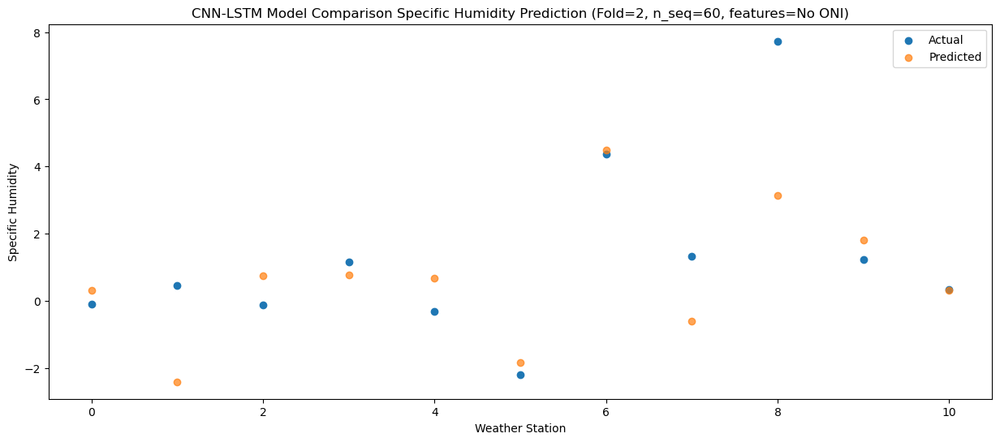

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -0.842071
1                 1   -0.12  -3.572372
2                 2   -1.18  -0.422196
3                 3   -0.17  -0.402093
4                 4   -1.19  -0.492115
5                 5   -3.21  -3.002245
6                 6    3.24   3.317764
7                 7    1.75  -1.772471
8                 8    7.70   1.977335
9                 9    0.55   0.637960
10               10   -0.27  -0.842042


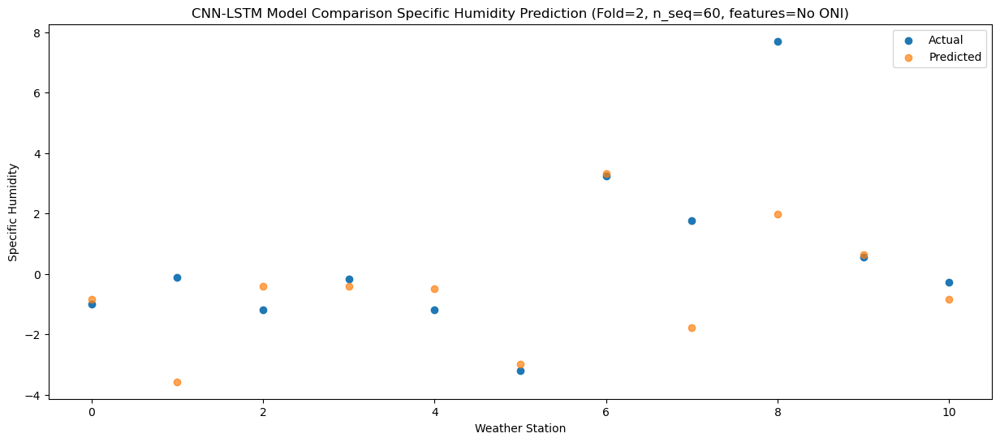

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88  -0.312045
1                 1    0.70  -3.042371
2                 2   -1.60   0.107817
3                 3   -0.22   0.127929
4                 4   -0.13   0.037907
5                 5   -0.81  -2.472234
6                 6    5.71   3.847775
7                 7    1.77  -1.242479
8                 8    8.67   2.507308
9                 9    0.69   1.167989
10               10    0.13  -0.312013


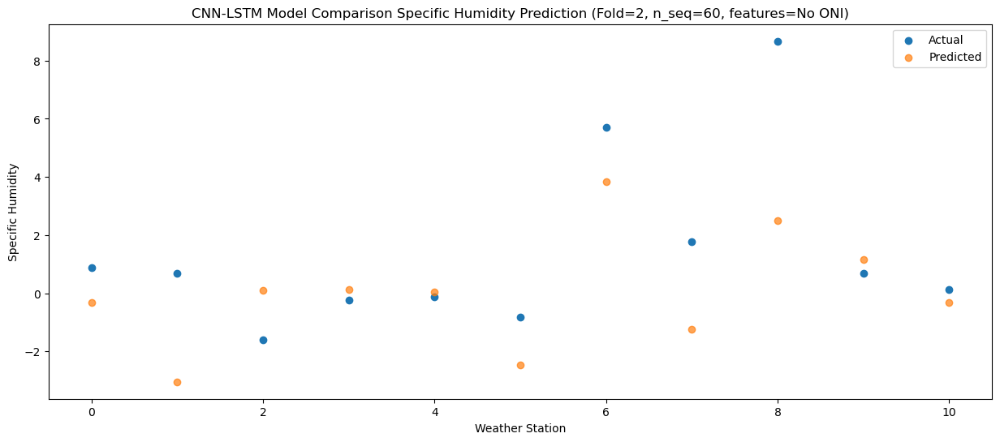

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   0.392122
1                 1    0.95  -2.338211
2                 2    1.56   0.811982
3                 3    0.83   0.832096
4                 4    1.47   0.742075
5                 5    0.83  -1.768071
6                 6    7.33   4.551938
7                 7    1.99  -0.538325
8                 8    7.11   3.211460
9                 9    2.10   1.872159
10               10    1.23   0.392158


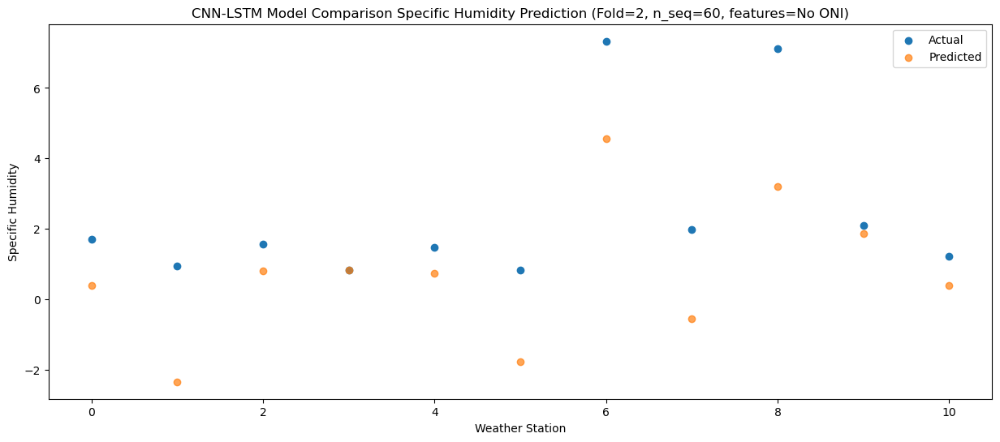

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   1.909991
1                 1    1.91  -0.820333
2                 2    0.35   2.329856
3                 3    1.72   2.349966
4                 4    3.54   2.259944
5                 5    3.11  -0.250197
6                 6    9.53   6.069811
7                 7    1.32   0.979556
8                 8    6.21   4.729349
9                 9    4.32   3.390027
10               10    3.34   1.910025


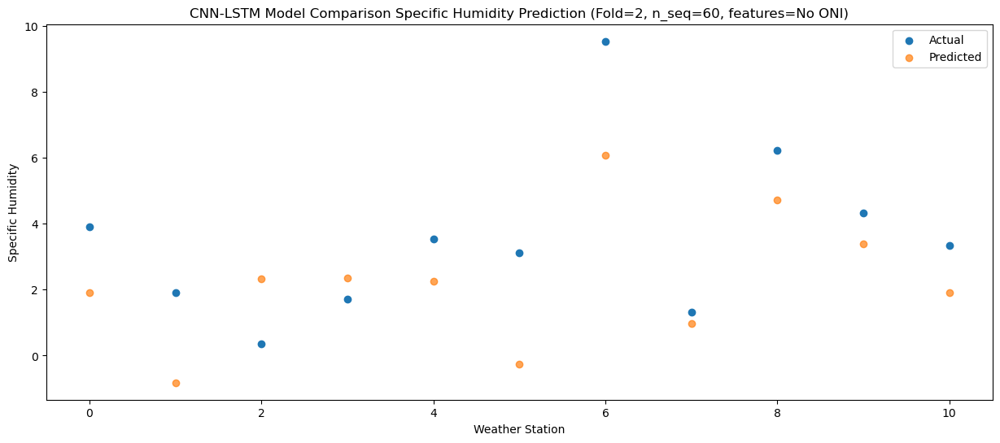

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17   4.880591
1                 1    4.94   2.150251
2                 2    5.21   5.300446
3                 3    4.90   5.320564
4                 4    7.97   5.230538
5                 5    7.21   2.720391
6                 6   13.31   9.040399
7                 7    1.01   3.950131
8                 8   10.31   7.699911
9                 9    8.20   6.360629
10               10    7.20   4.880627


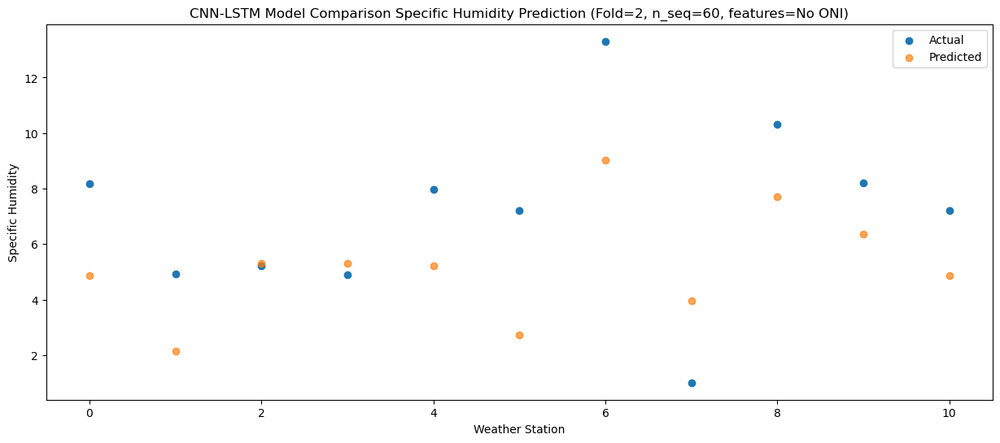

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   7.373277
1                 1   10.95   4.642938
2                 2    7.27   7.793132
3                 3    7.82   7.813249
4                 4    9.94   7.723223
5                 5    8.87   5.213076
6                 6   14.90  11.533085
7                 7    5.06   6.442823
8                 8   11.91  10.192602
9                 9   10.07   8.853312
10               10    8.75   7.373308


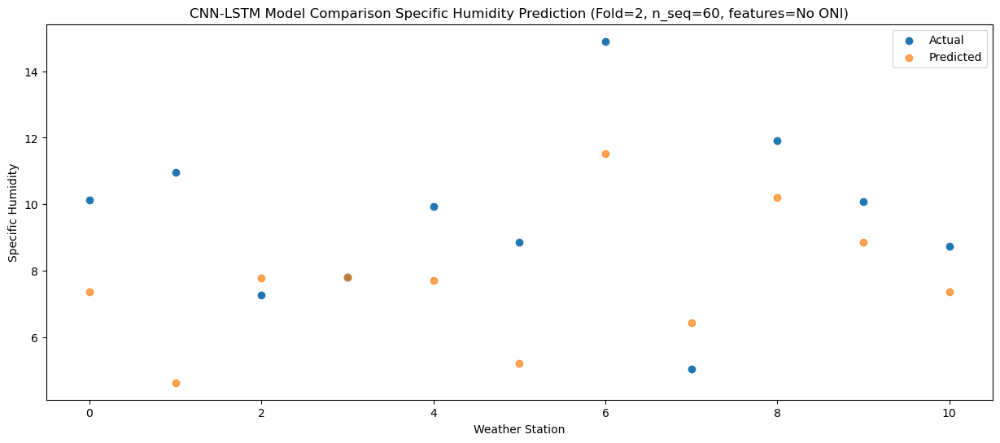

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61   8.288993
1                 1    9.50   5.558667
2                 2    8.32   8.708853
3                 3   10.99   8.728965
4                 4   11.58   8.638943
5                 5    9.17   6.128800
6                 6   15.13  12.448808
7                 7    8.66   7.358553
8                 8   13.14  11.108339
9                 9   12.68   9.769028
10               10   10.79   8.289025


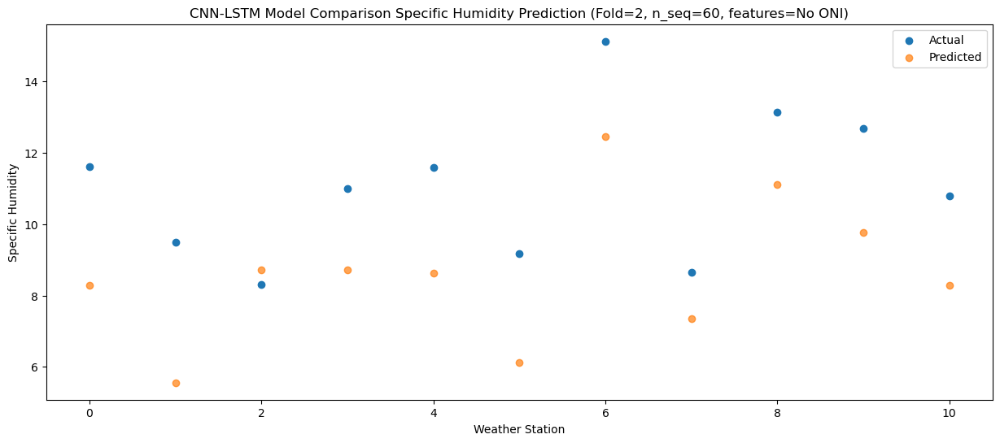

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61   7.945677
1                 1   10.48   5.215358
2                 2    8.92   8.365541
3                 3    9.49   8.385648
4                 4   10.41   8.295630
5                 5    9.21   5.785488
6                 6   14.95  12.105496
7                 7    8.34   7.015245
8                 8   12.32  10.765036
9                 9   11.42   9.425710
10               10    9.78   7.945707


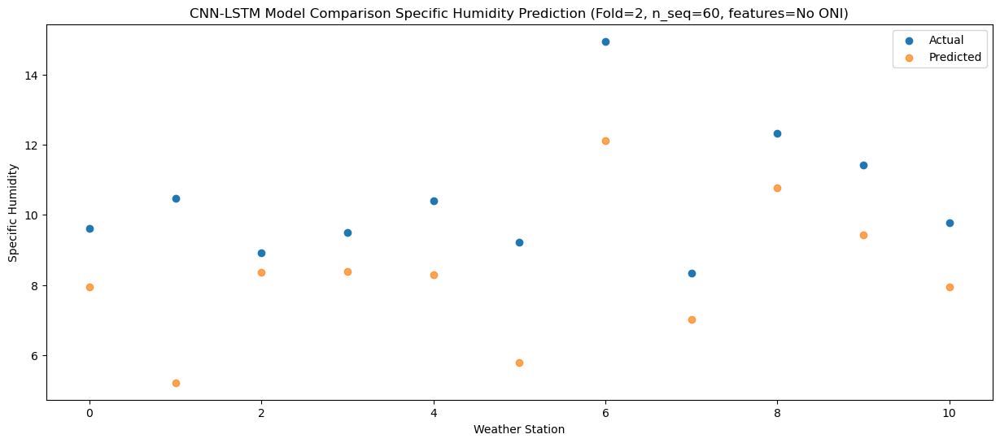

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99   5.508633
1                 1    6.53   2.778318
2                 2    9.35   5.928500
3                 3    6.60   5.948604
4                 4    8.81   5.858587
5                 5    6.72   3.348447
6                 6   12.05   9.668456
7                 7    5.60   4.578206
8                 8   11.93   8.328000
9                 9    9.57   6.988666
10               10    7.68   5.508663


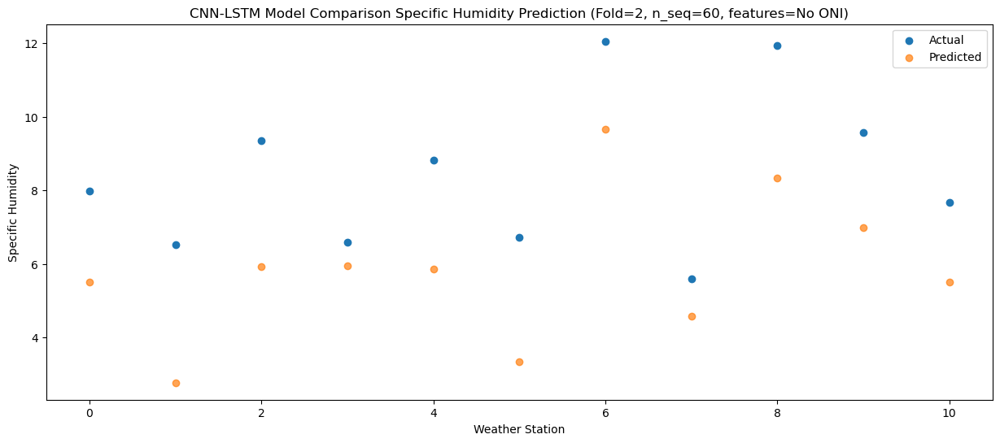

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61   1.767502
1                 1    3.67  -0.962798
2                 2    4.37   2.187377
3                 3    3.36   2.207474
4                 4    3.95   2.117459
5                 5    2.40  -0.392676
6                 6    8.63   5.927333
7                 7    2.71   0.837094
8                 8   10.03   4.586900
9                 9    4.95   3.247533
10               10    3.61   1.767530


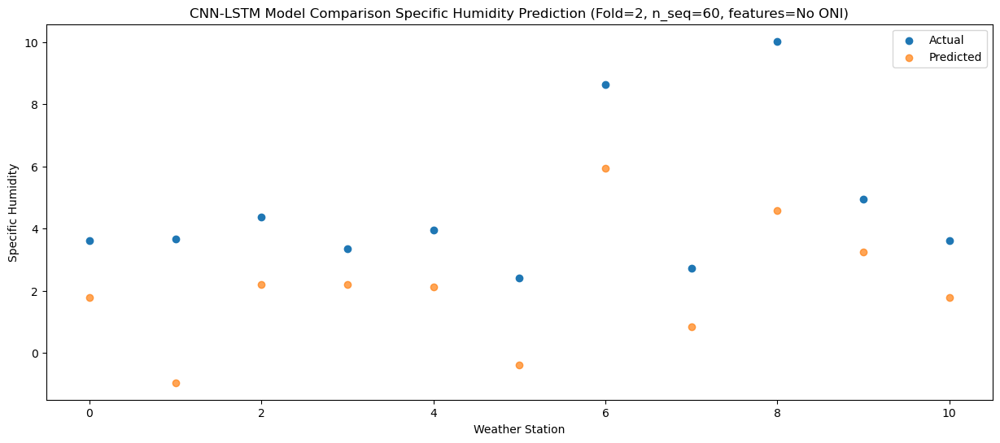

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 512)            2099200   
                                                                 
 dropout_7 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_5 (LSTM)               (None, 512)               2099200   
                                                      

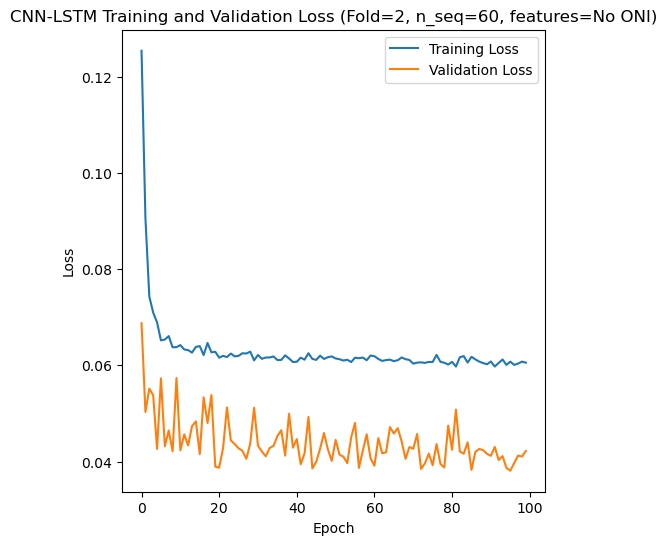

Epoch 1/100
84/84 [==============================] - 19s 84ms/step - loss: 0.1275 - accuracy: 0.1905 - mae: 0.1053 - rmse: 0.1275 - mape: 22.7631 - pearson: 0.6109 - val_loss: 0.0813 - val_accuracy: 0.0000e+00 - val_mae: 0.0651 - val_rmse: 0.0813 - val_mape: 13.7350 - val_pearson: 0.6836
Epoch 2/100
84/84 [==============================] - 3s 31ms/step - loss: 0.0836 - accuracy: 0.3571 - mae: 0.0668 - rmse: 0.0836 - mape: 14.7572 - pearson: 0.7499 - val_loss: 0.0713 - val_accuracy: 0.6000 - val_mae: 0.0578 - val_rmse: 0.0713 - val_mape: 12.3061 - val_pearson: 0.7249
Epoch 3/100
84/84 [==============================] - 3s 35ms/step - loss: 0.0734 - accuracy: 0.3690 - mae: 0.0584 - rmse: 0.0734 - mape: 13.0583 - pearson: 0.7736 - val_loss: 0.0684 - val_accuracy: 0.0000e+00 - val_mae: 0.0549 - val_rmse: 0.0684 - val_mape: 11.8726 - val_pearson: 0.7225
Epoch 4/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0679 - accuracy: 0.4286 - mae: 0.0541 - rmse: 0.0679 - mape: 12

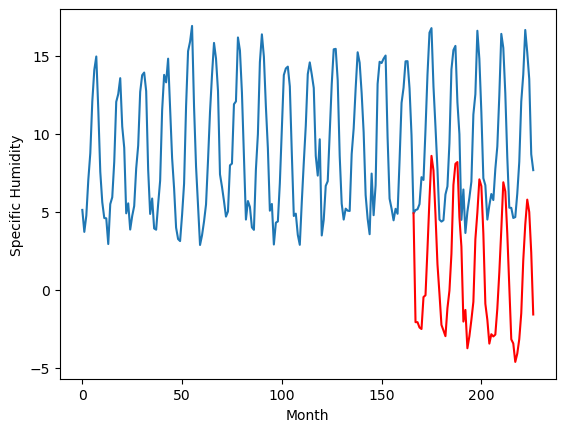

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		-1.05		-0.91
-0.55		-1.05		-0.50
-0.58		-1.39		-0.81
-0.94		-1.49		-0.55
1.66		0.56		-1.10
1.81		0.67		-1.14
4.78		3.66		-1.12
8.31		6.85		-1.46
11.05		9.62		-1.43
8.38		8.68		0.30
6.94		5.86		-1.08
2.37		2.67		0.30
0.87		0.77		-0.10
-1.17		-1.23		-0.06
-1.26		-1.58		-0.32
-1.82		-1.95		-0.13
0.69		-0.15		-0.84
1.86		0.97		-0.89
5.38		3.33		-2.05
9.91		7.75		-2.16
10.79		9.11		-1.68
10.96		9.22		-1.74
6.99		5.69		-1.30
4.80		3.79		-1.01
0.37		-1.01		-1.38
1.34		-0.27		-1.61
-1.85		-2.72		-0.87
-1.48		-1.95		-0.47
-0.01		-0.90		-0.89
2.29		0.25		-2.04
6.74		4.27		-2.47
9.36		5.98		-3.38
9.57		8.11		-1.46
10.18		7.67		-2.51
6.33		4.63		-1.70
1.87		0.13		-1.74
0.84		-0.90		-1.74
-0.35		-2.43		-2.08
-0.43		-1.82		-1.39
-0.27		-1.97		-1.70
0.67		-1.85		-2.52
1.54		-0.19		-1.73
5.95		2.14		-3.81
8.59		4.89		-3.70
10.86		7.92		-2.94
11.10		7.34		-3.76
7.03		4.62		-2.41
3.59		1.22		-2.37
0.71	

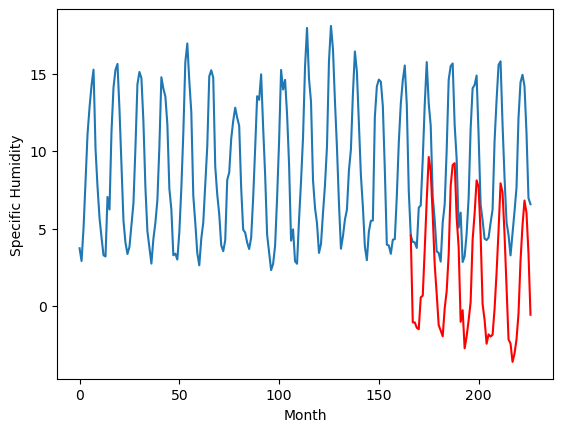

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		2.15		-3.84
6.53		2.15		-4.38
6.15		1.81		-4.34
5.46		1.71		-3.75
6.54		3.76		-2.78
7.91		3.87		-4.04
7.72		6.86		-0.86
9.26		10.05		0.79
9.48		12.82		3.34
11.00		11.88		0.88
10.52		9.06		-1.46
8.64		5.87		-2.77
5.95		3.97		-1.98
5.35		1.97		-3.38
5.79		1.62		-4.17
5.73		1.25		-4.48
5.81		3.05		-2.76
6.43		4.17		-2.26
6.83		6.53		-0.30
9.28		10.95		1.67
9.98		12.31		2.33
9.51		12.42		2.91
8.22		8.89		0.67
7.08		6.99		-0.09
7.66		2.19		-5.47
6.16		2.93		-3.23
5.88		0.48		-5.40
5.10		1.25		-3.85
6.44		2.30		-4.14
6.11		3.45		-2.66
6.29		7.47		1.18
7.46		9.18		1.72
8.63		11.31		2.68
9.42		10.87		1.45
9.13		7.83		-1.30
7.96		3.33		-4.63
5.24		2.30		-2.94
6.08		0.77		-5.31
6.23		1.38		-4.85
5.10		1.23		-3.87
6.62		1.35		-5.27
6.82		3.01		-3.81
7.76		5.34		-2.42
8.53		8.09		-0.44
9.63		11.12		1.49
10.70		10.54		-0.16
9.16		7.82		-1.34
8.00		4.42		-3.58
5.89		1.05		-4.84
6.12		0.78		-5.34
6.66

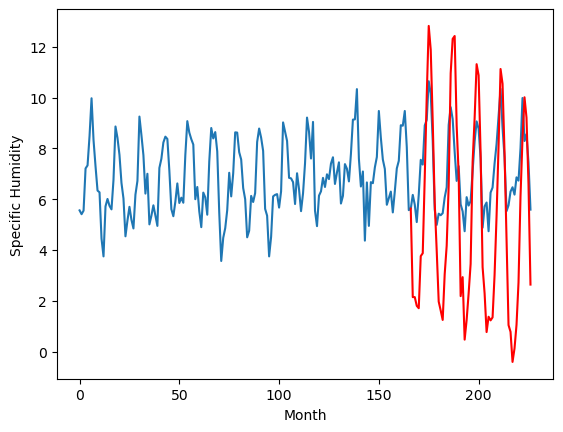

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		-0.07		0.76
-0.30		-0.07		0.23
-0.70		-0.41		0.29
-0.88		-0.51		0.37
0.98		1.54		0.56
0.90		1.65		0.75
4.33		4.64		0.31
7.57		7.83		0.26
10.67		10.60		-0.07
9.59		9.66		0.07
7.02		6.84		-0.18
3.33		3.65		0.32
0.44		1.75		1.31
-1.17		-0.25		0.92
-1.44		-0.60		0.84
-1.51		-0.97		0.54
-0.21		0.83		1.04
0.98		1.95		0.97
3.51		4.31		0.80
8.93		8.73		-0.20
9.56		10.09		0.53
10.44		10.20		-0.24
6.97		6.67		-0.30
4.91		4.77		-0.14
-0.78		-0.03		0.75
0.36		0.71		0.35
-1.96		-1.74		0.22
-1.44		-0.97		0.47
-0.46		0.08		0.54
0.81		1.23		0.42
5.23		5.25		0.02
7.49		6.96		-0.53
10.53		9.09		-1.44
9.40		8.65		-0.75
6.15		5.61		-0.54
1.00		1.11		0.11
0.19		0.08		-0.11
-0.84		-1.45		-0.61
-0.30		-0.84		-0.54
-0.48		-0.99		-0.51
-0.61		-0.87		-0.26
0.93		0.79		-0.14
3.84		3.12		-0.72
5.86		5.87		0.01
9.51		8.90		-0.61
8.96		8.32		-0.64
6.49		5.60		-0.89
2.96		2.20		-0.76
-0.43		-1.17		-0.74
-0.41		-1.44

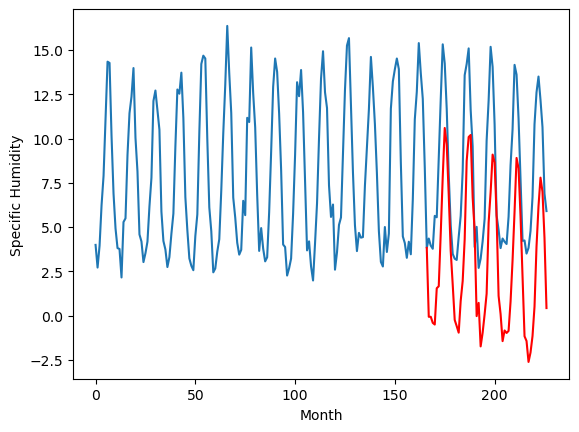

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		1.33		-2.28
2.11		1.33		-0.78
-0.18		0.99		1.17
-0.94		0.89		1.83
1.13		2.94		1.81
1.45		3.05		1.60
5.15		6.04		0.89
8.24		9.23		0.99
12.19		12.00		-0.19
9.81		11.06		1.25
6.85		8.24		1.39
2.13		5.05		2.92
1.03		3.15		2.12
-0.90		1.15		2.05
-1.10		0.80		1.90
-1.93		0.43		2.36
0.55		2.23		1.68
1.61		3.35		1.74
4.03		5.71		1.68
8.49		10.13		1.64
10.44		11.49		1.05
10.53		11.60		1.07
6.76		8.07		1.31
4.81		6.17		1.36
-0.31		1.37		1.68
0.39		2.11		1.72
-2.07		-0.34		1.73
-1.45		0.43		1.88
0.12		1.48		1.36
1.68		2.63		0.95
5.77		6.65		0.88
7.87		8.36		0.49
10.46		10.49		0.03
9.96		10.05		0.09
6.86		7.01		0.15
1.86		2.51		0.65
0.47		1.48		1.01
-0.65		-0.05		0.60
-0.27		0.56		0.83
0.61		0.41		-0.20
0.28		0.53		0.25
1.51		2.19		0.68
4.69		4.52		-0.17
6.82		7.27		0.45
10.59		10.30		-0.29
10.98		9.72		-1.26
6.87		7.00		0.13
3.25		3.60		0.35
0.08		0.23		0.15
-0.33		-0.04		0.29
-1.20		-1.22		-0.02


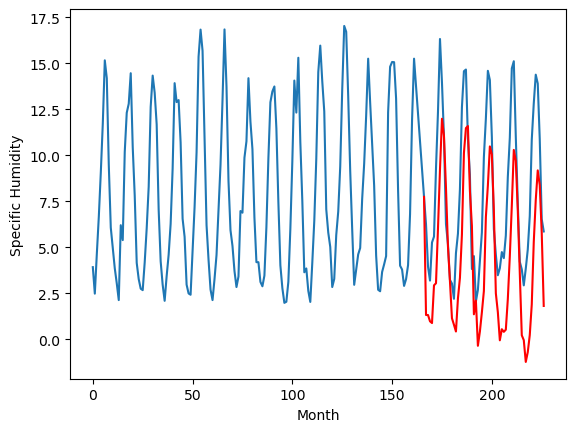

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		-0.05		-0.29
0.53		-0.05		-0.58
0.03		-0.39		-0.42
-0.22		-0.49		-0.27
1.77		1.56		-0.21
1.89		1.67		-0.22
5.10		4.66		-0.44
7.83		7.85		0.02
10.99		10.62		-0.37
9.77		9.68		-0.09
6.59		6.86		0.27
3.17		3.67		0.50
1.40		1.77		0.37
-0.26		-0.23		0.03
-0.57		-0.58		-0.01
-1.09		-0.95		0.14
0.94		0.85		-0.09
2.24		1.97		-0.27
4.48		4.33		-0.15
9.70		8.75		-0.95
10.95		10.11		-0.84
11.12		10.22		-0.90
7.82		6.69		-1.13
6.20		4.79		-1.41
0.33		-0.01		-0.34
1.38		0.73		-0.65
-1.13		-1.72		-0.59
-0.60		-0.95		-0.35
0.71		0.10		-0.61
2.24		1.25		-0.99
6.47		5.27		-1.20
8.54		6.98		-1.56
11.32		9.11		-2.21
10.12		8.67		-1.45
7.35		5.63		-1.72
2.05		1.13		-0.92
0.83		0.10		-0.73
0.07		-1.43		-1.50
0.65		-0.82		-1.47
0.32		-0.97		-1.29
0.75		-0.85		-1.60
2.06		0.81		-1.25
4.66		3.14		-1.52
6.82		5.89		-0.93
11.33		8.92		-2.41
10.45		8.34		-2.11
7.22		5.62		-1.60
3.84		2.22		-1.62
0.65		-1.15		-1.8

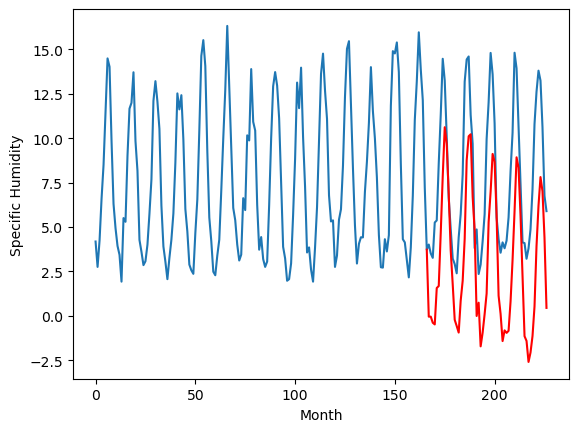

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		1.78		-4.38
5.79		1.78		-4.01
5.75		1.44		-4.31
5.71		1.34		-4.37
6.34		3.39		-2.95
6.69		3.50		-3.19
7.82		6.49		-1.33
8.88		9.68		0.80
10.40		12.45		2.05
9.19		11.51		2.32
8.05		8.69		0.64
6.40		5.50		-0.90
6.34		3.60		-2.74
5.53		1.60		-3.93
5.70		1.25		-4.45
5.76		0.88		-4.88
6.07		2.68		-3.39
6.54		3.80		-2.74
7.94		6.16		-1.78
9.27		10.58		1.31
11.72		11.94		0.22
10.29		12.05		1.76
8.59		8.52		-0.07
7.50		6.62		-0.88
6.79		1.82		-4.97
6.08		2.56		-3.52
5.60		0.11		-5.49
5.39		0.88		-4.51
6.07		1.93		-4.14
6.57		3.08		-3.49
7.38		7.10		-0.28
9.32		8.81		-0.51
12.31		10.94		-1.37
12.15		10.50		-1.65
9.20		7.46		-1.74
7.59		2.96		-4.63
5.93		1.93		-4.00
5.96		0.40		-5.56
5.93		1.01		-4.92
5.55		0.86		-4.69
5.85		0.98		-4.87
6.48		2.64		-3.84
8.64		4.97		-3.67
8.87		7.72		-1.15
9.71		10.75		1.04
11.36		10.17		-1.19
8.74		7.45		-1.29
7.49		4.05		-3.44
6.16		0.68		-5.48
6.03		0.41		-5.6

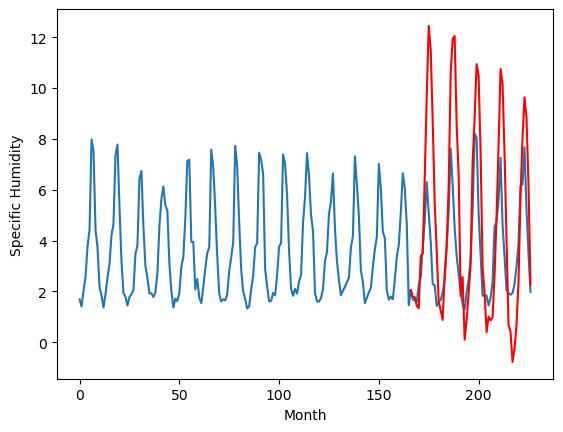

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		0.21		-4.78
5.98		0.21		-5.77
4.86		-0.13		-4.99
4.44		-0.23		-4.67
6.18		1.82		-4.36
5.99		1.93		-4.06
5.29		4.92		-0.37
5.62		8.11		2.49
6.10		10.88		4.78
6.97		9.94		2.97
5.71		7.12		1.41
4.70		3.93		-0.77
4.68		2.03		-2.65
3.85		0.03		-3.82
4.66		-0.32		-4.98
4.18		-0.69		-4.87
4.48		1.11		-3.37
4.17		2.23		-1.94
4.73		4.59		-0.14
6.15		9.01		2.86
11.51		10.37		-1.14
9.08		10.48		1.40
7.36		6.95		-0.41
6.26		5.05		-1.21
4.99		0.25		-4.74
5.13		0.99		-4.14
4.14		-1.46		-5.60
3.71		-0.69		-4.40
4.33		0.36		-3.97
4.33		1.51		-2.82
4.59		5.53		0.94
6.35		7.24		0.89
9.78		9.37		-0.41
12.85		8.93		-3.92
8.94		5.89		-3.05
6.21		1.39		-4.82
4.44		0.36		-4.08
5.19		-1.17		-6.36
5.58		-0.56		-6.14
4.33		-0.71		-5.04
5.37		-0.59		-5.96
4.52		1.07		-3.45
6.06		3.40		-2.66
6.56		6.15		-0.41
7.53		9.18		1.65
10.11		8.60		-1.51
9.17		5.88		-3.29
6.11		2.48		-3.63
5.10		-0.89		-5.99
5.02		-1.16		-6

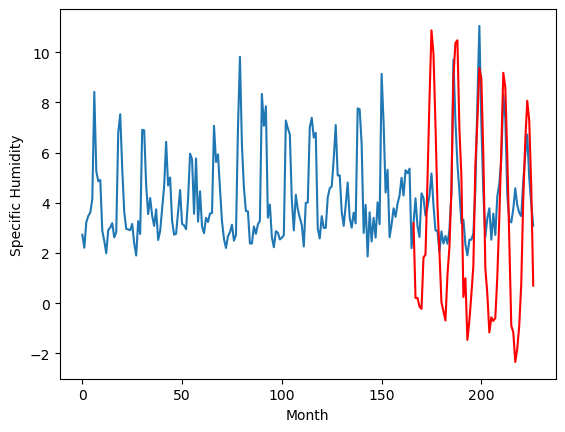

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		0.15		-4.38
5.76		0.15		-5.61
5.08		-0.19		-5.27
4.19		-0.29		-4.48
4.67		1.76		-2.91
5.73		1.87		-3.86
6.59		4.86		-1.73
6.81		8.05		1.24
7.28		10.82		3.54
8.08		9.88		1.80
7.69		7.06		-0.63
5.49		3.87		-1.62
4.33		1.97		-2.36
3.99		-0.03		-4.02
4.66		-0.38		-5.04
4.31		-0.75		-5.06
3.96		1.05		-2.91
4.89		2.17		-2.72
5.33		4.53		-0.80
6.76		8.95		2.19
7.24		10.31		3.07
7.63		10.42		2.79
6.99		6.89		-0.10
5.96		4.99		-0.97
6.18		0.19		-5.99
4.93		0.93		-4.00
4.60		-1.52		-6.12
3.76		-0.75		-4.51
4.76		0.30		-4.46
4.86		1.45		-3.41
5.23		5.47		0.24
6.72		7.18		0.46
7.55		9.31		1.76
8.01		8.87		0.86
7.41		5.83		-1.58
6.10		1.33		-4.77
3.85		0.30		-3.55
4.64		-1.23		-5.87
4.47		-0.62		-5.09
3.61		-0.77		-4.38
4.41		-0.65		-5.06
4.79		1.01		-3.78
6.38		3.34		-3.04
6.44		6.09		-0.35
7.28		9.12		1.84
8.55		8.54		-0.01
8.00		5.82		-2.18
6.57		2.42		-4.15
5.48		-0.95		-6.43
5.86		-1.22		-7.08


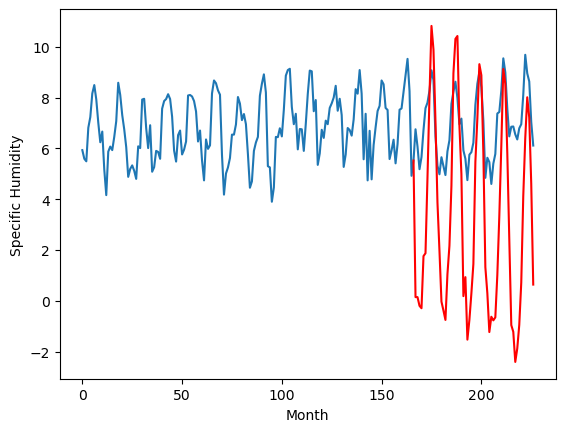

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		0.40		-0.10
0.14		0.40		0.26
-0.14		0.06		0.20
-0.06		-0.04		0.02
0.43		2.01		1.58
0.93		2.12		1.19
3.16		5.11		1.95
7.27		8.30		1.03
11.25		11.07		-0.18
10.18		10.13		-0.05
6.81		7.31		0.50
4.28		4.12		-0.16
2.12		2.22		0.10
0.16		0.22		0.06
-0.93		-0.13		0.80
-0.78		-0.50		0.28
0.00		1.30		1.30
1.38		2.42		1.04
2.95		4.78		1.83
7.85		9.20		1.35
10.06		10.56		0.50
10.44		10.67		0.23
7.84		7.14		-0.70
5.30		5.24		-0.06
0.77		0.44		-0.33
0.47		1.18		0.71
-1.01		-1.27		-0.26
-0.42		-0.50		-0.08
0.42		0.55		0.13
1.07		1.70		0.63
4.46		5.72		1.26
6.80		7.43		0.63
9.96		9.56		-0.40
10.10		9.12		-0.98
6.43		6.08		-0.35
3.80		1.58		-2.22
1.95		0.55		-1.40
-0.02		-0.98		-0.96
0.55		-0.37		-0.92
-0.16		-0.52		-0.36
0.05		-0.40		-0.45
2.29		1.26		-1.03
2.81		3.59		0.78
6.51		6.34		-0.17
11.36		9.37		-1.99
8.79		8.79		-0.00
7.82		6.07		-1.75
4.43		2.67		-1.76
0.63		-0.70		-1.33
0.96		-0.97		-1.93

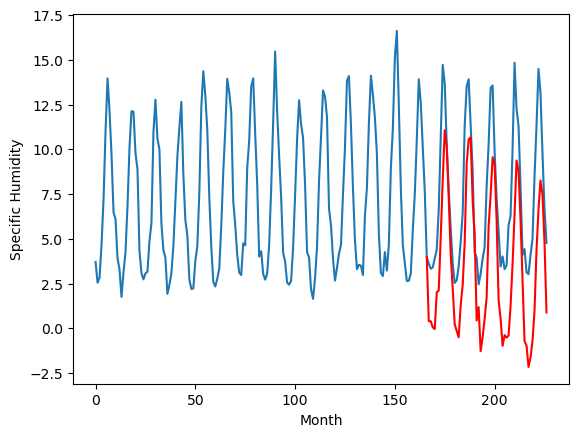

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-2.09		0.47
-2.68		-2.09		0.59
-2.76		-2.43		0.33
-2.77		-2.53		0.24
-1.81		-0.48		1.33
-1.38		-0.37		1.01
1.15		2.62		1.47
4.72		5.81		1.09
8.07		8.58		0.51
7.43		7.64		0.21
4.14		4.82		0.68
1.37		1.63		0.26
-0.96		-0.27		0.69
-2.81		-2.27		0.54
-3.50		-2.62		0.88
-3.64		-2.99		0.65
-2.36		-1.19		1.17
-0.95		-0.07		0.88
0.64		2.29		1.65
5.51		6.71		1.20
7.20		8.07		0.87
7.52		8.18		0.66
4.60		4.65		0.05
2.70		2.75		0.05
-2.22		-2.05		0.17
-2.32		-1.31		1.01
-3.83		-3.76		0.07
-3.13		-2.99		0.14
-2.19		-1.94		0.25
-1.55		-0.79		0.76
2.63		3.23		0.60
4.03		4.94		0.91
7.01		7.07		0.06
6.64		6.63		-0.01
3.62		3.59		-0.03
0.20		-0.91		-1.11
-1.02		-1.94		-0.92
-2.94		-3.47		-0.53
-2.16		-2.86		-0.70
-2.91		-3.01		-0.10
-2.78		-2.89		-0.11
-0.35		-1.23		-0.88
0.12		1.10		0.98
3.81		3.85		0.04
7.79		6.88		-0.91
6.55		6.30		-0.25
4.86		3.58		-1.28
1.59		0.18		-1.41
-2.09		-3.19		-1.10
-1.71	

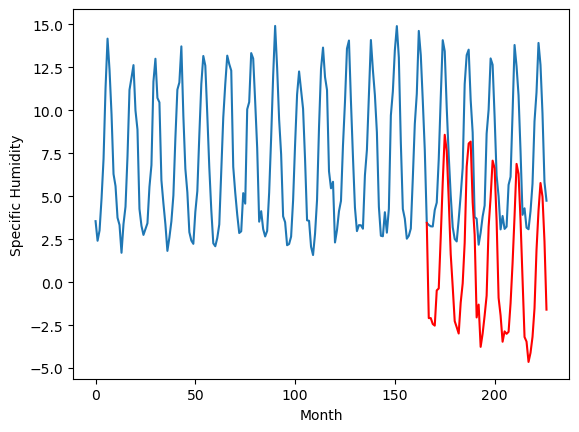

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-2.091353235244751, -1.0513527584075928, 2.1486467647552487, -0.07135323524475101, 1.3286472415924075, -0.051353235244750994, 1.7786462879180904, 0.20864628791809103, 0.14864628791809098, 0.39864676475524874, -2.091352758407593]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -2.091353
1                 1   -0.14  -1.051353
2                 2    5.99   2.148647
3                 3   -0.83  -0.071353
4                 4    3.61   1.328647
5                 5    0.24  -0.051353
6                 6    6.16   1.778646
7                 7    4.99   0.208646
8                 8    4.53   0.148646
9                 9    0.50   0.398647
10               10   -2.56  -2.091353


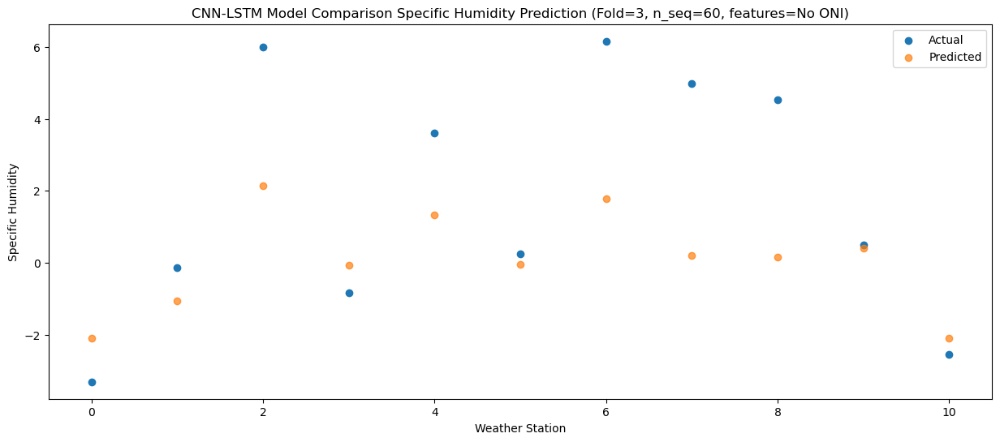

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -2.091421
1                 1   -0.55  -1.051419
2                 2    6.53   2.148580
3                 3   -0.30  -0.071421
4                 4    2.11   1.328580
5                 5    0.53  -0.051421
6                 6    5.79   1.778579
7                 7    5.98   0.208580
8                 8    5.76   0.148580
9                 9    0.14   0.398580
10               10   -2.68  -2.091419


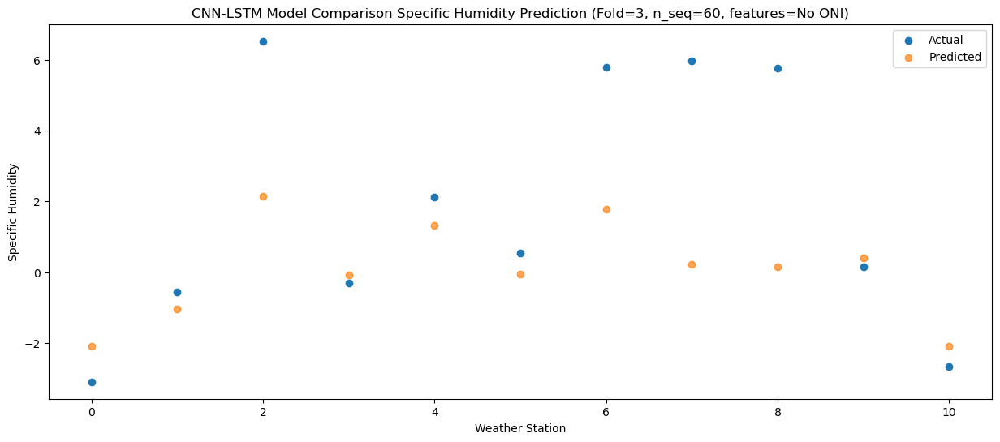

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -2.433679
1                 1   -0.58  -1.393678
2                 2    6.15   1.806323
3                 3   -0.70  -0.413679
4                 4   -0.18   0.986321
5                 5    0.03  -0.393679
6                 6    5.75   1.436321
7                 7    4.86  -0.133678
8                 8    5.08  -0.193678
9                 9   -0.14   0.056322
10               10   -2.76  -2.433678


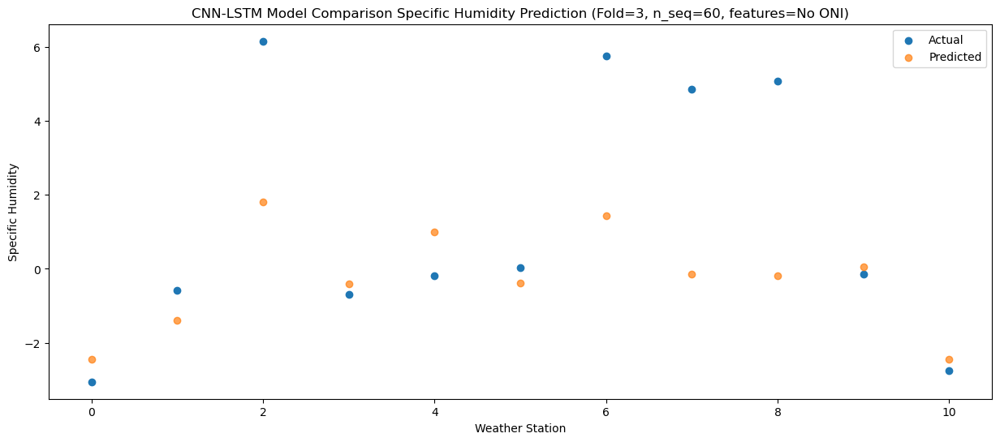

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72  -2.528727
1                 1   -0.94  -1.488725
2                 2    5.46   1.711275
3                 3   -0.88  -0.508728
4                 4   -0.94   0.891273
5                 5   -0.22  -0.488727
6                 6    5.71   1.341274
7                 7    4.44  -0.228725
8                 8    4.19  -0.288725
9                 9   -0.06  -0.038727
10               10   -2.77  -2.528726


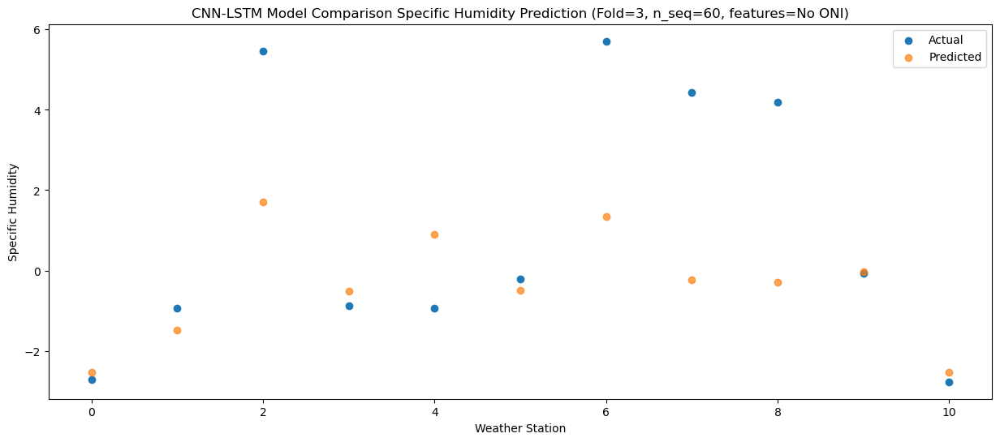

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -0.478564
1                 1    1.66   0.561437
2                 2    6.54   3.761438
3                 3    0.98   1.541434
4                 4    1.13   2.941435
5                 5    1.77   1.561434
6                 6    6.34   3.391437
7                 7    6.18   1.821438
8                 8    4.67   1.761440
9                 9    0.43   2.011436
10               10   -1.81  -0.478563


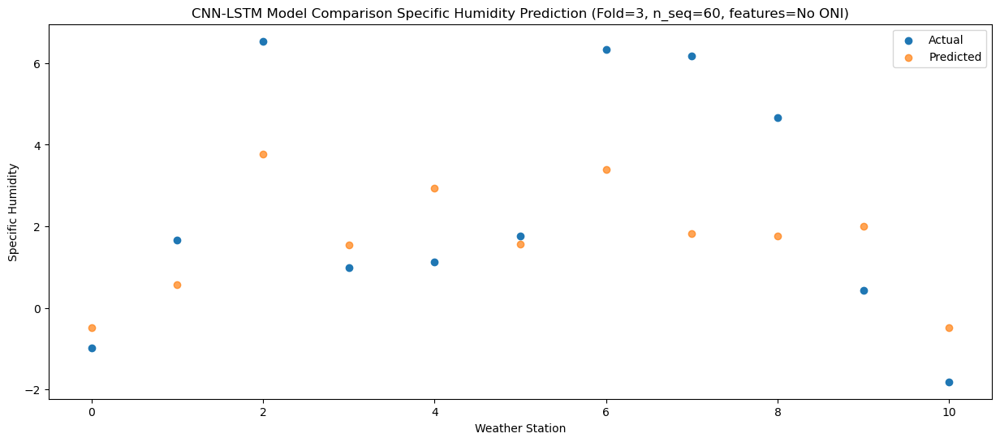

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17  -0.365145
1                 1    1.81   0.674856
2                 2    7.91   3.874855
3                 3    0.90   1.654853
4                 4    1.45   3.054853
5                 5    1.89   1.674853
6                 6    6.69   3.504855
7                 7    5.99   1.934855
8                 8    5.73   1.874858
9                 9    0.93   2.124855
10               10   -1.38  -0.365144


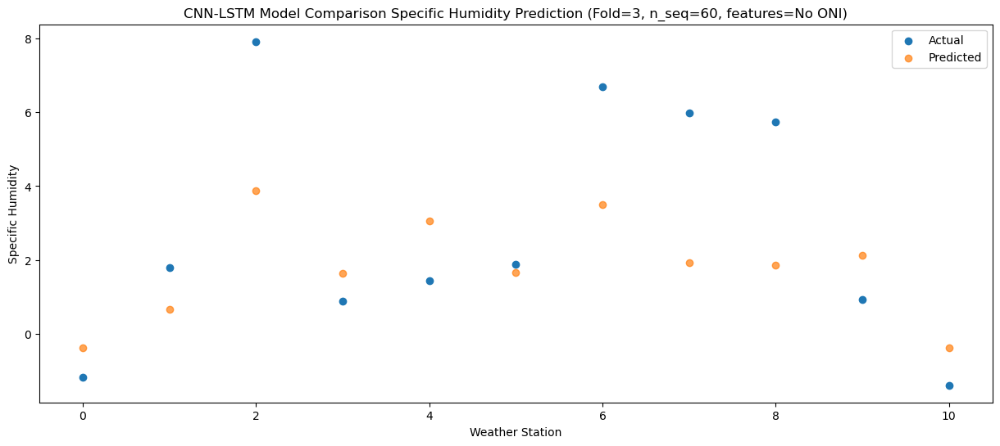

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   2.622888
1                 1    4.78   3.662890
2                 2    7.72   6.862889
3                 3    4.33   4.642887
4                 4    5.15   6.042887
5                 5    5.10   4.662886
6                 6    7.82   6.492889
7                 7    5.29   4.922889
8                 8    6.59   4.862892
9                 9    3.16   5.112890
10               10    1.15   2.622891


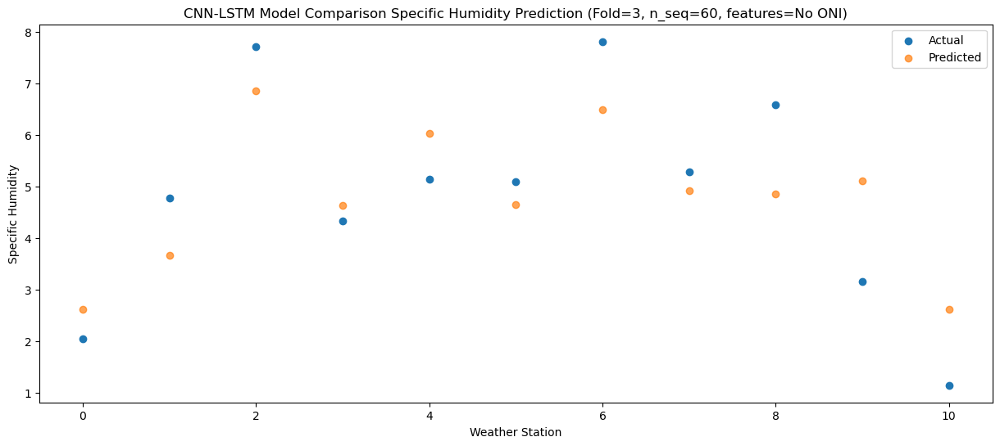

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   5.811188
1                 1    8.31   6.851190
2                 2    9.26  10.051189
3                 3    7.57   7.831187
4                 4    8.24   9.231186
5                 5    7.83   7.851185
6                 6    8.88   9.681189
7                 7    5.62   8.111189
8                 8    6.81   8.051191
9                 9    7.27   8.301190
10               10    4.72   5.811191


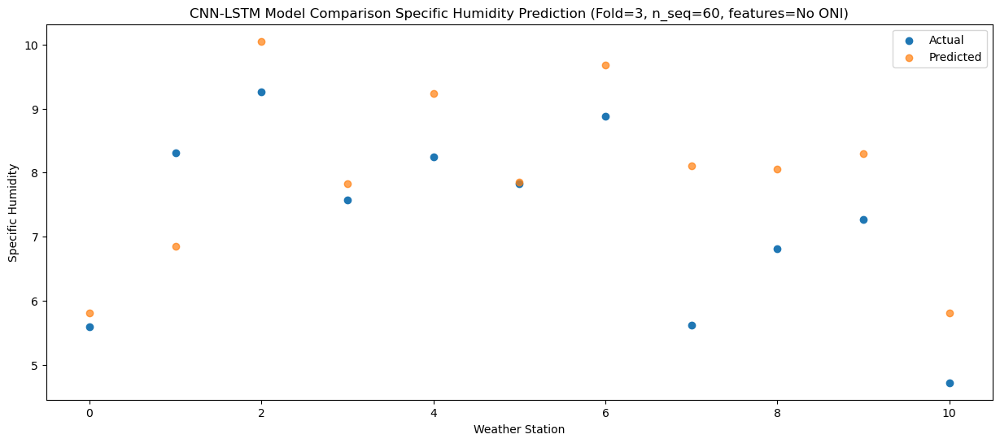

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   8.575583
1                 1   11.05   9.615585
2                 2    9.48  12.815583
3                 3   10.67  10.595582
4                 4   12.19  11.995580
5                 5   10.99  10.615580
6                 6   10.40  12.445583
7                 7    6.10  10.875582
8                 8    7.28  10.815585
9                 9   11.25  11.065584
10               10    8.07   8.575585


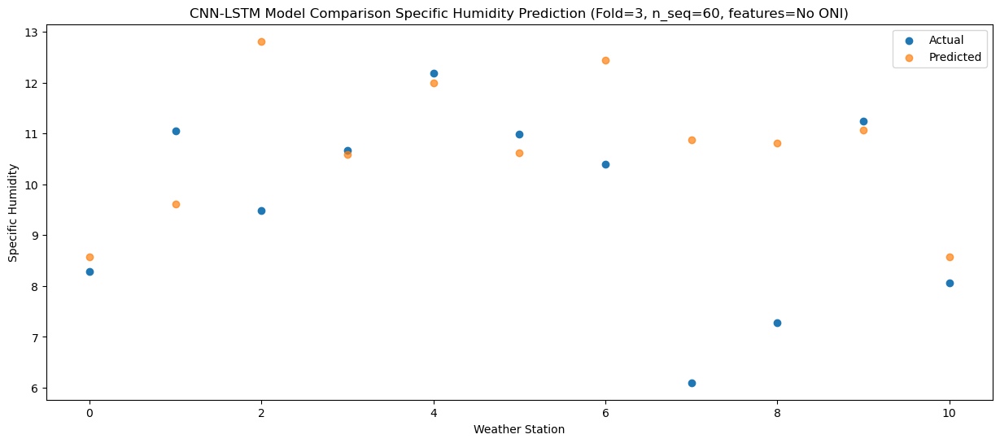

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   7.642720
1                 1    8.38   8.682722
2                 2   11.00  11.882720
3                 3    9.59   9.662719
4                 4    9.81  11.062717
5                 5    9.77   9.682717
6                 6    9.19  11.512721
7                 7    6.97   9.942720
8                 8    8.08   9.882722
9                 9   10.18  10.132721
10               10    7.43   7.642722


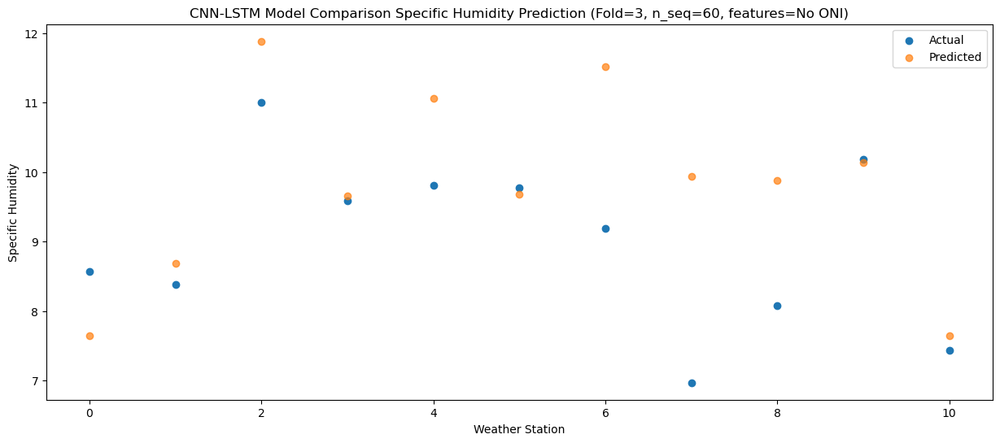

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   4.819011
1                 1    6.94   5.859013
2                 2   10.52   9.059012
3                 3    7.02   6.839011
4                 4    6.85   8.239008
5                 5    6.59   6.859008
6                 6    8.05   8.689013
7                 7    5.71   7.119011
8                 8    7.69   7.059014
9                 9    6.81   7.309012
10               10    4.14   4.819013


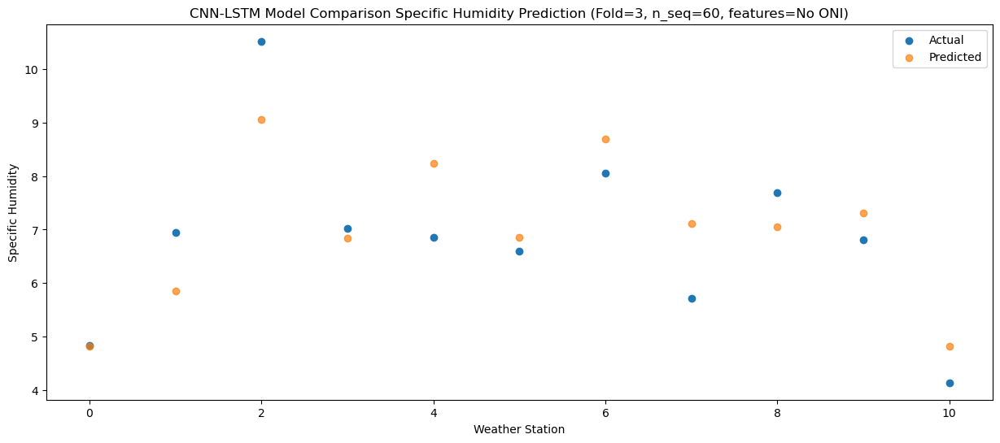

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25   1.627124
1                 1    2.37   2.667125
2                 2    8.64   5.867124
3                 3    3.33   3.647123
4                 4    2.13   5.047120
5                 5    3.17   3.667121
6                 6    6.40   5.497125
7                 7    4.70   3.927123
8                 8    5.49   3.867126
9                 9    4.28   4.117124
10               10    1.37   1.627124


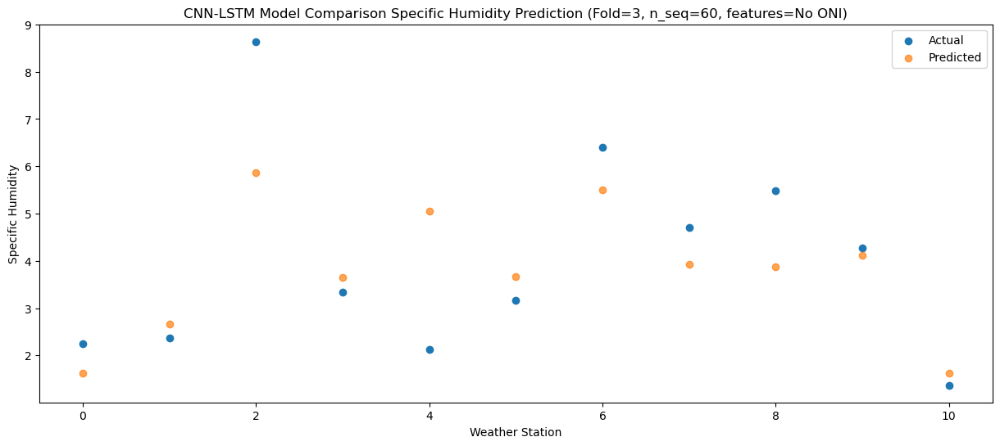

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -0.266482
1                 1    0.87   0.773519
2                 2    5.95   3.973520
3                 3    0.44   1.753518
4                 4    1.03   3.153515
5                 5    1.40   1.773516
6                 6    6.34   3.603521
7                 7    4.68   2.033518
8                 8    4.33   1.973522
9                 9    2.12   2.223518
10               10   -0.96  -0.266482


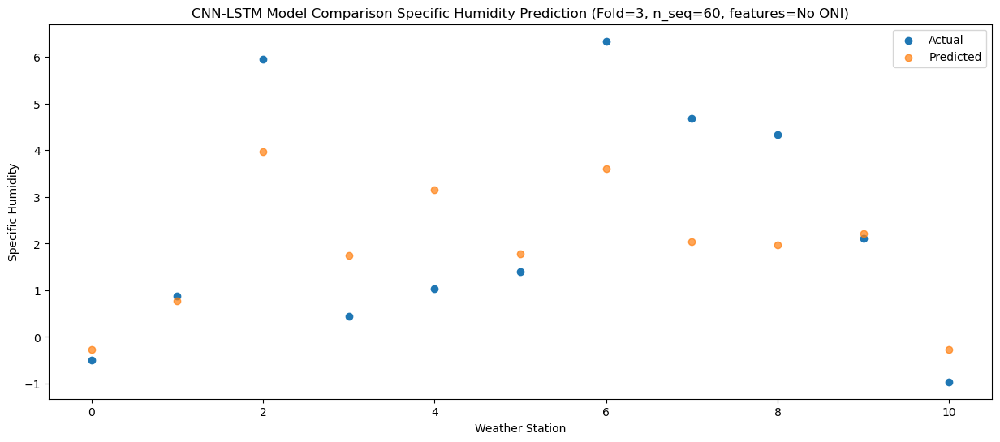

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -2.268720
1                 1   -1.17  -1.228719
2                 2    5.35   1.971281
3                 3   -1.17  -0.248721
4                 4   -0.90   1.151276
5                 5   -0.26  -0.228724
6                 6    5.53   1.601282
7                 7    3.85   0.031279
8                 8    3.99  -0.028716
9                 9    0.16   0.221279
10               10   -2.81  -2.268720


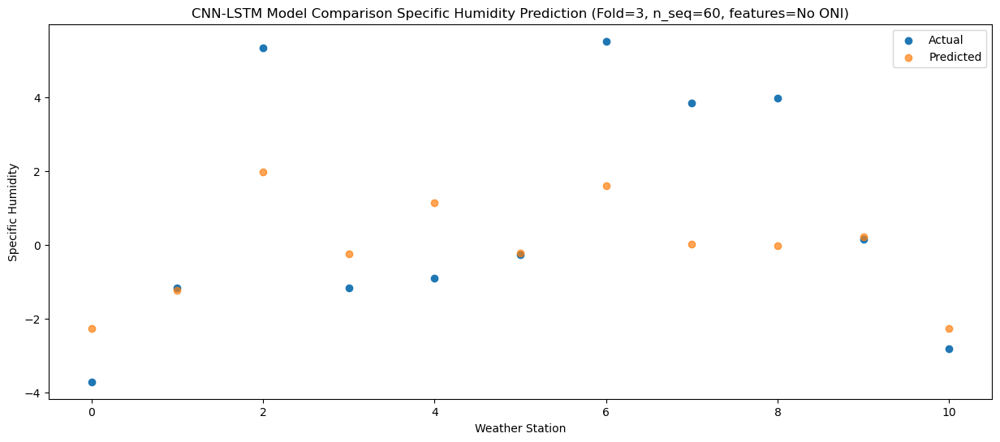

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -2.619264
1                 1   -1.26  -1.579263
2                 2    5.79   1.620734
3                 3   -1.44  -0.599265
4                 4   -1.10   0.800731
5                 5   -0.57  -0.579268
6                 6    5.70   1.250736
7                 7    4.66  -0.319267
8                 8    4.66  -0.379262
9                 9   -0.93  -0.129266
10               10   -3.50  -2.619265


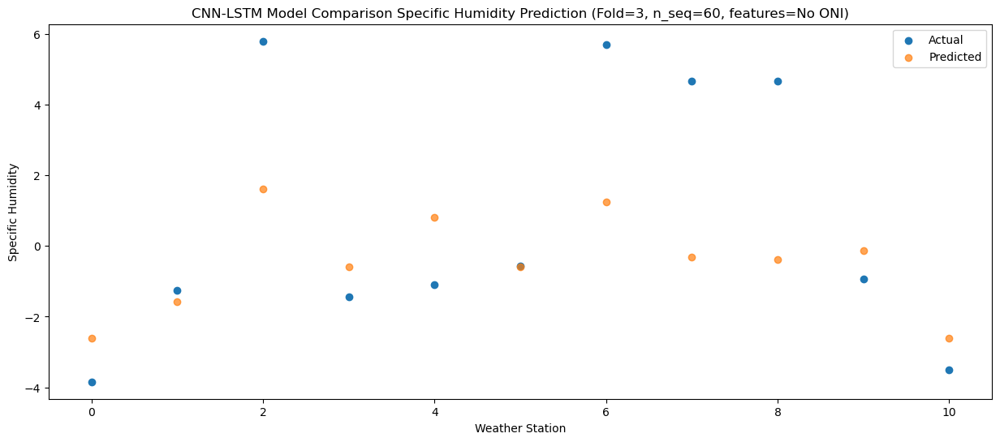

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -2.988734
1                 1   -1.82  -1.948732
2                 2    5.73   1.251263
3                 3   -1.51  -0.968734
4                 4   -1.93   0.431262
5                 5   -1.09  -0.948737
6                 6    5.76   0.881265
7                 7    4.18  -0.688738
8                 8    4.31  -0.748734
9                 9   -0.78  -0.498737
10               10   -3.64  -2.988736


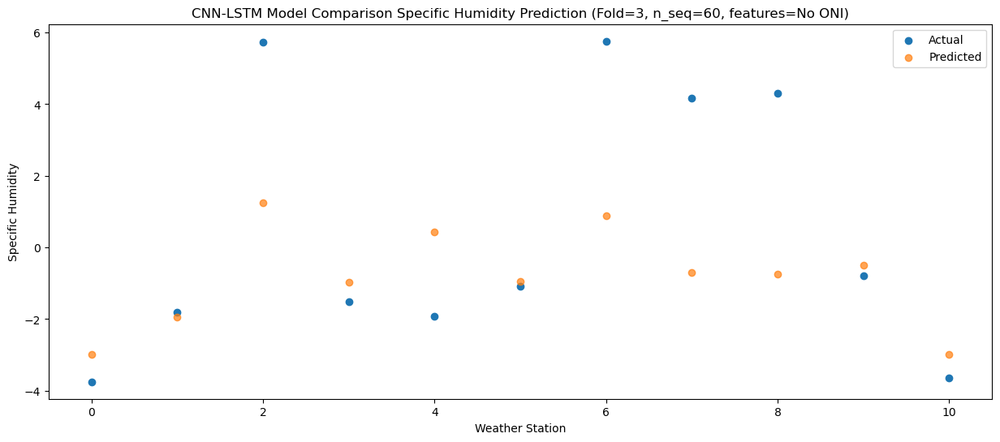

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -1.190856
1                 1  6.900000e-01  -0.150854
2                 2  5.810000e+00   3.049138
3                 3 -2.100000e-01   0.829144
4                 4  5.500000e-01   2.229139
5                 5  9.400000e-01   0.849141
6                 6  6.070000e+00   2.679142
7                 7  4.480000e+00   1.109137
8                 8  3.960000e+00   1.049143
9                 9  2.220446e-16   1.299140
10               10 -2.360000e+00  -1.190858


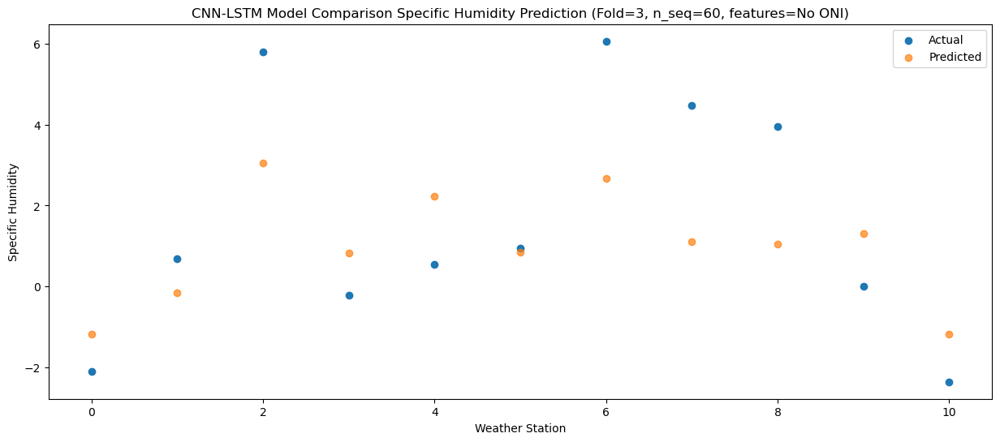

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58  -0.070169
1                 1    1.86   0.969832
2                 2    6.43   4.169826
3                 3    0.98   1.949830
4                 4    1.61   3.349826
5                 5    2.24   1.969829
6                 6    6.54   3.799829
7                 7    4.17   2.229824
8                 8    4.89   2.169830
9                 9    1.38   2.419827
10               10   -0.95  -0.070172


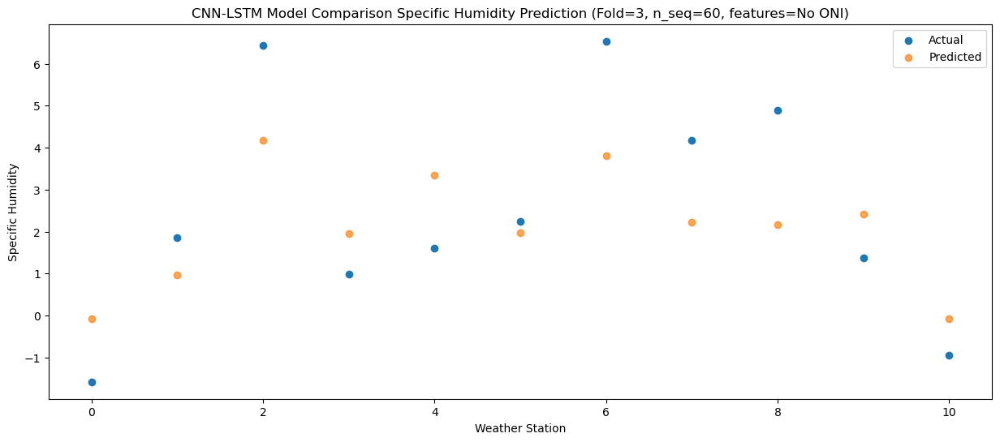

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20   2.290352
1                 1    5.38   3.330353
2                 2    6.83   6.530347
3                 3    3.51   4.310352
4                 4    4.03   5.710346
5                 5    4.48   4.330350
6                 6    7.94   6.160350
7                 7    4.73   4.590345
8                 8    5.33   4.530351
9                 9    2.95   4.780348
10               10    0.64   2.290350


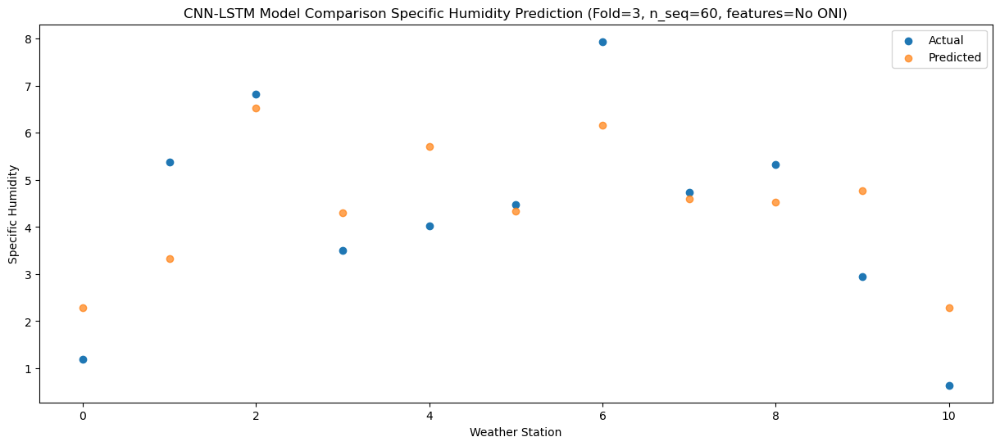

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   6.712663
1                 1    9.91   7.752661
2                 2    9.28  10.952656
3                 3    8.93   8.732662
4                 4    8.49  10.132653
5                 5    9.70   8.752659
6                 6    9.27  10.582659
7                 7    6.15   9.012654
8                 8    6.76   8.952660
9                 9    7.85   9.202659
10               10    5.51   6.712658


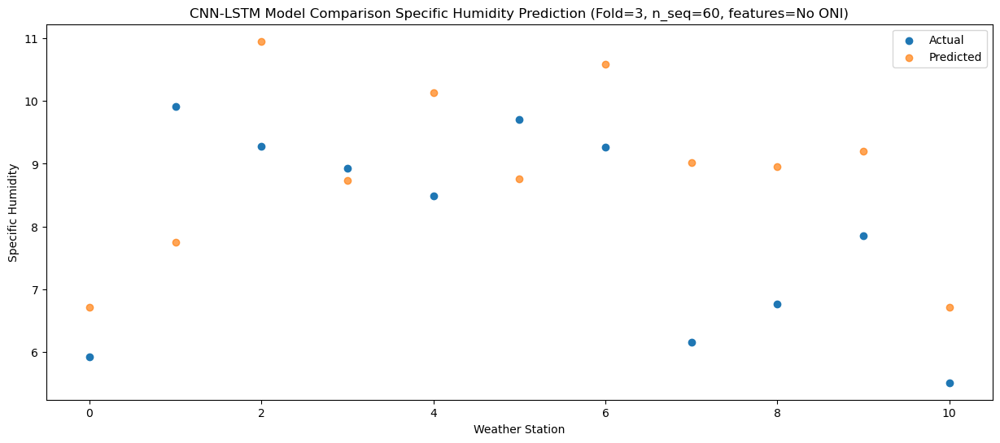

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   8.066635
1                 1   10.79   9.106632
2                 2    9.98  12.306627
3                 3    9.56  10.086634
4                 4   10.44  11.486625
5                 5   10.95  10.106630
6                 6   11.72  11.936631
7                 7   11.51  10.366626
8                 8    7.24  10.306632
9                 9   10.06  10.556630
10               10    7.20   8.066630


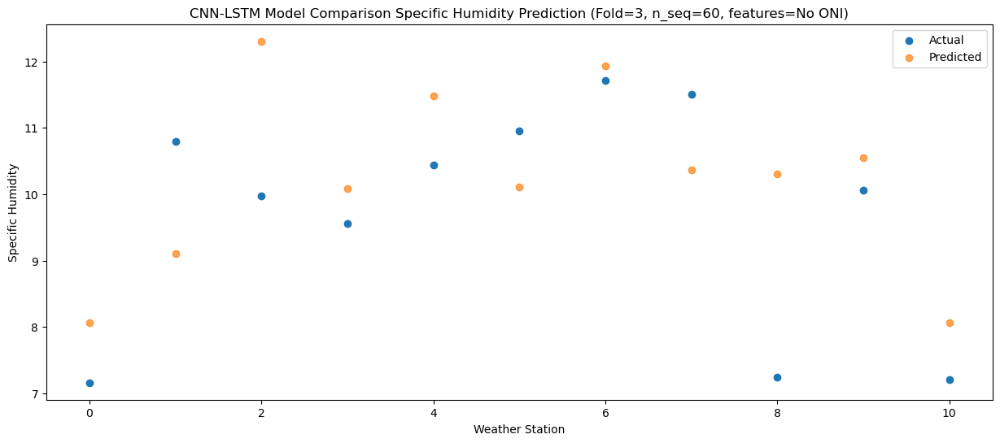

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43   8.179042
1                 1   10.96   9.219038
2                 2    9.51  12.419033
3                 3   10.44  10.199041
4                 4   10.53  11.599031
5                 5   11.12  10.219036
6                 6   10.29  12.049037
7                 7    9.08  10.479031
8                 8    7.63  10.419038
9                 9   10.44  10.669036
10               10    7.52   8.179036


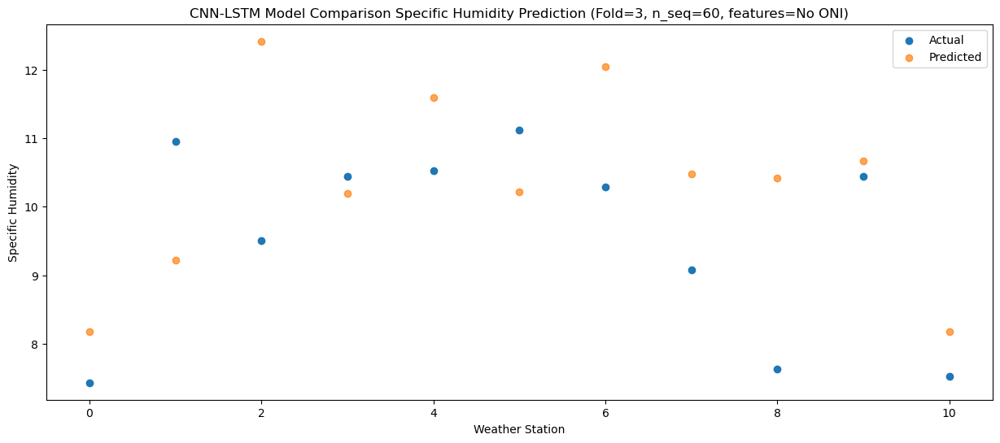

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   4.652782
1                 1    6.99   5.692778
2                 2    8.22   8.892773
3                 3    6.97   6.672781
4                 4    6.76   8.072771
5                 5    7.82   6.692776
6                 6    8.59   8.522778
7                 7    7.36   6.952772
8                 8    6.99   6.892777
9                 9    7.84   7.142777
10               10    4.60   4.652776


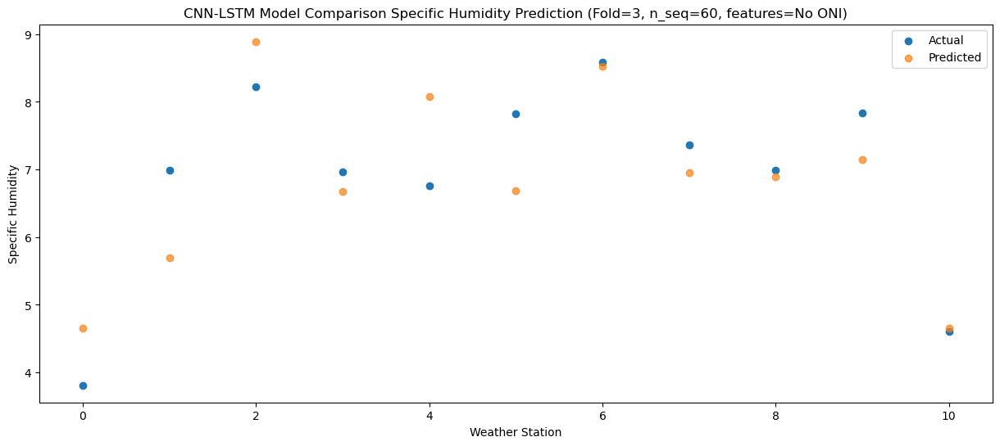

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77   2.751458
1                 1    4.80   3.791454
2                 2    7.08   6.991449
3                 3    4.91   4.771458
4                 4    4.81   6.171448
5                 5    6.20   4.791452
6                 6    7.50   6.621453
7                 7    6.26   5.051447
8                 8    5.96   4.991453
9                 9    5.30   5.241452
10               10    2.70   2.751452


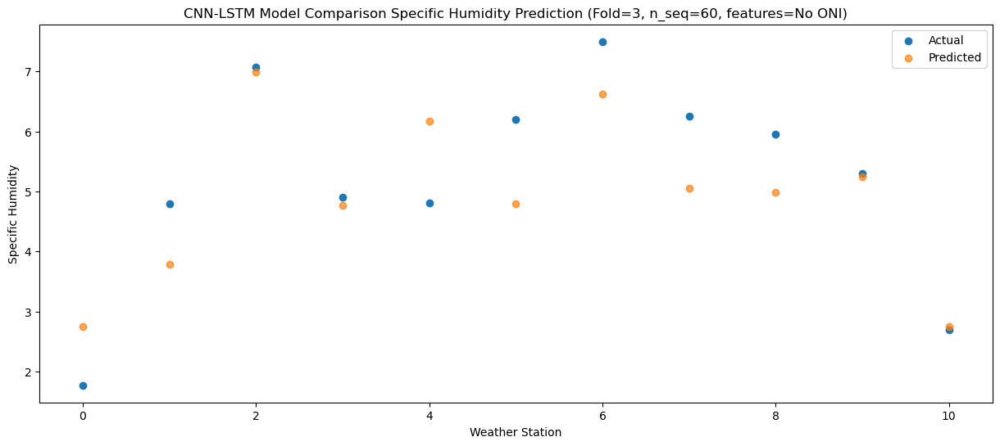

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73  -2.052581
1                 1    0.37  -1.012585
2                 2    7.66   2.187410
3                 3   -0.78  -0.032581
4                 4   -0.31   1.367409
5                 5    0.33  -0.012587
6                 6    6.79   1.817415
7                 7    4.99   0.247408
8                 8    6.18   0.187415
9                 9    0.77   0.437415
10               10   -2.22  -2.052586


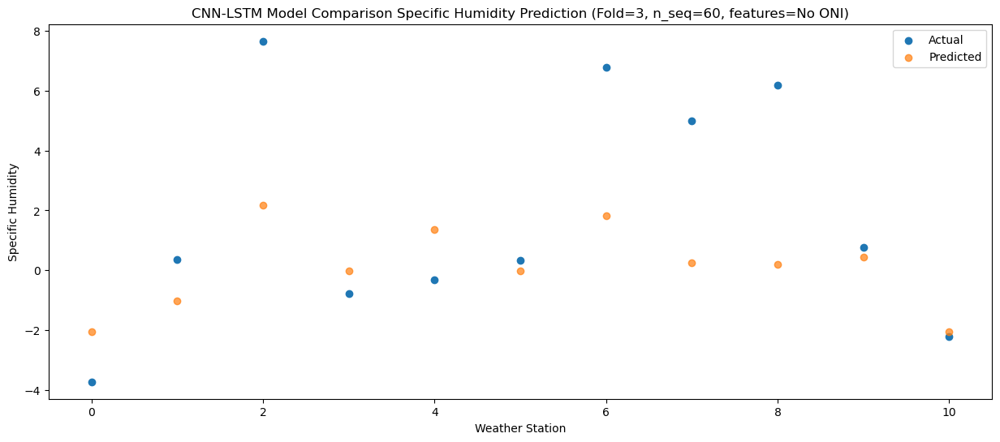

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.305568
1                 1    1.34  -0.265572
2                 2    6.16   2.934423
3                 3    0.36   0.714433
4                 4    0.39   2.114422
5                 5    1.38   0.734428
6                 6    6.08   2.564428
7                 7    5.13   0.994421
8                 8    4.93   0.934428
9                 9    0.47   1.184427
10               10   -2.32  -1.305573


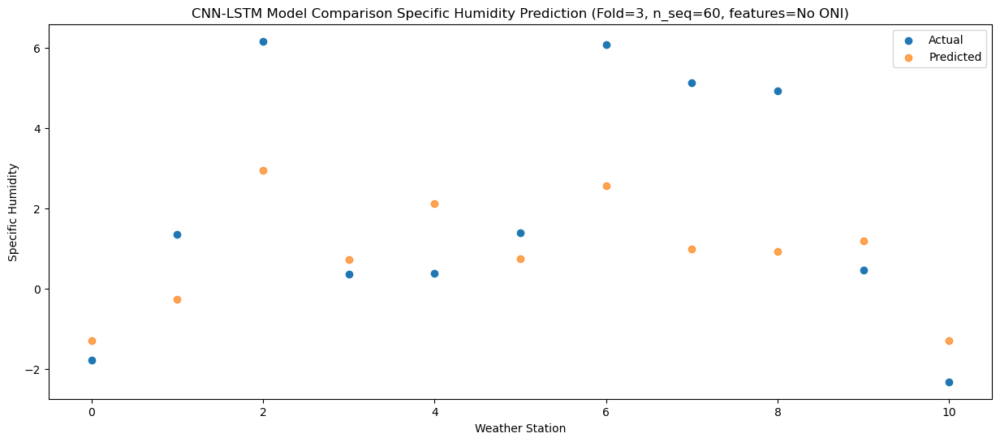

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -3.763810
1                 1   -1.85  -2.723813
2                 2    5.88   0.476181
3                 3   -1.96  -1.743808
4                 4   -2.07  -0.343819
5                 5   -1.13  -1.723813
6                 6    5.60   0.106187
7                 7    4.14  -1.463820
8                 8    4.60  -1.523814
9                 9   -1.01  -1.273814
10               10   -3.83  -3.763814


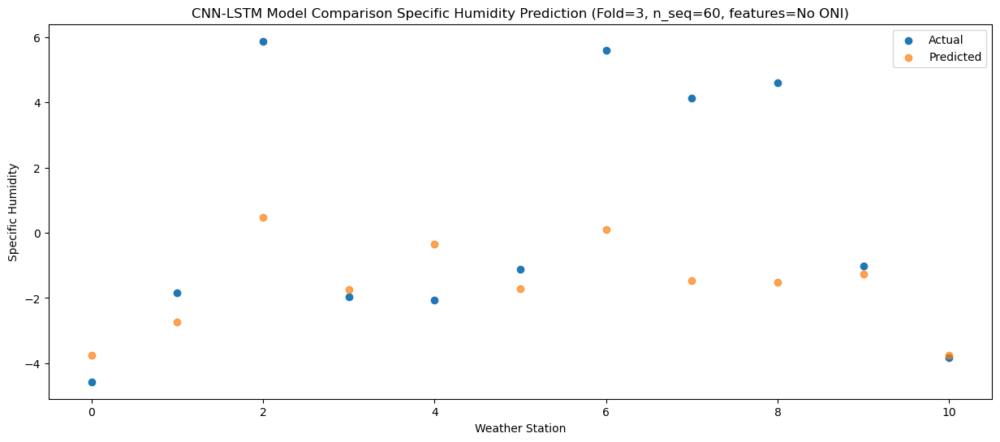

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21  -2.990294
1                 1   -1.48  -1.950297
2                 2    5.10   1.249696
3                 3   -1.44  -0.970293
4                 4   -1.45   0.429696
5                 5   -0.60  -0.950297
6                 6    5.39   0.879703
7                 7    3.71  -0.690305
8                 8    3.76  -0.750298
9                 9   -0.42  -0.500298
10               10   -3.13  -2.990299


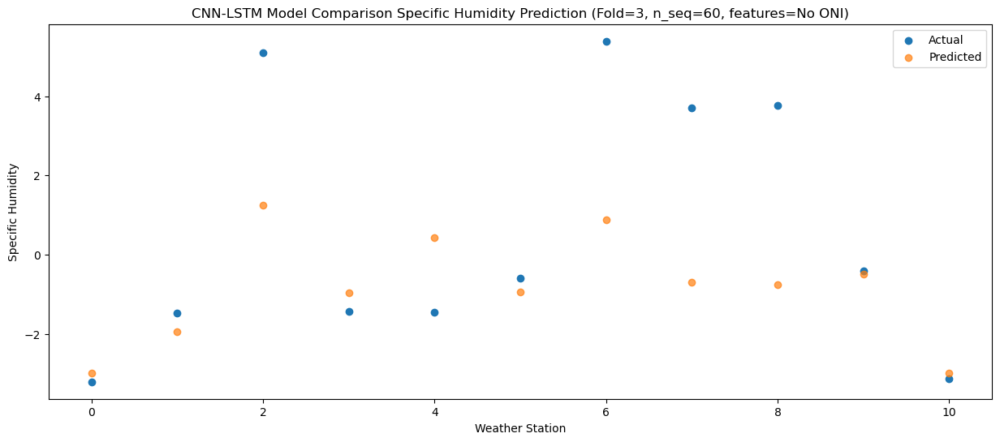

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -1.944689
1                 1   -0.01  -0.904692
2                 2    6.44   2.295303
3                 3   -0.46   0.075312
4                 4    0.12   1.475301
5                 5    0.71   0.095309
6                 6    6.07   1.925309
7                 7    4.33   0.355302
8                 8    4.76   0.295310
9                 9    0.42   0.545308
10               10   -2.19  -1.944694


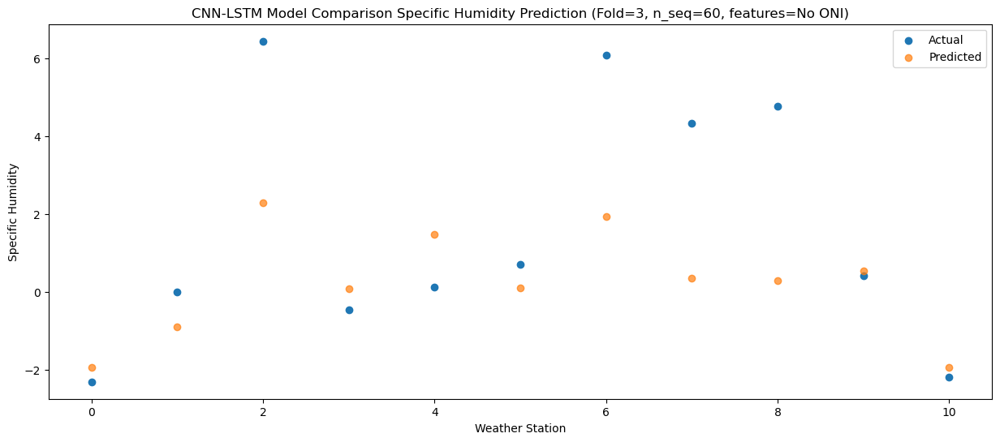

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28  -0.785805
1                 1    2.29   0.254191
2                 2    6.11   3.454186
3                 3    0.81   1.234195
4                 4    1.68   2.634184
5                 5    2.24   1.254192
6                 6    6.57   3.084193
7                 7    4.33   1.514188
8                 8    4.86   1.454193
9                 9    1.07   1.704192
10               10   -1.55  -0.785810


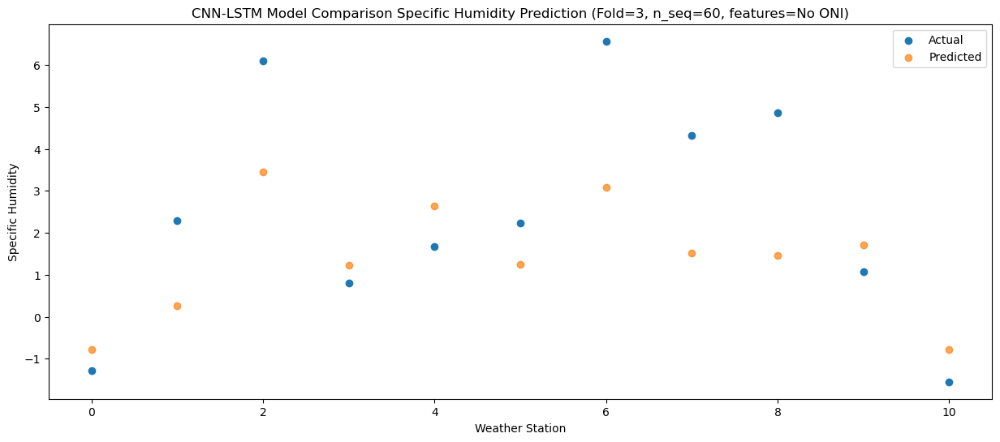

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03   3.229338
1                 1    6.74   4.269334
2                 2    6.29   7.469329
3                 3    5.23   5.249338
4                 4    5.77   6.649327
5                 5    6.47   5.269335
6                 6    7.38   7.099336
7                 7    4.59   5.529329
8                 8    5.23   5.469336
9                 9    4.46   5.719335
10               10    2.63   3.229333


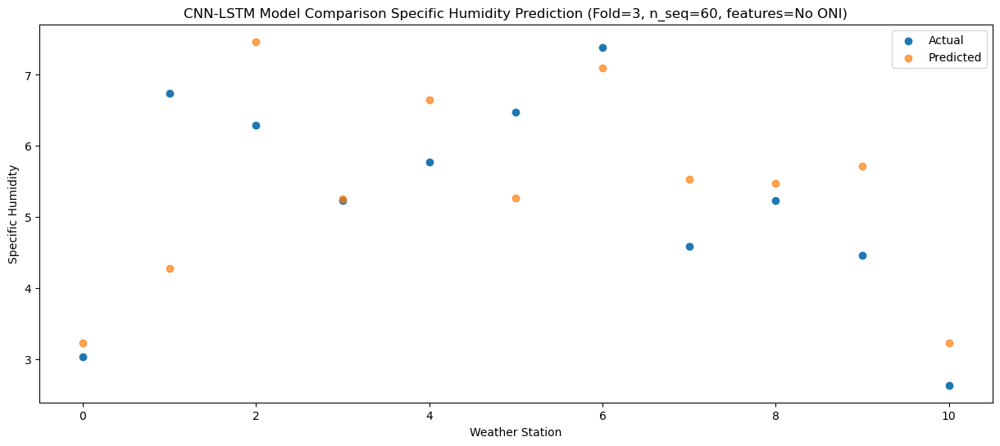

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33   4.941549
1                 1    9.36   5.981545
2                 2    7.46   9.181539
3                 3    7.49   6.961547
4                 4    7.87   8.361537
5                 5    8.54   6.981546
6                 6    9.32   8.811546
7                 7    6.35   7.241538
8                 8    6.72   7.181545
9                 9    6.80   7.431546
10               10    4.03   4.941544


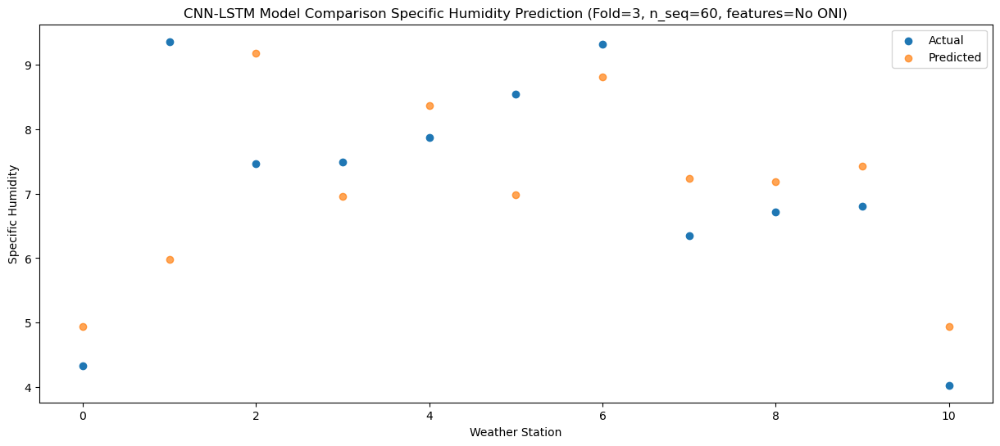

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40   7.070915
1                 1    9.57   8.110911
2                 2    8.63  11.310905
3                 3   10.53   9.090913
4                 4   10.46  10.490903
5                 5   11.32   9.110911
6                 6   12.31  10.940912
7                 7    9.78   9.370904
8                 8    7.55   9.310911
9                 9    9.96   9.560912
10               10    7.01   7.070909


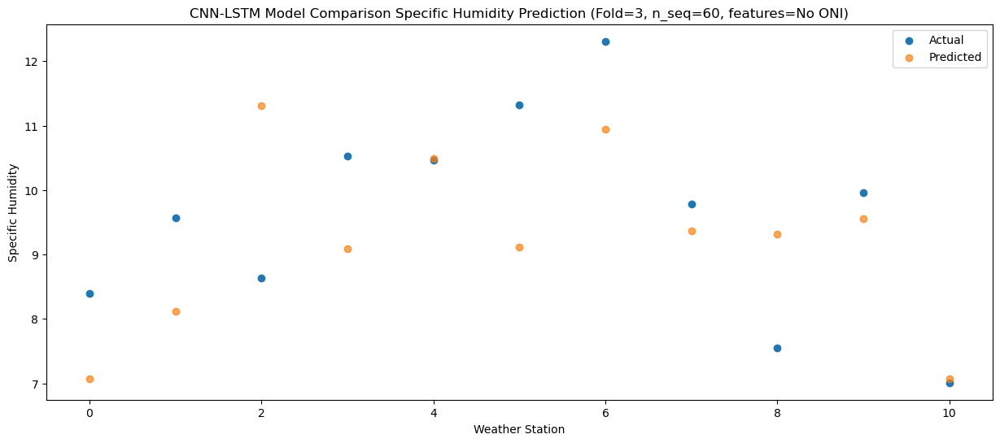

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   6.634527
1                 1   10.18   7.674524
2                 2    9.42  10.874518
3                 3    9.40   8.654526
4                 4    9.96  10.054516
5                 5   10.12   8.674524
6                 6   12.15  10.504524
7                 7   12.85   8.934517
8                 8    8.01   8.874524
9                 9   10.10   9.124524
10               10    6.64   6.634522


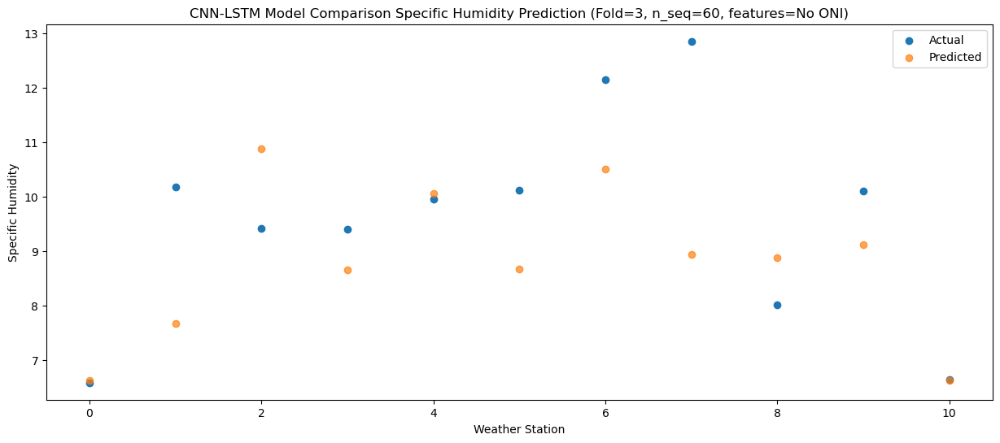

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   3.588754
1                 1    6.33   4.628751
2                 2    9.13   7.828744
3                 3    6.15   5.608753
4                 4    6.86   7.008743
5                 5    7.35   5.628751
6                 6    9.20   7.458751
7                 7    8.94   5.888744
8                 8    7.41   5.828750
9                 9    6.43   6.078751
10               10    3.62   3.588748


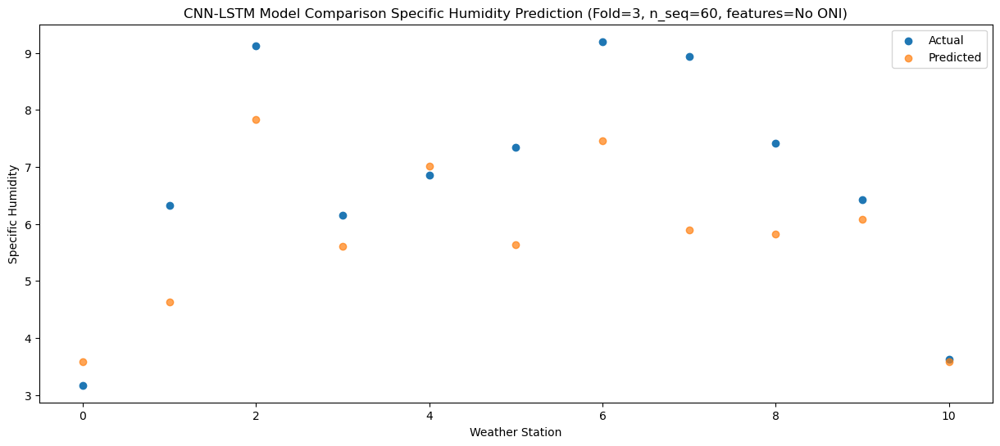

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -0.912572
1                 1    1.87   0.127425
2                 2    7.96   3.327417
3                 3    1.00   1.107427
4                 4    1.86   2.507417
5                 5    2.05   1.127425
6                 6    7.59   2.957426
7                 7    6.21   1.387418
8                 8    6.10   1.327423
9                 9    3.80   1.577425
10               10    0.20  -0.912578


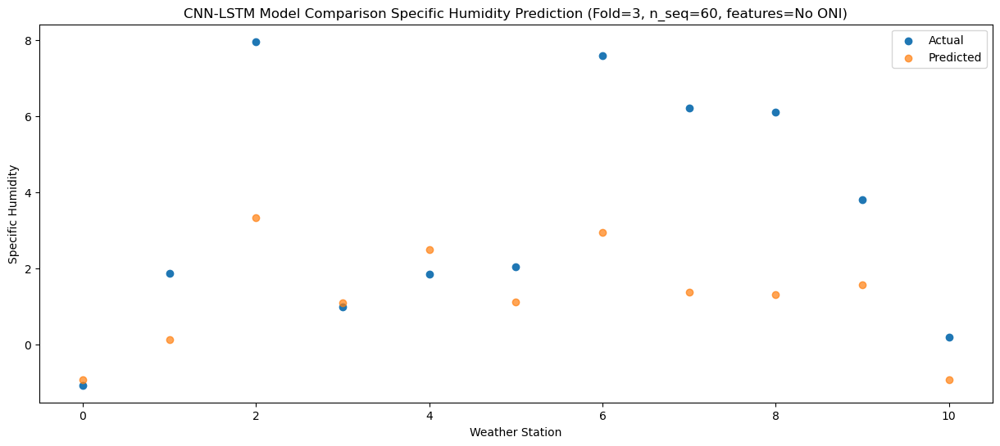

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -1.938058
1                 1    0.84  -0.898060
2                 2    5.24   2.301932
3                 3    0.19   0.081940
4                 4    0.47   1.481931
5                 5    0.83   0.101938
6                 6    5.93   1.931939
7                 7    4.44   0.361931
8                 8    3.85   0.301937
9                 9    1.95   0.551939
10               10   -1.02  -1.938065


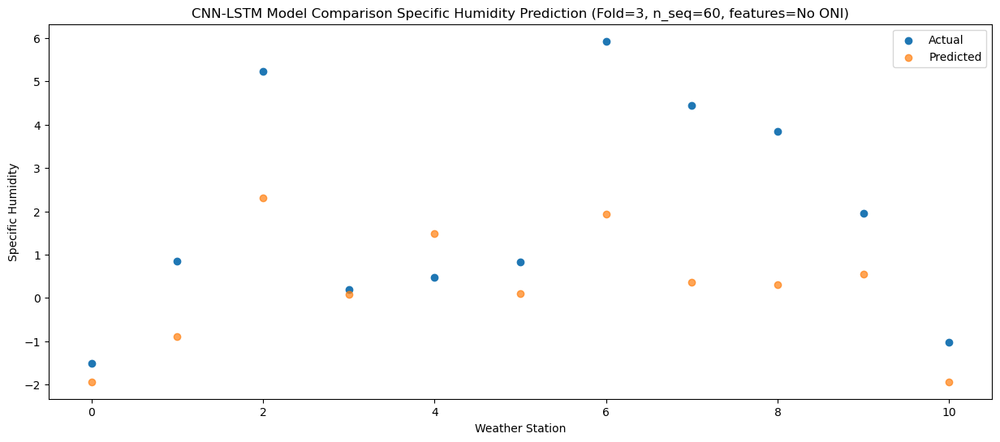

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -3.465642
1                 1   -0.35  -2.425643
2                 2    6.08   0.774348
3                 3   -0.84  -1.445643
4                 4   -0.65  -0.045652
5                 5    0.07  -1.425644
6                 6    5.96   0.404356
7                 7    5.19  -1.165652
8                 8    4.64  -1.225647
9                 9   -0.02  -0.975645
10               10   -2.94  -3.465648


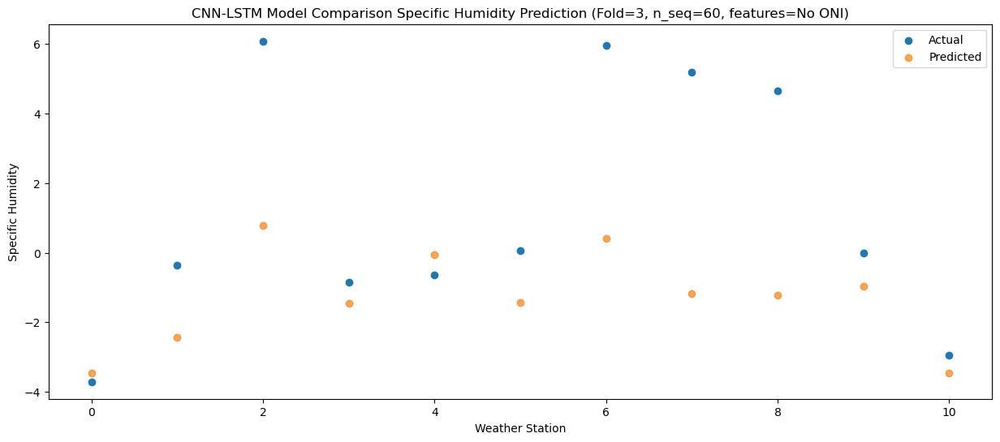

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80  -2.863458
1                 1   -0.43  -1.823458
2                 2    6.23   1.376533
3                 3   -0.30  -0.843458
4                 4   -0.27   0.556532
5                 5    0.65  -0.823460
6                 6    5.93   1.006540
7                 7    5.58  -0.563467
8                 8    4.47  -0.623462
9                 9    0.55  -0.373460
10               10   -2.16  -2.863463


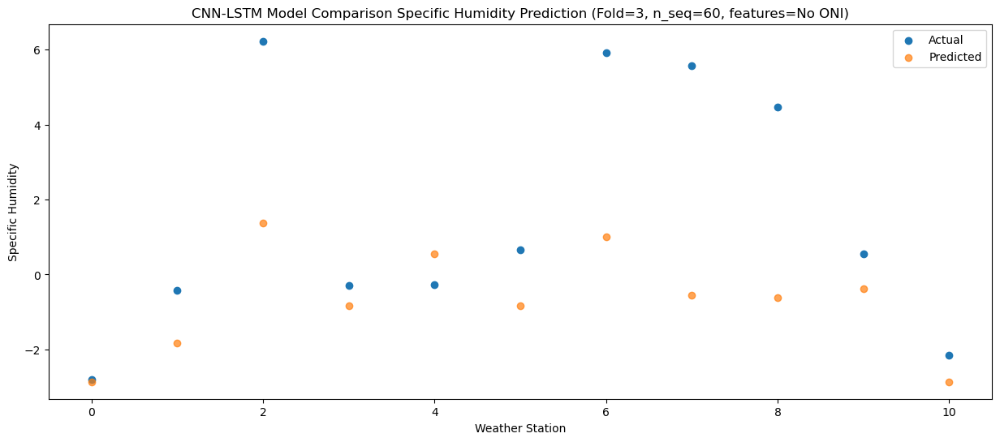

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -3.005943
1                 1   -0.27  -1.965942
2                 2    5.10   1.234049
3                 3   -0.48  -0.985943
4                 4    0.61   0.414047
5                 5    0.32  -0.965944
6                 6    5.55   0.864055
7                 7    4.33  -0.705951
8                 8    3.61  -0.765946
9                 9   -0.16  -0.515945
10               10   -2.91  -3.005948


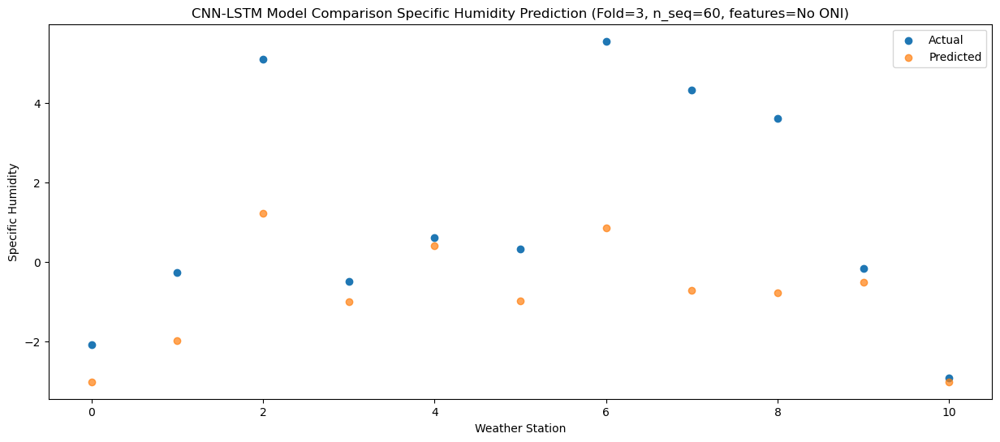

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -2.888513
1                 1    0.67  -1.848510
2                 2    6.62   1.351481
3                 3   -0.61  -0.868511
4                 4    0.28   0.531480
5                 5    0.75  -0.848513
6                 6    5.85   0.981487
7                 7    5.37  -0.588520
8                 8    4.41  -0.648514
9                 9    0.05  -0.398513
10               10   -2.78  -2.888517


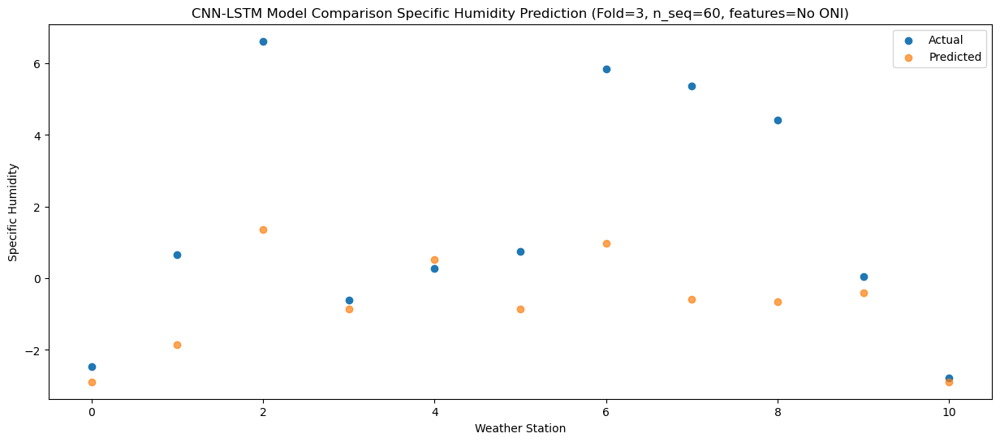

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47  -1.225230
1                 1    1.54  -0.185226
2                 2    6.82   3.014765
3                 3    0.93   0.794773
4                 4    1.51   2.194763
5                 5    2.06   0.814770
6                 6    6.48   2.644771
7                 7    4.52   1.074764
8                 8    4.79   1.014769
9                 9    2.29   1.264769
10               10   -0.35  -1.225234


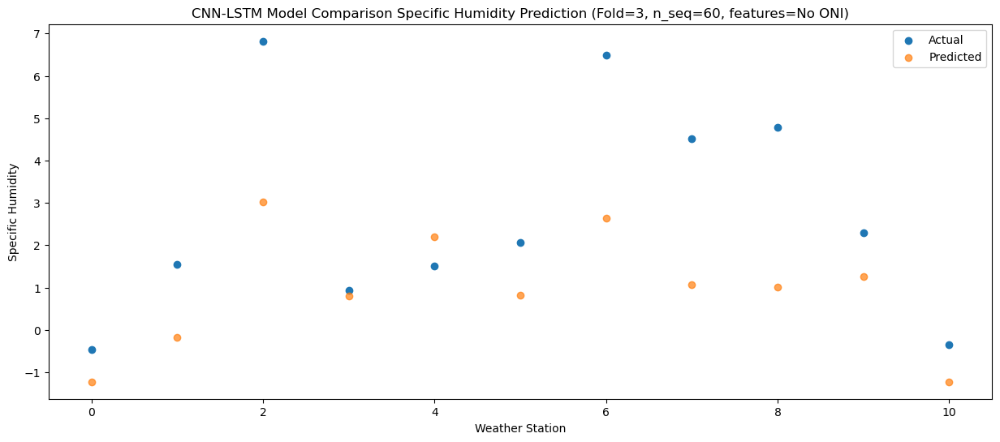

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98   1.100504
1                 1    5.95   2.140508
2                 2    7.76   5.340497
3                 3    3.84   3.120506
4                 4    4.69   4.520496
5                 5    4.66   3.140503
6                 6    8.64   4.970504
7                 7    6.06   3.400497
8                 8    6.38   3.340501
9                 9    2.81   3.590502
10               10    0.12   1.100499


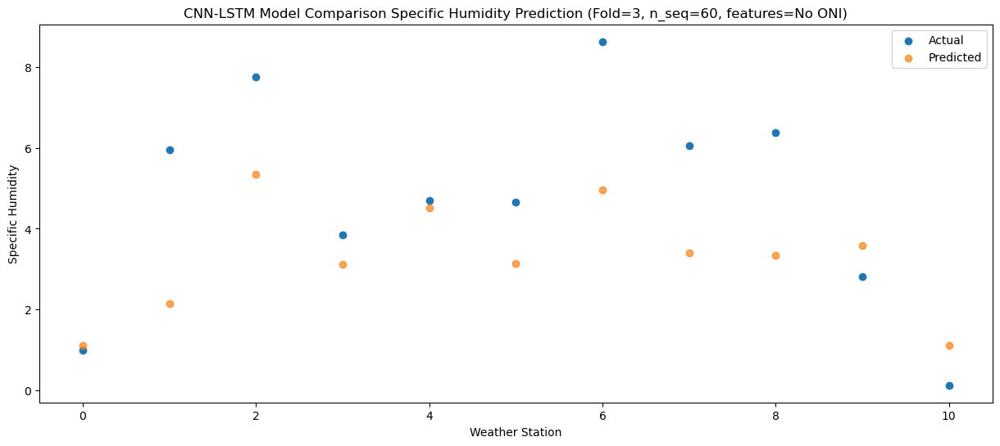

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   3.853709
1                 1    8.59   4.893711
2                 2    8.53   8.093702
3                 3    5.86   5.873710
4                 4    6.82   7.273700
5                 5    6.82   5.893706
6                 6    8.87   7.723709
7                 7    6.56   6.153702
8                 8    6.44   6.093705
9                 9    6.51   6.343707
10               10    3.81   3.853704


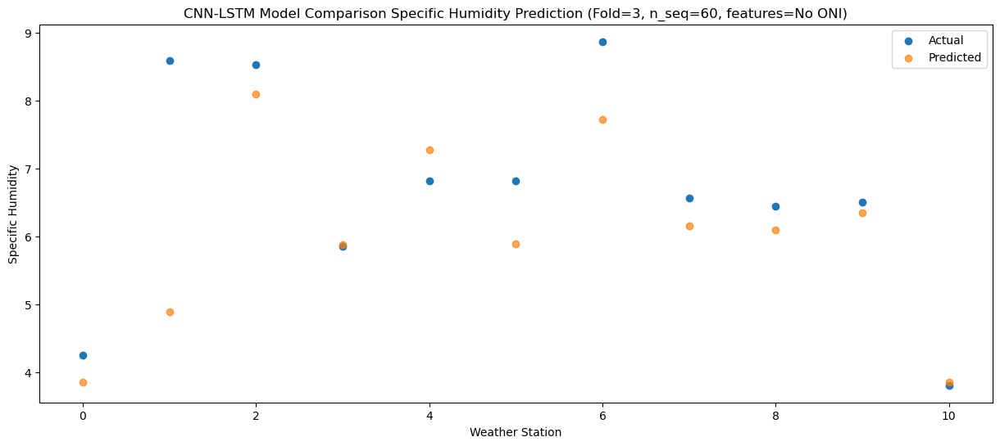

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   6.881468
1                 1   10.86   7.921470
2                 2    9.63  11.121462
3                 3    9.51   8.901470
4                 4   10.59  10.301458
5                 5   11.33   8.921466
6                 6    9.71  10.751467
7                 7    7.53   9.181461
8                 8    7.28   9.121464
9                 9   11.36   9.371467
10               10    7.79   6.881464


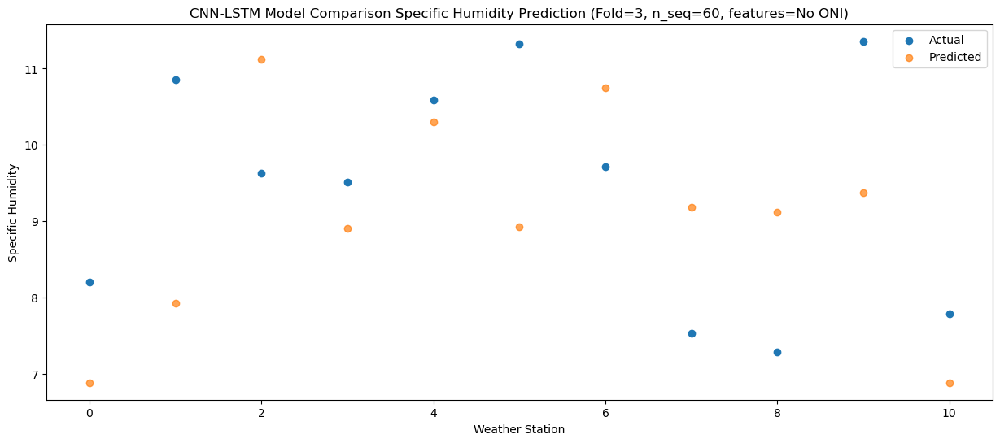

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   6.298217
1                 1   11.10   7.338219
2                 2   10.70  10.538211
3                 3    8.96   8.318219
4                 4   10.98   9.718207
5                 5   10.45   8.338214
6                 6   11.36  10.168215
7                 7   10.11   8.598209
8                 8    8.55   8.538214
9                 9    8.79   8.788216
10               10    6.55   6.298213


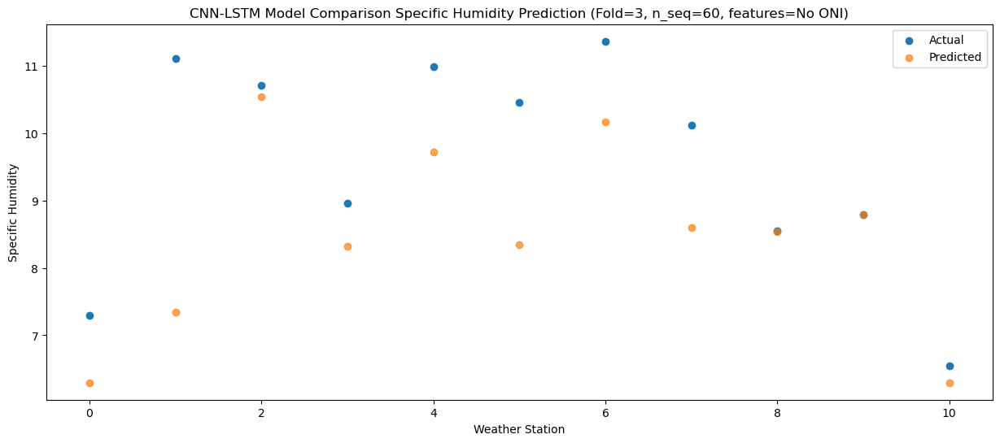

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   3.580257
1                 1    7.03   4.620260
2                 2    9.16   7.820252
3                 3    6.49   5.600260
4                 4    6.87   7.000249
5                 5    7.22   5.620255
6                 6    8.74   7.450256
7                 7    9.17   5.880251
8                 8    8.00   5.820256
9                 9    7.82   6.070258
10               10    4.86   3.580254


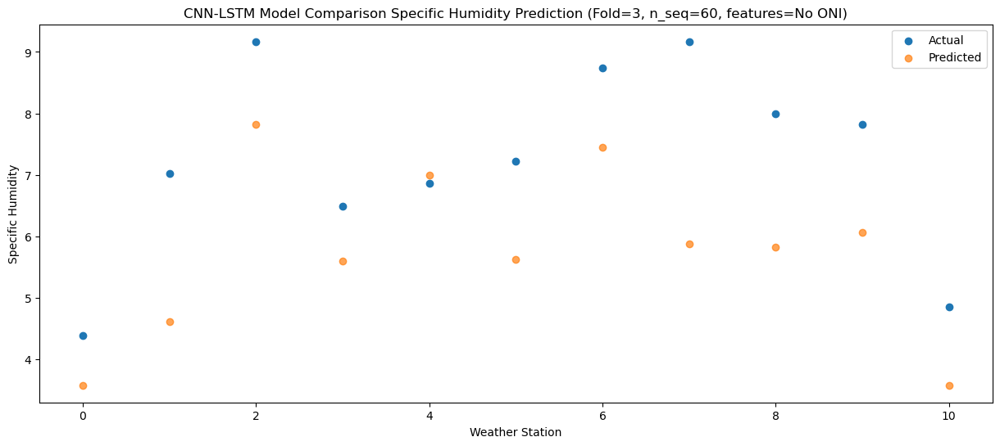

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28   0.184266
1                 1    3.59   1.224269
2                 2    8.00   4.424261
3                 3    2.96   2.204269
4                 4    3.25   3.604258
5                 5    3.84   2.224264
6                 6    7.49   4.054265
7                 7    6.11   2.484260
8                 8    6.57   2.424264
9                 9    4.43   2.674267
10               10    1.59   0.184263


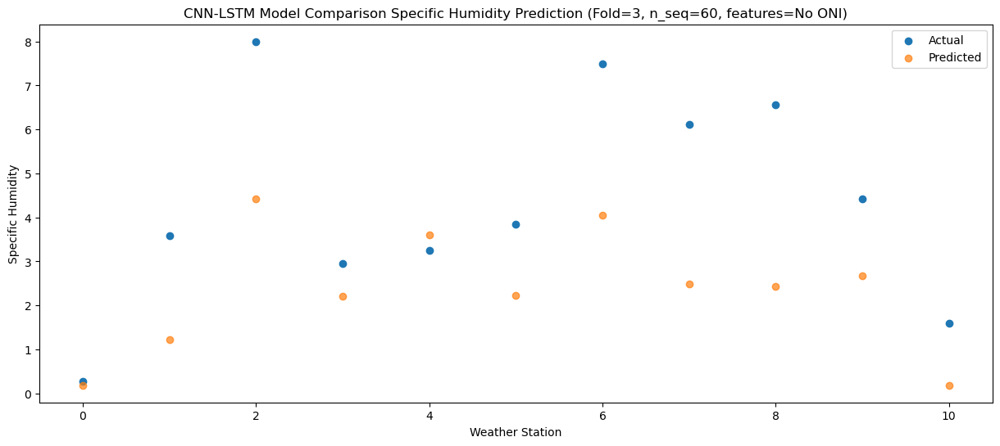

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -3.192166
1                 1    0.71  -2.152163
2                 2    5.89   1.047830
3                 3   -0.43  -1.172163
4                 4    0.08   0.227825
5                 5    0.65  -1.152168
6                 6    6.16   0.677833
7                 7    5.10  -0.892172
8                 8    5.48  -0.952168
9                 9    0.63  -0.702166
10               10   -2.09  -3.192169


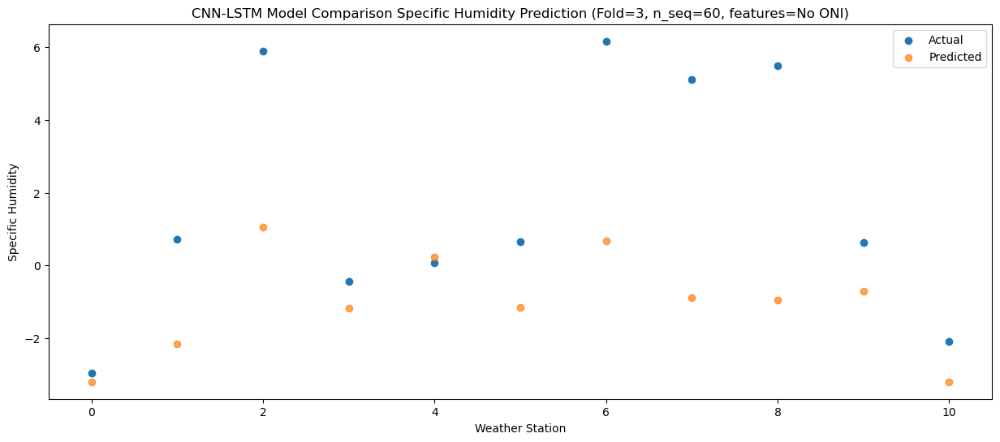

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -3.457459
1                 1   -0.11  -2.417456
2                 2    6.12   0.782538
3                 3   -0.41  -1.437456
4                 4   -0.33  -0.037468
5                 5    0.61  -1.417461
6                 6    6.03   0.412539
7                 7    5.02  -1.157465
8                 8    5.86  -1.217461
9                 9    0.96  -0.967459
10               10   -1.71  -3.457462


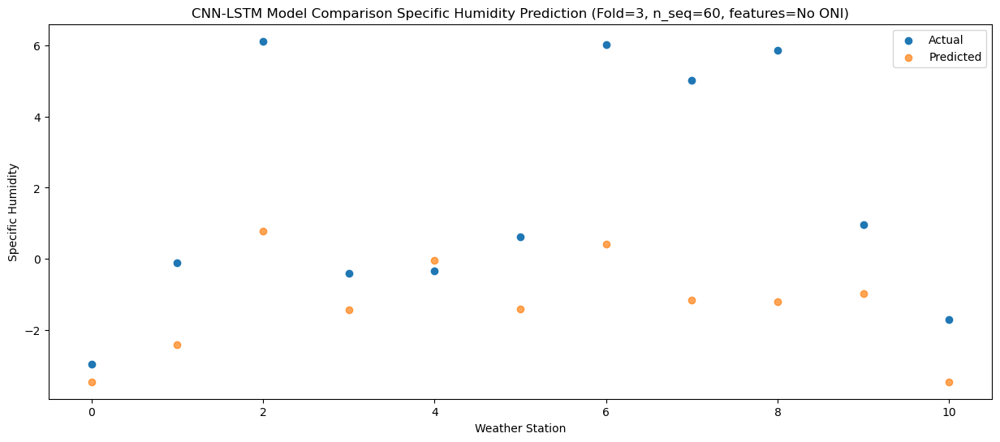

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -4.640590
1                 1   -1.42  -3.600589
2                 2    6.66  -0.400594
3                 3   -1.15  -2.620588
4                 4   -1.20  -1.220599
5                 5   -0.27  -2.600593
6                 6    5.97  -0.770593
7                 7    5.56  -2.340596
8                 8    5.87  -2.400591
9                 9   -0.34  -2.150589
10               10   -2.84  -4.640593


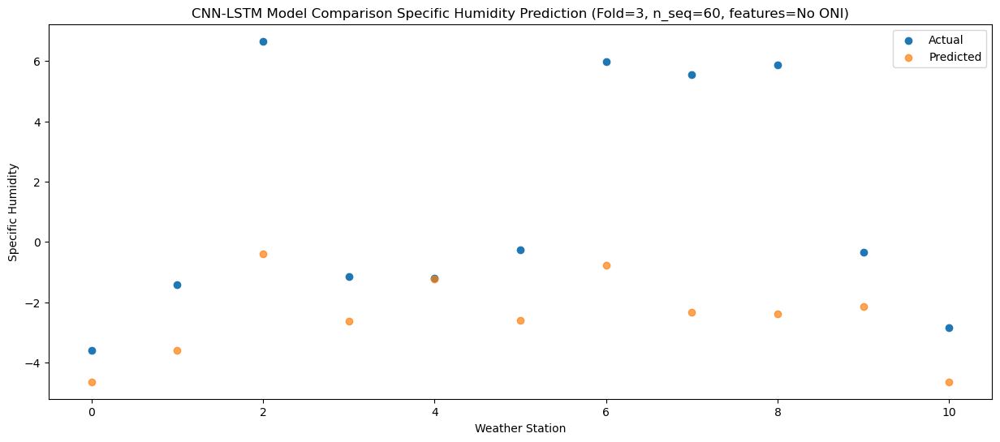

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -4.108046
1                 1 -3.552714e-15  -3.068044
2                 2  6.830000e+00   0.131948
3                 3 -8.300000e-01  -2.088043
4                 4 -2.900000e-01  -0.688054
5                 5  3.100000e-01  -2.068050
6                 6  6.040000e+00  -0.238049
7                 7  6.380000e+00  -1.808052
8                 8  5.560000e+00  -1.868049
9                 9 -4.400000e-01  -1.618045
10               10 -2.930000e+00  -4.108048


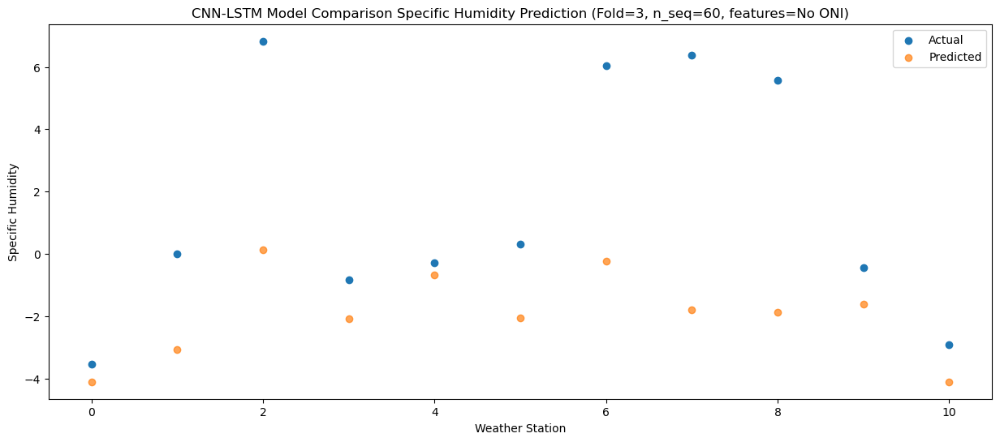

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05  -3.181412
1                 1    1.42  -2.141409
2                 2    6.54   1.058582
3                 3    0.13  -1.161408
4                 4    0.75   0.238581
5                 5    1.39  -1.141416
6                 6    6.40   0.688585
7                 7    5.70  -0.881418
8                 8    5.36  -0.941415
9                 9    0.61  -0.691411
10               10   -1.88  -3.181414


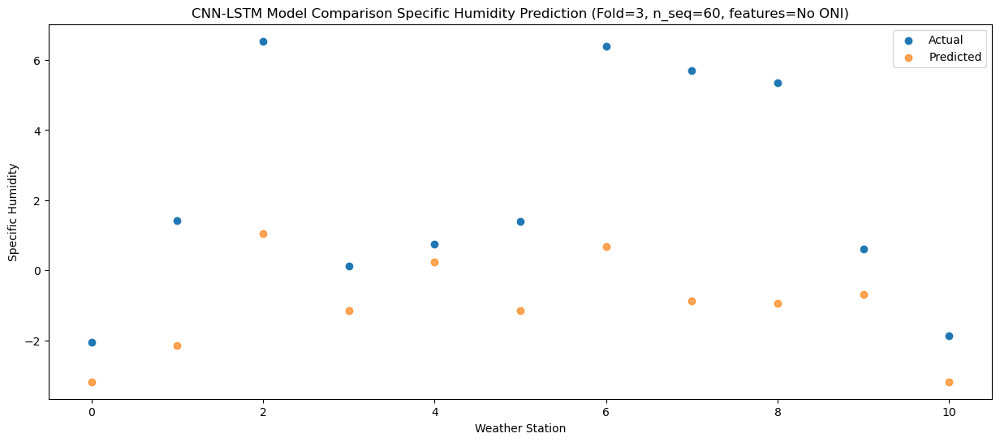

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01  -1.518206
1                 1    2.96  -0.478204
2                 2    7.22   2.721787
3                 3    2.04   0.501797
4                 4    2.57   1.901786
5                 5    3.64   0.521789
6                 6    7.08   2.351791
7                 7    5.40   0.781787
8                 8    5.80   0.721791
9                 9    1.52   0.971795
10               10   -0.28  -1.518208


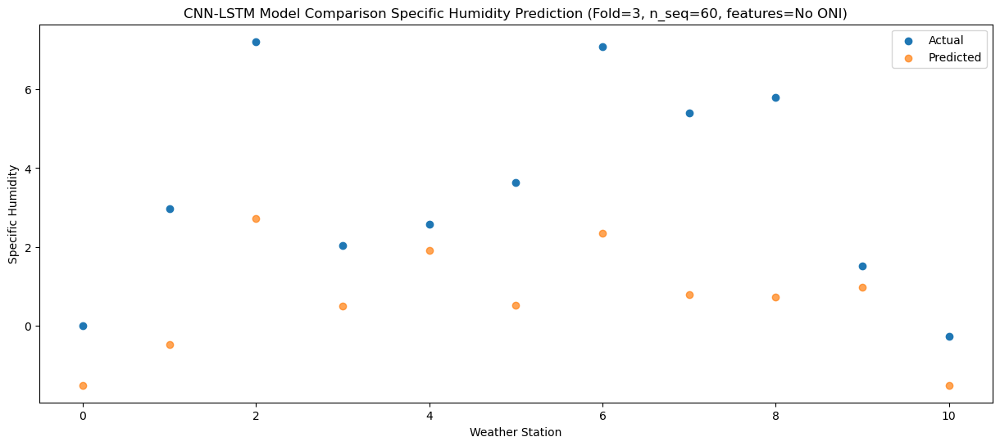

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86   1.868302
1                 1    7.46   2.908305
2                 2    7.09   6.108295
3                 3    6.15   3.888306
4                 4    6.71   5.288295
5                 5    7.31   3.908298
6                 6    7.97   5.738300
7                 7    5.27   4.168296
8                 8    5.96   4.108298
9                 9    4.98   4.358303
10               10    3.35   1.868300


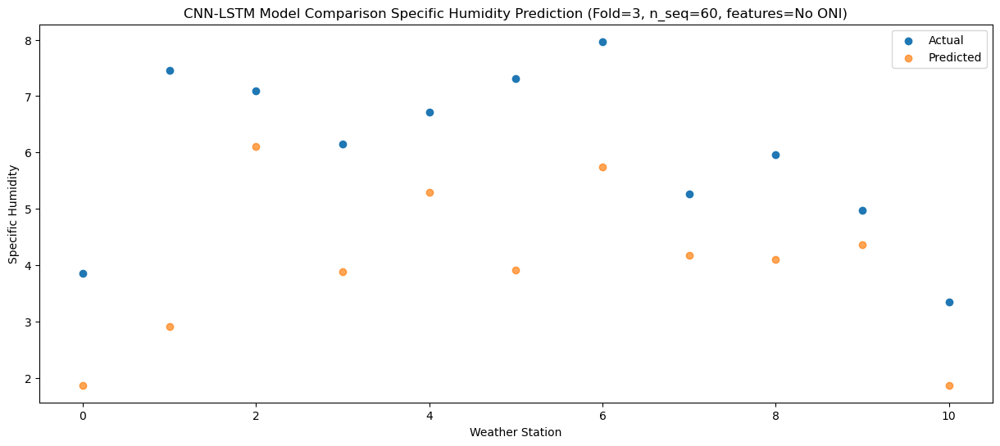

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59   4.156468
1                 1    9.74   5.196469
2                 2    8.36   8.396461
3                 3    7.95   6.176470
4                 4    8.68   7.576458
5                 5    9.13   6.196463
6                 6   10.26   8.026465
7                 7    6.67   6.456462
8                 8    7.11   6.396465
9                 9    7.85   6.646468
10               10    5.03   4.156465


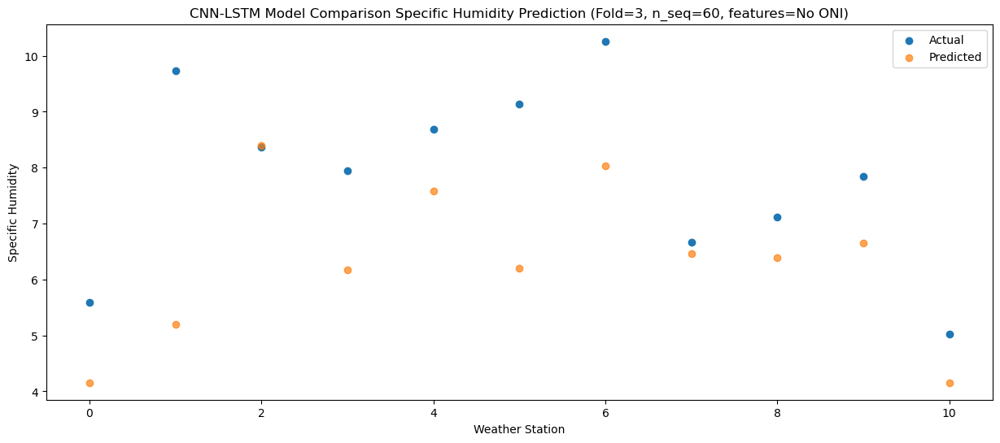

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45   5.768999
1                 1   10.23   6.809000
2                 2   10.34  10.008993
3                 3    8.85   7.789001
4                 4   10.25   9.188989
5                 5   10.32   7.808994
6                 6   10.31   9.638997
7                 7    7.70   8.068994
8                 8    8.69   8.008997
9                 9   11.02   8.258999
10               10    7.91   5.768996


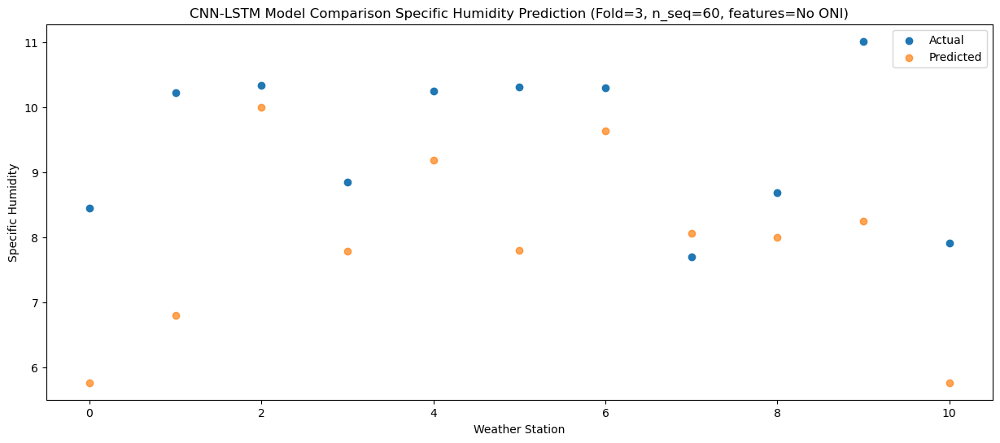

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01   4.971610
1                 1    9.49   6.011611
2                 2    8.65   9.211606
3                 3    7.53   6.991613
4                 4    9.77   8.391600
5                 5    9.76   7.011605
6                 6   11.77   8.841610
7                 7    8.52   7.271606
8                 8    7.96   7.211610
9                 9    9.67   7.461611
10               10    6.63   4.971608


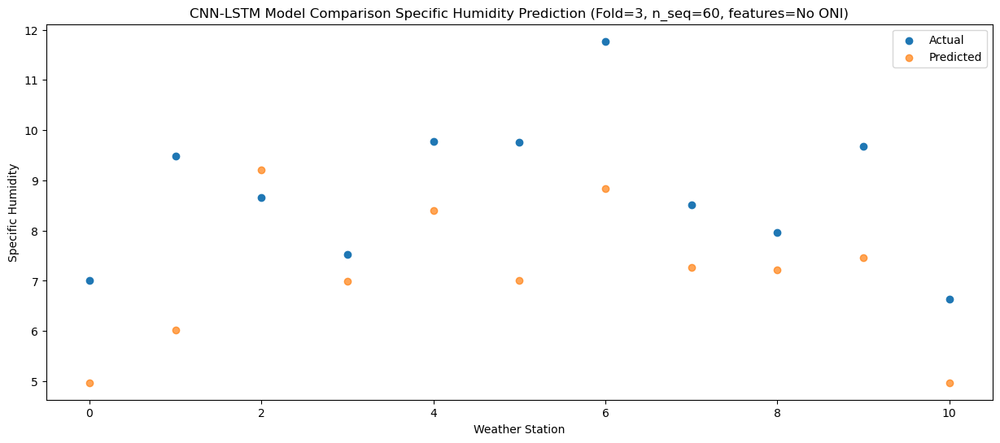

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30   2.368329
1                 1    6.50   3.408331
2                 2    8.92   6.608326
3                 3    5.99   4.388333
4                 4    6.76   5.788320
5                 5    7.14   4.408325
6                 6    9.35   6.238330
7                 7    6.80   4.668326
8                 8    7.64   4.608330
9                 9    6.31   4.858331
10               10    3.81   2.368327


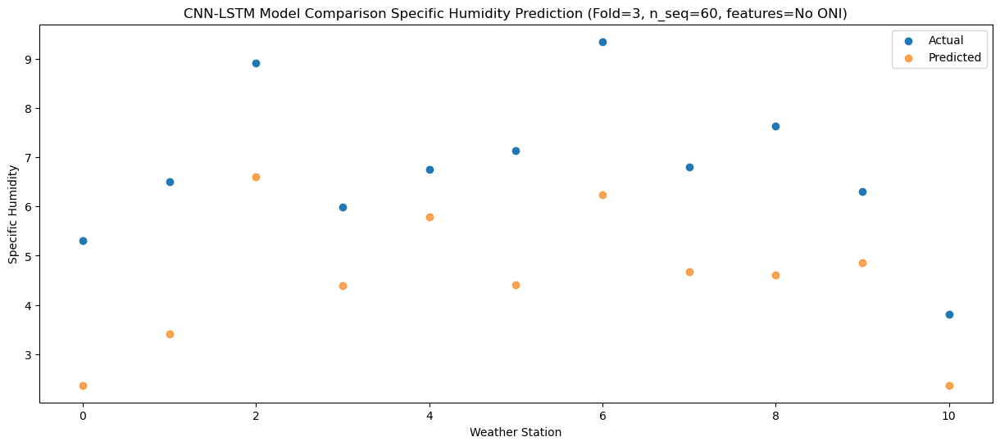

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48  -1.598387
1                 1    2.27  -0.558386
2                 2    7.81   2.641610
3                 3    2.24   0.421616
4                 4    2.40   1.821604
5                 5    3.27   0.441609
6                 6    7.59   2.271614
7                 7    5.75   0.701609
8                 8    6.05   0.641614
9                 9    3.21   0.891614
10               10   -0.19  -1.598390


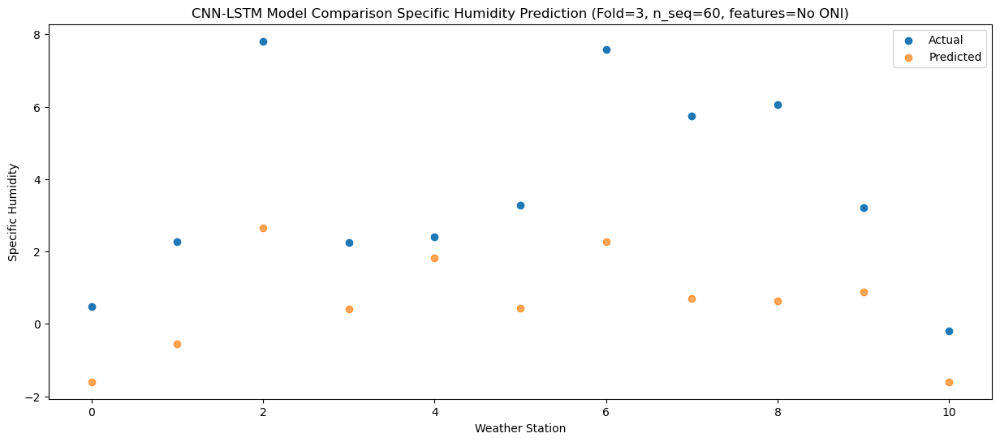

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_6 (LSTM)               (None, 1, 512)            2099200   
                                                                 
 dropout_10 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_7 (LSTM)               (None, 512)               2099200   
                                                      

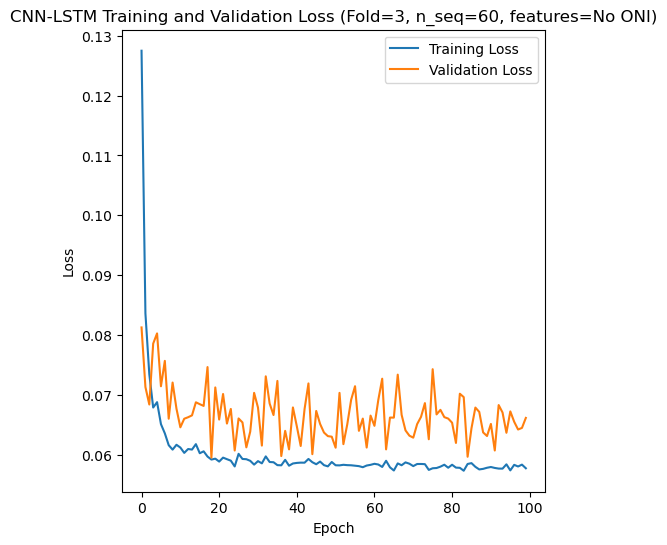

Epoch 1/100
84/84 [==============================] - 19s 78ms/step - loss: 0.1245 - accuracy: 0.2619 - mae: 0.1018 - rmse: 0.1245 - mape: 22.0063 - pearson: 0.5812 - val_loss: 0.0749 - val_accuracy: 0.0000e+00 - val_mae: 0.0586 - val_rmse: 0.0749 - val_mape: 12.9449 - val_pearson: 0.7068
Epoch 2/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0876 - accuracy: 0.3810 - mae: 0.0707 - rmse: 0.0876 - mape: 15.5955 - pearson: 0.7281 - val_loss: 0.0825 - val_accuracy: 0.0000e+00 - val_mae: 0.0667 - val_rmse: 0.0825 - val_mape: 14.1839 - val_pearson: 0.7563
Epoch 3/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0810 - accuracy: 0.2262 - mae: 0.0646 - rmse: 0.0810 - mape: 14.3669 - pearson: 0.7353 - val_loss: 0.0596 - val_accuracy: 0.7000 - val_mae: 0.0474 - val_rmse: 0.0596 - val_mape: 10.4820 - val_pearson: 0.8052
Epoch 4/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0692 - accuracy: 0.4048 - mae: 0.0552 - rmse: 0.0692 - mape: 12

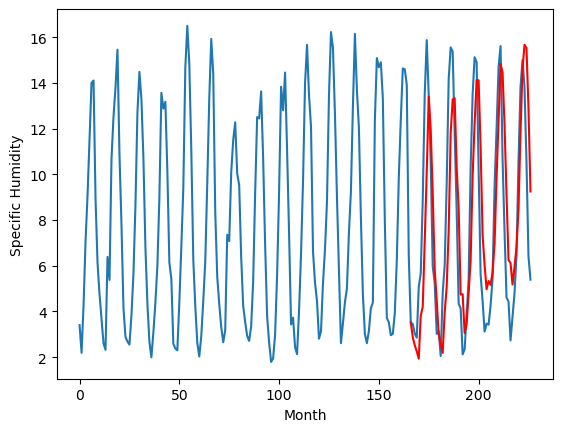

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		1.58		2.94
-1.22		1.22		2.44
-2.78		0.95		3.73
-1.94		0.63		2.57
-0.56		2.51		3.07
0.65		2.90		2.25
1.30		5.80		4.50
4.63		8.80		4.17
6.37		12.10		5.73
6.61		10.65		4.04
6.03		7.88		1.85
3.99		4.53		0.54
0.93		3.19		2.26
-3.81		1.68		5.49
-3.46		1.27		4.73
-1.47		0.89		2.36
-1.50		2.65		4.15
-0.75		3.78		4.53
0.58		6.22		5.64
4.87		10.50		5.63
6.08		11.98		5.90
6.47		12.04		5.57
5.67		9.01		3.34
2.75		7.22		4.47
-1.91		3.44		5.35
-0.17		3.46		3.63
-4.03		1.76		5.79
-2.45		2.15		4.60
-0.92		3.49		4.41
0.37		4.93		4.56
2.76		8.62		5.86
5.66		10.93		5.27
6.69		12.82		6.13
6.77		12.82		6.05
5.90		9.91		4.01
1.12		6.04		4.92
1.29		4.73		3.44
-2.23		3.67		5.90
-2.74		4.03		6.77
-0.80		3.86		4.66
-0.42		4.41		4.83
1.07		5.66		4.59
1.87		8.57		6.70
5.38		11.05		5.67
7.29		13.53		6.24
7.59		13.17		5.58
5.14		10.87		5.73
1.52		7.78		6.26
-0.78		4.95		5.73
-1.87		4.82		6.69
-2.91		3.88		6.79
-3.6

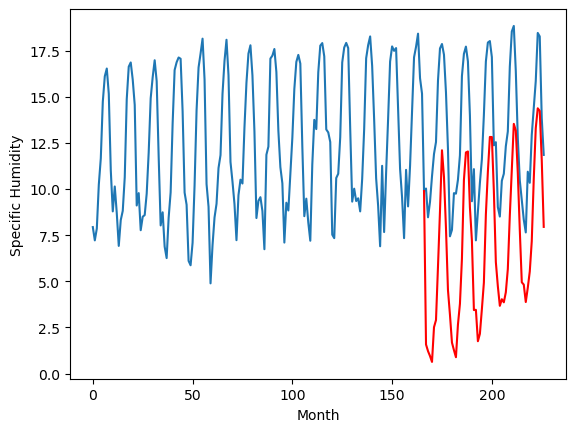

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		1.64		2.70
-0.22		1.28		1.50
-0.36		1.01		1.37
-0.55		0.69		1.24
3.00		2.57		-0.43
1.88		2.96		1.08
4.12		5.86		1.74
7.42		8.86		1.44
10.35		12.16		1.81
8.84		10.71		1.87
6.79		7.94		1.15
3.44		4.59		1.15
0.77		3.25		2.48
-1.61		1.74		3.35
-1.72		1.33		3.05
-1.84		0.95		2.79
1.22		2.71		1.49
1.47		3.84		2.37
4.91		6.28		1.37
9.15		10.56		1.41
10.80		12.04		1.24
10.81		12.10		1.29
7.87		9.07		1.20
5.09		7.28		2.19
-0.35		3.50		3.85
2.60		3.52		0.92
-2.13		1.82		3.95
-1.28		2.21		3.49
-0.23		3.55		3.78
2.22		4.99		2.77
6.82		8.68		1.86
9.20		10.99		1.79
11.04		12.88		1.84
10.86		12.88		2.02
6.62		9.97		3.35
1.66		6.10		4.44
0.91		4.79		3.88
0.37		3.73		3.36
0.27		4.09		3.82
0.94		3.92		2.98
1.27		4.47		3.20
2.11		5.72		3.61
5.49		8.63		3.14
9.06		11.11		2.05
10.65		13.59		2.94
9.07		13.23		4.16
6.05		10.93		4.88
2.12		7.84		5.72
0.14		5.01		4.87
-1.17		4.88		6.05
-1.89		3.94		5.83
-0.46	

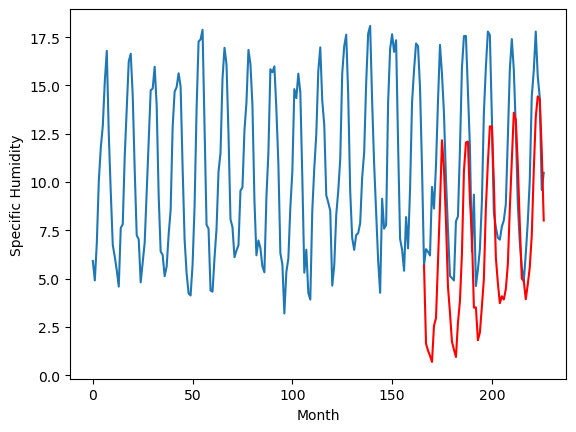

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		1.50		0.38
0.12		1.14		1.02
0.76		0.87		0.11
0.14		0.55		0.41
4.09		2.43		-1.66
3.69		2.82		-0.87
6.85		5.72		-1.13
9.01		8.72		-0.29
12.24		12.02		-0.22
9.65		10.57		0.92
8.44		7.80		-0.64
3.87		4.45		0.58
2.23		3.11		0.88
-0.37		1.60		1.97
-0.48		1.19		1.67
-0.80		0.81		1.61
1.86		2.57		0.71
3.15		3.70		0.55
7.15		6.14		-1.01
10.84		10.42		-0.42
11.41		11.90		0.49
11.80		11.96		0.16
7.79		8.93		1.14
4.94		7.14		2.20
1.32		3.36		2.04
3.18		3.38		0.20
-1.48		1.68		3.16
-0.95		2.07		3.02
0.64		3.41		2.77
4.15		4.85		0.70
8.14		8.54		0.40
9.91		10.85		0.94
9.33		12.74		3.41
10.34		12.74		2.40
7.06		9.83		2.77
2.60		5.96		3.36
2.42		4.65		2.23
0.84		3.59		2.75
0.15		3.95		3.80
0.51		3.78		3.27
2.57		4.33		1.76
3.25		5.58		2.33
7.51		8.49		0.98
11.45		10.97		-0.48
11.30		13.45		2.15
9.20		13.09		3.89
8.30		10.79		2.49
4.58		7.70		3.12
2.05		4.87		2.82
0.30		4.74		4.44
-0.98		3.80		4.78
1.36

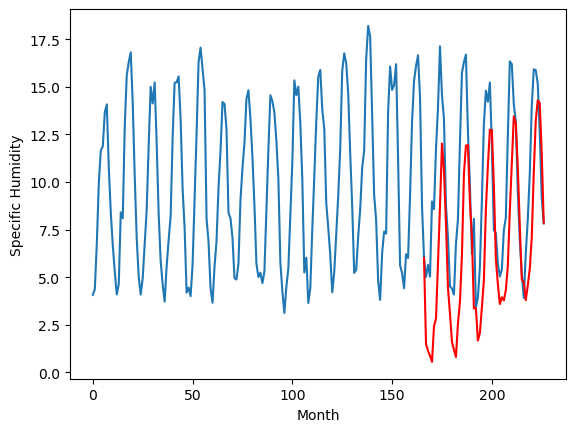

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		1.06		0.45
-0.36		0.70		1.06
0.33		0.43		0.10
-0.33		0.11		0.44
3.57		1.99		-1.58
3.06		2.38		-0.68
6.30		5.28		-1.02
8.28		8.28		-0.00
11.43		11.58		0.15
8.78		10.13		1.35
7.89		7.36		-0.53
3.12		4.01		0.89
1.76		2.67		0.91
-0.81		1.16		1.97
-0.85		0.75		1.60
-1.30		0.37		1.67
1.28		2.13		0.85
2.64		3.26		0.62
6.93		5.70		-1.23
10.81		9.98		-0.83
11.19		11.46		0.27
11.30		11.52		0.22
7.40		8.49		1.09
4.67		6.70		2.03
1.06		2.92		1.86
2.47		2.94		0.47
-1.86		1.24		3.10
-1.42		1.63		3.05
0.10		2.97		2.87
3.78		4.41		0.63
7.66		8.10		0.44
9.34		10.41		1.07
8.84		12.30		3.46
10.01		12.30		2.29
6.86		9.39		2.53
2.40		5.52		3.12
1.98		4.21		2.23
0.39		3.15		2.76
-0.36		3.51		3.87
0.04		3.34		3.30
2.01		3.89		1.88
2.86		5.14		2.28
7.13		8.05		0.92
10.61		10.53		-0.08
9.71		13.01		3.30
8.33		12.65		4.32
8.00		10.35		2.35
4.34		7.26		2.92
1.92		4.43		2.51
0.16		4.30		4.14
-1.26		3.36		4.62
1.09

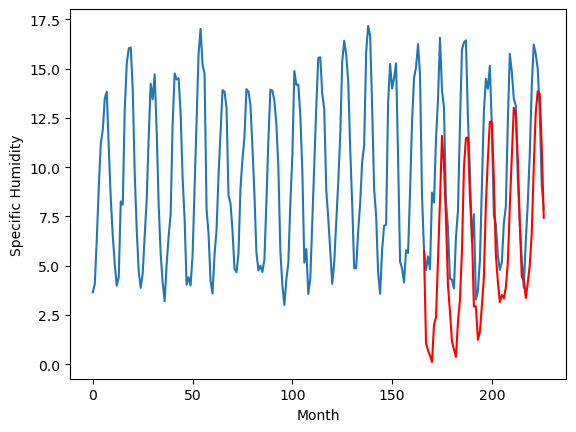

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		5.60		-1.32
5.68		5.24		-0.44
5.56		4.97		-0.59
5.44		4.65		-0.79
8.24		6.53		-1.71
7.49		6.92		-0.57
9.76		9.82		0.06
11.47		12.82		1.35
12.70		16.12		3.42
11.39		14.67		3.28
11.20		11.90		0.70
7.55		8.55		1.00
7.09		7.21		0.12
4.53		5.70		1.17
5.23		5.29		0.06
4.59		4.91		0.32
6.08		6.67		0.59
7.04		7.80		0.76
11.59		10.24		-1.35
13.89		14.52		0.63
14.92		16.00		1.08
14.64		16.06		1.42
11.39		13.03		1.64
8.34		11.24		2.90
6.62		7.46		0.84
5.77		7.48		1.71
4.31		5.78		1.47
4.30		6.17		1.87
4.89		7.51		2.62
6.92		8.95		2.03
9.18		12.64		3.46
12.03		14.95		2.92
12.72		16.84		4.12
14.71		16.84		2.13
13.46		13.93		0.47
9.95		10.06		0.11
7.25		8.75		1.50
6.61		7.69		1.08
5.06		8.05		2.99
5.18		7.88		2.70
6.47		8.43		1.96
6.44		9.68		3.24
11.28		12.59		1.31
15.14		15.07		-0.07
12.81		17.55		4.74
11.95		17.19		5.24
12.46		14.89		2.43
10.33		11.80		1.47
8.03		8.97		0.94
6.45		8.84		2.39
5.18		

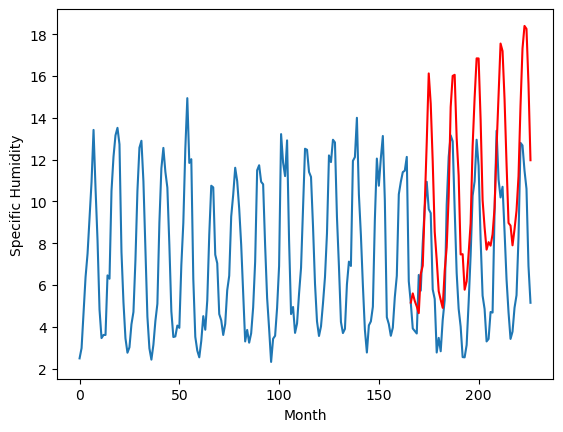

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		3.58		3.12
0.53		3.22		2.69
0.37		2.95		2.58
0.95		2.63		1.68
3.14		4.51		1.37
2.47		4.90		2.43
5.59		7.80		2.21
9.42		10.80		1.38
12.01		14.10		2.09
12.22		12.65		0.43
8.38		9.88		1.50
5.73		6.53		0.80
2.90		5.19		2.29
-0.44		3.68		4.12
-0.56		3.27		3.83
-0.31		2.89		3.20
1.40		4.65		3.25
1.81		5.78		3.97
4.79		8.22		3.43
9.48		12.50		3.02
11.08		13.98		2.90
11.46		14.04		2.58
7.88		11.01		3.13
5.67		9.22		3.55
-0.05		5.44		5.49
1.81		5.46		3.65
-1.17		3.76		4.93
0.15		4.15		4.00
0.99		5.49		4.50
2.05		6.93		4.88
6.06		10.62		4.56
8.34		12.93		4.59
11.50		14.82		3.32
10.31		14.82		4.51
6.76		11.91		5.15
2.08		8.04		5.96
1.90		6.73		4.83
-0.09		5.67		5.76
0.54		6.03		5.49
1.58		5.86		4.28
1.07		6.41		5.34
2.67		7.66		4.99
4.89		10.57		5.68
7.94		13.05		5.11
11.33		15.53		4.20
10.87		15.17		4.30
7.42		12.87		5.45
3.51		9.78		6.27
0.56		6.95		6.39
0.28		6.82		6.54
-0.50		5.88		6.38
-0.32	

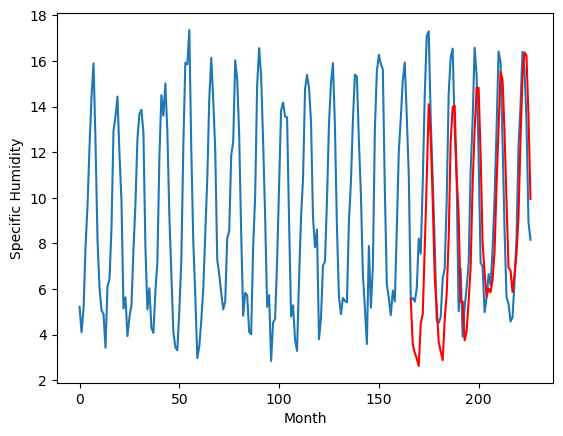

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		1.74		1.07
0.40		1.38		0.98
0.16		1.11		0.95
-0.07		0.79		0.86
2.48		2.67		0.19
2.80		3.06		0.26
6.18		5.96		-0.22
9.79		8.96		-0.83
11.84		12.26		0.42
9.19		10.81		1.62
7.59		8.04		0.45
3.04		4.69		1.65
1.37		3.35		1.98
-0.56		1.84		2.40
-0.71		1.43		2.14
-1.34		1.05		2.39
1.03		2.81		1.78
1.95		3.94		1.99
5.11		6.38		1.27
9.71		10.66		0.95
10.66		12.14		1.48
10.40		12.20		1.80
7.14		9.17		2.03
5.05		7.38		2.33
0.36		3.60		3.24
1.83		3.62		1.79
-1.37		1.92		3.29
-0.86		2.31		3.17
0.65		3.65		3.00
2.44		5.09		2.65
7.15		8.78		1.63
9.51		11.09		1.58
10.31		12.98		2.67
10.78		12.98		2.20
6.97		10.07		3.10
2.31		6.20		3.89
0.95		4.89		3.94
0.08		3.83		3.75
0.36		4.19		3.83
0.17		4.02		3.85
0.93		4.57		3.64
1.83		5.82		3.99
6.22		8.73		2.51
8.78		11.21		2.43
11.57		13.69		2.12
11.85		13.33		1.48
7.65		11.03		3.38
4.04		7.94		3.90
1.01		5.11		4.10
0.20		4.98		4.78
-0.95		4.04		4.99
0.41		4.8

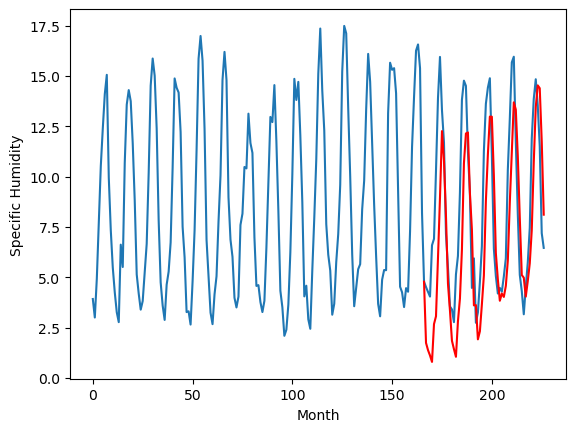

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		1.31		1.18
0.30		0.95		0.65
-0.07		0.68		0.75
-0.47		0.36		0.83
1.45		2.24		0.79
1.73		2.63		0.90
4.88		5.53		0.65
7.62		8.53		0.91
10.84		11.83		0.99
9.17		10.38		1.21
6.25		7.61		1.36
2.87		4.26		1.39
1.19		2.92		1.73
-0.41		1.41		1.82
-0.76		1.00		1.76
-1.33		0.62		1.95
0.61		2.38		1.77
1.94		3.51		1.57
4.23		5.95		1.72
9.29		10.23		0.94
10.55		11.71		1.16
10.69		11.77		1.08
7.21		8.74		1.53
6.06		6.95		0.89
0.29		3.17		2.88
1.00		3.19		2.19
-1.38		1.49		2.87
-0.80		1.88		2.68
0.51		3.22		2.71
2.00		4.66		2.66
6.02		8.35		2.33
7.46		10.66		3.20
10.20		12.55		2.35
9.84		12.55		2.71
7.18		9.64		2.46
1.85		5.77		3.92
0.81		4.46		3.65
-0.15		3.40		3.55
0.47		3.76		3.29
0.07		3.59		3.52
0.42		4.14		3.72
1.87		5.39		3.52
4.12		8.30		4.18
6.08		10.78		4.70
10.38		13.26		2.88
9.84		12.90		3.06
7.04		10.60		3.56
3.71		7.51		3.80
0.64		4.68		4.04
0.61		4.55		3.94
-0.47		3.61		4.08
0.11		4.38		

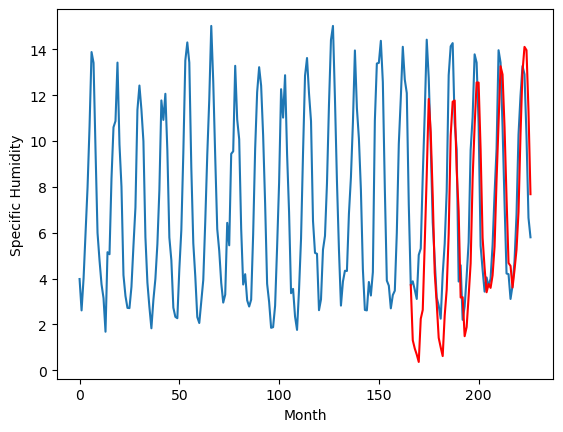

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.15		0.69
-0.37		-0.21		0.16
-0.85		-0.48		0.37
-1.12		-0.80		0.32
0.93		1.08		0.15
1.52		1.47		-0.05
5.24		4.37		-0.87
7.72		7.37		-0.35
11.28		10.67		-0.61
9.09		9.22		0.13
6.31		6.45		0.14
2.15		3.10		0.95
1.06		1.76		0.70
-0.85		0.25		1.10
-1.17		-0.16		1.01
-1.81		-0.54		1.27
0.56		1.22		0.66
1.87		2.35		0.48
4.49		4.79		0.30
9.24		9.07		-0.17
10.64		10.55		-0.09
10.89		10.61		-0.28
6.86		7.58		0.72
4.99		5.79		0.80
-0.30		2.01		2.31
0.24		2.03		1.79
-2.00		0.33		2.33
-1.30		0.72		2.02
0.22		2.06		1.84
1.52		3.50		1.98
5.59		7.19		1.60
7.83		9.50		1.67
10.47		11.39		0.92
9.70		11.39		1.69
6.33		8.48		2.15
1.57		4.61		3.04
0.20		3.30		3.10
-0.91		2.24		3.15
-0.39		2.60		2.99
-0.62		2.43		3.05
-0.01		2.98		2.99
1.50		4.23		2.73
4.28		7.14		2.86
5.92		9.62		3.70
10.62		12.10		1.48
10.49		11.74		1.25
6.71		9.44		2.73
3.27		6.35		3.08
-0.12		3.52		3.64
0.37		3.39		3.02
-1.09		2.45		3

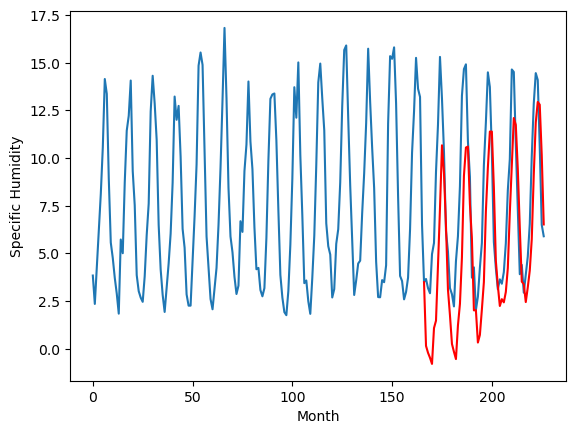

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		2.88		1.35
1.68		2.52		0.84
1.34		2.25		0.91
0.99		1.93		0.94
2.56		3.81		1.25
2.40		4.20		1.80
5.02		7.10		2.08
8.21		10.10		1.89
11.13		13.40		2.27
9.71		11.95		2.24
7.57		9.18		1.61
4.53		5.83		1.30
2.60		4.49		1.89
1.27		2.98		1.71
0.89		2.57		1.68
0.32		2.19		1.87
1.61		3.95		2.34
3.28		5.08		1.80
4.88		7.52		2.64
9.89		11.80		1.91
11.16		13.28		2.12
12.03		13.34		1.31
8.27		10.31		2.04
7.26		8.52		1.26
2.02		4.74		2.72
1.98		4.76		2.78
0.24		3.06		2.82
0.69		3.45		2.76
1.84		4.79		2.95
2.83		6.23		3.40
6.29		9.92		3.63
8.20		12.23		4.03
9.93		14.12		4.19
10.39		14.12		3.73
8.40		11.21		2.81
3.58		7.34		3.76
2.86		6.03		3.17
1.41		4.97		3.56
2.03		5.33		3.30
1.28		5.16		3.88
1.49		5.71		4.22
3.19		6.96		3.77
4.09		9.87		5.78
7.33		12.35		5.02
10.95		14.83		3.88
10.15		14.47		4.32
8.44		12.17		3.73
5.38		9.08		3.70
1.94		6.25		4.31
2.46		6.12		3.66
1.39		5.18		3.79
1.41		5.95		4.54

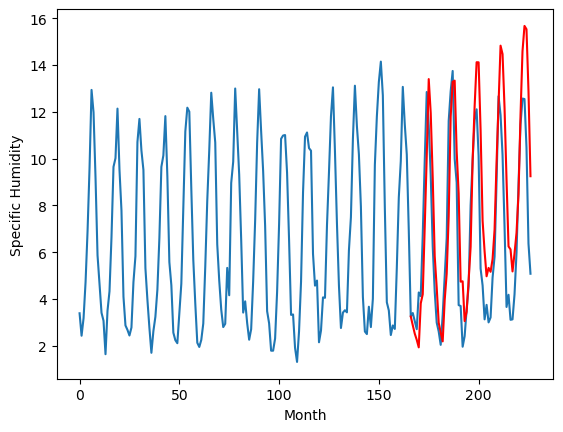

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[2.878609390258789, 1.5786098670959472, 1.6386098670959472, 1.4986103439331053, 1.0586103439331054, 5.598610343933106, 3.578609867095947, 1.7386103439331055, 1.308609390258789, 0.14860939025878928, 2.878609390258789]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33   2.878609
1                 1   -1.36   1.578610
2                 2   -1.06   1.638610
3                 3    1.12   1.498610
4                 4    0.61   1.058610
5                 5    6.92   5.598610
6                 6    0.46   3.578610
7                 7    0.67   1.738610
8                 8    0.13   1.308609
9                 9   -0.54   0.148609
10               10    1.53   2.878609


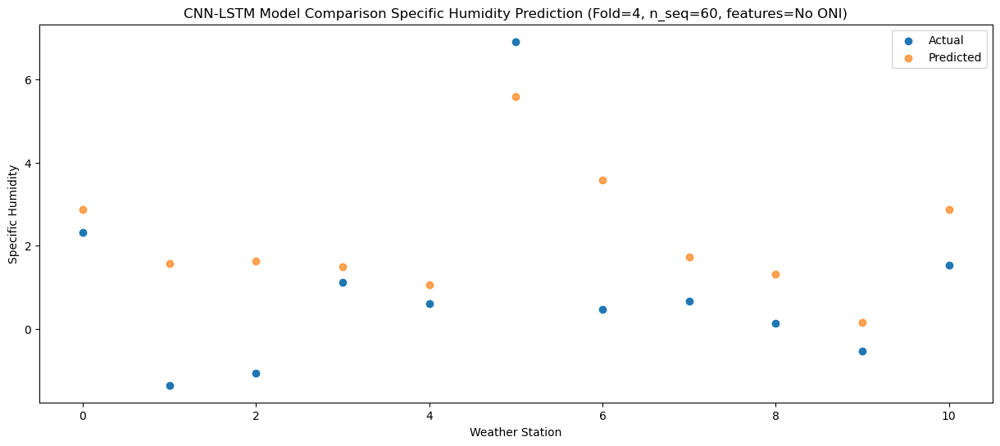

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   2.519085
1                 1   -1.22   1.219086
2                 2   -0.22   1.279086
3                 3    0.12   1.139085
4                 4   -0.36   0.699085
5                 5    5.68   5.239085
6                 6    0.53   3.219086
7                 7    0.40   1.379087
8                 8    0.30   0.949085
9                 9   -0.37  -0.210915
10               10    1.68   2.519085


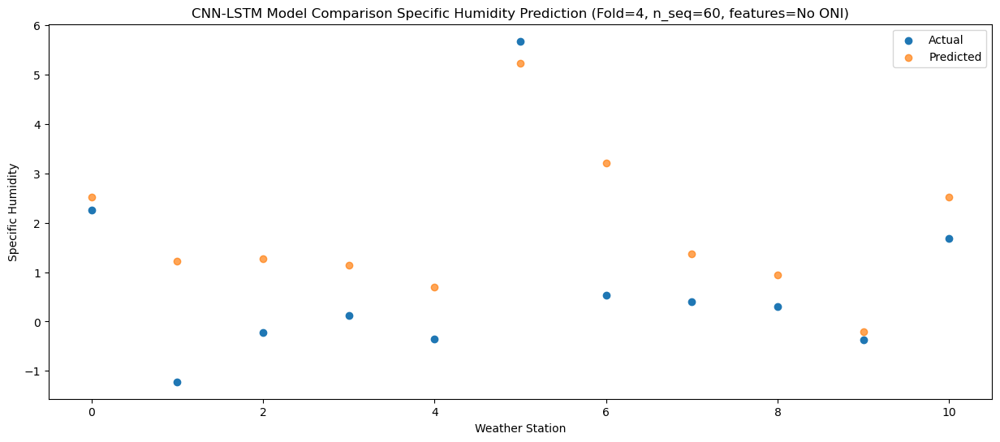

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84   2.252657
1                 1   -2.78   0.952659
2                 2   -0.36   1.012658
3                 3    0.76   0.872657
4                 4    0.33   0.432657
5                 5    5.56   4.972656
6                 6    0.37   2.952658
7                 7    0.16   1.112659
8                 8   -0.07   0.682657
9                 9   -0.85  -0.477343
10               10    1.34   2.252657


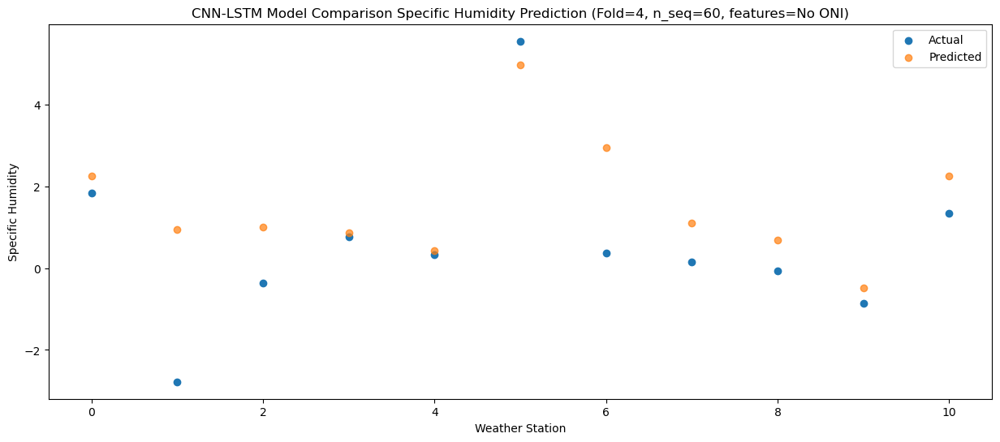

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   1.933077
1                 1   -1.94   0.633079
2                 2   -0.55   0.693078
3                 3    0.14   0.553076
4                 4   -0.33   0.113075
5                 5    5.44   4.653074
6                 6    0.95   2.633079
7                 7   -0.07   0.793079
8                 8   -0.47   0.363077
9                 9   -1.12  -0.796922
10               10    0.99   1.933078


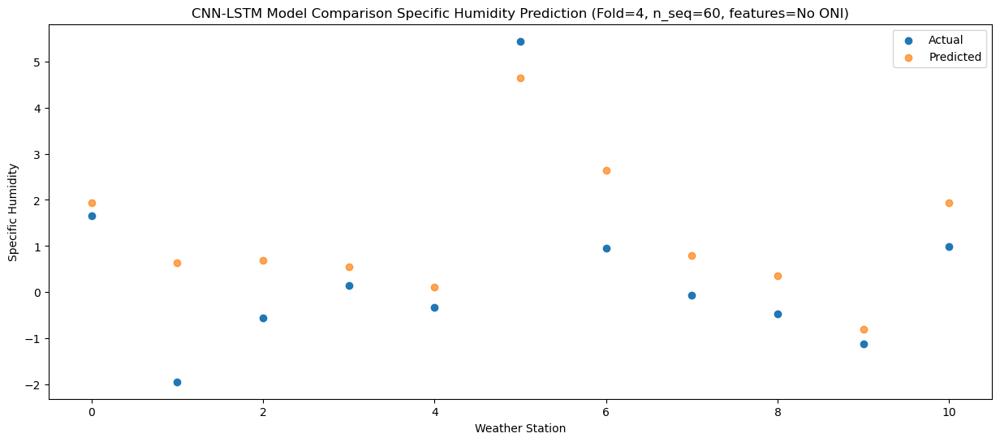

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   3.813742
1                 1   -0.56   2.513745
2                 2    3.00   2.573744
3                 3    4.09   2.433743
4                 4    3.57   1.993743
5                 5    8.24   6.533741
6                 6    3.14   4.513745
7                 7    2.48   2.673744
8                 8    1.45   2.243743
9                 9    0.93   1.083745
10               10    2.56   3.813744


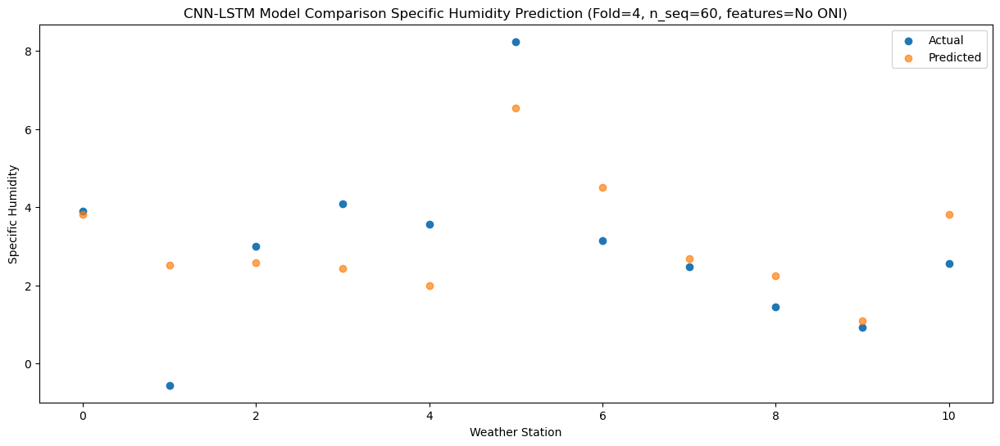

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   4.201661
1                 1    0.65   2.901664
2                 2    1.88   2.961664
3                 3    3.69   2.821662
4                 4    3.06   2.381662
5                 5    7.49   6.921661
6                 6    2.47   4.901666
7                 7    2.80   3.061663
8                 8    1.73   2.631664
9                 9    1.52   1.471664
10               10    2.40   4.201664


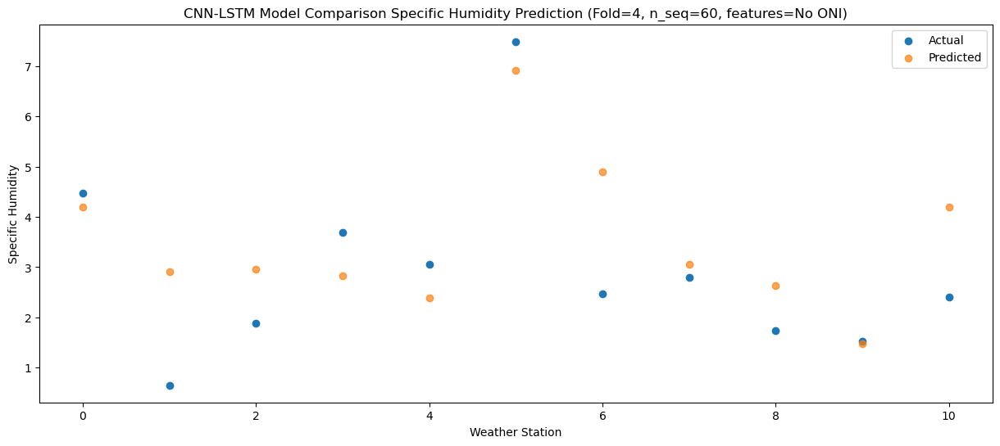

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   7.102928
1                 1    1.30   5.802930
2                 2    4.12   5.862930
3                 3    6.85   5.722929
4                 4    6.30   5.282927
5                 5    9.76   9.822927
6                 6    5.59   7.802930
7                 7    6.18   5.962930
8                 8    4.88   5.532929
9                 9    5.24   4.372929
10               10    5.02   7.102930


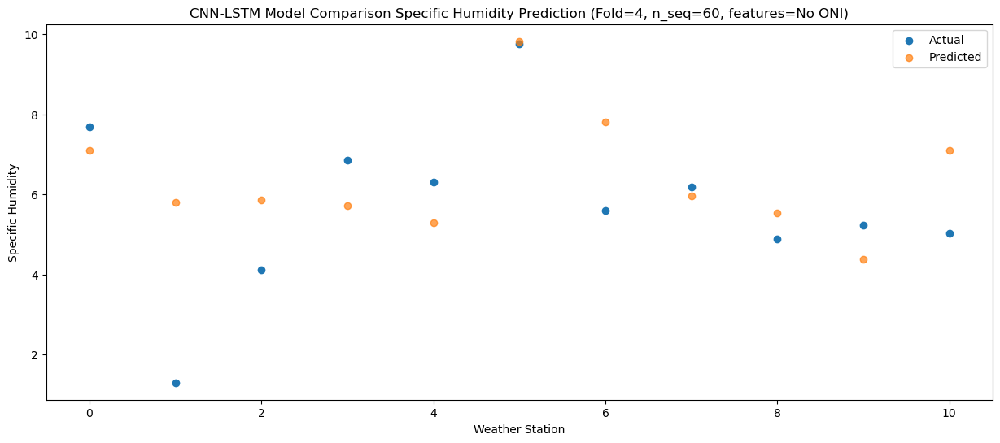

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34  10.096027
1                 1    4.63   8.796028
2                 2    7.42   8.856028
3                 3    9.01   8.716029
4                 4    8.28   8.276028
5                 5   11.47  12.816028
6                 6    9.42  10.796027
7                 7    9.79   8.956028
8                 8    7.62   8.526027
9                 9    7.72   7.366028
10               10    8.21  10.096027


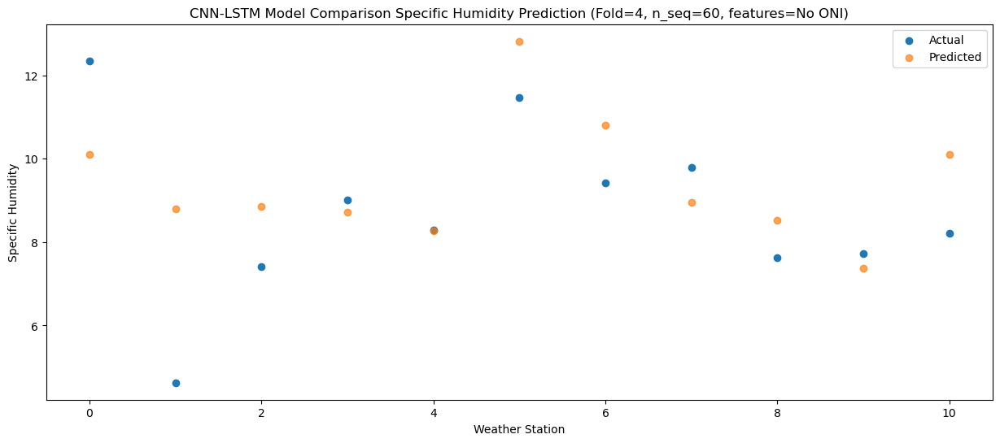

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69  13.402759
1                 1    6.37  12.102759
2                 2   10.35  12.162760
3                 3   12.24  12.022760
4                 4   11.43  11.582759
5                 5   12.70  16.122759
6                 6   12.01  14.102759
7                 7   11.84  12.262759
8                 8   10.84  11.832758
9                 9   11.28  10.672759
10               10   11.13  13.402759


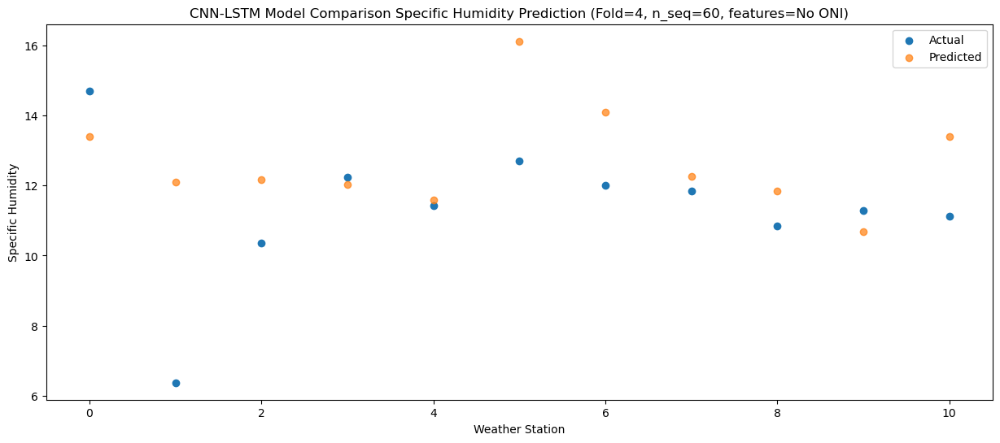

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26  11.949027
1                 1    6.61  10.649027
2                 2    8.84  10.709028
3                 3    9.65  10.569029
4                 4    8.78  10.129027
5                 5   11.39  14.669027
6                 6   12.22  12.649027
7                 7    9.19  10.809028
8                 8    9.17  10.379026
9                 9    9.09   9.219027
10               10    9.71  11.949027


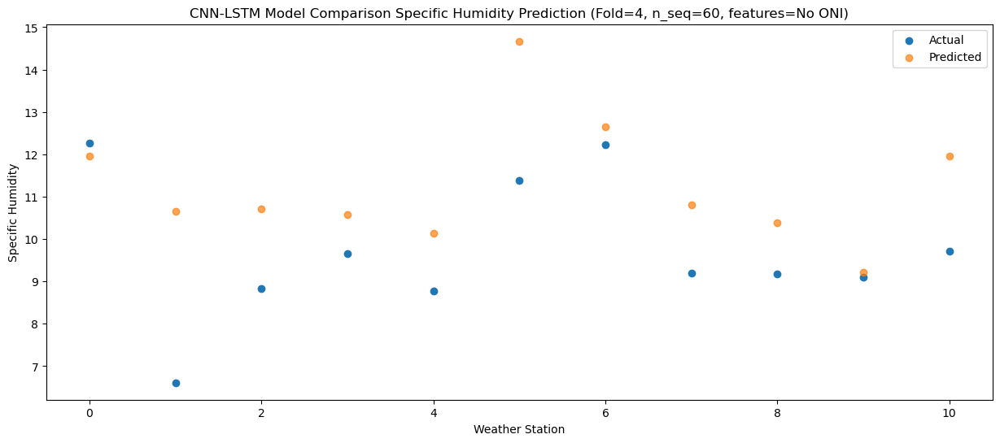

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   9.183213
1                 1    6.03   7.883214
2                 2    6.79   7.943215
3                 3    8.44   7.803215
4                 4    7.89   7.363213
5                 5   11.20  11.903213
6                 6    8.38   9.883215
7                 7    7.59   8.043215
8                 8    6.25   7.613214
9                 9    6.31   6.453214
10               10    7.57   9.183214


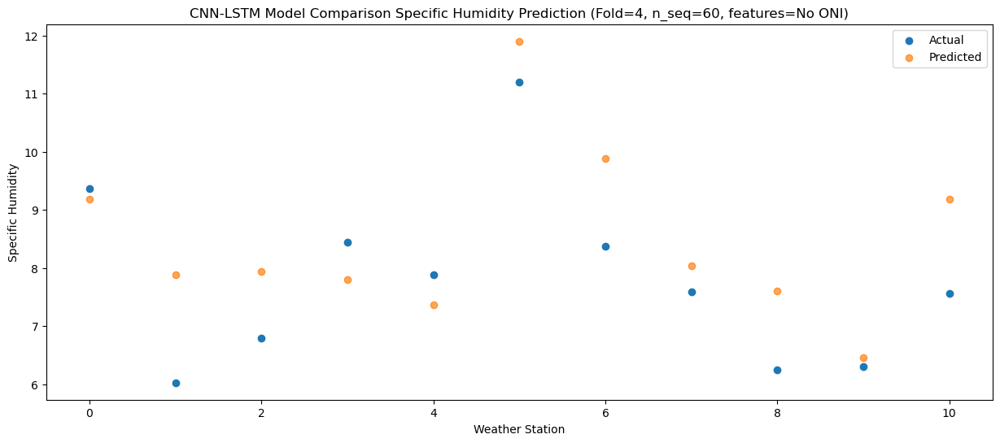

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   5.829553
1                 1    3.99   4.529555
2                 2    3.44   4.589556
3                 3    3.87   4.449555
4                 4    3.12   4.009554
5                 5    7.55   8.549554
6                 6    5.73   6.529556
7                 7    3.04   4.689555
8                 8    2.87   4.259553
9                 9    2.15   3.099555
10               10    4.53   5.829554


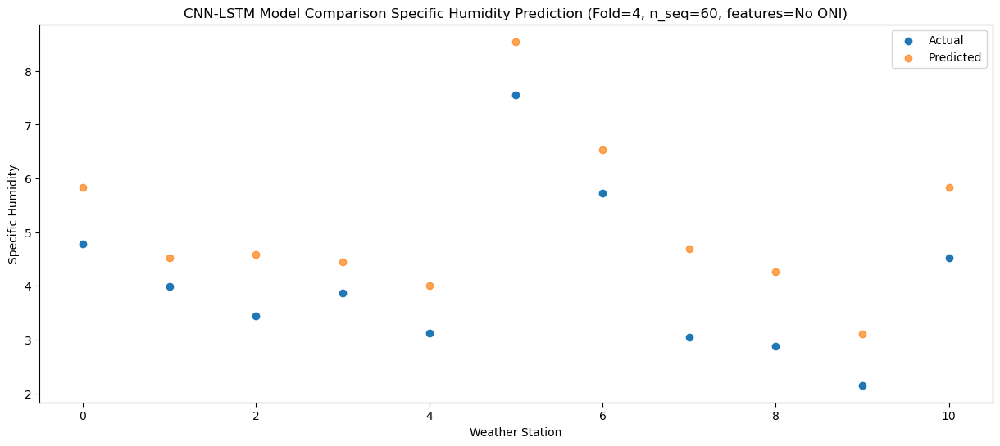

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   4.485132
1                 1    0.93   3.185134
2                 2    0.77   3.245135
3                 3    2.23   3.105134
4                 4    1.76   2.665133
5                 5    7.09   7.205133
6                 6    2.90   5.185136
7                 7    1.37   3.345134
8                 8    1.19   2.915134
9                 9    1.06   1.755134
10               10    2.60   4.485134


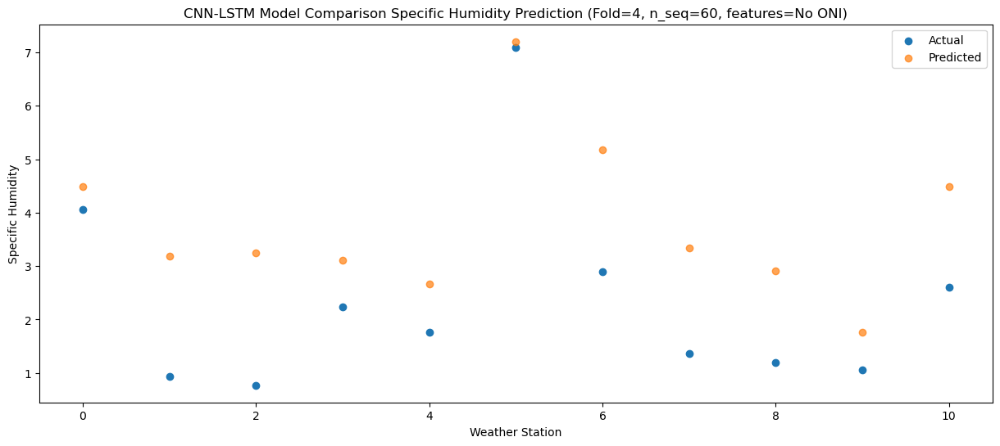

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   2.983568
1                 1   -3.81   1.683570
2                 2   -1.61   1.743571
3                 3   -0.37   1.603569
4                 4   -0.81   1.163568
5                 5    4.53   5.703567
6                 6   -0.44   3.683572
7                 7   -0.56   1.843570
8                 8   -0.41   1.413571
9                 9   -0.85   0.253570
10               10    1.27   2.983571


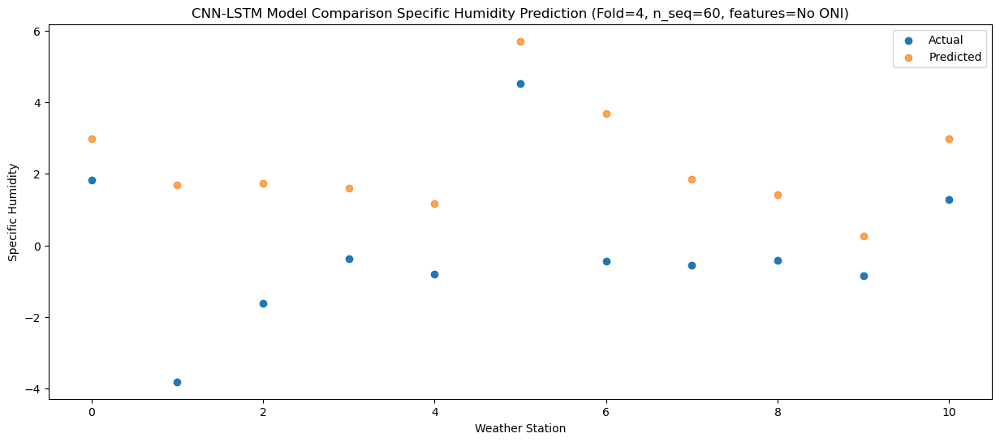

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95   2.568933
1                 1   -3.46   1.268935
2                 2   -1.72   1.328936
3                 3   -0.48   1.188935
4                 4   -0.85   0.748934
5                 5    5.23   5.288933
6                 6   -0.56   3.268939
7                 7   -0.71   1.428936
8                 8   -0.76   0.998938
9                 9   -1.17  -0.161065
10               10    0.89   2.568937


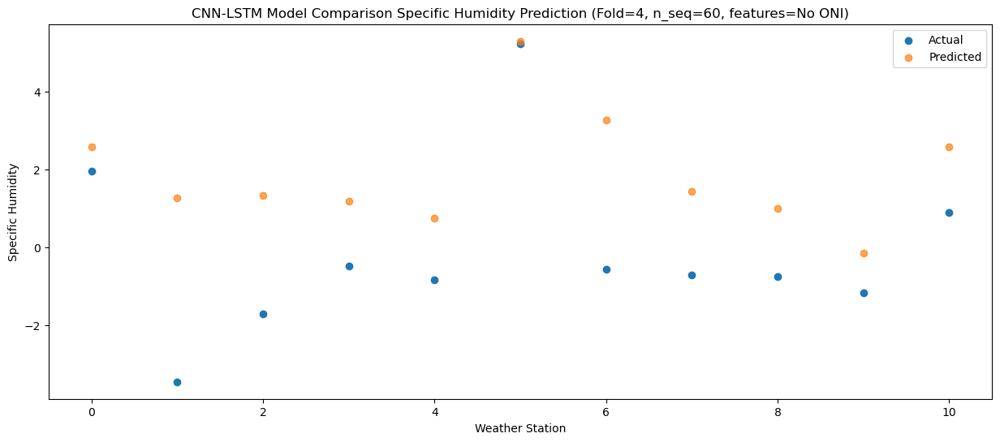

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86   2.188542
1                 1   -1.47   0.888544
2                 2   -1.84   0.948544
3                 3   -0.80   0.808544
4                 4   -1.30   0.368544
5                 5    4.59   4.908542
6                 6   -0.31   2.888547
7                 7   -1.34   1.048545
8                 8   -1.33   0.618546
9                 9   -1.81  -0.541457
10               10    0.32   2.188545


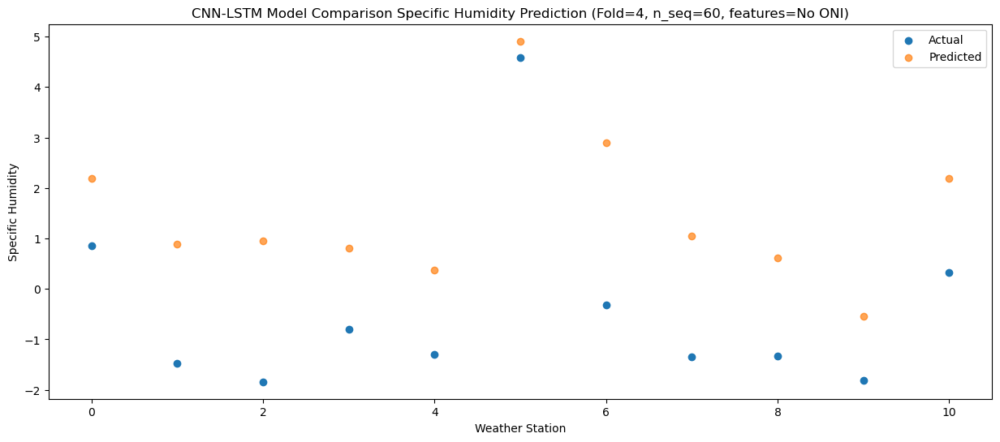

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62   3.952597
1                 1   -1.50   2.652599
2                 2    1.22   2.712599
3                 3    1.86   2.572599
4                 4    1.28   2.132599
5                 5    6.08   6.672596
6                 6    1.40   4.652601
7                 7    1.03   2.812599
8                 8    0.61   2.382600
9                 9    0.56   1.222597
10               10    1.61   3.952597


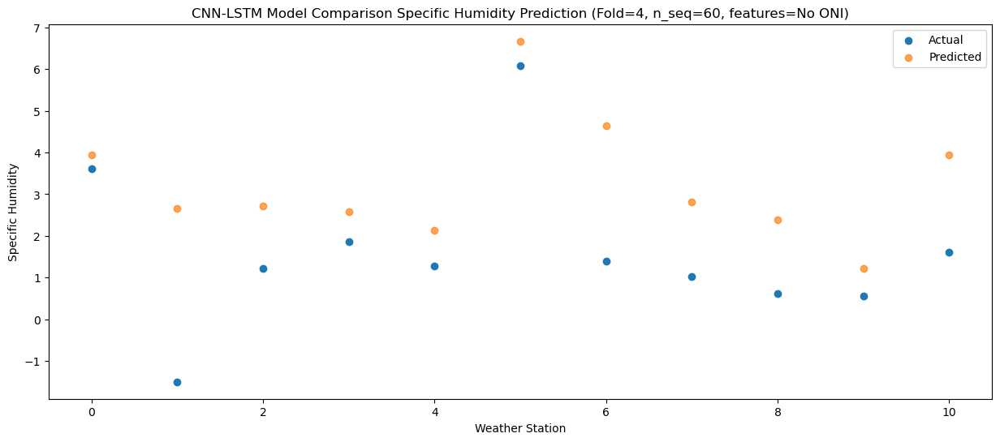

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   5.081731
1                 1   -0.75   3.781734
2                 2    1.47   3.841734
3                 3    3.15   3.701733
4                 4    2.64   3.261733
5                 5    7.04   7.801729
6                 6    1.81   5.781738
7                 7    1.95   3.941735
8                 8    1.94   3.511737
9                 9    1.87   2.351733
10               10    3.28   5.081733


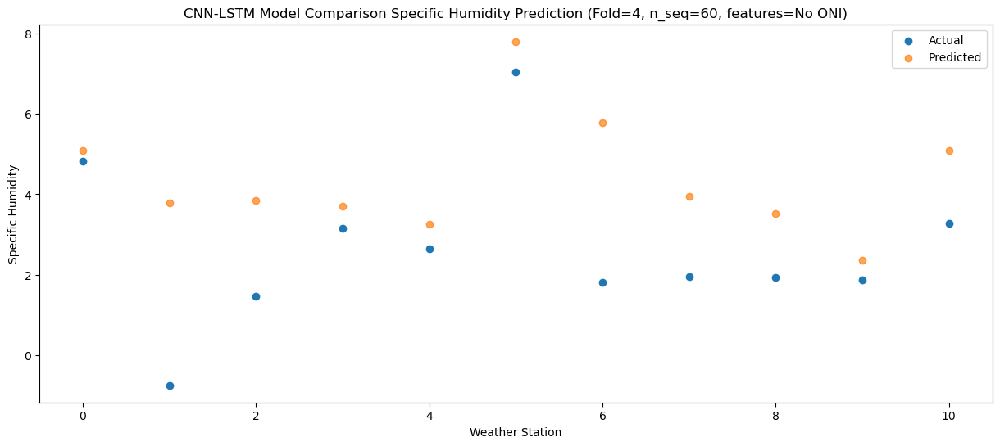

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   7.524039
1                 1    0.58   6.224044
2                 2    4.91   6.284041
3                 3    7.15   6.144042
4                 4    6.93   5.704042
5                 5   11.59  10.244037
6                 6    4.79   8.224045
7                 7    5.11   6.384044
8                 8    4.23   5.954045
9                 9    4.49   4.794040
10               10    4.88   7.524039


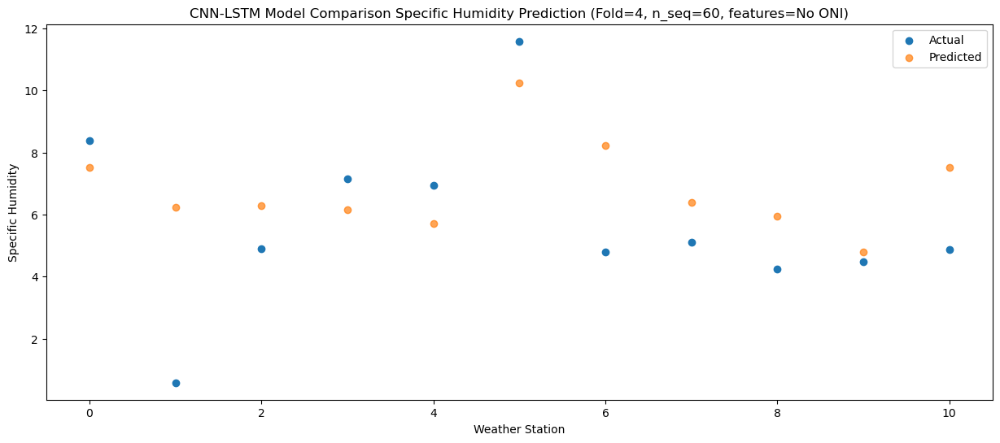

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98  11.796382
1                 1    4.87  10.496385
2                 2    9.15  10.556383
3                 3   10.84  10.416386
4                 4   10.81   9.976385
5                 5   13.89  14.516380
6                 6    9.48  12.496388
7                 7    9.71  10.656386
8                 8    9.29  10.226388
9                 9    9.24   9.066381
10               10    9.89  11.796382


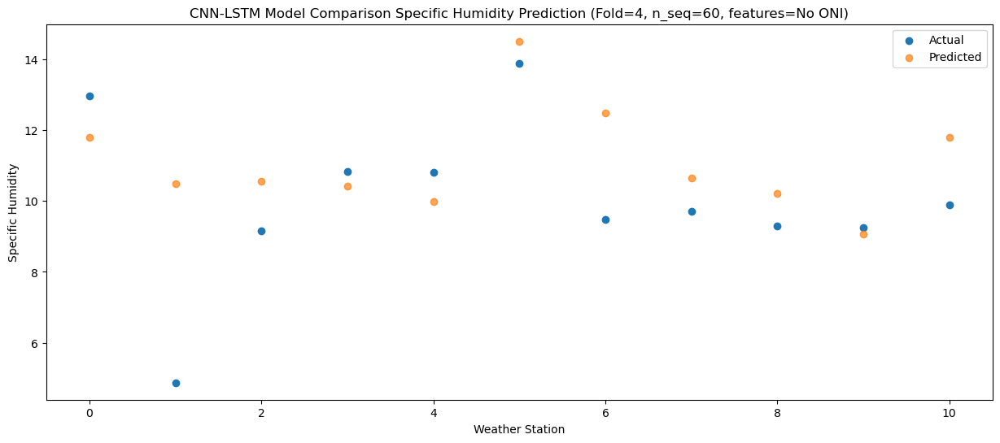

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  13.283806
1                 1    6.08  11.983809
2                 2   10.80  12.043808
3                 3   11.41  11.903811
4                 4   11.19  11.463809
5                 5   14.92  16.003804
6                 6   11.08  13.983812
7                 7   10.66  12.143809
8                 8   10.55  11.713811
9                 9   10.64  10.553804
10               10   11.16  13.283806


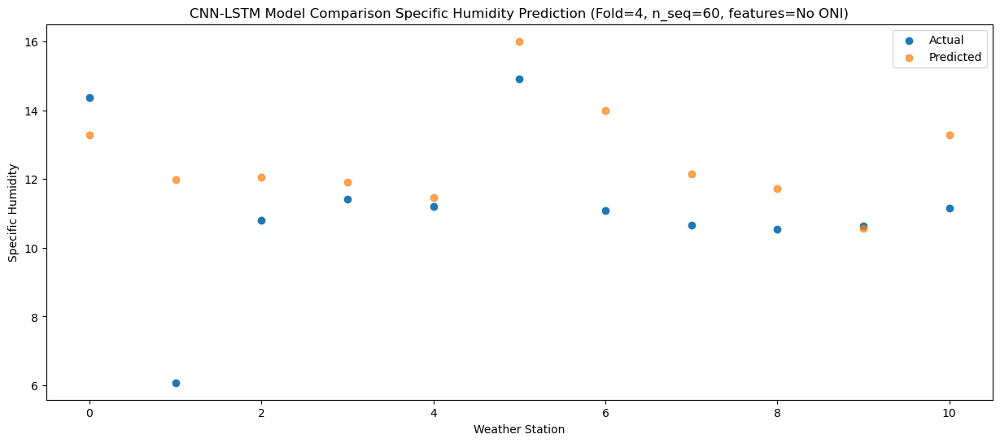

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  13.336786
1                 1    6.47  12.036789
2                 2   10.81  12.096789
3                 3   11.80  11.956790
4                 4   11.30  11.516788
5                 5   14.64  16.056783
6                 6   11.46  14.036793
7                 7   10.40  12.196790
8                 8   10.69  11.766792
9                 9   10.89  10.606786
10               10   12.03  13.336788


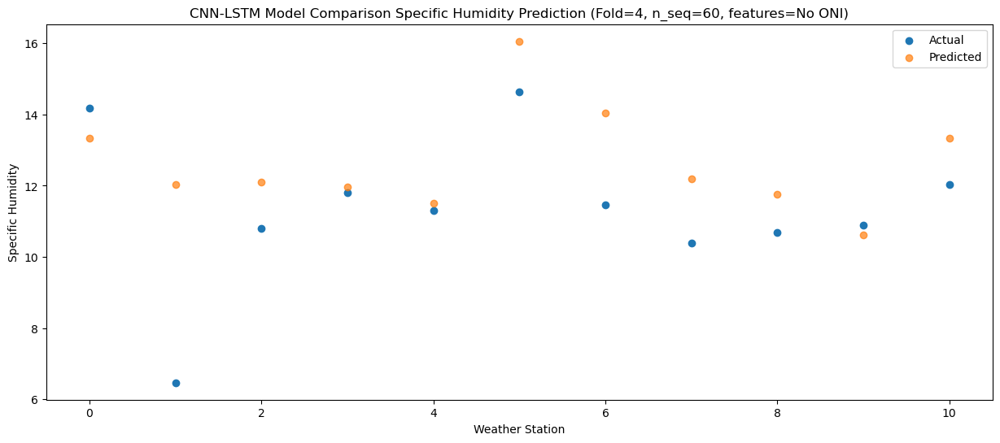

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61  10.314094
1                 1    5.67   9.014096
2                 2    7.87   9.074097
3                 3    7.79   8.934097
4                 4    7.40   8.494095
5                 5   11.39  13.034089
6                 6    7.88  11.014101
7                 7    7.14   9.174097
8                 8    7.21   8.744099
9                 9    6.86   7.584093
10               10    8.27  10.314095


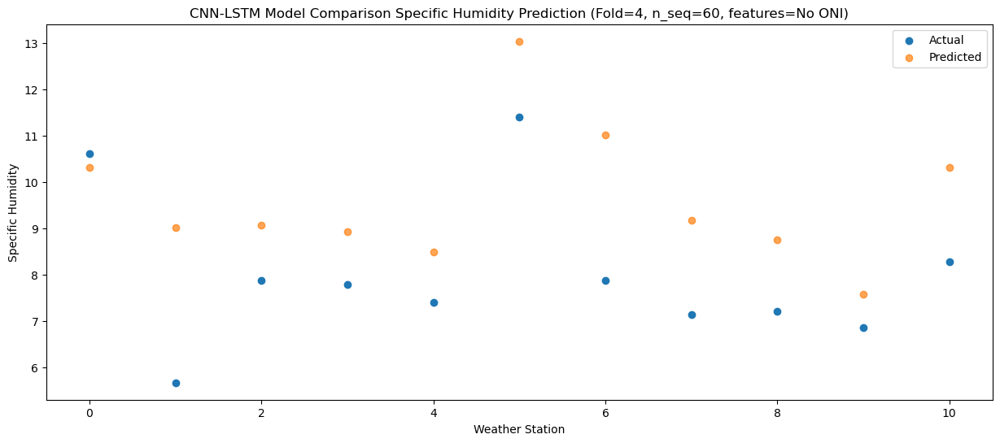

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   8.515375
1                 1    2.75   7.215379
2                 2    5.09   7.275377
3                 3    4.94   7.135379
4                 4    4.67   6.695377
5                 5    8.34  11.235371
6                 6    5.67   9.215381
7                 7    5.05   7.375380
8                 8    6.06   6.945380
9                 9    4.99   5.785375
10               10    7.26   8.515376


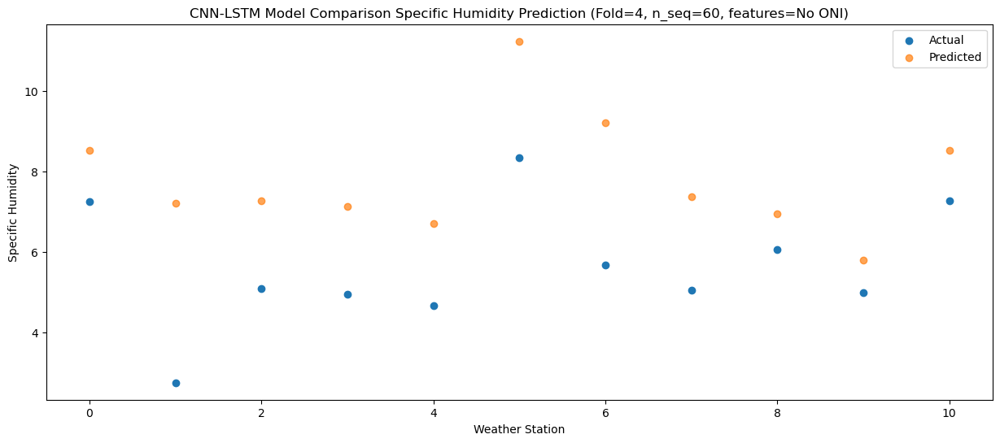

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   4.741817
1                 1   -1.91   3.441820
2                 2   -0.35   3.501818
3                 3    1.32   3.361821
4                 4    1.06   2.921819
5                 5    6.62   7.461814
6                 6   -0.05   5.441821
7                 7    0.36   3.601821
8                 8    0.29   3.171820
9                 9   -0.30   2.011814
10               10    2.02   4.741815


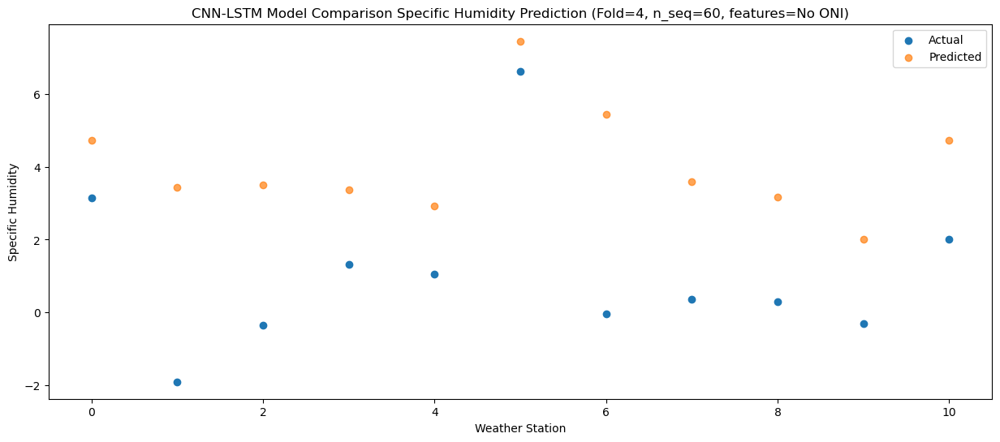

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94   4.756357
1                 1   -0.17   3.456358
2                 2    2.60   3.516358
3                 3    3.18   3.376360
4                 4    2.47   2.936357
5                 5    5.77   7.476352
6                 6    1.81   5.456361
7                 7    1.83   3.616360
8                 8    1.00   3.186360
9                 9    0.24   2.026355
10               10    1.98   4.756355


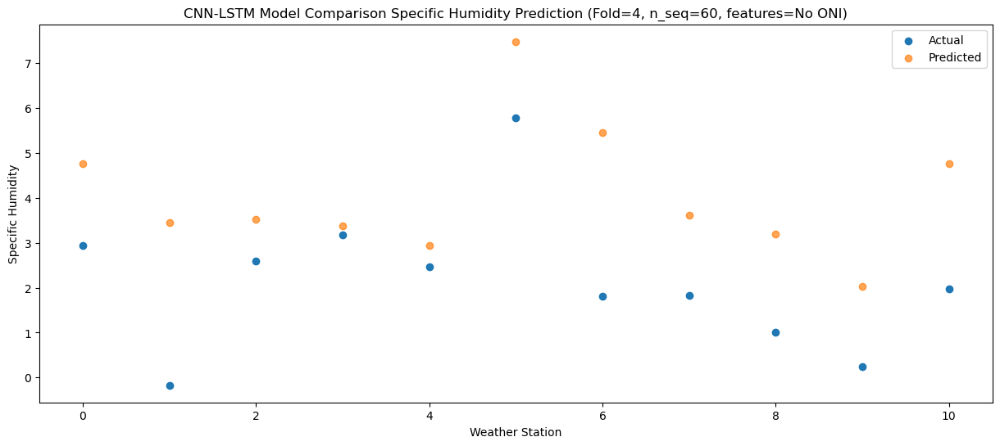

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93   3.055510
1                 1   -4.03   1.755511
2                 2   -2.13   1.815512
3                 3   -1.48   1.675513
4                 4   -1.86   1.235512
5                 5    4.31   5.775506
6                 6   -1.17   3.755515
7                 7   -1.37   1.915513
8                 8   -1.38   1.485513
9                 9   -2.00   0.325508
10               10    0.24   3.055509


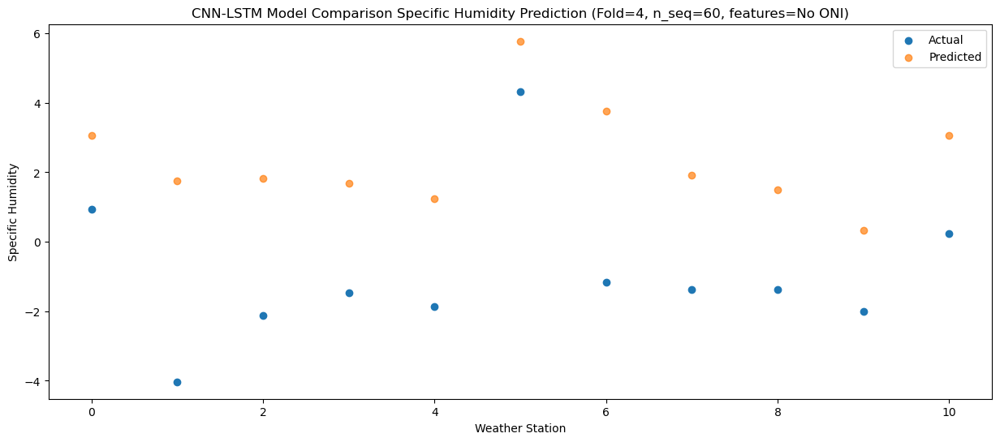

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15   3.454772
1                 1   -2.45   2.154774
2                 2   -1.28   2.214774
3                 3   -0.95   2.074775
4                 4   -1.42   1.634772
5                 5    4.30   6.174766
6                 6    0.15   4.154777
7                 7   -0.86   2.314777
8                 8   -0.80   1.884775
9                 9   -1.30   0.724771
10               10    0.69   3.454770


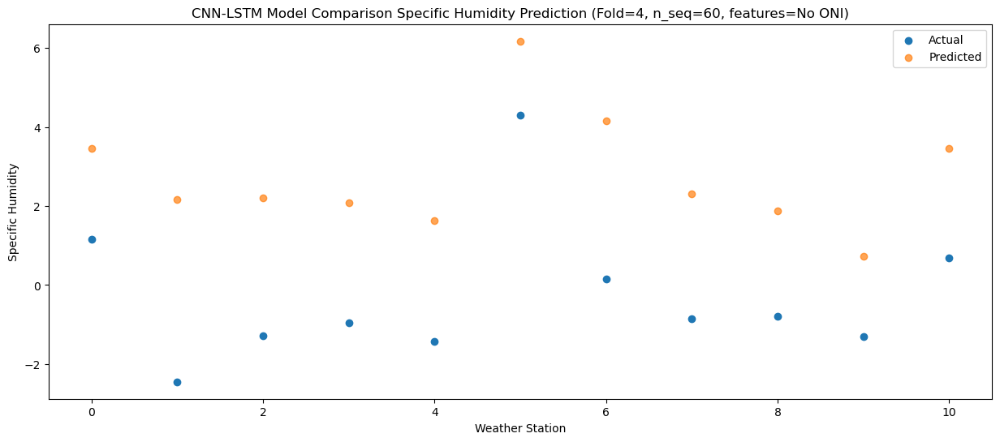

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   4.793457
1                 1   -0.92   3.493458
2                 2   -0.23   3.553458
3                 3    0.64   3.413459
4                 4    0.10   2.973457
5                 5    4.89   7.513450
6                 6    0.99   5.493462
7                 7    0.65   3.653461
8                 8    0.51   3.223460
9                 9    0.22   2.063456
10               10    1.84   4.793455


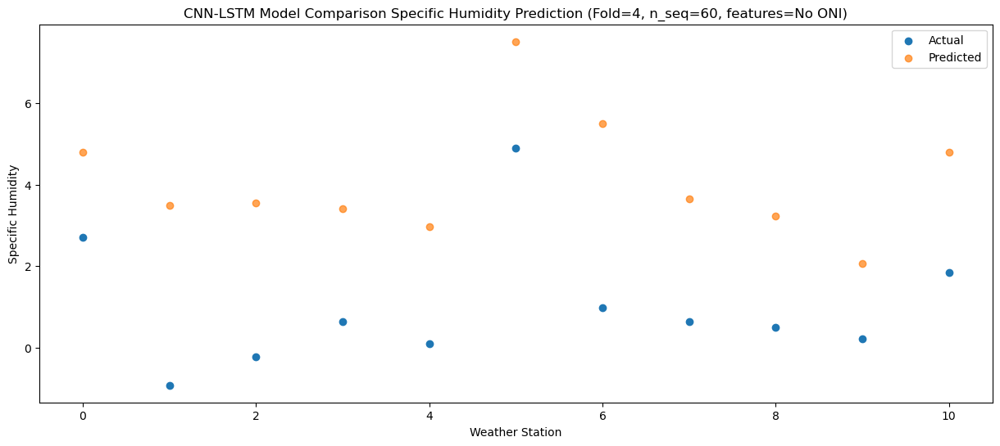

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   6.227800
1                 1    0.37   4.927803
2                 2    2.22   4.987802
3                 3    4.15   4.847804
4                 4    3.78   4.407800
5                 5    6.92   8.947794
6                 6    2.05   6.927804
7                 7    2.44   5.087805
8                 8    2.00   4.657801
9                 9    1.52   3.497798
10               10    2.83   6.227797


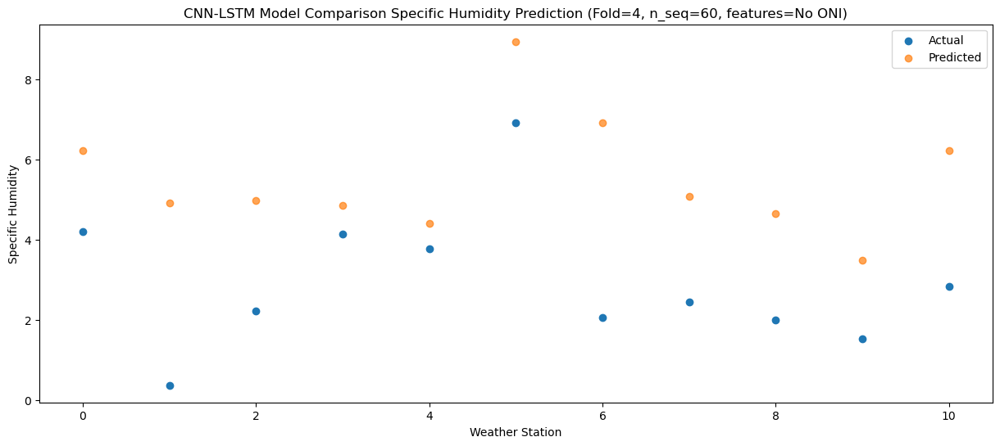

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   9.924854
1                 1    2.76   8.624857
2                 2    6.82   8.684856
3                 3    8.14   8.544858
4                 4    7.66   8.104854
5                 5    9.18  12.644848
6                 6    6.06  10.624859
7                 7    7.15   8.784859
8                 8    6.02   8.354856
9                 9    5.59   7.194853
10               10    6.29   9.924853


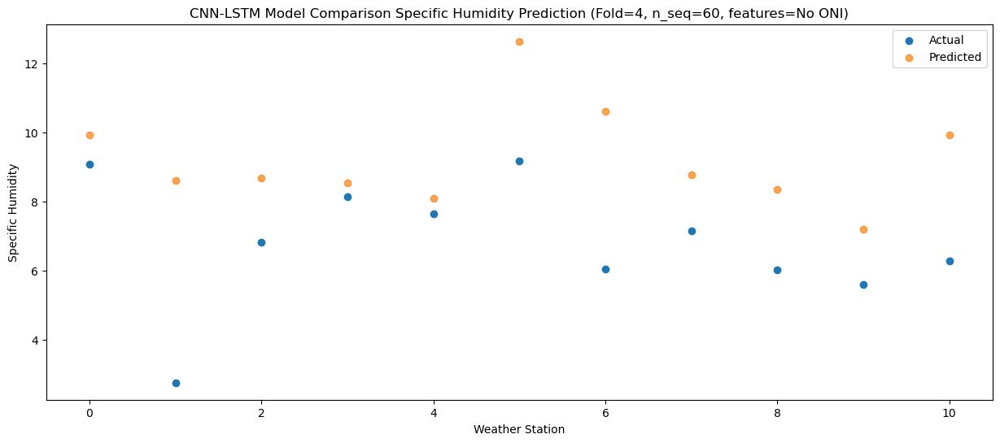

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31  12.230447
1                 1    5.66  10.930450
2                 2    9.20  10.990449
3                 3    9.91  10.850450
4                 4    9.34  10.410447
5                 5   12.03  14.950439
6                 6    8.34  12.930451
7                 7    9.51  11.090451
8                 8    7.46  10.660448
9                 9    7.83   9.500446
10               10    8.20  12.230445


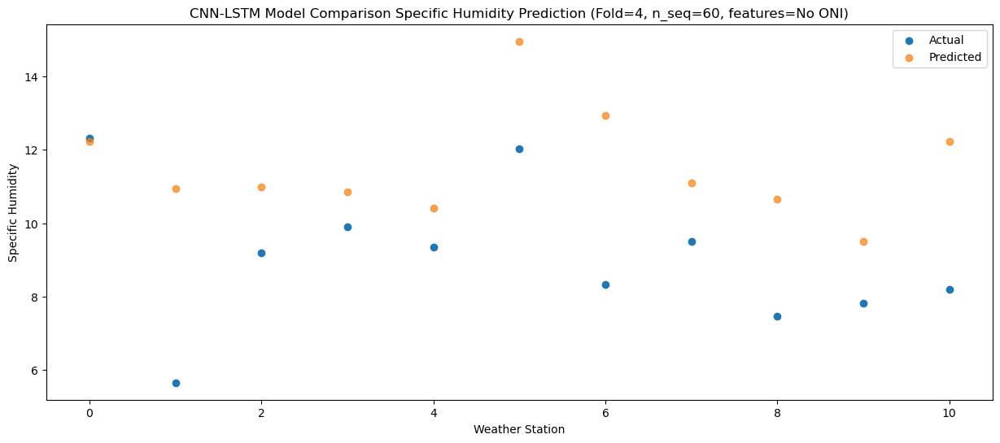

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94  14.123906
1                 1    6.69  12.823908
2                 2   11.04  12.883909
3                 3    9.33  12.743910
4                 4    8.84  12.303907
5                 5   12.72  16.843899
6                 6   11.50  14.823909
7                 7   10.31  12.983909
8                 8   10.20  12.553907
9                 9   10.47  11.393904
10               10    9.93  14.123904


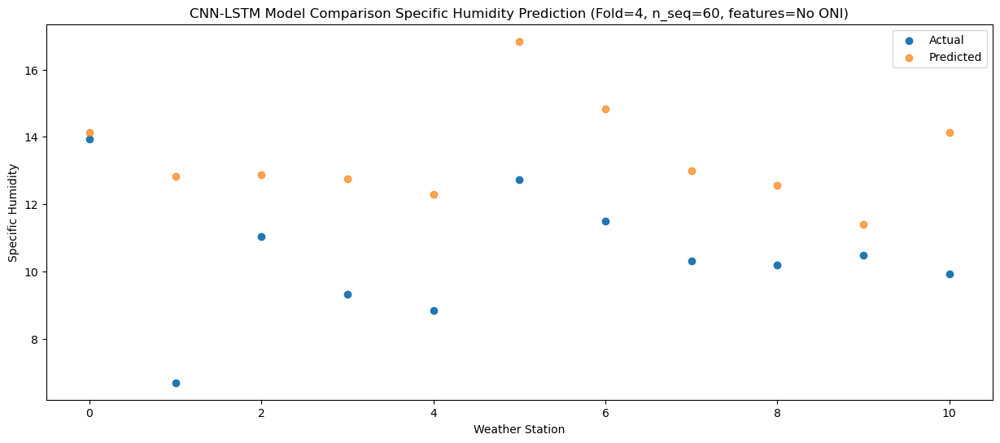

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73  14.119400
1                 1    6.77  12.819402
2                 2   10.86  12.879401
3                 3   10.34  12.739404
4                 4   10.01  12.299403
5                 5   14.71  16.839394
6                 6   10.31  14.819401
7                 7   10.78  12.979402
8                 8    9.84  12.549399
9                 9    9.70  11.389395
10               10   10.39  14.119396


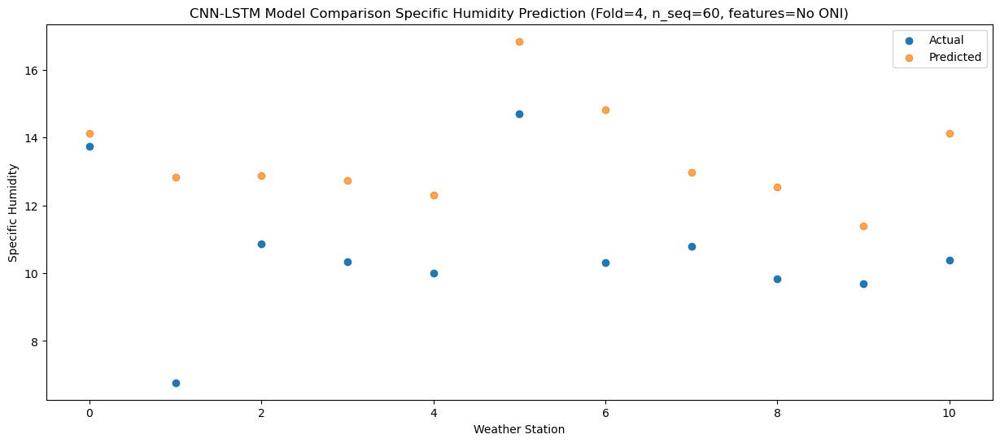

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03  11.209150
1                 1    5.90   9.909152
2                 2    6.62   9.969152
3                 3    7.06   9.829156
4                 4    6.86   9.389154
5                 5   13.46  13.929144
6                 6    6.76  11.909151
7                 7    6.97  10.069152
8                 8    7.18   9.639149
9                 9    6.33   8.479145
10               10    8.40  11.209147


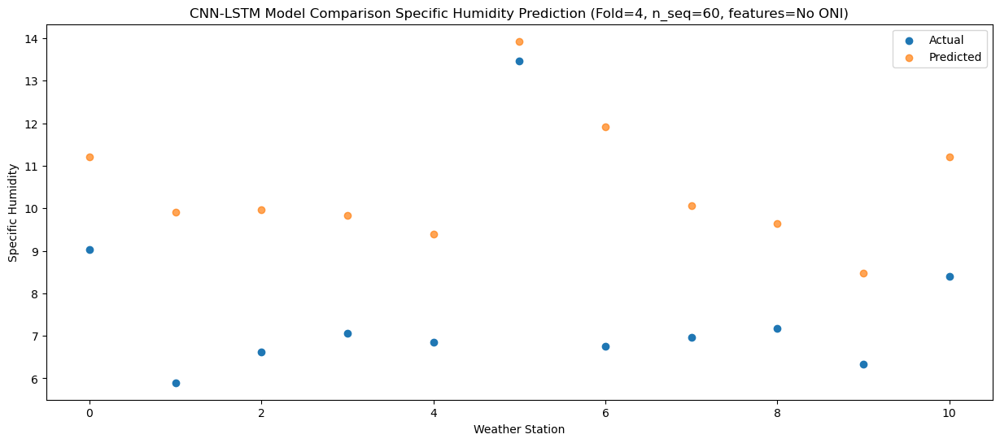

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   7.342585
1                 1    1.12   6.042587
2                 2    1.66   6.102587
3                 3    2.60   5.962592
4                 4    2.40   5.522589
5                 5    9.95  10.062579
6                 6    2.08   8.042586
7                 7    2.31   6.202587
8                 8    1.85   5.772583
9                 9    1.57   4.612579
10               10    3.58   7.342581


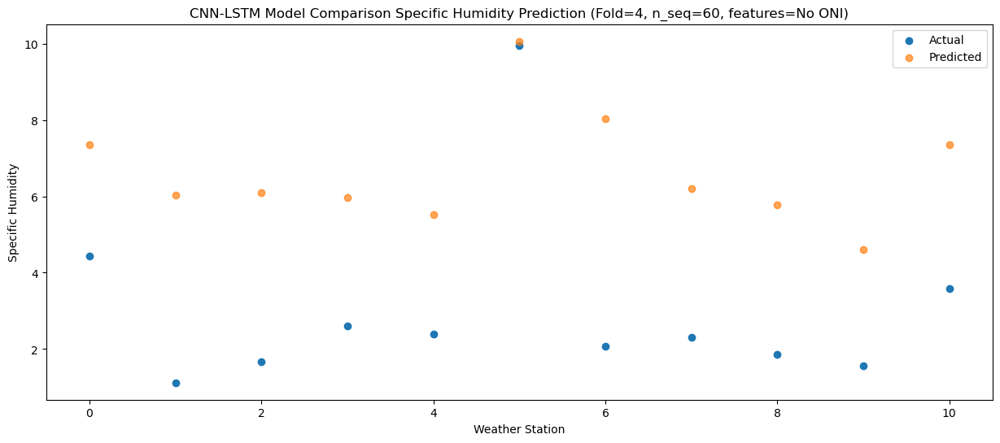

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   6.034661
1                 1    1.29   4.734663
2                 2    0.91   4.794662
3                 3    2.42   4.654667
4                 4    1.98   4.214664
5                 5    7.25   8.754655
6                 6    1.90   6.734662
7                 7    0.95   4.894663
8                 8    0.81   4.464659
9                 9    0.20   3.304655
10               10    2.86   6.034658


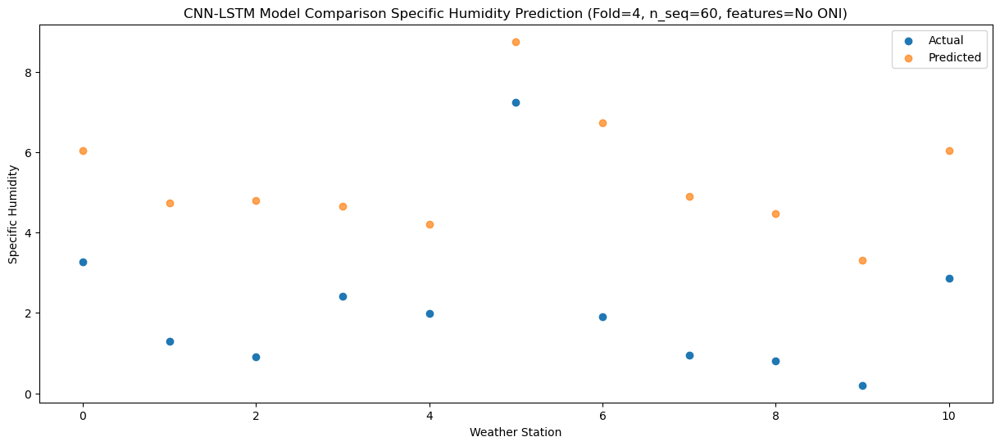

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93   4.972171
1                 1   -2.23   3.672172
2                 2    0.37   3.732171
3                 3    0.84   3.592177
4                 4    0.39   3.152174
5                 5    6.61   7.692165
6                 6   -0.09   5.672172
7                 7    0.08   3.832172
8                 8   -0.15   3.402166
9                 9   -0.91   2.242164
10               10    1.41   4.972165


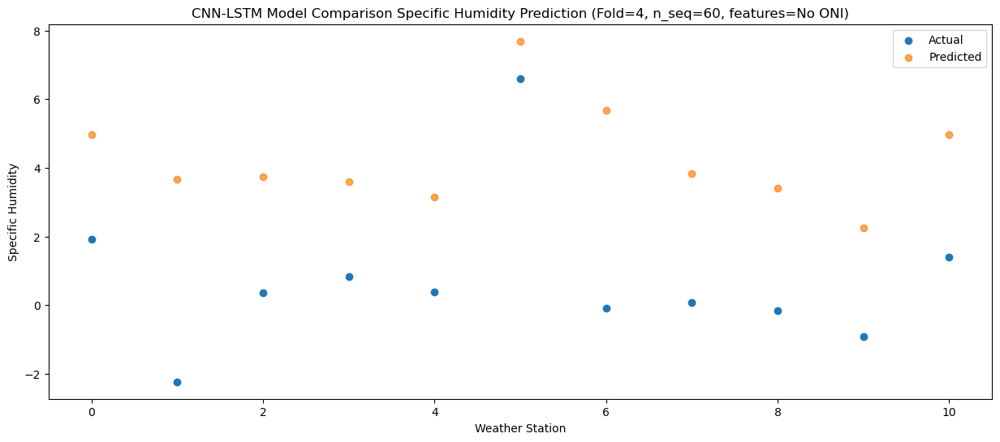

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28   5.330323
1                 1   -2.74   4.030324
2                 2    0.27   4.090322
3                 3    0.15   3.950329
4                 4   -0.36   3.510326
5                 5    5.06   8.050315
6                 6    0.54   6.030323
7                 7    0.36   4.190323
8                 8    0.47   3.760317
9                 9   -0.39   2.600314
10               10    2.03   5.330316


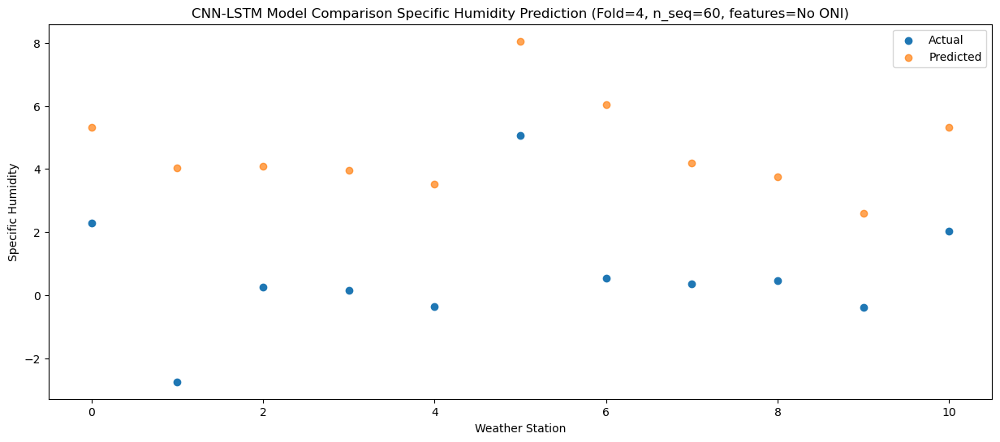

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23   5.162934
1                 1   -0.80   3.862934
2                 2    0.94   3.922934
3                 3    0.51   3.782940
4                 4    0.04   3.342937
5                 5    5.18   7.882926
6                 6    1.58   5.862935
7                 7    0.17   4.022934
8                 8    0.07   3.592928
9                 9   -0.62   2.432926
10               10    1.28   5.162927


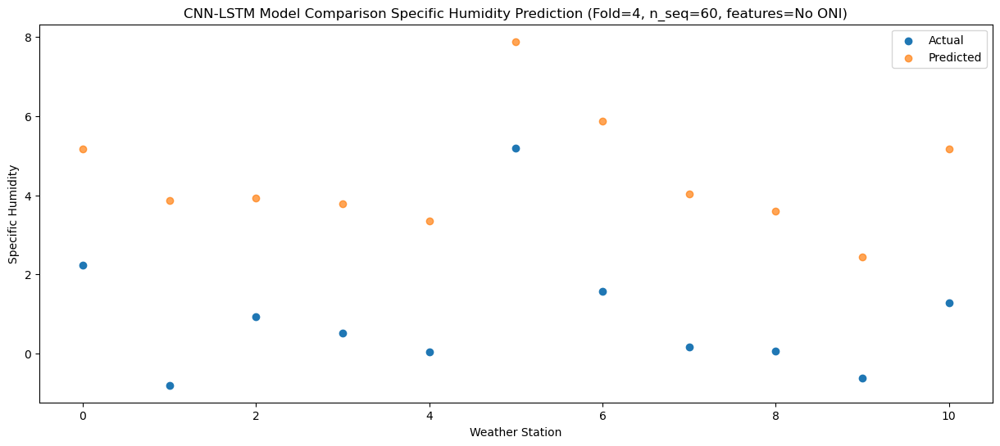

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07   5.706690
1                 1   -0.42   4.406692
2                 2    1.27   4.466691
3                 3    2.57   4.326697
4                 4    2.01   3.886693
5                 5    6.47   8.426683
6                 6    1.07   6.406692
7                 7    0.93   4.566691
8                 8    0.42   4.136686
9                 9   -0.01   2.976683
10               10    1.49   5.706685


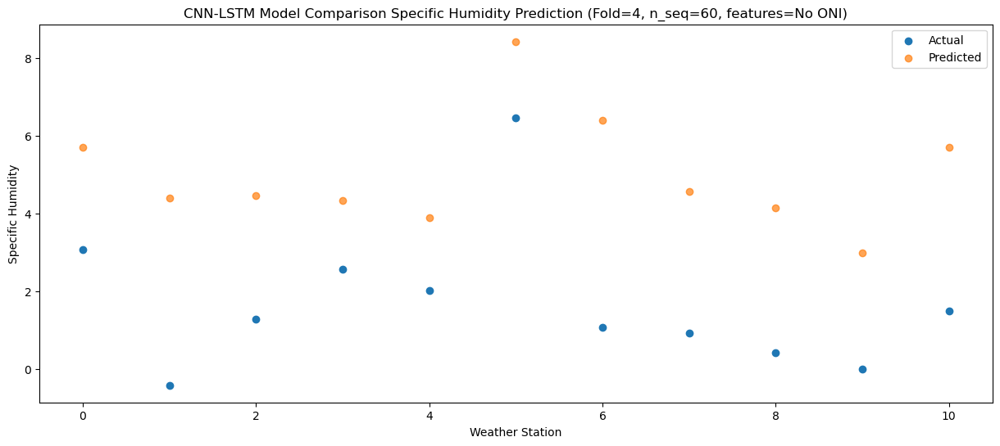

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   6.964832
1                 1    1.07   5.664834
2                 2    2.11   5.724834
3                 3    3.25   5.584838
4                 4    2.86   5.144836
5                 5    6.44   9.684825
6                 6    2.67   7.664836
7                 7    1.83   5.824832
8                 8    1.87   5.394829
9                 9    1.50   4.234826
10               10    3.19   6.964829


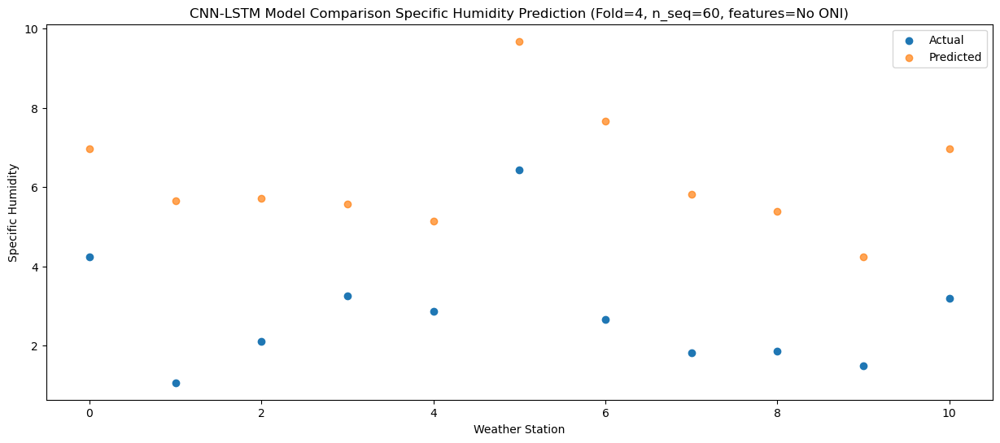

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   9.866483
1                 1    1.87   8.566485
2                 2    5.49   8.626484
3                 3    7.51   8.486490
4                 4    7.13   8.046487
5                 5   11.28  12.586474
6                 6    4.89  10.566483
7                 7    6.22   8.726484
8                 8    4.12   8.296475
9                 9    4.28   7.136474
10               10    4.09   9.866476


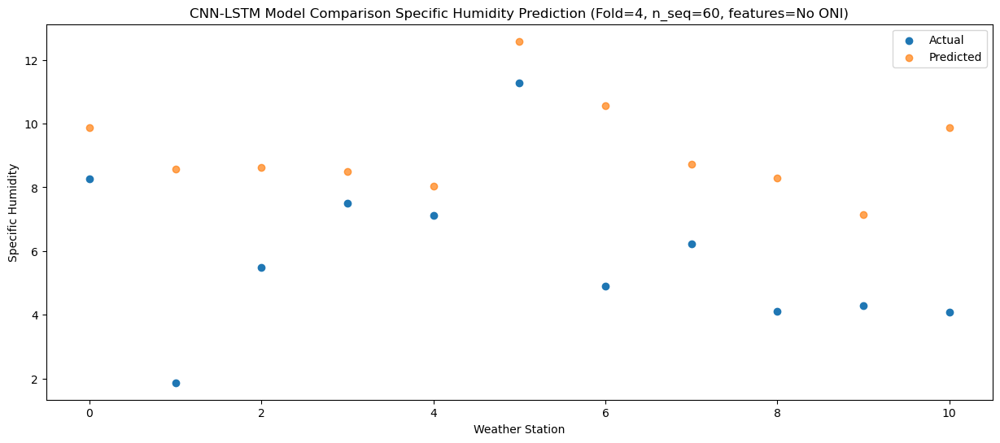

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81  12.352346
1                 1    5.38  11.052348
2                 2    9.06  11.112347
3                 3   11.45  10.972353
4                 4   10.61  10.532350
5                 5   15.14  15.072339
6                 6    7.94  13.052346
7                 7    8.78  11.212347
8                 8    6.08  10.782338
9                 9    5.92   9.622337
10               10    7.33  12.352338


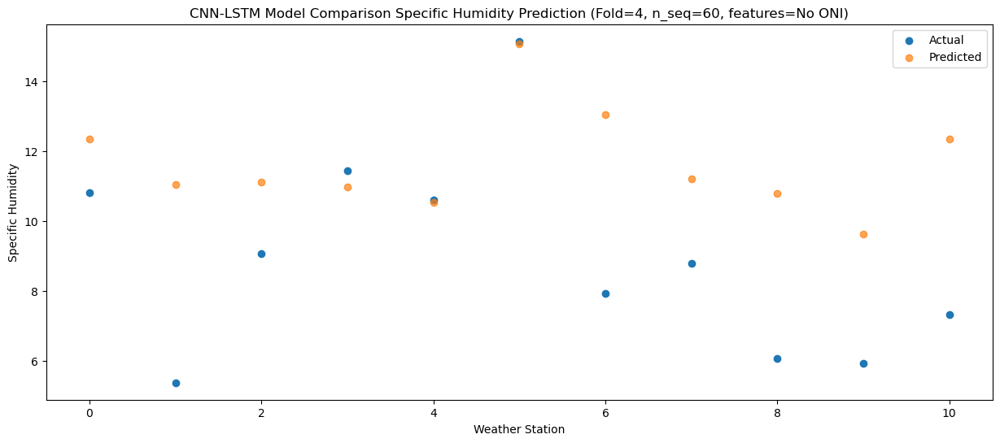

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50  14.831882
1                 1    7.29  13.531885
2                 2   10.65  13.591883
3                 3   11.30  13.451889
4                 4    9.71  13.011886
5                 5   12.81  17.551877
6                 6   11.33  15.531882
7                 7   11.57  13.691883
8                 8   10.38  13.261873
9                 9   10.62  12.101871
10               10   10.95  14.831873


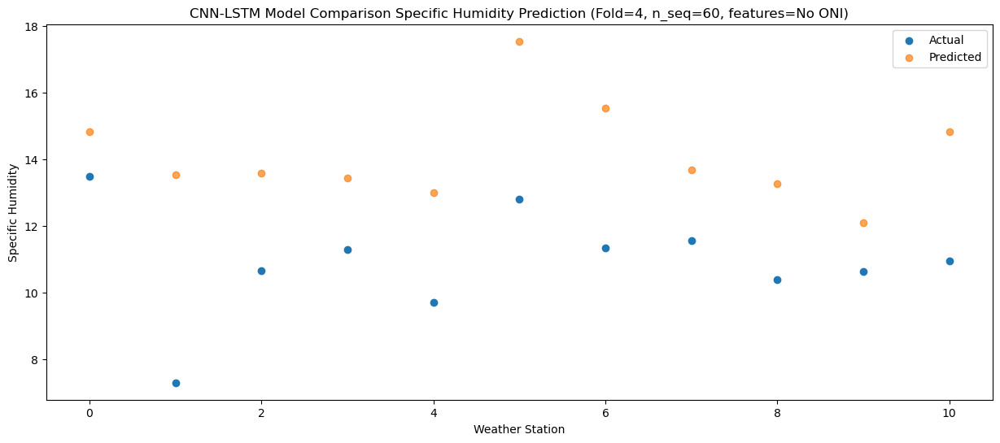

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43  14.471292
1                 1    7.59  13.171294
2                 2    9.07  13.231292
3                 3    9.20  13.091299
4                 4    8.33  12.651296
5                 5   11.95  17.191288
6                 6   10.87  15.171291
7                 7   11.85  13.331293
8                 8    9.84  12.901282
9                 9   10.49  11.741280
10               10   10.15  14.471281


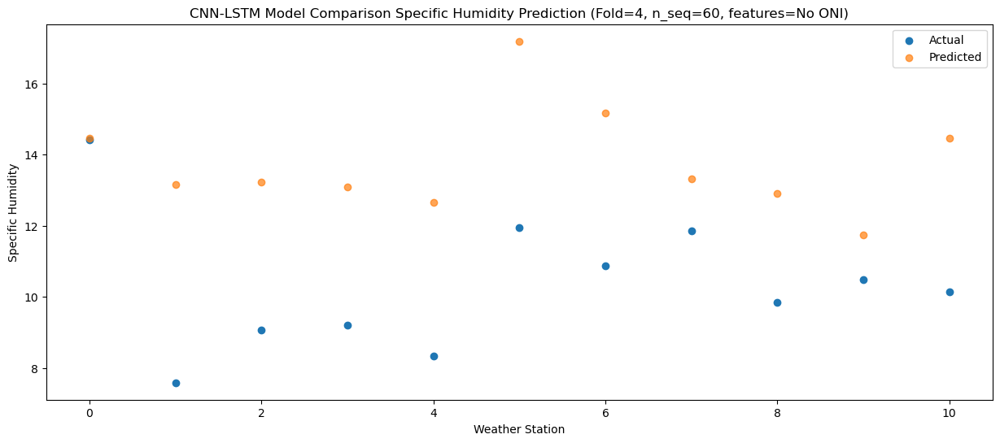

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51  12.174517
1                 1    5.14  10.874519
2                 2    6.05  10.934517
3                 3    8.30  10.794524
4                 4    8.00  10.354520
5                 5   12.46  14.894512
6                 6    7.42  12.874516
7                 7    7.65  11.034518
8                 8    7.04  10.604507
9                 9    6.71   9.444506
10               10    8.44  12.174506


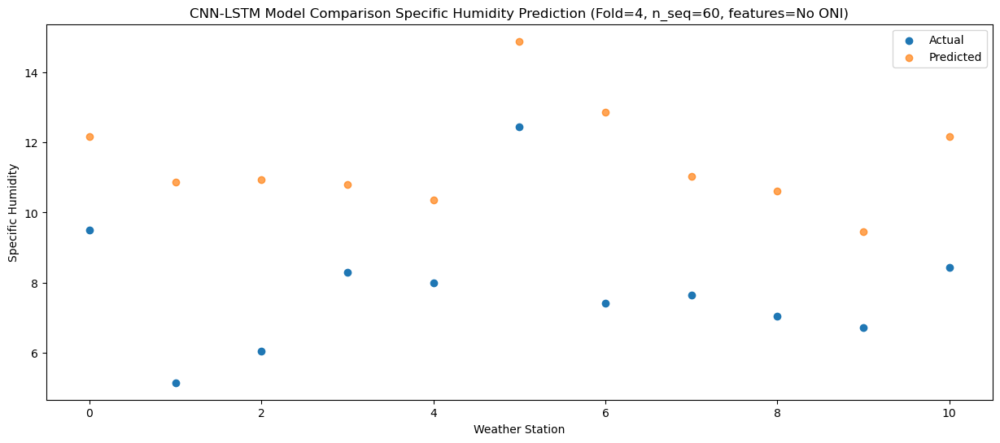

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   9.083006
1                 1    1.52   7.783007
2                 2    2.12   7.843006
3                 3    4.58   7.703012
4                 4    4.34   7.263009
5                 5   10.33  11.803000
6                 6    3.51   9.783005
7                 7    4.04   7.943007
8                 8    3.71   7.512996
9                 9    3.27   6.352995
10               10    5.38   9.082994


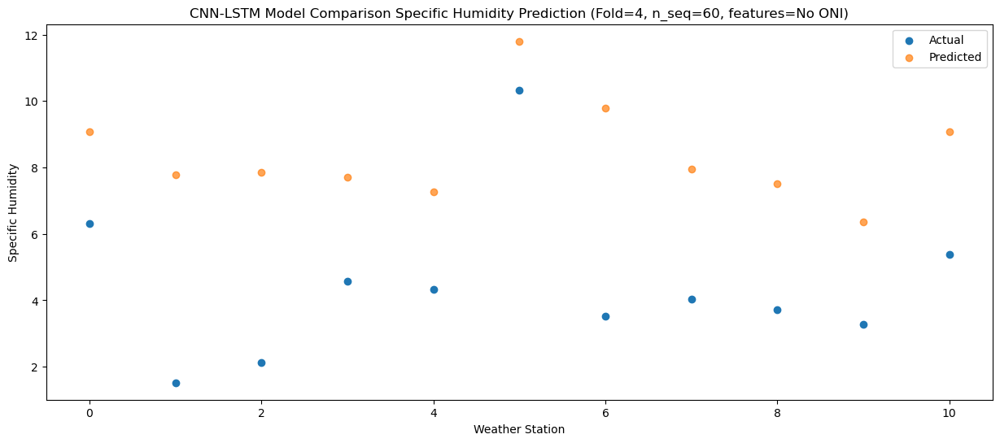

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   6.248510
1                 1   -0.78   4.948512
2                 2    0.14   5.008511
3                 3    2.05   4.868517
4                 4    1.92   4.428513
5                 5    8.03   8.968504
6                 6    0.56   6.948509
7                 7    1.01   5.108510
8                 8    0.64   4.678500
9                 9   -0.12   3.518498
10               10    1.94   6.248498


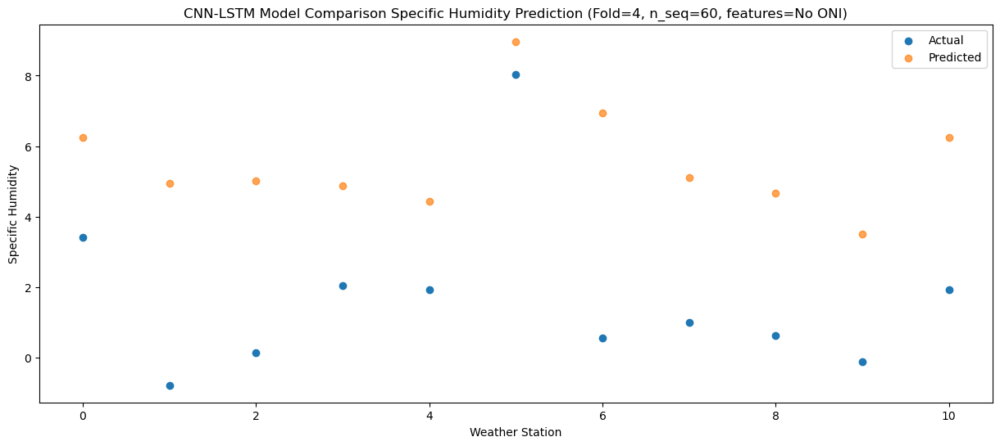

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   6.120281
1                 1   -1.87   4.820282
2                 2   -1.17   4.880281
3                 3    0.30   4.740287
4                 4    0.16   4.300284
5                 5    6.45   8.840275
6                 6    0.28   6.820280
7                 7    0.20   4.980282
8                 8    0.61   4.550272
9                 9    0.37   3.390271
10               10    2.46   6.120269


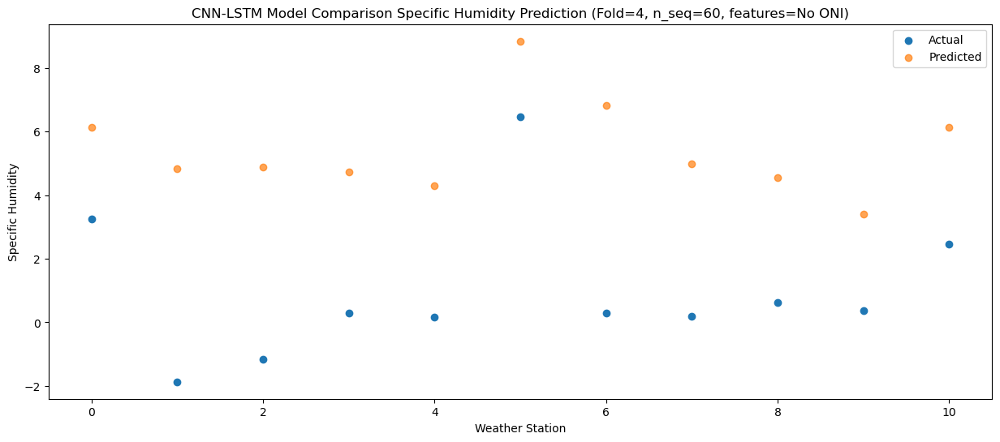

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54   5.178872
1                 1   -2.91   3.878873
2                 2   -1.89   3.938871
3                 3   -0.98   3.798878
4                 4   -1.26   3.358876
5                 5    5.18   7.898867
6                 6   -0.50   5.878871
7                 7   -0.95   4.038873
8                 8   -0.47   3.608863
9                 9   -1.09   2.448861
10               10    1.39   5.178859


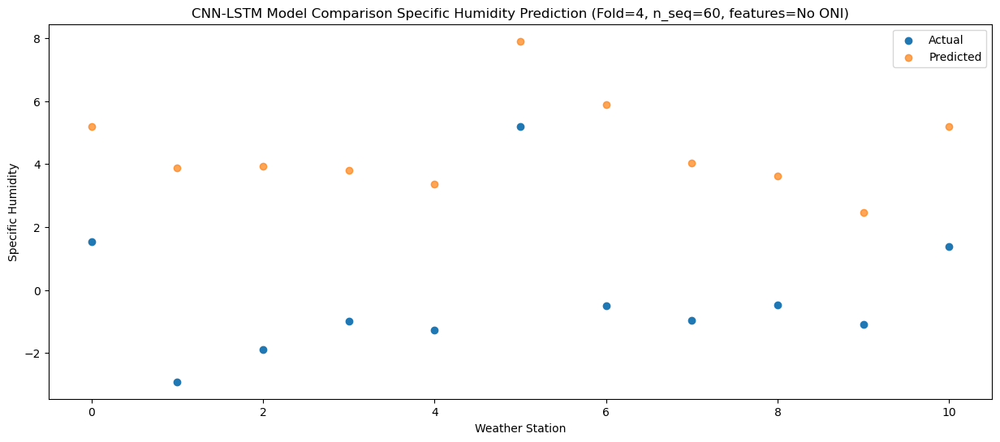

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55   5.948215
1                 1   -3.60   4.648218
2                 2   -0.46   4.708217
3                 3    1.36   4.568222
4                 4    1.09   4.128219
5                 5    5.53   8.668213
6                 6   -0.32   6.648217
7                 7    0.41   4.808218
8                 8    0.11   4.378208
9                 9   -0.17   3.218207
10               10    1.41   5.948205


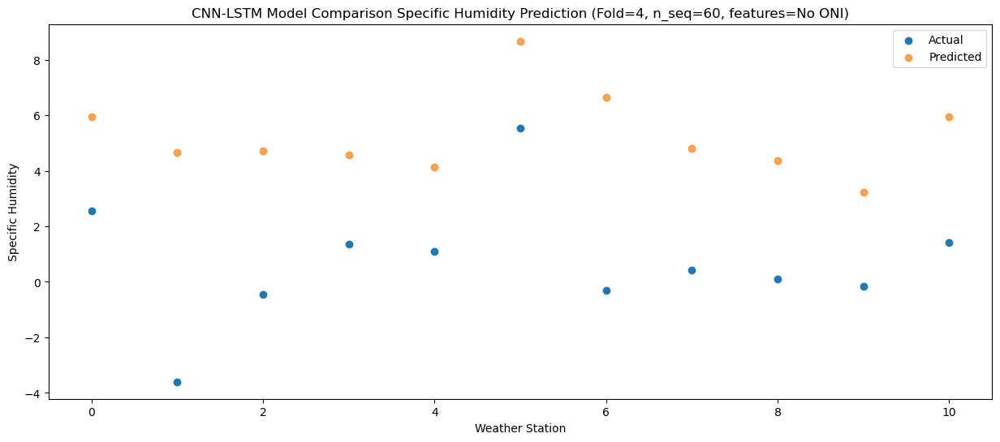

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   6.830114
1                 1   -0.31   5.530118
2                 2    1.17   5.590117
3                 3    3.15   5.450120
4                 4    3.04   5.010117
5                 5    6.67   9.550111
6                 6    1.25   7.530117
7                 7    1.62   5.690118
8                 8    1.18   5.260108
9                 9    0.80   4.100108
10               10    2.48   6.830106


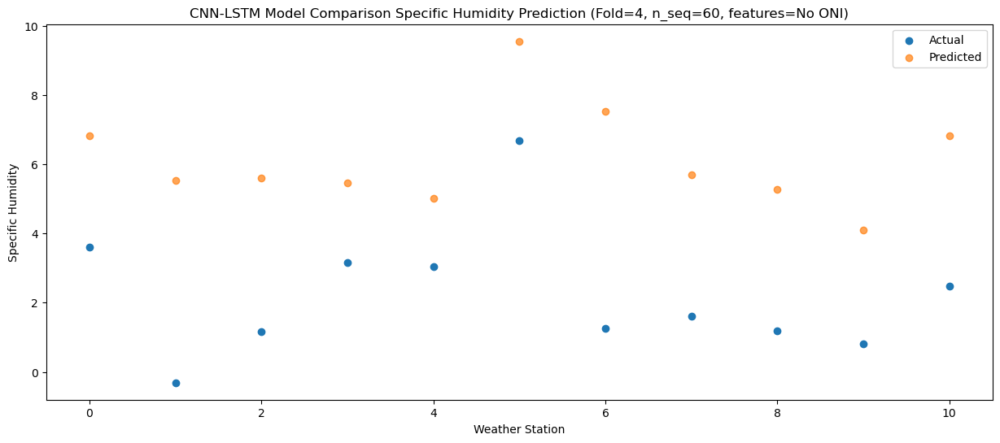

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   8.478584
1                 1   -0.91   7.178588
2                 2    3.35   7.238587
3                 3    5.52   7.098590
4                 4    5.54   6.658588
5                 5    7.27  11.198579
6                 6    3.17   9.178588
7                 7    3.35   7.338589
8                 8    3.21   6.908579
9                 9    2.52   5.748578
10               10    4.26   8.478575


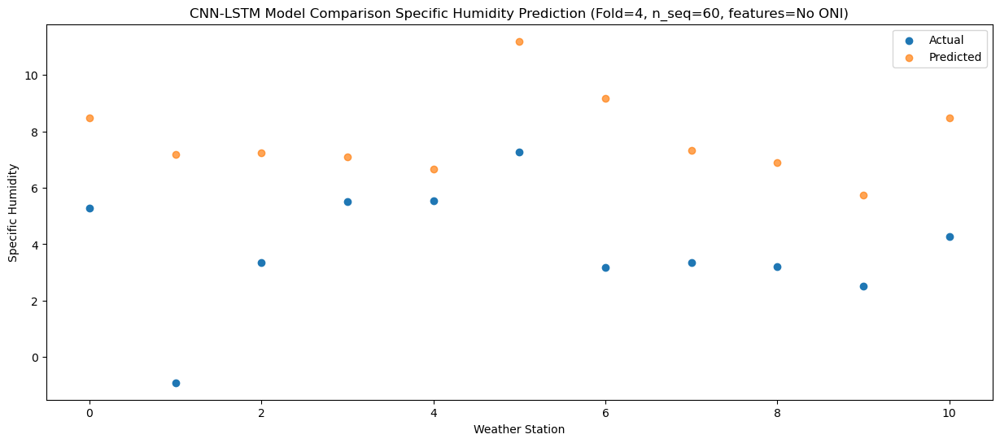

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36  11.846041
1                 1    1.68  10.546045
2                 2    7.67  10.606044
3                 3    9.09  10.466047
4                 4    8.97  10.026045
5                 5   10.03  14.566036
6                 6    7.17  12.546043
7                 7    7.77  10.706046
8                 8    6.70  10.276033
9                 9    6.06   9.116035
10               10    7.18  11.846030


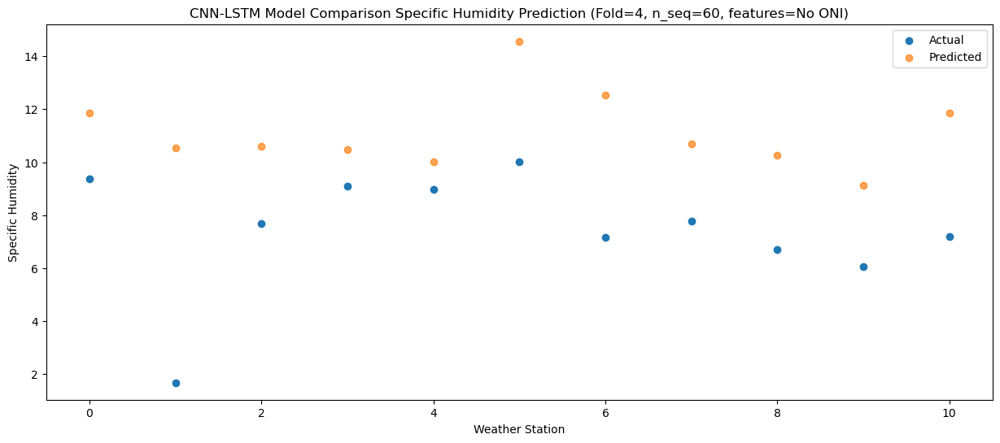

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62  14.594355
1                 1    3.14  13.294359
2                 2    9.01  13.354357
3                 3   11.03  13.214363
4                 4   11.08  12.774360
5                 5   14.56  17.314351
6                 6    8.93  15.294357
7                 7    9.75  13.454360
8                 8    8.39  13.024347
9                 9    8.82  11.864349
10               10    9.73  14.594345


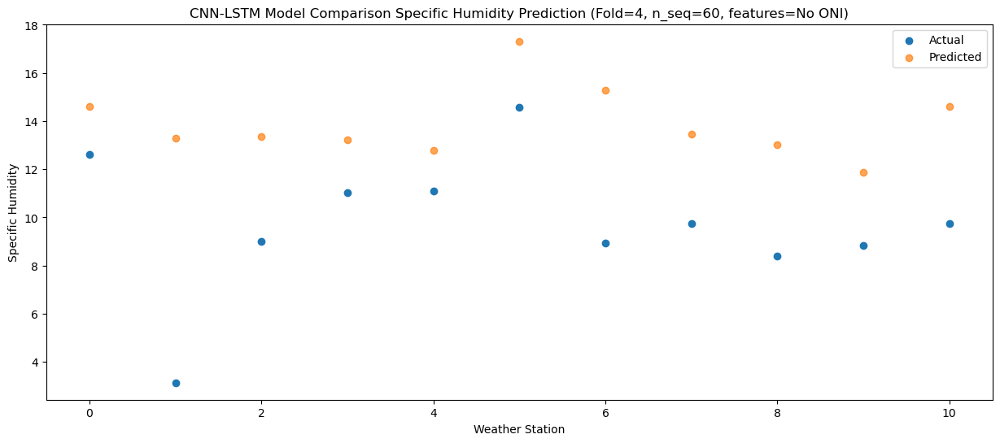

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81  15.675819
1                 1    4.60  14.375824
2                 2   11.04  14.435821
3                 3   10.99  14.295830
4                 4   10.61  13.855827
5                 5   14.44  18.395818
6                 6   11.32  16.375822
7                 7   10.73  14.535824
8                 8    9.69  14.105811
9                 9   10.43  12.945814
10               10   10.85  15.675809


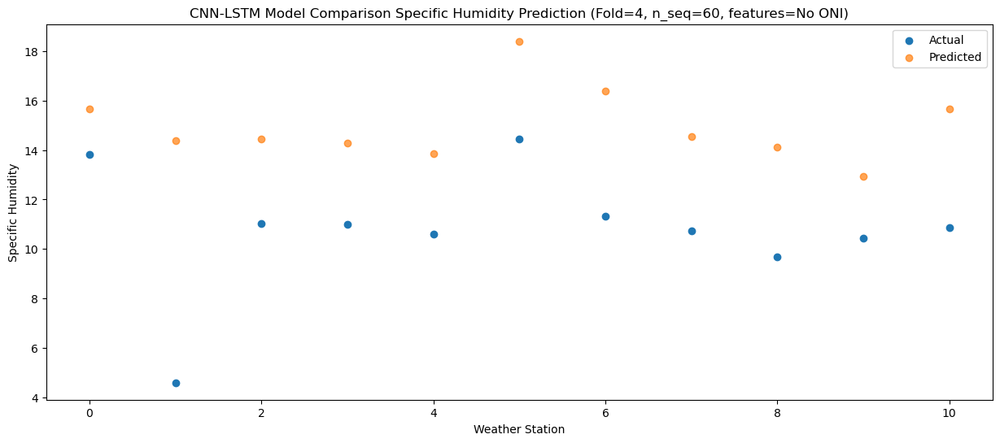

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65  15.534107
1                 1    7.21  14.234111
2                 2    8.73  14.294108
3                 3   10.28  14.154118
4                 4    9.84  13.714115
5                 5   13.24  18.254108
6                 6   10.58  16.234109
7                 7    9.44  14.394112
8                 8    9.33  13.964099
9                 9   10.07  12.804102
10               10   10.83  15.534097


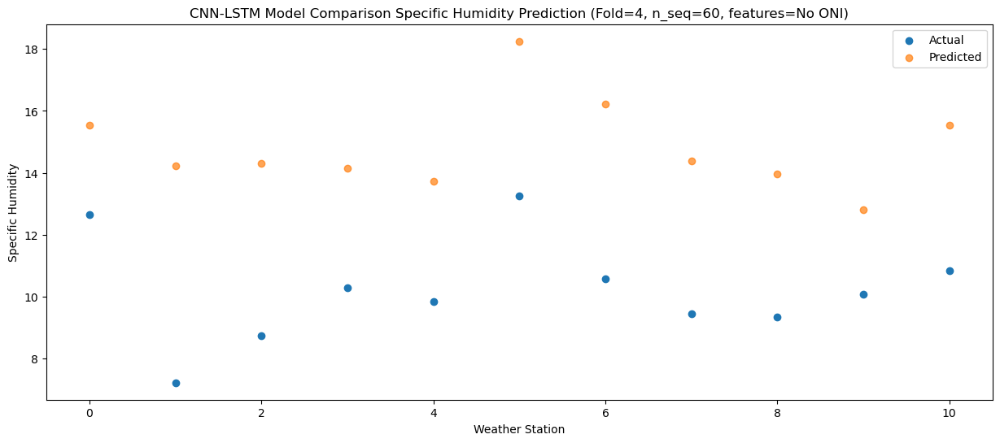

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35  12.894357
1                 1    7.02  11.594362
2                 2    7.63  11.654358
3                 3    7.75  11.514368
4                 4    7.68  11.074366
5                 5   12.36  15.614358
6                 6    8.26  13.594360
7                 7    7.40  11.754362
8                 8    6.65  11.324349
9                 9    6.57  10.164352
10               10    8.76  12.894348


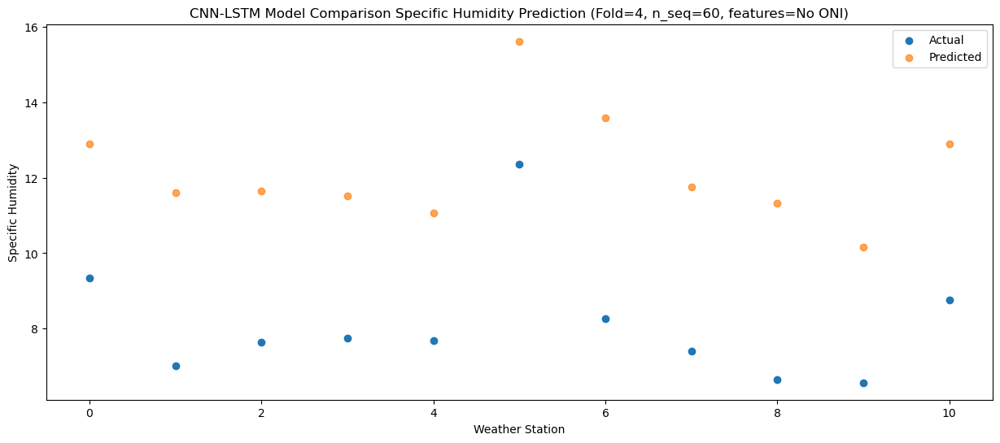

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22   9.250052
1                 1    2.60   7.950056
2                 2    2.84   8.010053
3                 3    4.29   7.870064
4                 4    3.94   7.430061
5                 5    8.67  11.970053
6                 6    3.86   9.950054
7                 7    3.08   8.110057
8                 8    3.07   7.680044
9                 9    2.47   6.520048
10               10    4.65   9.250042


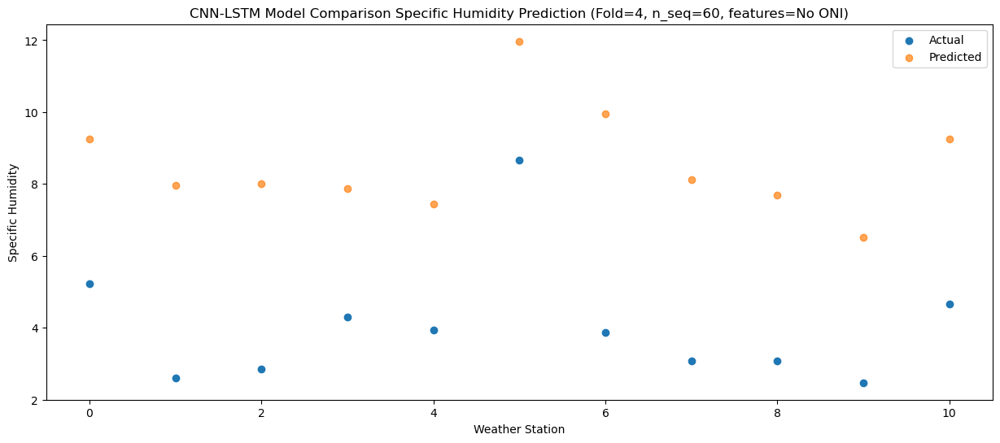

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 1, 512)            929792    
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 1, 512)           0         
 1D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_8 (LSTM)               (None, 1, 512)            2099200   
                                                                 
 dropout_13 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_9 (LSTM)               (None, 512)               2099200   
                                                      

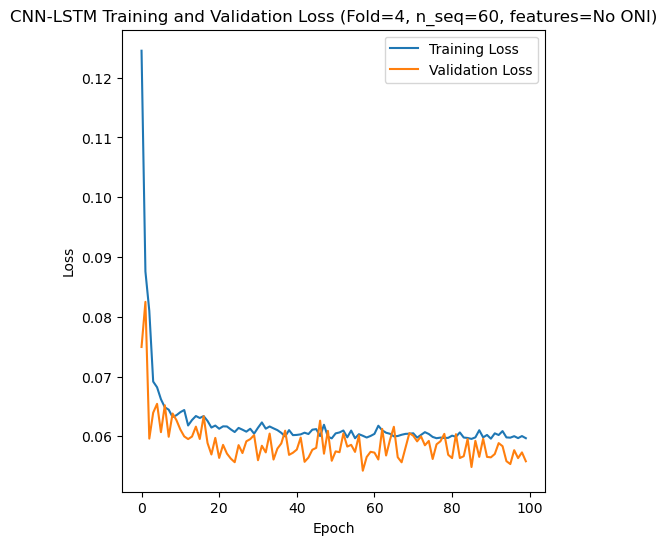

[[1.860325000008783, 1.5050997207120345, 1.3219556126266494, 0.9135578082429325, 1.3318048675189977, 1.2453061477679894, 1.323837909324251, 1.1249159990513178, 1.3939946386607833, 1.0447573068157154, 1.1251365192128293, 0.5236235770423651, 0.990008311540792, 2.134384486578929, 2.139872491864429, 1.6898505449657064, 1.404803431895363, 1.7392021068834935, 1.6478881902314821, 1.420754201126549, 1.5133083098986306, 1.447018148052773, 1.3217570603231337, 1.7094456139213052, 2.702549225861148, 1.4332404770734155, 2.493307532029404, 2.0410679441199155, 1.9792307646495277, 1.656542609964397, 1.2725488982262527, 1.4676928269156406, 1.7540957593564837, 1.7579143700177495, 1.8404482554961639, 2.4817742472489175, 1.7793148838922892, 2.1508405548319605, 2.105800902884325, 1.3641868236638284, 1.5962617161387884, 1.3244885360411212, 1.8366464547079706, 1.7770311217844148, 1.4367631302079913, 1.4035603450579677, 1.3267160236290432, 1.989865802838902, 1.9449885711435284, 2.623063131456993, 2.5499285226

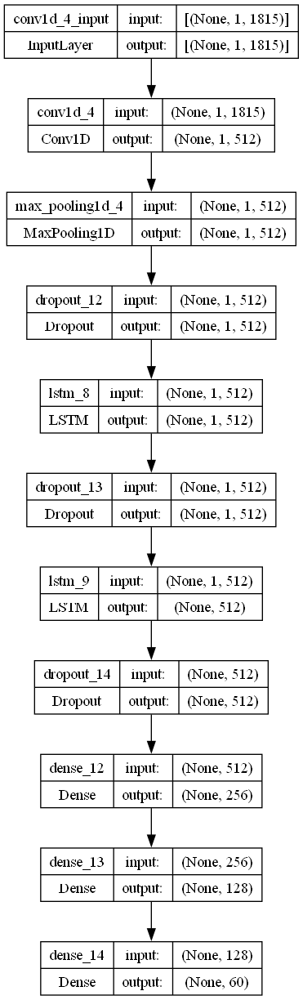

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 512
    lr = 0.0020251169132599243
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.14042268236135122

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_SH_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [3]:
print(np.mean(mape_avg_list[0]))

2.171633439838045


In [4]:
print(np.mean(mape_avg_list[1]))

6732744226721.903


In [5]:
print(np.mean(mape_avg_list[2]))

1.519203813119307


In [6]:
print(np.mean(mape_avg_list[3]))

10173310456472.654


In [7]:
print(np.mean(mape_avg_list[4]))

3.136563082675114


In [8]:
print(mape_avg_list[1])

[1.1439052406695234, 1.7283301333528585, 276869006049722.22, 13.04245072634926, 0.5591032663577679, 6.191552135646234, 0.2706643674309501, 0.11084883426453761, 0.11388607960894337, 0.08964337007990535, 0.07996358183701611, 0.11045380517395205, 1.20895811139466, 1.8585866957640023, 2.9952299861932086, 1.5535201092334225, 2.0231357125561193, 7.680323044074343, 0.4012816744467777, 0.13491418502304922, 0.09552087729612815, 0.08148358987342295, 0.12064165426361387, 0.17375607729071335, 0.9595161796051166, 1.4579455313899152, 1.2778633238559938, 2.3290743559293214, 13.054338777718867, 127095647553494.23, 0.19783035425949258, 0.15623029685658477, 0.08525315949572962, 0.07623451347199693, 0.11886855828292088, 3.4997939609781734, 1.4175722871118526, 1.8506175879943882, 1.23588425669358, 13.250469676537987, 1.67832840736867, 0.5388953222269881, 0.36635068746529353, 0.22558244513487, 0.146670648938788, 0.1028577340023969, 0.18502119117254923, 0.3644917179197677, 0.9127092581970397, 0.869864379268

In [9]:
print(mape_avg_list[3])

[1.209226342673883, 0.8032769726534336, 2.5144414062035314, 0.7508527752691987, 0.9185026481184263, 0.7027849034004361, 0.3050449842376558, 0.1406217731767708, 0.1926027299792829, 0.11858335633319408, 0.11016144754881024, 0.2883262251180794, 0.7750493139980997, 0.6856588644740761, 0.6965926089948288, 0.5901705728421636, 531891566435489.0, 0.6451556941054469, 0.5104252732837465, 0.19700818307841753, 0.13265872589100286, 0.14284665889093548, 0.09518960749044235, 0.16530669969874168, 1.406182189218117, 1.0922218571192845, 0.6347114364256138, 0.6187047201380556, 9.685788396882705, 0.5644447512001765, 0.16001828135813104, 0.14828654474530112, 0.12646785669092928, 0.11676225359772942, 0.15404379350047417, 0.9886877856962126, 0.9675955241128938, 7.387997378864593, 1.477940510855951, 1.6693137556306232, 1.8436789045386122, 0.8708242815121199, 1.037559441235325, 0.09648502897711993, 0.16011545371879318, 0.10675879911761395, 0.2106343386324917, 0.4724092461204432, 1.5602092214235497, 3.193892482

In [10]:
print(mape_avg_list[1][2])

276869006049722.22


In [11]:
print(mape_avg_list[1][29])

127095647553494.23


In [12]:
print(mape_avg_list[3][16])

531891566435489.0


In [13]:
print(mape_avg_list[3][51])

78507060952799.12


In [14]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

82.8997754538761


In [15]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(82.8997754538761/58))

MAPE Average for Fold 2 (removing >1e14 values): 1.4293064733426915


In [16]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

68.51900302802972


In [17]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(68.51900302802972/58))

MAPE Average for Fold 4 (removing >1e14 values): 1.1813621211729262


In [18]:
print("Average MAPE: "+str((2.171633439838045+1.4293064733426915+1.519203813119307+1.1813621211729262+3.136563082675114)/5))

Average MAPE: 1.887613786029617
